# Load the dataset and separate out the training and test data sets

In [1]:
# point to the appropriate directory containing the dataset split into train/val/test
import os
os.getcwd()

'/Users/karthiksankar/Documents/SAR/8.Platform_ForMultiStepEnumeration'

In [2]:
os.chdir ('/Users/karthiksankar/Documents/SAR/3.DataSplit')
import pandas as pd
data = pd.read_csv ('dataset_input.csv', index_col = 0)
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 435246 entries, 0 to 447756
Data columns (total 9 columns):
 #   Column                              Non-Null Count   Dtype 
---  ------                              --------------   ----- 
 0   Reaction SMILES                     435246 non-null  object
 1   reactionID                          435246 non-null  int64 
 2   react_smiles                        435246 non-null  object
 3   rxn_smiles                          435246 non-null  object
 4   template                            435246 non-null  object
 5   Template Verification (True/False)  435246 non-null  bool  
 6   canonical_rxn_smiles                435246 non-null  object
 7   dataset                             435246 non-null  object
 8   str_Reaction_Partner                435246 non-null  object
dtypes: bool(1), int64(1), object(7)
memory usage: 30.3+ MB


In [3]:
# convert str_Reaction_Partner into a list
from ast import literal_eval

#convert the string in the dataframe into list (result of storing the dataframe as csv!)
data['Reaction Partner (s)'] =  data.str_Reaction_Partner.apply(lambda x: literal_eval(str(x)))
#drop the string column str_Reaction_Partner
data.drop(columns = ['str_Reaction_Partner'], inplace = True)

In [4]:
os.chdir('/Users/karthiksankar/Documents/SAR/8.Platform_ForMultiStepEnumeration')

In [5]:
datasub = data[data['dataset']== 'train']

In [6]:
datasub_val = data[data['dataset']== 'test']

In [7]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 435246 entries, 0 to 447756
Data columns (total 9 columns):
 #   Column                              Non-Null Count   Dtype 
---  ------                              --------------   ----- 
 0   Reaction SMILES                     435246 non-null  object
 1   reactionID                          435246 non-null  int64 
 2   react_smiles                        435246 non-null  object
 3   rxn_smiles                          435246 non-null  object
 4   template                            435246 non-null  object
 5   Template Verification (True/False)  435246 non-null  bool  
 6   canonical_rxn_smiles                435246 non-null  object
 7   dataset                             435246 non-null  object
 8   Reaction Partner (s)                435246 non-null  object
dtypes: bool(1), int64(1), object(7)
memory usage: 30.3+ MB


In [8]:
data.head()

,Reaction SMILES,reactionID,react_smiles,rxn_smiles,template,Template Verification (True/False),canonical_rxn_smiles,dataset,Reaction Partner (s)
0,[CH2:15]([CH:16]([CH3:17])[CH3:18])[Mg+:19].[C...,0,CON(C)C(=O)c1ccc(O)nc1,CON(C)[C:6]([c:5]1[cH:4][n:3][c:2]([OH:1])[cH:...,[#7;a:5]:[c:4]:[c:3]-[C;H0;D3;+0:1](=[O;D1;H0:...,True,CON(C)C(=O)c1ccc(O)nc1>>CC(C)CC(=O)c1ccc(O)nc1,train,[CC(C)C[Mg+]]
1,[CH3:14][NH2:15].[N+:1](=[O:2])([O-:3])[c:4]1[...,1,O=C(O)c1ccc(Cl)c([N+](=O)[O-])c1,Cl[c:12]1[c:4]([N+:1](=[O:2])[O-:3])[cH:5][c:6...,[Cl;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>C-...,True,O=C(O)c1ccc(Cl)c([N+](=O)[O-])c1>>CNc1ccc(C(=O...,train,[CN]
2,[CH2:1]([CH3:2])[n:3]1[cH:4][c:5]([C:22](=[O:2...,2,CCn1cc(C(=O)O)c(=O)c2cc(F)c(-c3ccc(N)cc3)cc21,[CH2:1]([CH3:2])[n:3]1[cH:4][c:5]([C:22](=[O:2...,[NH2;D1;+0:1]-[c:2]>>O=C-[NH;D2;+0:1]-[c:2],True,CCn1cc(C(=O)O)c(=O)c2cc(F)c(-c3ccc(N)cc3)cc21>...,train,[O=CO]
3,[Cl:1][C:2]([N:3]([CH3:4])[CH3:5])=[C:6]([CH3:...,3,COCC(C)Oc1cc(Oc2cnc(C(=O)N3CCC3)cn2)cc(C(=O)O)c1,O=[C:25]([c:24]1[cH:23][c:22]([O:21][c:18]2[cH...,[O;H0;D1;+0]=[C;H0;D3;+0:1](-[OH;D1;+0:2])-[c:...,True,COCC(C)Oc1cc(Oc2cnc(C(=O)N3CCC3)cn2)cc(C(=O)O)...,train,[Cc1cnc(N)cn1]
4,[Cl:11][c:12]1[c:13]2[c:14]([n:15][c:16](-[c:1...,4,Clc1cc2c(Cl)nc(-c3ccncc3)nc2s1,Cl[c:12]1[c:13]2[c:14]([n:15][c:16](-[c:18]3[c...,[#16;a:6]:[c:5]1:[#7;a:4]:[c:3]:[#7;a:2]:[c;H0...,True,Clc1cc2c(Cl)nc(-c3ccncc3)nc2s1>>Clc1cc2c(NCc3c...,train,[NCc1ccc(Cl)c(Cl)c1]


In [9]:
data['Reaction SMILES'].tolist()

['[CH2:15]([CH:16]([CH3:17])[CH3:18])[Mg+:19].[CH2:20]1[O:21][CH2:22][CH2:23][CH2:24]1.[Cl-:14].[OH:1][c:2]1[n:3][cH:4][c:5]([C:6](=[O:7])[N:8]([O:9][CH3:10])[CH3:11])[cH:12][cH:13]1>>[OH:1][c:2]1[n:3][cH:4][c:5]([C:6](=[O:7])[CH2:15][CH:16]([CH3:17])[CH3:18])[cH:12][cH:13]1',
 '[CH3:14][NH2:15].[N+:1](=[O:2])([O-:3])[c:4]1[cH:5][c:6]([C:7](=[O:8])[OH:9])[cH:10][cH:11][c:12]1[Cl:13].[OH2:16]>>[N+:1](=[O:2])([O-:3])[c:4]1[cH:5][c:6]([C:7](=[O:8])[OH:9])[cH:10][cH:11][c:12]1[NH:15][CH3:14]',
 '[CH2:1]([CH3:2])[n:3]1[cH:4][c:5]([C:22](=[O:23])[OH:24])[c:6](=[O:21])[c:7]2[cH:8][c:9]([F:20])[c:10](-[c:13]3[cH:14][cH:15][c:16]([NH2:19])[cH:17][cH:18]3)[cH:11][c:12]12.[CH:25](=[O:26])[OH:27]>>[CH2:1]([CH3:2])[n:3]1[cH:4][c:5]([C:22](=[O:23])[OH:24])[c:6](=[O:21])[c:7]2[cH:8][c:9]([F:20])[c:10](-[c:13]3[cH:14][cH:15][c:16]([NH:19][CH:25]=[O:26])[cH:17][cH:18]3)[cH:11][c:12]12',
 '[Cl:1][C:2]([N:3]([CH3:4])[CH3:5])=[C:6]([CH3:7])[CH3:8].[Cl:51][CH2:52][Cl:53].[N:9]1([C:13](=[O:14])[c:15]2[n:16]

# Add fingerprint information to training and test datasets

In [10]:
# import all necessary packages
import rdkit.Chem as Chem
import rdkit.Chem.AllChem as AllChem
from rdkit import DataStructs

# Set up fingerprinting of molecules, this is the final fingerprint decided after hyperparameter optimization
getfp = lambda smi: AllChem.GetMorganFingerprint(Chem.MolFromSmiles(smi),2, useFeatures=True)

# Set up similarity label, this is the final similarity label decided after hyperparameter optimization
similarity_metric = DataStructs.BulkTanimotoSimilarity

In [11]:
def do_one_getfp (smiles):
    '''Given an input SMILES, this code will return its fingerprint. This would be important for setting
    this up in parallel.
    '''
    getfp = lambda smi: AllChem.GetMorganFingerprint(Chem.MolFromSmiles(smi),2, useFeatures=True)
    
    return getfp(smiles)

In [12]:
#import the parallel libraries
from joblib import Parallel, delayed

#compute the fingerprints, training set
all_fps_train = Parallel (n_jobs = 7, verbose = 3) (delayed (do_one_getfp) (smiles) \
for smiles in datasub['react_smiles'])

[Parallel(n_jobs=7)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  18 tasks      | elapsed:    0.6s
[Parallel(n_jobs=7)]: Done 1479 tasks      | elapsed:    0.8s
[Parallel(n_jobs=7)]: Done 72199 tasks      | elapsed:    5.8s
[Parallel(n_jobs=7)]: Done 186887 tasks      | elapsed:   13.6s
[Parallel(n_jobs=7)]: Done 334343 tasks      | elapsed:   24.4s
[Parallel(n_jobs=7)]: Done 348196 out of 348196 | elapsed:   25.3s finished


In [13]:
#add reactant fingerprint to the pandas dataframe
datasub['react_fp'] = all_fps_train

/var/folders/63/4_fnssd92x5ddl69c4gft_sh0000gn/T/ipykernel_91222/2459195585.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datasub['react_fp'] = all_fps_train


In [14]:
#compute the fingerprints, validation set
all_fps_val = Parallel (n_jobs = 7, verbose = 3) (delayed (do_one_getfp) (smiles) \
for smiles in datasub_val ['react_smiles'])

[Parallel(n_jobs=7)]: Using backend LokyBackend with 7 concurrent workers.
[Parallel(n_jobs=7)]: Done  22 tasks      | elapsed:    0.0s
[Parallel(n_jobs=7)]: Done 4082 tasks      | elapsed:    0.4s
[Parallel(n_jobs=7)]: Done 43512 out of 43525 | elapsed:    3.2s remaining:    0.0s
[Parallel(n_jobs=7)]: Done 43525 out of 43525 | elapsed:    3.2s finished


In [15]:
#Append the fingerprints of all reactants in the validation set
datasub_val ['react_fp'] = all_fps_val

/var/folders/63/4_fnssd92x5ddl69c4gft_sh0000gn/T/ipykernel_91222/516885177.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  datasub_val ['react_fp'] = all_fps_val


# 1. Diversification and fastfilter computations

In [16]:
import sys 
import os
import re
import copy
import numpy as np
import rdkit.Chem as Chem
import rdkit.Chem.AllChem as AllChem
from rdkit.Chem.rdchem import ChiralType, BondType, BondDir
from rdchiral.utils import vprint, PLEVEL, atoms_are_different
from rdchiral.initialization import rdchiralReaction, rdchiralReactants
from rdchiral.chiral import template_atom_could_have_been_tetra, copy_chirality,\
    atom_chirality_matches
from rdchiral.clean import canonicalize_outcome_smiles, combine_enantiomers_into_racemic
from rdchiral.bonds import BondDirOpposite, restore_bond_stereo_to_sp2_atom
from rdchiral.template_extractor import extract_from_reaction
from rdchiral.main import rdchiralRun

### Drawing tools

In [17]:
from rdkit.Chem.Draw import rdMolDraw2D

from IPython.display import SVG

from rdkit.Chem import rdChemReactions

def draw_rxn(rxn, unmap=True, width=800, height=200):
    if unmap:
        for mol in rxn.GetReactants():
            [a.SetAtomMapNum(0) for a in mol.GetAtoms()]
        for mol in rxn.GetProducts():
            [a.SetAtomMapNum(0) for a in mol.GetAtoms()]
    drawer = rdMolDraw2D.MolDraw2DSVG(width, height)
    drawer.DrawReaction(rxn)
    drawer.FinishDrawing()
    svg = drawer.GetDrawingText().replace('svg:', '')
    display(SVG(svg))

def draw_rxn_smi(rxn_smi, unmap=True, width=800, height=200):
    rxn = AllChem.ReactionFromSmarts(rxn_smi, useSmiles=True)
    draw_rxn(rxn, unmap=unmap, width=width, height=height)

### Single step diversification tool

In [18]:
#default draw and debug settings
draw = False            
debug = False

def diversify_SMILES (smiles, iteration, draw=draw, debug=debug, max_prec=100):
    '''This is based off do_one_v4 used in top-k accuracy analysis. The input to the algorithm is 
    the SMILES string of the compound that you'd like to diversify, and iteration # of the diversification
    problem. The output of the algorithm is a pandas dataframe with the following columns: Iteration,
    Reactant input, product output, coupling partner, and reaction SMILES'''
    
    # Set up fingerprinting of molecules, this is the final fingerprint decided after hyperparameter optimization
    getfp = lambda smi: AllChem.GetMorganFingerprint(Chem.MolFromSmiles(smi),2, useFeatures=True)

    # Set up similarity label, this is the final similarity label decided after hyperparameter optimization
    similarity_metric = DataStructs.BulkTanimotoSimilarity
    
    #get reactant smiles
    react_smiles = []
    react_smiles.append (smiles)
    
    # for the moment, it is just an empty string
    rec_for_printing = '' 
    
    #loads reactant SMILES into RDKit object
    ex = Chem.MolFromSmiles(smiles) 
    
    #loads reactant SMILES into RDChiral object
    rct = rdchiralReactants(smiles)
    
    #if Draw = True, then Print Mol {Index}
    if draw:
        print ('SMILES: {}, reactant input:'.format(smiles))
        display (ex)
        
    #if Debug = True, then Print {Product SMILES} + go to new line +
    # True reaction: {reaction smiles}
    if debug:
        rec_for_printing += 'Desired Reactant:' + '\n'
        rec_for_printing += smiles + '\n'  
  
    #get the fingerprint of the product
    fp = getfp(smiles)
    
    #calculates similarity metric between fingerprint 
    # and all fingerprints in the database
    sims = similarity_metric (fp, [fp_ for fp_ in datasub['react_fp']])
    
    #sort the similarity metric in reverse order
    js = np.argsort(sims) [::-1]
           
    # Get probability of precursors
    probs = {}
    
    for ji,j in enumerate (js[:max_prec]):
        
        #get the index in the similarity search
        jx = datasub.index[j]
        
        #draw out the most similar reactions
        if draw: 
            print('\n\n'+'-'*50+'\n')
            print ('Train index: {}'.format (jx))
            print ('RANK {} PRECEDENT'.format(ji+1))
            print ('REACTANT MATCH SCORE: {}'.format(sims[j]))
            draw_rxn_smi (datasub['rxn_smiles'][jx])
        
        #debug statement- Reaction precedent rank, similarity score, and reaction smiles addition!
        if debug:
            rec_for_printing += '\nReaction precedent {}, prod similarity {}\n'.format(ji+1, sims[j])
            rec_for_printing += '-> rxn_smiles {}\n'.format(datasub['rxn_smiles'][jx])
        
        try:  
            #extract the template
            template = datasub['template'][jx]

            #get product reference fingerprint
            prods_ref_fp = getfp(datasub['rxn_smiles'][jx].split('>')[2])

            #load the reaction into an rdchiral object
            rxn = rdchiralReaction(template)

            #save it to the cache
            #jx_cache[jx] = (rxn, template, prods_ref_fp)

            #debug statement- print the reaction template and index
            if debug:
                rec_for_printing += '-> template: {}\n'.format(template)
                rec_for_printing += '-> jx/ index: {}\n'.format(jx)

            #draw: draw out the template
            if draw:
                print('-> template: {}'.format(template))
                rxn_for_display = rdChemReactions.ReactionFromSmarts(template)
                display (rxn_for_display)

        except:

            if debug:
                rec_for_printing += '-> Template extraction failed! \n'

            if draw:
                print ('-> Template extraction failed!')

            #if it fails, move to the next reaction
            continue 

        try:
            # try running the rdchiral reaction
            outcomes = rdchiralRun (rxn, rct, combine_enantiomers=False)
        
        #if running the rdchiral reaction is not possible go into this exception routine
        except Exception as e:
            print(e)
            outcomes = []
            continue
        
        #if you are unable to generate outcomes and draw -> print an error message
        if not outcomes and draw:
            print('->No precursors could be generated!')
            
        #if you are unable to generate outcomes and debug -> print an error message
        if not outcomes and debug:
            rec_for_printing += '-> Template application failed! \n'
            
        for products in outcomes:
            
            #proposed product fingerprint
            products_fp = getfp(products)
            
            #compare proposed and precedent product fp
            products_sim = similarity_metric(products_fp, [prods_ref_fp])[0]
            
            #debug statement
            if debug:
                rec_for_printing += 'prod sim {}, overall {}, smiles {}\n'.format(products_sim, products_sim*sims[j], products)
            
            #draw statement
            if draw:
                print('Product similarity {}, overall {}, smiles {}'.format(
                    products_sim, products_sim*sims[j], products))
                display(Chem.MolFromSmiles(products))
                
            #assemble the reaction
            rxn_to_print = ''

            #add core reactant
            rxn_to_print += smiles

            #add coreactants
            coreactants_draw = datasub ['Reaction Partner (s)'][jx]
            for reactant in coreactants_draw:
                rxn_to_print += '.' + reactant

            #add products
            rxn_to_print += '>>' + products
                
            if draw:
                #display the reaction
                print ('The proposed reaction is:')
                draw_rxn_smi(rxn_to_print)
                print ('The reaction SMILES string is: {}'.format (rxn_to_print))
            
            #if the algorithm has produced this product previously
            if products in probs:
                #consider this reaction if it is beeter than the previous solution!
                if (products_sim*sims[j]) > probs[products][0]:
                    probs[products] = [products_sim*sims[j], rxn_to_print, \
                                       datasub ['Reaction Partner (s)'][jx]]
            #if the algorithm has not produced this product previously...
            else:
                probs[products] = [products_sim*sims[j], rxn_to_print, \
                                  datasub ['Reaction Partner (s)'][jx]]
    
    #collect the information for a pandas dataframe
    prod_pd = []
    rxn_pd = []
    coupling_part_pd = []
    #sim scores do not go into the final dataframe
    sim_score_pd = []
    for r, (prod, prob) in enumerate(sorted(probs.items(), key=lambda x:x[1], reverse=True)[:]):         
        
        #save to pandas dataframe
        prod_pd.append (prod)
        rxn_pd.append (prob[1])
        coupling_part_pd.append (prob[2])
        #sim scores do not go into the final dataframe
        sim_score_pd.append (prob[0])
                         
    #put together the pandas dataframe
    react_pd = []
    iter_pd = []
    

    #canonicalize the smiles (if it isn't already so)
    can_smiles = Chem.MolToSmiles (Chem.MolFromSmiles(smiles))
    
    #loop through the number of products found
    for i in range (len (prod_pd)):
        react_pd.append (can_smiles)
        iter_pd.append (iteration)
    
    result_df = pd.DataFrame (list(zip(iter_pd,react_pd,prod_pd, coupling_part_pd,\
                                      rxn_pd)), columns = ['Iteration', 'Reactant_input',\
                                                                         'Product_output',\
                                                                        'Coupling_partner', 'Reaction_smiles'])
                                                                        
    if debug:
        print(rec_for_printing)

    return result_df

In [19]:
def diversify_batch(SMILES_list, iteration_number):
    '''Given a list of SMILES to diversify, provide an output Pandas dataframe that diversifies
    all the chemicals.'''
    
    import pandas as pd
    import sys 
    import os
    import re
    import copy
    import numpy as np
    import rdkit.Chem as Chem
    import rdkit.Chem.AllChem as AllChem
    from rdkit.Chem.rdchem import ChiralType, BondType, BondDir
    from rdchiral.utils import vprint, PLEVEL, atoms_are_different
    from rdchiral.initialization import rdchiralReaction, rdchiralReactants
    from rdchiral.chiral import template_atom_could_have_been_tetra, copy_chirality,\
        atom_chirality_matches
    from rdchiral.clean import canonicalize_outcome_smiles, combine_enantiomers_into_racemic
    from rdchiral.bonds import BondDirOpposite, restore_bond_stereo_to_sp2_atom
    from rdchiral.template_extractor import extract_from_reaction
    from rdchiral.main import rdchiralRun
    from rdkit import DataStructs
    
    #default draw and debug settings
    draw = False            
    debug = False

    def diversify_oneSMILES (smiles, iteration, draw=draw, debug=debug, max_prec=100):
        '''This is based off do_one_v4 used in top-k accuracy analysis. The input to the algorithm is 
        the SMILES string of the compound that you'd like to diversify, and iteration # of the diversification
        problem. The output of the algorithm is a pandas dataframe with the following columns: Iteration,
        Reactant input, product output, coupling partner, and reaction SMILES'''

        # Set up fingerprinting of molecules, this is the final fingerprint decided after hyperparameter optimization
        getfp = lambda smi: AllChem.GetMorganFingerprint(Chem.MolFromSmiles(smi),2, useFeatures=True)

        # Set up similarity label, this is the final similarity label decided after hyperparameter optimization
        similarity_metric = DataStructs.BulkTanimotoSimilarity

        #get reactant smiles
        react_smiles = []
        react_smiles.append (smiles)

        # for the moment, it is just an empty string
        rec_for_printing = '' 

        #loads reactant SMILES into RDKit object
        ex = Chem.MolFromSmiles(smiles) 

        #loads reactant SMILES into RDChiral object
        rct = rdchiralReactants(smiles)

        #if Draw = True, then Print Mol {Index}
        if draw:
            print ('SMILES: {}, reactant input:'.format(smiles))
            display (ex)

        #if Debug = True, then Print {Product SMILES} + go to new line +
        # True reaction: {reaction smiles}
        if debug:
            rec_for_printing += 'Desired Reactant:' + '\n'
            rec_for_printing += smiles + '\n'  

        #get the fingerprint of the product
        fp = getfp(smiles)

        #calculates similarity metric between fingerprint 
        # and all fingerprints in the database
        sims = similarity_metric (fp, [fp_ for fp_ in datasub['react_fp']])

        #sort the similarity metric in reverse order
        js = np.argsort(sims) [::-1]

        # Get probability of precursors
        probs = {}

        for ji,j in enumerate (js[:max_prec]):

            #get the index in the similarity search
            jx = datasub.index[j]

            #draw out the most similar reactions
            if draw: 
                print('\n\n'+'-'*50+'\n')
                print ('Train index: {}'.format (jx))
                print ('RANK {} PRECEDENT'.format(ji+1))
                print ('REACTANT MATCH SCORE: {}'.format(sims[j]))
                draw_rxn_smi (datasub['rxn_smiles'][jx])

            #debug statement- Reaction precedent rank, similarity score, and reaction smiles addition!
            if debug:
                rec_for_printing += '\nReaction precedent {}, prod similarity {}\n'.format(ji+1, sims[j])
                rec_for_printing += '-> rxn_smiles {}\n'.format(datasub['rxn_smiles'][jx])

            try:  
                #extract the template
                template = datasub['template'][jx]

                #get product reference fingerprint
                prods_ref_fp = getfp(datasub['rxn_smiles'][jx].split('>')[2])

                #load the reaction into an rdchiral object
                rxn = rdchiralReaction(template)

                #save it to the cache
                #jx_cache[jx] = (rxn, template, prods_ref_fp)

                #debug statement- print the reaction template and index
                if debug:
                    rec_for_printing += '-> template: {}\n'.format(template)
                    rec_for_printing += '-> jx/ index: {}\n'.format(jx)

                #draw: draw out the template
                if draw:
                    print('-> template: {}'.format(template))
                    rxn_for_display = rdChemReactions.ReactionFromSmarts(template)
                    display (rxn_for_display)

            except:

                if debug:
                    rec_for_printing += '-> Template extraction failed! \n'

                if draw:
                    print ('-> Template extraction failed!')

                #if it fails, move to the next reaction
                continue 

            try:
                # try running the rdchiral reaction
                outcomes = rdchiralRun (rxn, rct, combine_enantiomers=False)

            #if running the rdchiral reaction is not possible go into this exception routine
            except Exception as e:
                print(e)
                outcomes = []
                continue

            #if you are unable to generate outcomes and draw -> print an error message
            if not outcomes and draw:
                print('->No precursors could be generated!')

            #if you are unable to generate outcomes and debug -> print an error message
            if not outcomes and debug:
                rec_for_printing += '-> Template application failed! \n'

            for products in outcomes:

                #proposed product fingerprint
                products_fp = getfp(products)

                #compare proposed and precedent product fp
                products_sim = similarity_metric(products_fp, [prods_ref_fp])[0]

                #debug statement
                if debug:
                    rec_for_printing += 'prod sim {}, overall {}, smiles {}\n'.format(products_sim, products_sim*sims[j], products)

                #draw statement
                if draw:
                    print('Product similarity {}, overall {}, smiles {}'.format(
                        products_sim, products_sim*sims[j], products))
                    display(Chem.MolFromSmiles(products))

                #assemble the reaction
                rxn_to_print = ''

                #add core reactant
                rxn_to_print += smiles

                #add coreactants
                coreactants_draw = datasub ['Reaction Partner (s)'][jx]
                for reactant in coreactants_draw:
                    rxn_to_print += '.' + reactant

                #add products
                rxn_to_print += '>>' + products

                if draw:
                    #display the reaction
                    print ('The proposed reaction is:')
                    draw_rxn_smi(rxn_to_print)
                    print ('The reaction SMILES string is: {}'.format (rxn_to_print))

                #if the algorithm has produced this product previously
                if products in probs:
                    #consider this reaction if it is beeter than the previous solution!
                    if (products_sim*sims[j]) > probs[products][0]:
                        probs[products] = [products_sim*sims[j], rxn_to_print, \
                                           datasub ['Reaction Partner (s)'][jx]]
                #if the algorithm has not produced this product previously...
                else:
                    probs[products] = [products_sim*sims[j], rxn_to_print, \
                                      datasub ['Reaction Partner (s)'][jx]]

        #collect the information for a pandas dataframe
        prod_pd = []
        rxn_pd = []
        coupling_part_pd = []
        #sim scores do not go into the final dataframe
        sim_score_pd = []
        for r, (prod, prob) in enumerate(sorted(probs.items(), key=lambda x:x[1], reverse=True)[:]):         

            #save to pandas dataframe
            prod_pd.append (prod)
            rxn_pd.append (prob[1])
            coupling_part_pd.append (prob[2])
            #sim scores do not go into the final dataframe
            sim_score_pd.append (prob[0])

        #put together the pandas dataframe
        react_pd = []
        iter_pd = []


        #canonicalize the smiles (if it isn't already so)
        can_smiles = Chem.MolToSmiles (Chem.MolFromSmiles(smiles))

        #loop through the number of products found
        for i in range (len (prod_pd)):
            react_pd.append (can_smiles)
            iter_pd.append (iteration)

        result_df = pd.DataFrame (list(zip(iter_pd,react_pd,prod_pd, coupling_part_pd,\
                                          rxn_pd)), columns = ['Iteration', 'Reactant_input',\
                                                                             'Product_output',\
                                                                            'Coupling_partner', 'Reaction_smiles'])

        if debug:
            print(rec_for_printing)

        return result_df
    
    output = []
    
    #loop through the input SMILES list
    for smiles in SMILES_list:
        
        #diversify each SMILES string
        output.append (diversify_oneSMILES (smiles, iteration_number))
    
    #concatenate the output
    output_return = pd.concat (output, ignore_index = True)
    
    return output_return

### Fast filter score

In [20]:
def ff_batch(rxn_smiles_list):
    '''Given a reaction SMILES list, compute its fast filter scores. Return a dictionary of
    rxn_smiles:ff score
    '''
    
    # Load the ASKCOS
    from askcos.synthetic.evaluation.fast_filter import FastFilterScorer
    ff = FastFilterScorer()
    ff.load()
    
    # Fast filter for a single reaction
    def fast_filter (rxn_smiles):
        '''Given reaction SMILES, provide fast filter score
        '''
    
        #split the reactants and products
        all_reactants, all_products = rxn_smiles.split ('>>')

        #compute the fast filter score
        score = ff.predict (all_reactants, all_products)

        #return the score
        return score
    
    #return dictionary
    results = {}
    
    #loop through the reaction list
    for rxn in rxn_smiles_list:
        results[rxn]=fast_filter(rxn)
    
    return (results)

In [21]:
def fast_filter_computation (result_df,ff):
    ''' Check the fast filter scores of the proposed reactions. The input to this code is the pandas 
    dataframe that comes out of the diversification. The output to this code is the same as the input pandas
    dataframe, but with the fast filter scores attached.'''
    
    #convert the reaction SMILES to list
    reaction_smiles_list = result_df['Reaction_smiles'].tolist()
    
    #output scores list
    outputList = [fast_filter (rxn_smiles,ff) for rxn_smiles in reaction_smiles_list]
    
    #append it to the pandas dataframe
    result_df['Fast filter'] = outputList
    
    return result_df

### Fast filter cut off

In [22]:
def fast_filter_cutoff (fast_filter_df, cut_off = 0.5):
    '''This code will cut off at a certain pre-determined cut-off score, this can be determined by
    the user or it is preset at 0.5. It will take as input the pandas dataframe with fast filter scores.
    It will return a pandas dataframe only with rows that have a fast filter score greater than or equal
    to the cutoff'''
    
    return fast_filter_df [fast_filter_df['Fast filter'] >= 0.5]

### Do_one
This puts together the diversification, fast filter check, and fast_filter_cutoff

In [23]:
def diversify_and_sanitize (smiles, iteration):
    '''The goal of this block of code is to diversify a chemical molecule, run fast filter computations,
    and cut off using a fast filter threshold. It takes as input the SMILES of the compound and
    the iteration number. It provides as output the pandas dataframe of diversified analogs.'''
    
    #step 1, diversify the SMILES string using the similarity based search algorithm
    diversify_SMILES_pd = diversify_SMILES (smiles, iteration)
    
    if diversify_SMILES_pd is None:
        return
    
    #step 2, compute the fast filter scores
    from askcos.synthetic.evaluation.fast_filter import FastFilterScorer

    ff = FastFilterScorer()

    ff.load()
    
    fast_filter_computation_pd = fast_filter_computation (diversify_SMILES_pd, ff)
    
    #step 3, cut off the dataframe at the cut-off threshold
    fast_filter_cutoff_pd = fast_filter_cutoff (fast_filter_computation_pd)
    
    #reset index
    fast_filter_cutoff_pd.reset_index(drop= True, inplace = True)
    return fast_filter_cutoff_pd

## Compound selection

In [24]:
datasub_val5 = datasub_val.sample (n = 5)

In [25]:
datasub_val5

,Reaction SMILES,reactionID,react_smiles,rxn_smiles,template,Template Verification (True/False),canonical_rxn_smiles,dataset,Reaction Partner (s),react_fp
157218,[CH3:1][c:2]1[n:3][c:4]2[n:5]([c:6](=[O:16])[c...,161896,Cc1nc2sccn2c(=O)c1-c1ccc(C#N)cc1,N#C[c:11]1[cH:10][cH:9][c:8](-[c:7]2[c:2]([CH3...,[N;H0;D1;+0]#[C;H0;D2;+0]-[c;H0;D3;+0:1](:[c:2...,True,Cc1nc2sccn2c(=O)c1-c1ccc(C#N)cc1>>COc1ccc(-c2c...,test,[COc1ccc(B(O)O)cc1],<rdkit.DataStructs.cDataStructs.UIntSparseIntV...
324095,[F:4][C:5]([c:6]1[cH:7][c:8]2[n+:9]([O-:17])[c...,341546,[O-][n+]1cc(O)nc2ccc(C(F)(F)F)cc21,[O-][n+:9]1[c:8]2[cH:7][c:6]([C:5]([F:4])([F:1...,[O-;H0;D1]-[n+;H0;D3:4]1:[c:3]:[c:2]:[#7;a:1]:...,True,[O-][n+]1cc(O)nc2ccc(C(F)(F)F)cc21>>Oc1cnc2cc(...,test,[],<rdkit.DataStructs.cDataStructs.UIntSparseIntV...
43716,[C:32]([O:33][N:34]=[O:35])([CH3:36])([CH3:37]...,44240,Nc1nc(-c2cccc(NS(=O)(=O)c3c(F)cccc3F)c2)c(-c2c...,N[c:2]1[s:3][c:4](-[c:25]2[n:26][c:27]([Cl:31]...,[#16;a:1]:[c;H0;D3;+0:2](:[#7;a:3])-[N;H2;D1;+...,True,Nc1nc(-c2cccc(NS(=O)(=O)c3c(F)cccc3F)c2)c(-c2c...,test,[],<rdkit.DataStructs.cDataStructs.UIntSparseIntV...
68904,[CH2:18]1[CH2:19][CH2:20][NH:21][CH2:22][CH2:2...,69975,O=[N+]([O-])c1ccc(S(=O)(=O)NCC2CO2)cc1,[O:1]1[CH:2]([CH2:3][NH:4][S:5](=[O:6])(=[O:7]...,[C:2]1-[CH2;D2;+0:3]-[O;H0;D2;+0:1]-1>>[OH;D1;...,True,O=[N+]([O-])c1ccc(S(=O)(=O)NCC2CO2)cc1>>O=[N+]...,test,[C1CCNCC1],<rdkit.DataStructs.cDataStructs.UIntSparseIntV...
373864,[CH3:28][CH2:29][N:30]([CH2:31][CH3:32])[CH2:3...,396419,COc1ccc(CNCc2ccc(OC)cc2)cc1,[CH3:9][O:10][c:11]1[cH:12][cH:13][c:14]([CH2:...,[C:2]-[NH;D2;+0:1]-[C:3]>>Cl-C-C-C-S(=O)(=O)-[...,True,COc1ccc(CNCc2ccc(OC)cc2)cc1>>COc1ccc(CN(Cc2ccc...,test,[O=S(=O)(Cl)CCCCl],<rdkit.DataStructs.cDataStructs.UIntSparseIntV...


### Compound 1
Diversify the compound 'O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1'. Ref: Structure–Activity Relationship of USP5 Inhibitors from JCIM

In [43]:
import time

In [44]:
start = time.time()
iteration_1_init = diversify_SMILES ('O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1',1)
end = time.time()
print ('Time taken: {}'.format (end-start))

Time taken: 0.6993081569671631


In [45]:
iteration_1_init.head(2)

,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles
0,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,N#CC1CN1C(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,[N#CC1CN1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.N#CC1CN1...
1,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,O=C(CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)NC(c1ccccc1)c...,[NC(c1ccccc1)c1ccccc1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC(c1ccc...


In [46]:
#get reaction SMILES
it1_rxn_smiles = iteration_1_init['Reaction_smiles'].tolist()

#get fast filter output
it1_ffOutput = ff_batch (it1_rxn_smiles)

INFO@fast_filter         : [1697468142.931s]	Starting to load fast filter


INFO@fast_filter         : [1697468143.548s]	Done loading fast filter


In [47]:
#intialize fast filter list
ff_scores = []

# loop through the diversification results
for row in iteration_1_init.itertuples():
    
    #append fast filter score to growing list
    ff_scores.append (it1_ffOutput[row[5]])

iteration_1_init['Fast filter'] = ff_scores

In [48]:
for row in iteration_1_init.sample(1).itertuples():
    print ('Reaction_smiles: {}'.format (row[5]))
    print ('Fast Filter Scores: {}'.format (row[6]))    

Reaction_smiles: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCOC(=O)CCN>>CCOC(=O)CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1
Fast Filter Scores: 0.9999408721923828


In [49]:
#cut off fast filter scores above 0.5
iteration_1 = fast_filter_cutoff (iteration_1_init)

#reset the indices
iteration_1.reset_index(drop= True, inplace = True)

In [50]:
iteration_1.head(5)

,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles,Fast filter
0,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,N#CC1CN1C(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,[N#CC1CN1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.N#CC1CN1...,0.957146
1,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,O=C(CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)NC(c1ccccc1)c...,[NC(c1ccccc1)c1ccccc1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC(c1ccc...,0.613954
2,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,COC(=O)c1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2...,[COC(=O)c1ccc(N)cc1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COC(=O)c...,0.999962
3,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Oc2c(F)c(F)c(F)c(F...,[Oc1c(F)c(F)c(F)c(F)c1F],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Oc1c(F)c...,0.998435
4,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,COc1ccc(CNS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1,[COc1ccc(CN)cc1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COc1ccc(...,0.999369


In [51]:
iteration_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55 entries, 0 to 54
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Iteration         55 non-null     int64  
 1   Reactant_input    55 non-null     object 
 2   Product_output    55 non-null     object 
 3   Coupling_partner  55 non-null     object 
 4   Reaction_smiles   55 non-null     object 
 5   Fast filter       55 non-null     float64
dtypes: float64(1), int64(1), object(4)
memory usage: 2.7+ KB


In [52]:
prod_list = iteration_1['Product_output'].tolist()
print ('The length of the original list is: {}'.format (len (prod_list)))
print ('The number of unique elements is: {}'.format (len (set(prod_list))))

The length of the original list is: 55
The number of unique elements is: 55


Input Compound:O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


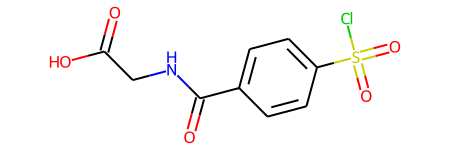

*****************
Analog #1


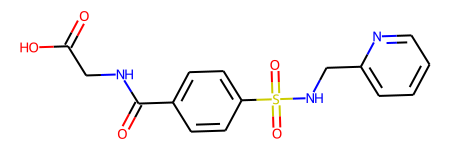

SMILES:O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCc2ccccn2)cc1
*******************
Analog #2


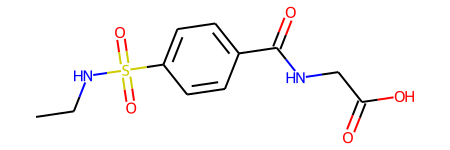

SMILES:CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1
*******************
Analog #3


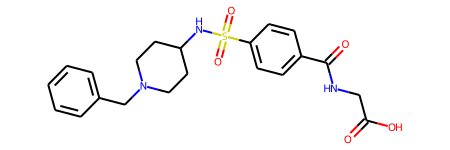

SMILES:O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC2CCN(Cc3ccccc3)CC2)cc1
*******************
Analog #4


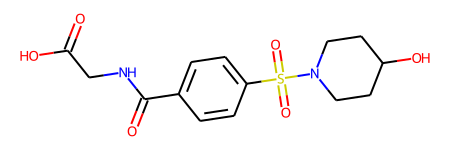

SMILES:O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCC(O)CC2)cc1
*******************
Analog #5


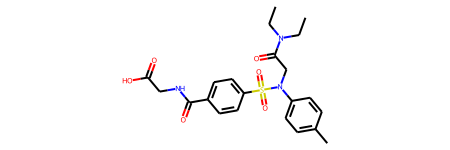

SMILES:CCN(CC)C(=O)CN(c1ccc(C)cc1)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1
*******************


In [54]:
#randomly sample 5 examples
iteration_1_5examples = iteration_1.sample (n = 5)
count = 0
for row in iteration_1_5examples.itertuples():
    count += 1
    if count == 1:
        print ('Input Compound:{}'.format (row[2]))
        reac = Chem.MolFromSmiles(row[2])
        display (reac)
        print ('*****************')
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

SMILES: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1, reactant input:


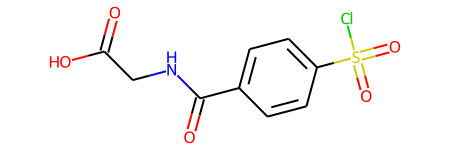



--------------------------------------------------

Train index: 407939
RANK 1 PRECEDENT
REACTANT MATCH SCORE: 0.7659574468085106


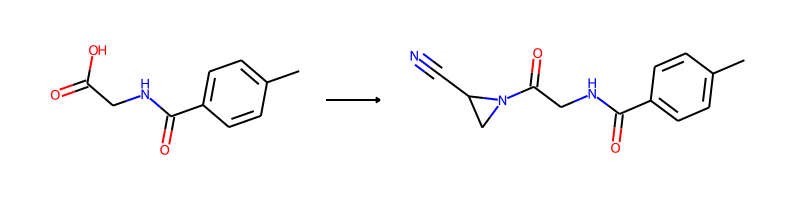

-> template: [C:2]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:3]>>N#C-C1-C-N-1-[C;H0;D3;+0:1](-[C:2])=[O;H0;D1;+0:3]


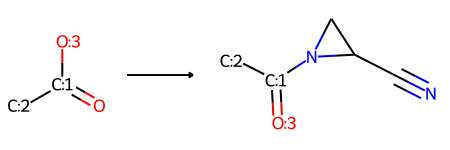

Product similarity 0.8135593220338984, overall 0.6231518211323477, smiles N#CC1CN1C(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


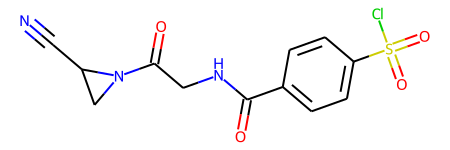

The proposed reaction is:


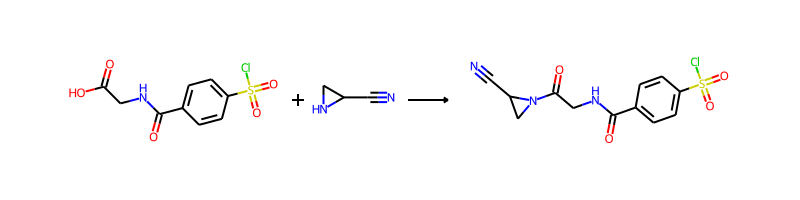

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.N#CC1CN1>>N#CC1CN1C(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 80855
RANK 2 PRECEDENT
REACTANT MATCH SCORE: 0.6666666666666666


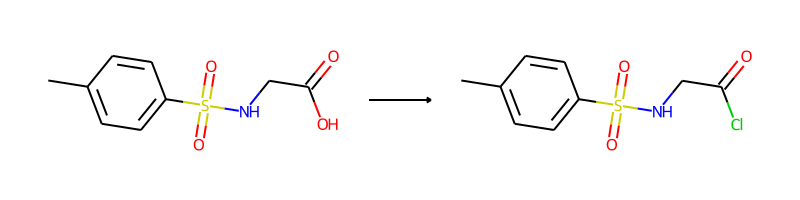

-> template: [C:2]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:3]>>Cl-[C;H0;D3;+0:1](-[C:2])=[O;H0;D1;+0:3]


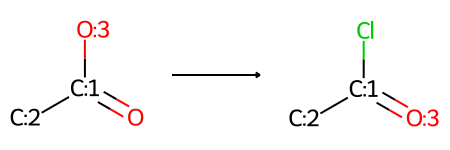

Product similarity 0.6666666666666666, overall 0.4444444444444444, smiles O=C(Cl)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


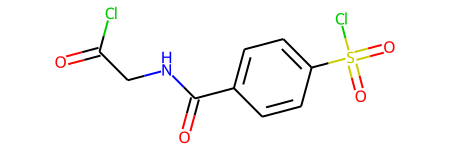

The proposed reaction is:


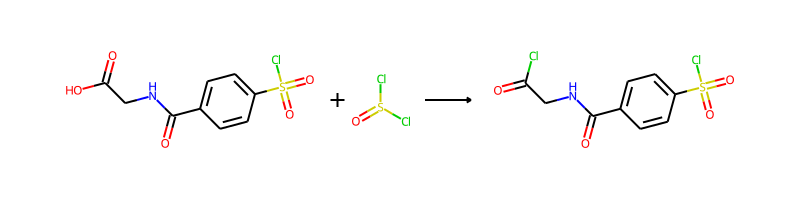

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.O=S(Cl)Cl>>O=C(Cl)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 317174
RANK 3 PRECEDENT
REACTANT MATCH SCORE: 0.66


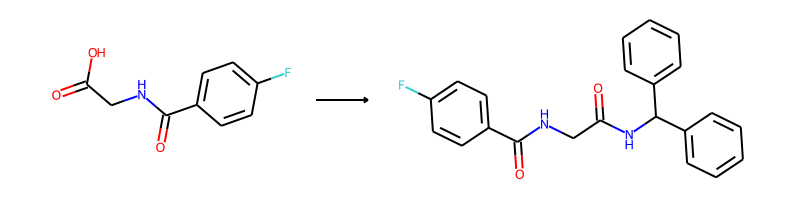

-> template: [C:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0])-[OH;D1;+0:3]>>[C:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0:3])-N-C(-c1:c:c:c:c:c:1)-c1:c:c:c:c:c:1


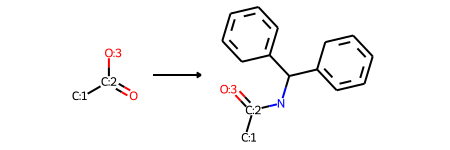

Product similarity 0.8111111111111111, overall 0.5353333333333333, smiles O=C(CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)NC(c1ccccc1)c1ccccc1


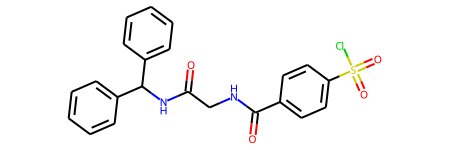

The proposed reaction is:


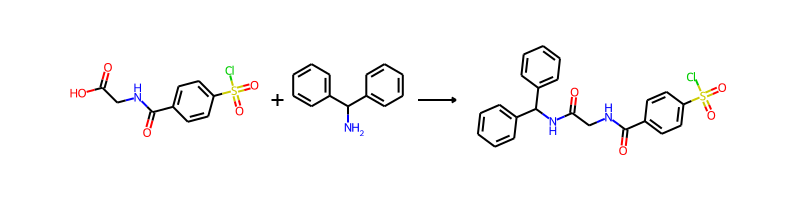

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC(c1ccccc1)c1ccccc1>>O=C(CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)NC(c1ccccc1)c1ccccc1


--------------------------------------------------

Train index: 86420
RANK 4 PRECEDENT
REACTANT MATCH SCORE: 0.6530612244897959


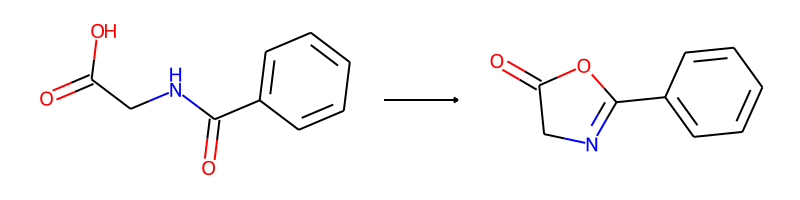

-> template: [O;D1;H0:1]=[C:2](-[OH;D1;+0:7])-[C:3]-[NH;D2;+0:4]-[C;H0;D3;+0:5](=[O;H0;D1;+0])-[c:6]>>[O;D1;H0:1]=[C:2]1-[C:3]-[N;H0;D2;+0:4]=[C;H0;D3;+0:5](-[c:6])-[O;H0;D2;+0:7]-1


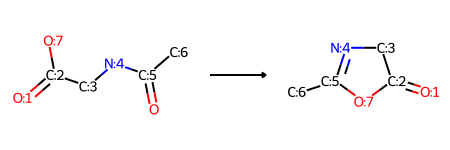

Product similarity 0.6458333333333334, overall 0.42176870748299317, smiles O=C1CN=C(c2ccc(S(=O)(=O)Cl)cc2)O1


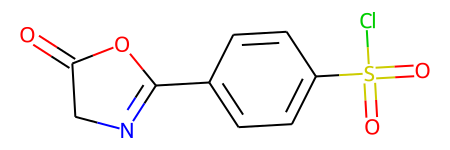

The proposed reaction is:


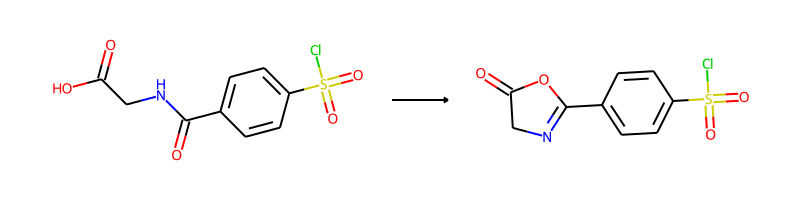

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1>>O=C1CN=C(c2ccc(S(=O)(=O)Cl)cc2)O1


--------------------------------------------------

Train index: 409531
RANK 5 PRECEDENT
REACTANT MATCH SCORE: 0.6530612244897959


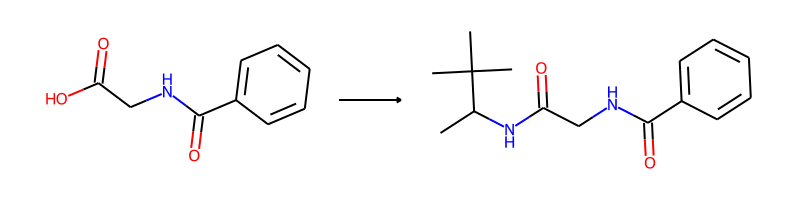

-> template: [C:2]-[C;H0;D3;+0:1](=[O;D1;H0:3])-[O;H1;D1;+0]>>C-C(-N-[C;H0;D3;+0:1](-[C:2])=[O;D1;H0:3])-C(-C)(-C)-C


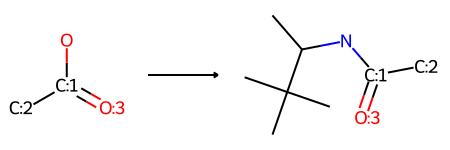

Product similarity 0.734375, overall 0.47959183673469385, smiles CC(NC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)C(C)(C)C


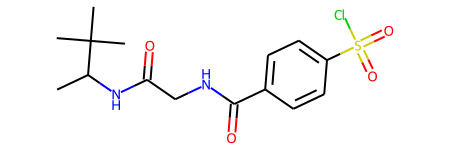

The proposed reaction is:


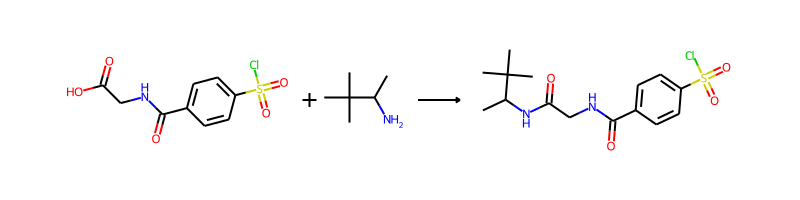

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(N)C(C)(C)C>>CC(NC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)C(C)(C)C


--------------------------------------------------

Train index: 71203
RANK 6 PRECEDENT
REACTANT MATCH SCORE: 0.6530612244897959


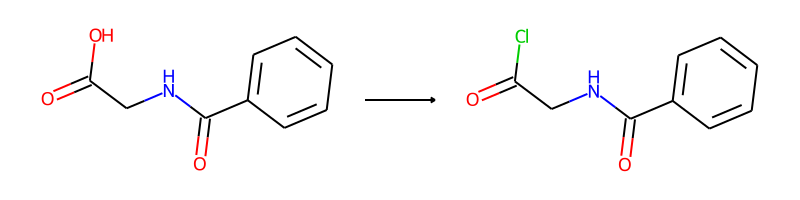

-> template: [C:2]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:3]>>Cl-[C;H0;D3;+0:1](-[C:2])=[O;H0;D1;+0:3]


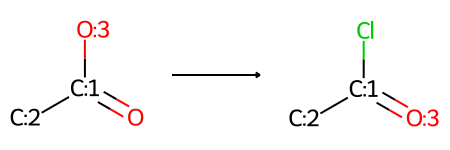

Product similarity 0.6530612244897959, overall 0.4264889629321115, smiles O=C(Cl)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


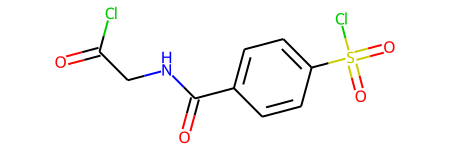

The proposed reaction is:


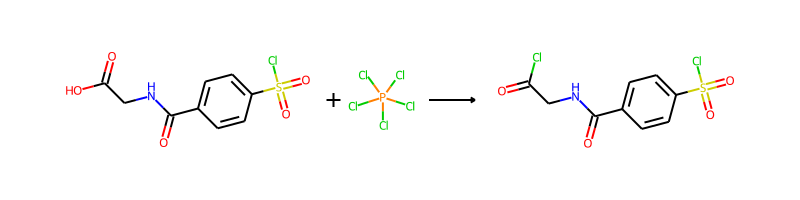

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.ClP(Cl)(Cl)(Cl)Cl>>O=C(Cl)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 109222
RANK 7 PRECEDENT
REACTANT MATCH SCORE: 0.62


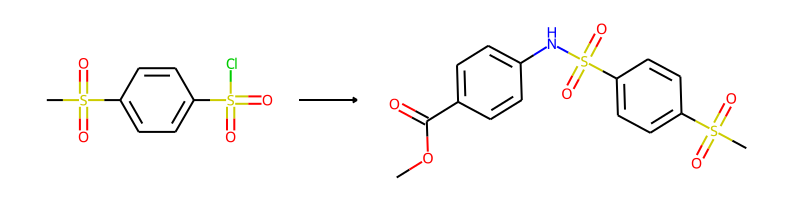

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-O-C(=O)-c1:c:c:c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c:c:1


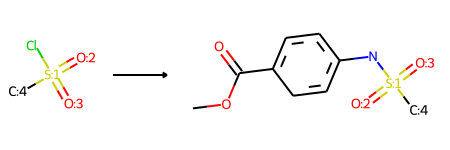

Product similarity 0.759493670886076, overall 0.4708860759493671, smiles COC(=O)c1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


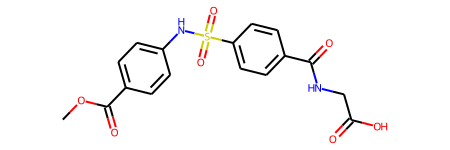

The proposed reaction is:


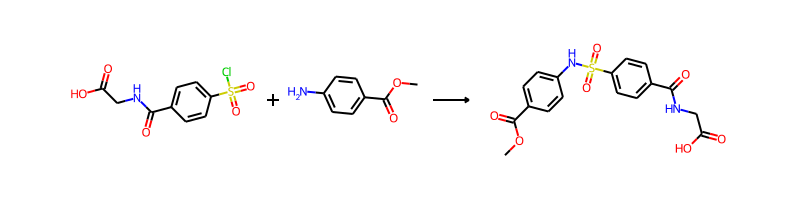

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COC(=O)c1ccc(N)cc1>>COC(=O)c1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


--------------------------------------------------

Train index: 152727
RANK 8 PRECEDENT
REACTANT MATCH SCORE: 0.62


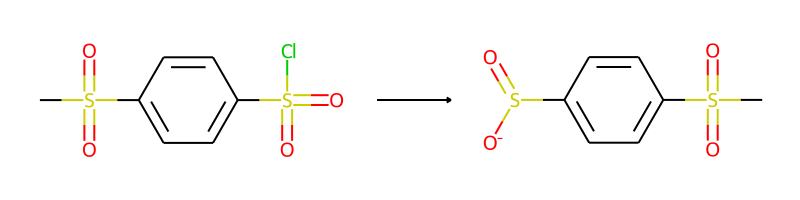

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:3])(=[O;H0;D1;+0:1])-[c:4]>>[O-;H0;D1:1]-[S;H0;D3;+0:2](=[O;D1;H0:3])-[c:4]


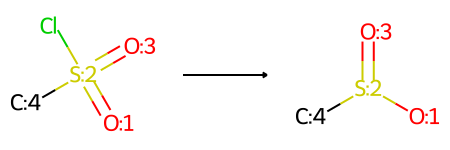

Product similarity 0.6041666666666666, overall 0.3745833333333333, smiles O=C(O)CNC(=O)c1ccc(S(=O)[O-])cc1


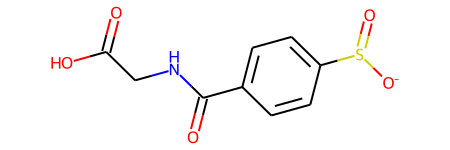

The proposed reaction is:


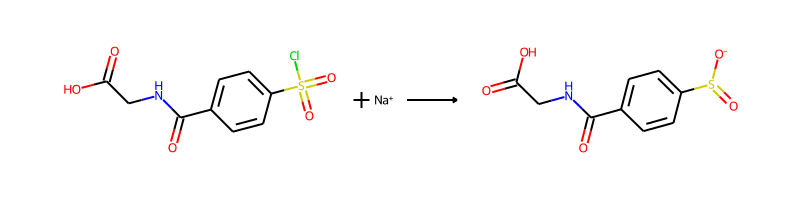

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[Na+]>>O=C(O)CNC(=O)c1ccc(S(=O)[O-])cc1


--------------------------------------------------

Train index: 361069
RANK 9 PRECEDENT
REACTANT MATCH SCORE: 0.6181818181818182


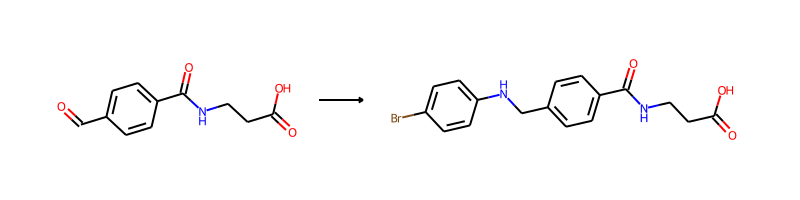

-> template: [O;H0;D1;+0]=[CH;D2;+0:1]-[c:2]>>Br-c1:c:c:c(-N-[CH2;D2;+0:1]-[c:2]):c:c:1


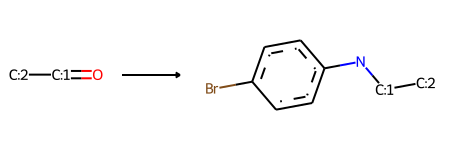

->No precursors could be generated!


--------------------------------------------------

Train index: 308348
RANK 10 PRECEDENT
REACTANT MATCH SCORE: 0.6181818181818182


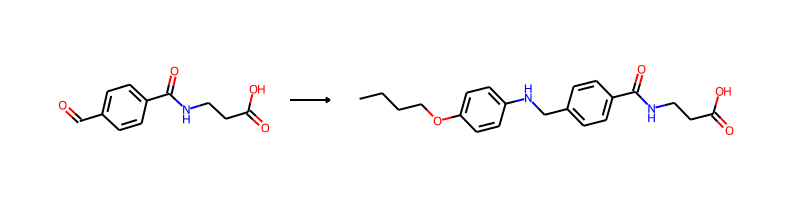

-> template: [O;H0;D1;+0]=[CH;D2;+0:1]-[c:2]>>C-C-C-C-O-c1:c:c:c(-N-[CH2;D2;+0:1]-[c:2]):c:c:1


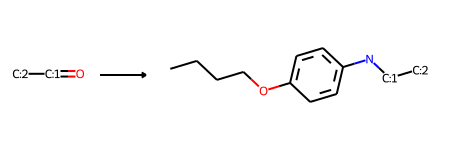

->No precursors could be generated!


--------------------------------------------------

Train index: 29883
RANK 11 PRECEDENT
REACTANT MATCH SCORE: 0.6078431372549019


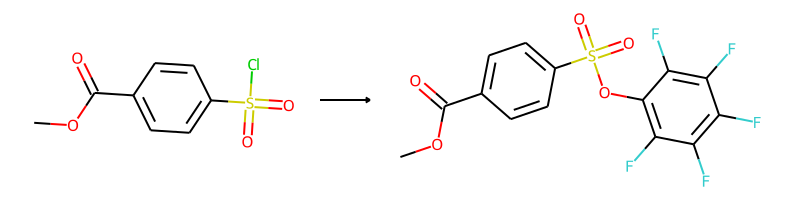

-> template: [C:8]-[c:7]1:[c:6]:[c:5]:[c:4](-[S;H0;D4;+0:1](-[Cl;H0;D1;+0])(=[O;D1;H0:2])=[O;D1;H0:3]):[c:10]:[c:9]:1>>F-c1:c(-F):c(-F):c(-O-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]2:[c:5]:[c:6]:[c:7](-[C:8]):[c:9]:[c:10]:2):c(-F):c:1-F


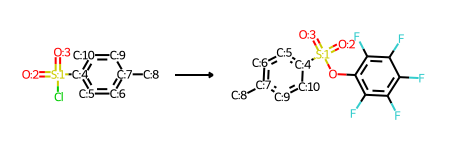

Product similarity 0.75, overall 0.4558823529411764, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Oc2c(F)c(F)c(F)c(F)c2F)cc1


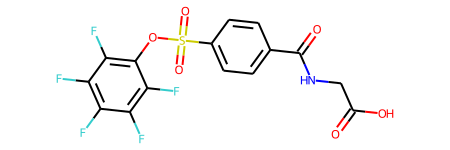

The proposed reaction is:


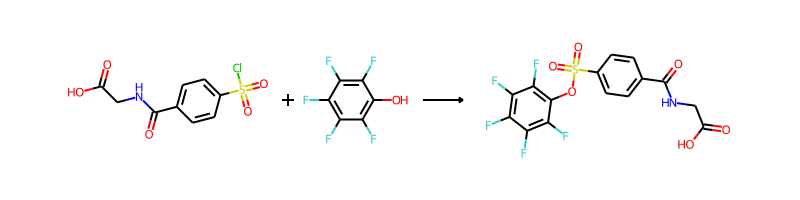

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Oc1c(F)c(F)c(F)c(F)c1F>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Oc2c(F)c(F)c(F)c(F)c2F)cc1


--------------------------------------------------

Train index: 26753
RANK 12 PRECEDENT
REACTANT MATCH SCORE: 0.6078431372549019


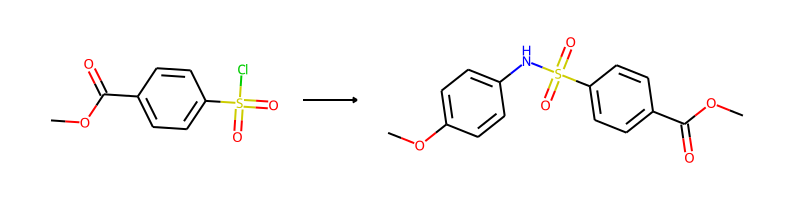

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-O-c1:c:c:c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c:c:1


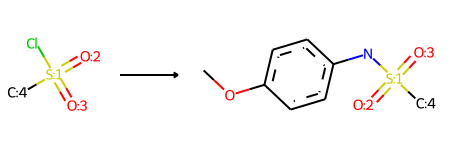

Product similarity 0.7333333333333333, overall 0.445751633986928, smiles COc1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


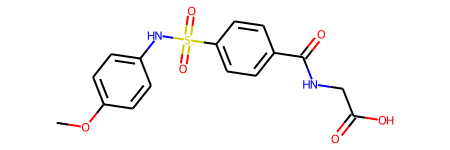

The proposed reaction is:


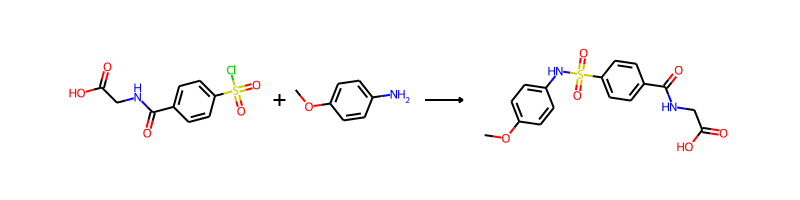

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COc1ccc(N)cc1>>COc1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


--------------------------------------------------

Train index: 393528
RANK 13 PRECEDENT
REACTANT MATCH SCORE: 0.6078431372549019


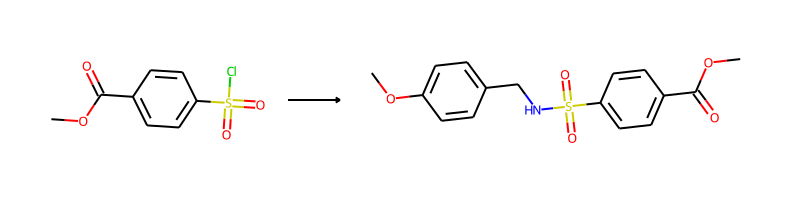

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-O-c1:c:c:c(-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c:c:1


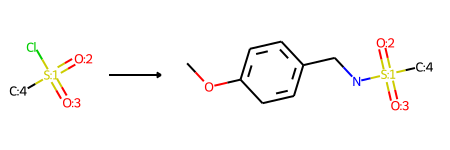

Product similarity 0.7435897435897436, overall 0.4519859225741579, smiles COc1ccc(CNS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


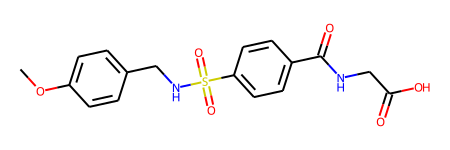

The proposed reaction is:


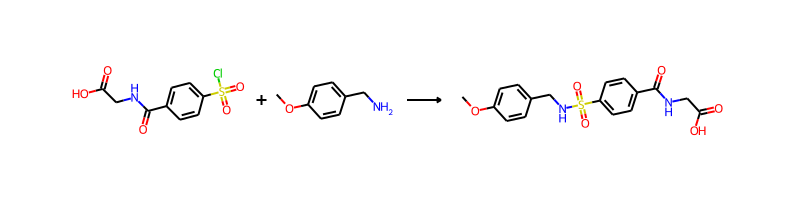

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COc1ccc(CN)cc1>>COc1ccc(CNS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


--------------------------------------------------

Train index: 25351
RANK 14 PRECEDENT
REACTANT MATCH SCORE: 0.6041666666666666


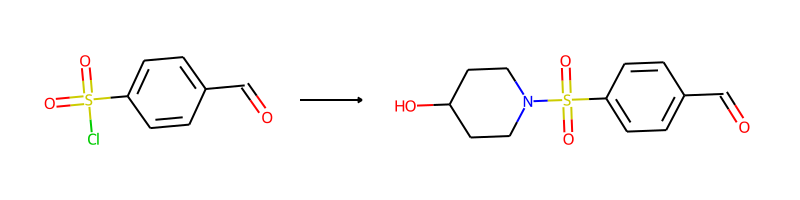

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>O-C1-C-C-N(-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4])-C-C-1


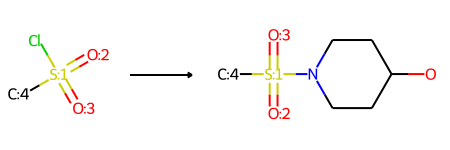

Product similarity 0.7121212121212122, overall 0.430239898989899, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCC(O)CC2)cc1


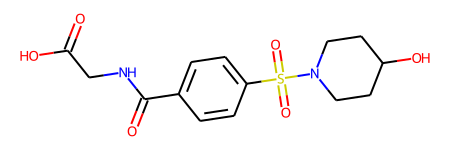

The proposed reaction is:


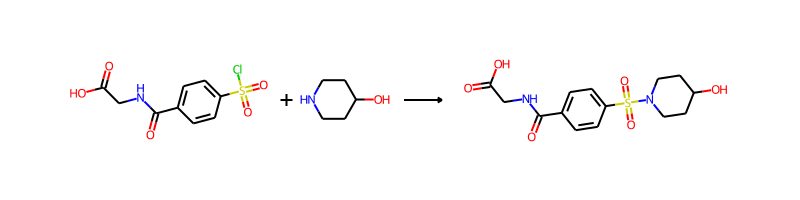

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.OC1CCNCC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCC(O)CC2)cc1


--------------------------------------------------

Train index: 305737
RANK 15 PRECEDENT
REACTANT MATCH SCORE: 0.6


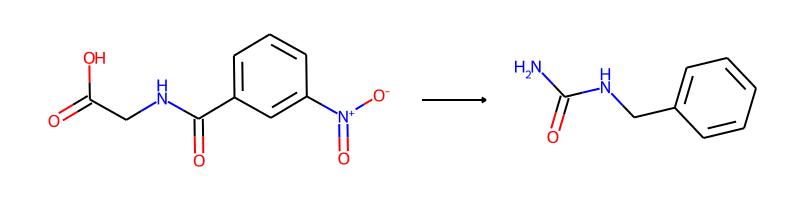

-> template: [O-;H0;D1]-[N+;H0;D3:1](=[O;H0;D1;+0])-[c;H0;D3;+0]1:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H1;D2;+0]:[c;H0;D3;+0](-[C;H0;D3;+0](=[O;H0;D1;+0])-[N;H1;D2;+0]-[C;H2;D2;+0]-[C;H0;D3;+0](=[O;H0;D1;+0])-[O;H1;D1;+0]):[c;H1;D2;+0]:1>>O=C(-[NH2;D1;+0:1])-N-C-c1:c:c:c:c:c:1


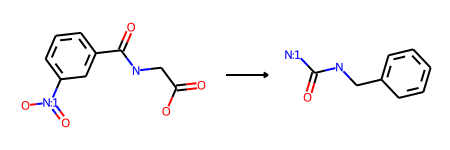

->No precursors could be generated!


--------------------------------------------------

Train index: 36998
RANK 16 PRECEDENT
REACTANT MATCH SCORE: 0.5862068965517241


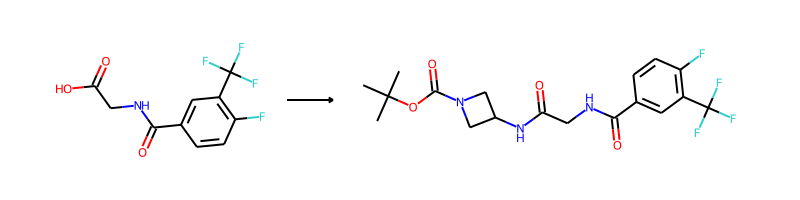

-> template: [C:2]-[C;H0;D3;+0:1](=[O;D1;H0:3])-[O;H1;D1;+0]>>C-C(-C)(-C)-O-C(=O)-N1-C-C(-N-[C;H0;D3;+0:1](-[C:2])=[O;D1;H0:3])-C-1


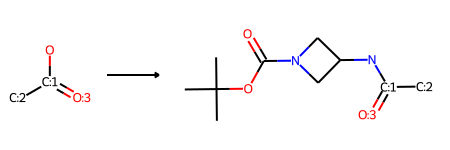

Product similarity 0.7241379310344828, overall 0.42449464922711055, smiles CC(C)(C)OC(=O)N1CC(NC(=O)CNC(=O)c2ccc(S(=O)(=O)Cl)cc2)C1


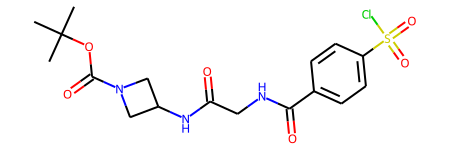

The proposed reaction is:


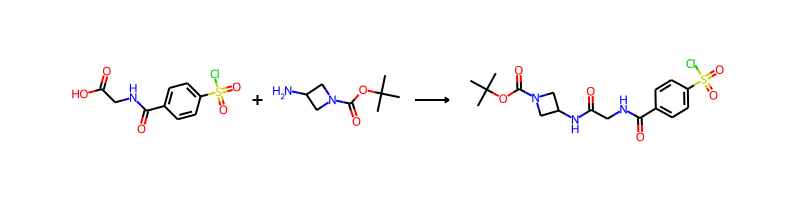

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)(C)OC(=O)N1CC(N)C1>>CC(C)(C)OC(=O)N1CC(NC(=O)CNC(=O)c2ccc(S(=O)(=O)Cl)cc2)C1


--------------------------------------------------

Train index: 277724
RANK 17 PRECEDENT
REACTANT MATCH SCORE: 0.58


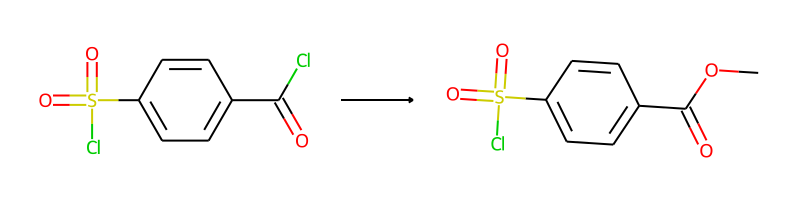

-> template: [Cl;H0;D1;+0]-[C;H0;D3;+0:1](=[O;D1;H0:2])-[c:3]>>C-O-[C;H0;D3;+0:1](=[O;D1;H0:2])-[c:3]


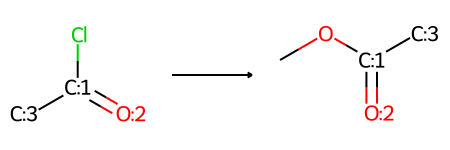

->No precursors could be generated!


--------------------------------------------------

Train index: 356000
RANK 18 PRECEDENT
REACTANT MATCH SCORE: 0.574468085106383


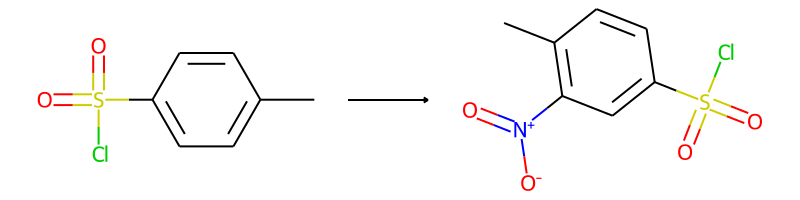

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O=[N+](-[O-])-[c;H0;D3;+0:1](:[c:2]):[c:3]


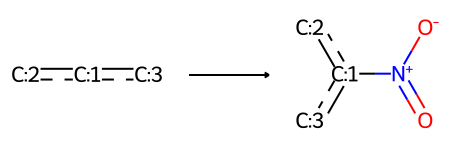

Product similarity 0.6296296296296297, overall 0.3617021276595745, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1[N+](=O)[O-]


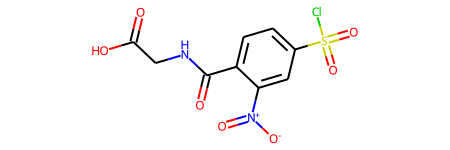

The proposed reaction is:


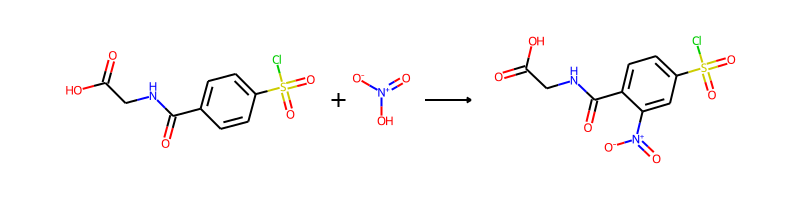

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.O=[N+]([O-])O>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1[N+](=O)[O-]
Product similarity 0.6, overall 0.3446808510638298, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)c([N+](=O)[O-])c1


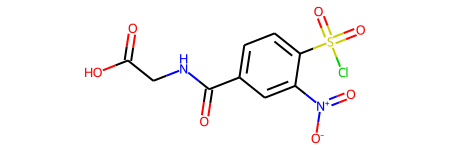

The proposed reaction is:


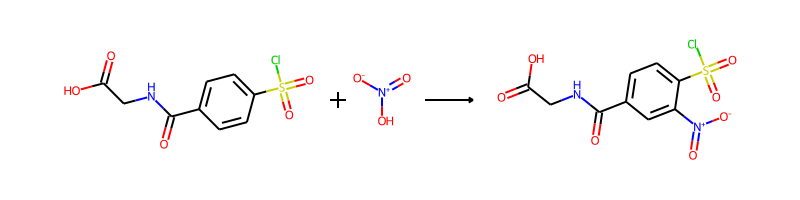

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.O=[N+]([O-])O>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)c([N+](=O)[O-])c1


--------------------------------------------------

Train index: 258567
RANK 19 PRECEDENT
REACTANT MATCH SCORE: 0.574468085106383


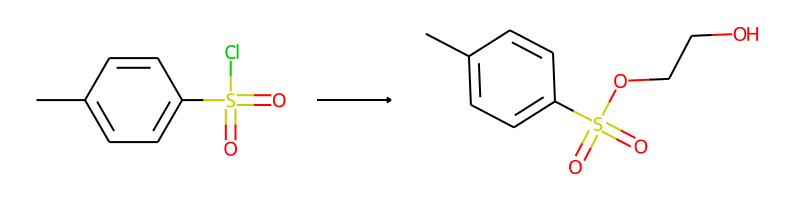

-> template: [C;D1;H3:8]-[c:7]1:[c:6]:[c:5]:[c:4](-[S;H0;D4;+0:1](-[Cl;H0;D1;+0])(=[O;D1;H0:2])=[O;D1;H0:3]):[c:10]:[c:9]:1>>O-C-C-O-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]1:[c:5]:[c:6]:[c:7](-[C;D1;H3:8]):[c:9]:[c:10]:1


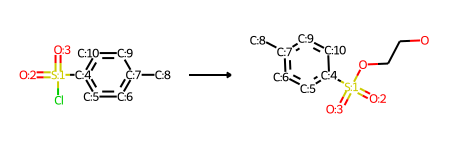

->No precursors could be generated!


--------------------------------------------------

Train index: 64300
RANK 20 PRECEDENT
REACTANT MATCH SCORE: 0.574468085106383


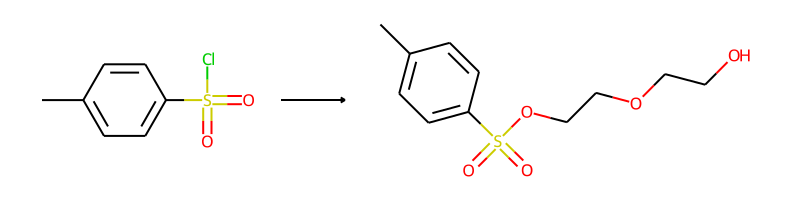

-> template: [C;D1;H3:8]-[c:7]1:[c:6]:[c:5]:[c:4](-[S;H0;D4;+0:1](-[Cl;H0;D1;+0])(=[O;D1;H0:2])=[O;D1;H0:3]):[c:10]:[c:9]:1>>O-C-C-O-C-C-O-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]1:[c:5]:[c:6]:[c:7](-[C;D1;H3:8]):[c:9]:[c:10]:1


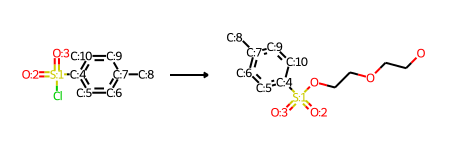

->No precursors could be generated!


--------------------------------------------------

Train index: 18294
RANK 21 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


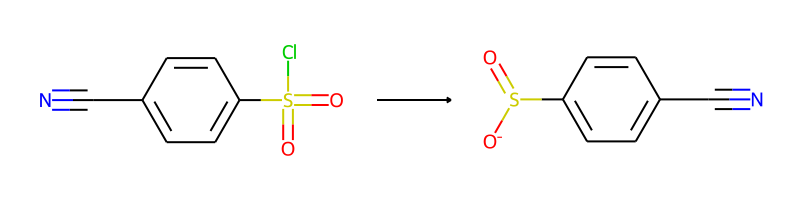

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:3])(=[O;H0;D1;+0:1])-[c:4]>>[O-;H0;D1:1]-[S;H0;D3;+0:2](=[O;D1;H0:3])-[c:4]


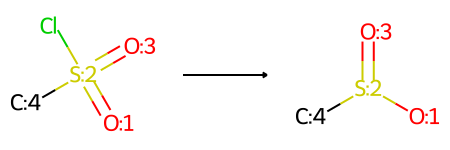

Product similarity 0.5531914893617021, overall 0.3161094224924012, smiles O=C(O)CNC(=O)c1ccc(S(=O)[O-])cc1


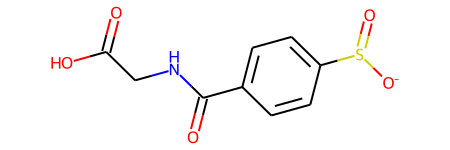

The proposed reaction is:


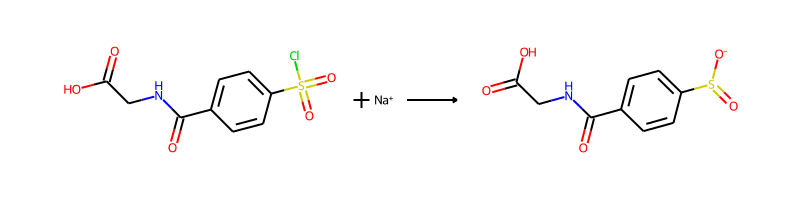

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[Na+]>>O=C(O)CNC(=O)c1ccc(S(=O)[O-])cc1


--------------------------------------------------

Train index: 371098
RANK 22 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


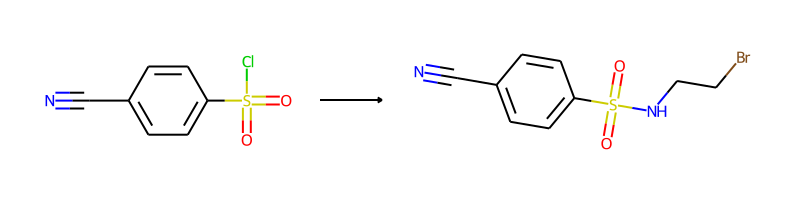

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>Br-C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


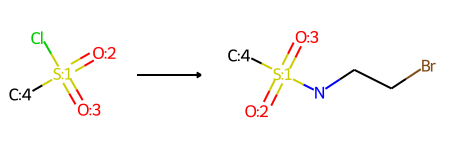

Product similarity 0.6379310344827587, overall 0.3645320197044335, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCBr)cc1


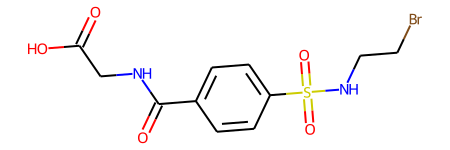

The proposed reaction is:


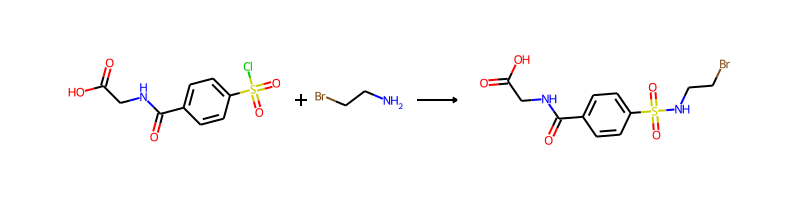

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NCCBr>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCBr)cc1


--------------------------------------------------

Train index: 115910
RANK 23 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


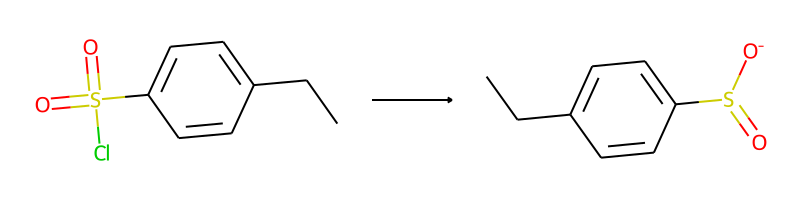

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:3])(=[O;H0;D1;+0:1])-[c:4]>>[O-;H0;D1:1]-[S;H0;D3;+0:2](=[O;D1;H0:3])-[c:4]


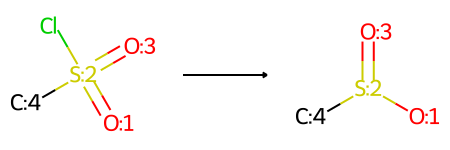

Product similarity 0.5531914893617021, overall 0.3161094224924012, smiles O=C(O)CNC(=O)c1ccc(S(=O)[O-])cc1


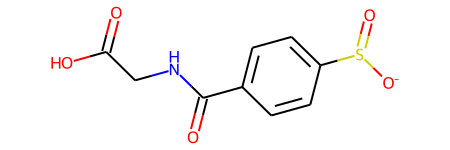

The proposed reaction is:


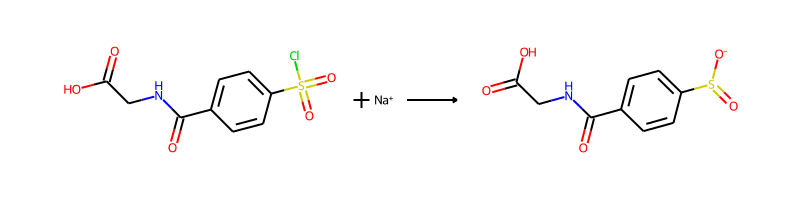

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[Na+]>>O=C(O)CNC(=O)c1ccc(S(=O)[O-])cc1


--------------------------------------------------

Train index: 153353
RANK 24 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


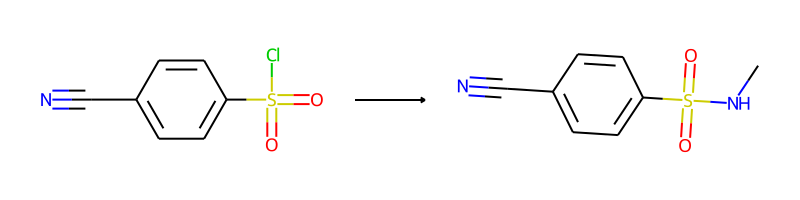

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


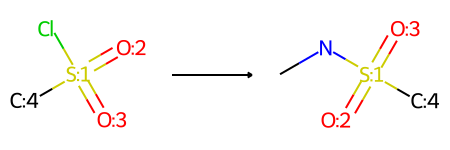

Product similarity 0.5961538461538461, overall 0.3406593406593406, smiles CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


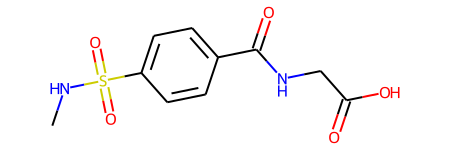

The proposed reaction is:


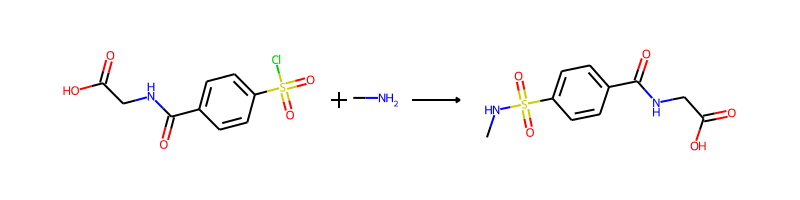

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CN>>CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 313853
RANK 25 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


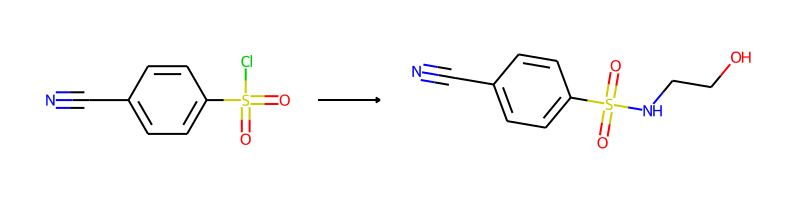

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>O-C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


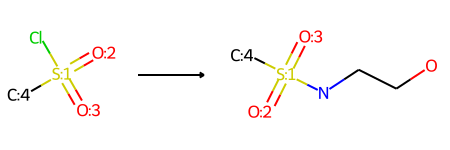

Product similarity 0.6379310344827587, overall 0.3645320197044335, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCO)cc1


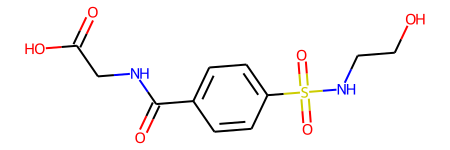

The proposed reaction is:


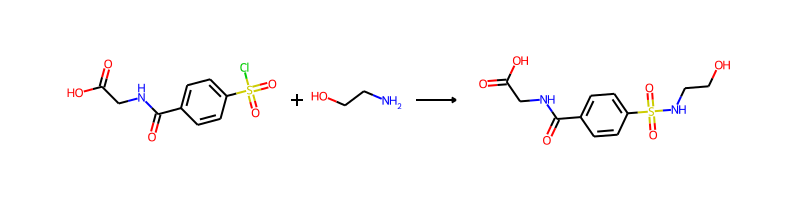

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NCCO>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCO)cc1


--------------------------------------------------

Train index: 172306
RANK 26 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


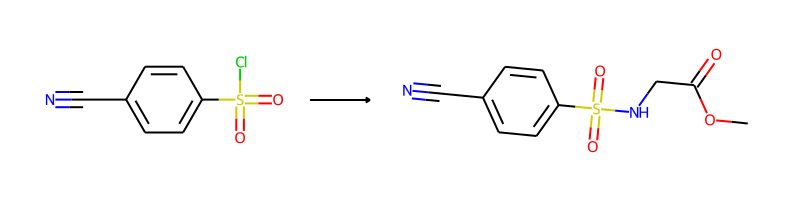

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-O-C(=O)-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


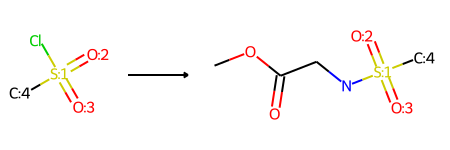

Product similarity 0.6666666666666666, overall 0.38095238095238093, smiles COC(=O)CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


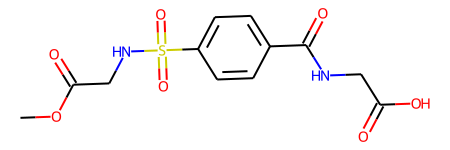

The proposed reaction is:


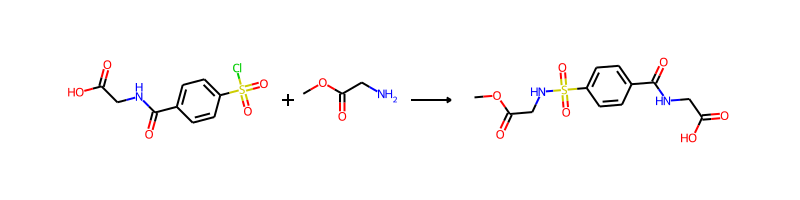

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COC(=O)CN>>COC(=O)CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 302693
RANK 27 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


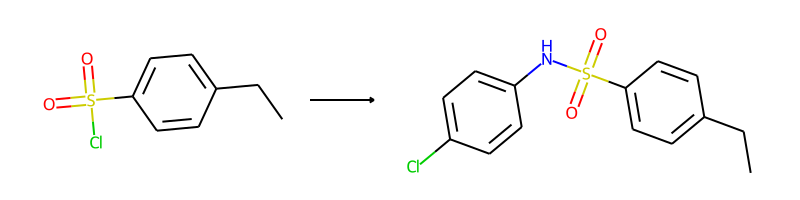

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>Cl-c1:c:c:c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c:c:1


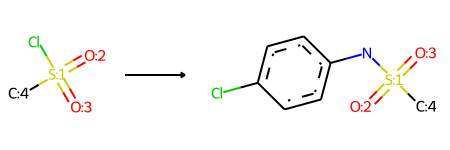

Product similarity 0.7, overall 0.39999999999999997, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccc(Cl)cc2)cc1


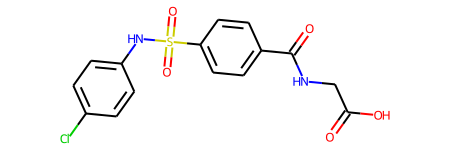

The proposed reaction is:


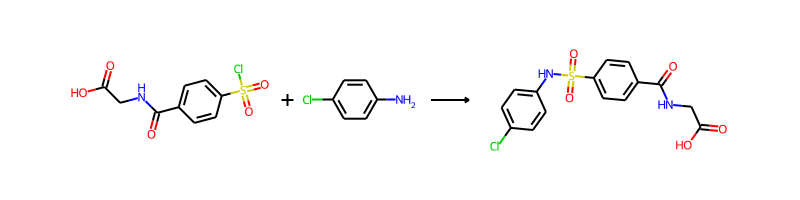

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Nc1ccc(Cl)cc1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccc(Cl)cc2)cc1


--------------------------------------------------

Train index: 2901
RANK 28 PRECEDENT
REACTANT MATCH SCORE: 0.5714285714285714


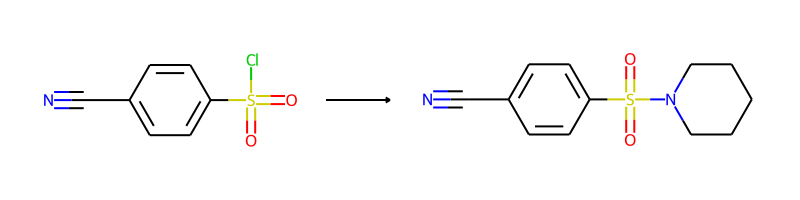

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-C-C-C-1


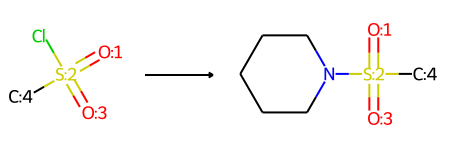

Product similarity 0.676923076923077, overall 0.3868131868131868, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


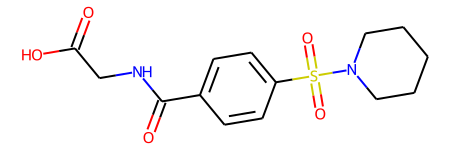

The proposed reaction is:


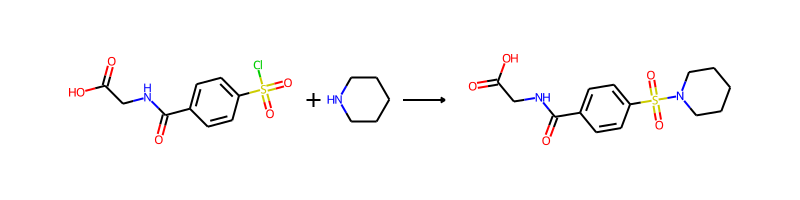

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1CCNCC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


--------------------------------------------------

Train index: 295426
RANK 29 PRECEDENT
REACTANT MATCH SCORE: 0.5636363636363636


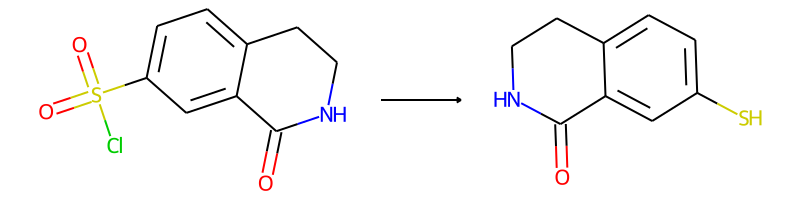

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;H0;D1;+0])(=[O;H0;D1;+0])-[c:2]>>[SH;D1;+0:1]-[c:2]


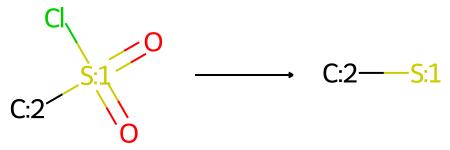

Product similarity 0.5, overall 0.2818181818181818, smiles O=C(O)CNC(=O)c1ccc(S)cc1


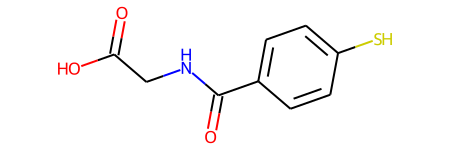

The proposed reaction is:


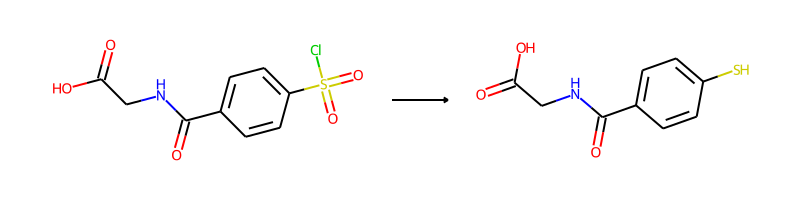

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1>>O=C(O)CNC(=O)c1ccc(S)cc1


--------------------------------------------------

Train index: 17215
RANK 30 PRECEDENT
REACTANT MATCH SCORE: 0.5625


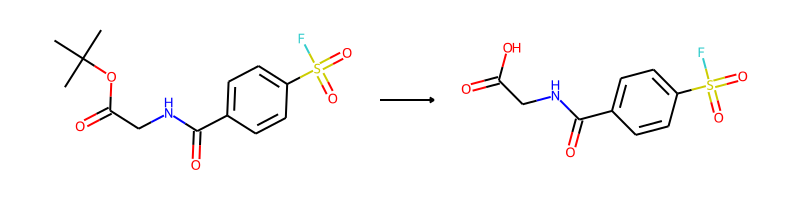

-> template: [C:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0:4])-[O;H0;D2;+0:3]-[C;H0;D4;+0](-[C;H3;D1;+0])(-[C;H3;D1;+0])-[C;H3;D1;+0]>>[C:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0:3])-[OH;D1;+0:4]


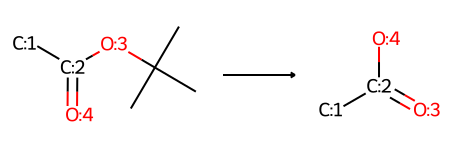

->No precursors could be generated!


--------------------------------------------------

Train index: 330678
RANK 31 PRECEDENT
REACTANT MATCH SCORE: 0.5614035087719298


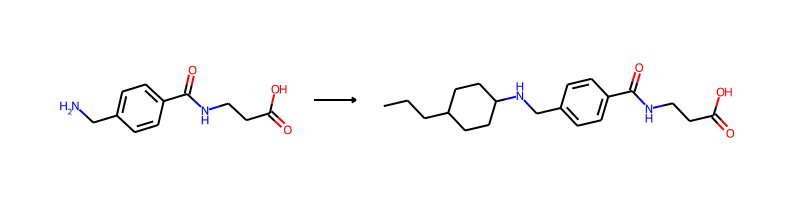

-> template: [C:2]-[NH2;D1;+0:1]>>C-C-C-C1-C-C-C(-[NH;D2;+0:1]-[C:2])-C-C-1


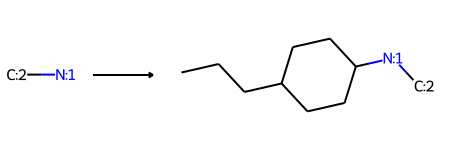

->No precursors could be generated!


--------------------------------------------------

Train index: 295447
RANK 32 PRECEDENT
REACTANT MATCH SCORE: 0.5576923076923077


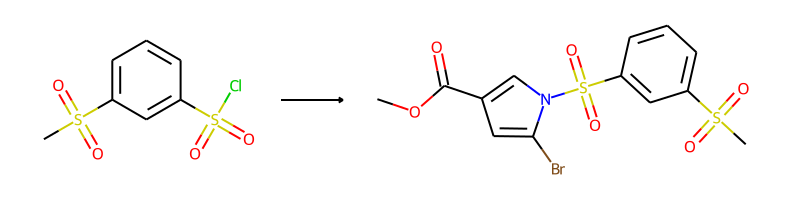

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>Br-c1:c:c(-C(=O)-O-C):c:n:1-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


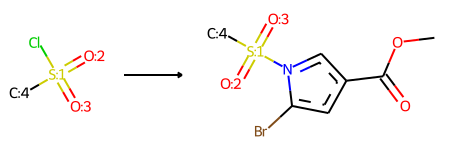

Product similarity 0.7012987012987013, overall 0.39110889110889113, smiles COC(=O)c1cc(Br)n(S(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)c1


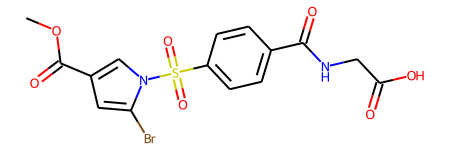

The proposed reaction is:


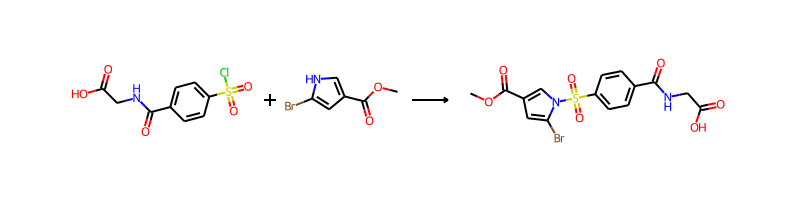

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COC(=O)c1c[nH]c(Br)c1>>COC(=O)c1cc(Br)n(S(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)c1


--------------------------------------------------

Train index: 126447
RANK 33 PRECEDENT
REACTANT MATCH SCORE: 0.5555555555555556


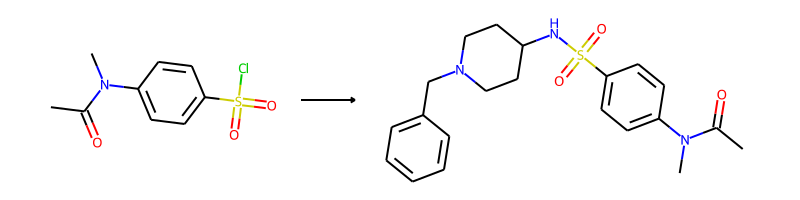

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-C1-C-C-N(-C-c2:c:c:c:c:c:2)-C-C-1


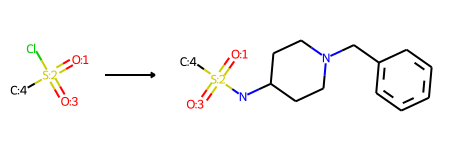

Product similarity 0.7446808510638298, overall 0.41371158392434987, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC2CCN(Cc3ccccc3)CC2)cc1


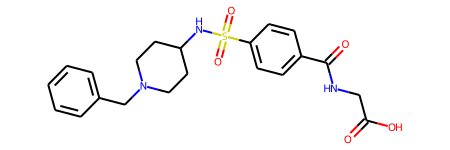

The proposed reaction is:


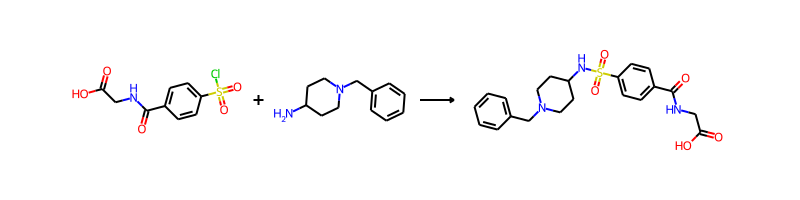

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC1CCN(Cc2ccccc2)CC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC2CCN(Cc3ccccc3)CC2)cc1


--------------------------------------------------

Train index: 17674
RANK 34 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


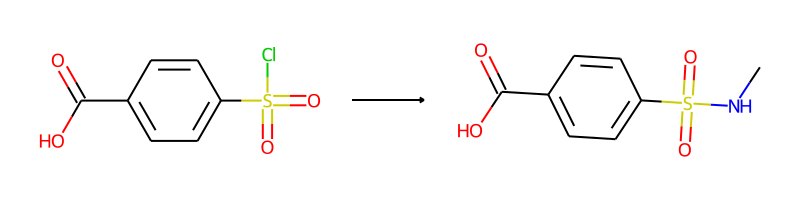

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


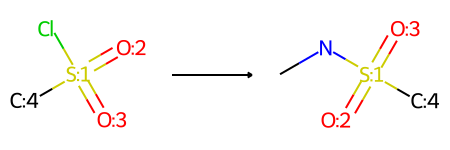

Product similarity 0.5740740740740741, overall 0.3151779230210603, smiles CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


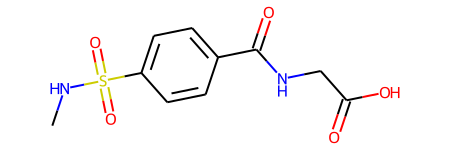

The proposed reaction is:


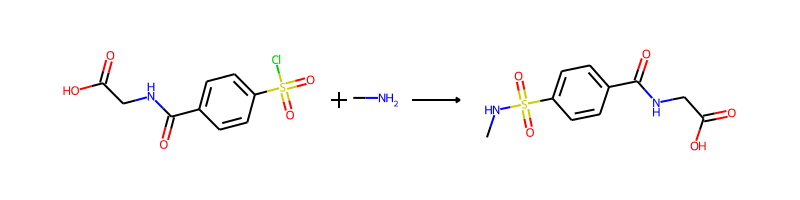

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CN>>CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 9607
RANK 35 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


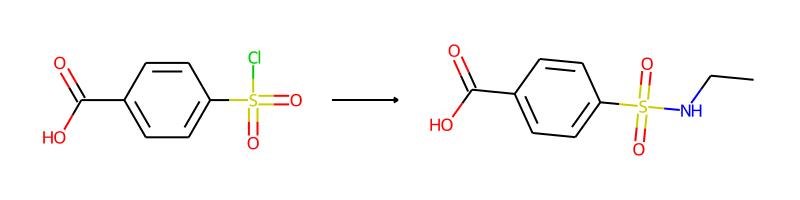

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


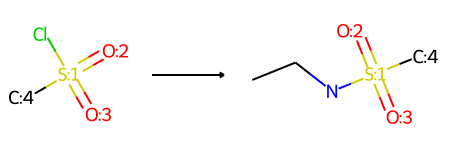

Product similarity 0.5964912280701754, overall 0.3274853801169591, smiles CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


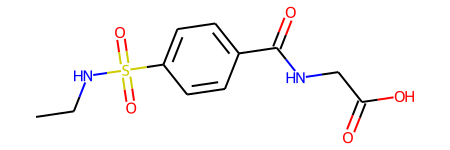

The proposed reaction is:


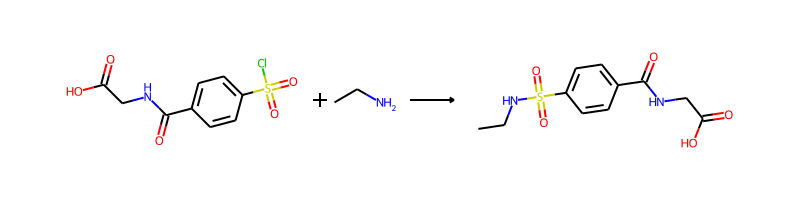

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCN>>CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 45576
RANK 36 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


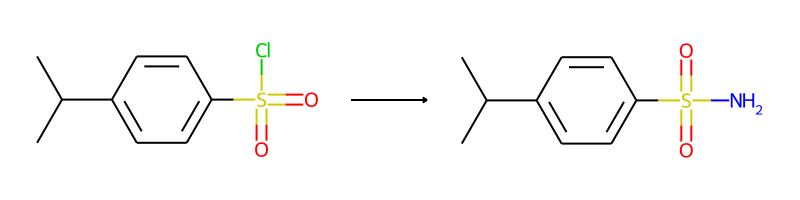

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


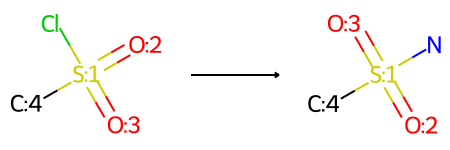

Product similarity 0.5490196078431373, overall 0.3014225297962323, smiles NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


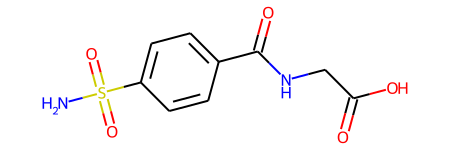

The proposed reaction is:


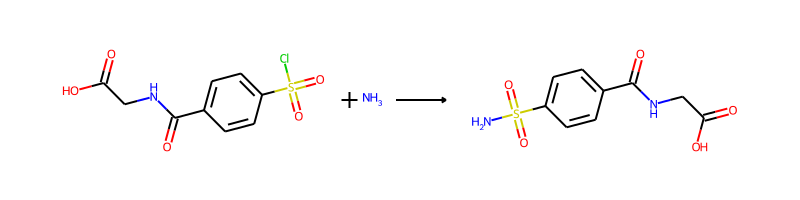

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.N>>NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 102498
RANK 37 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


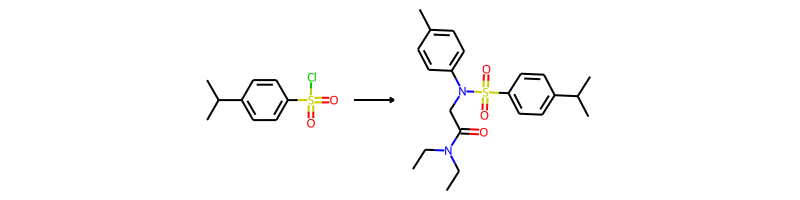

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-N(-C-C)-C(=O)-C-N(-c1:c:c:c(-C):c:c:1)-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


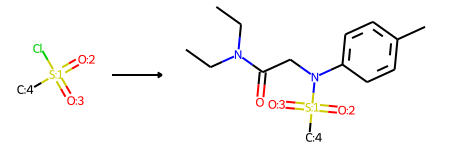

Product similarity 0.7526881720430108, overall 0.4132405650432216, smiles CCN(CC)C(=O)CN(c1ccc(C)cc1)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


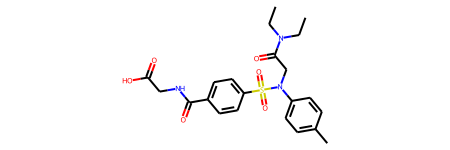

The proposed reaction is:


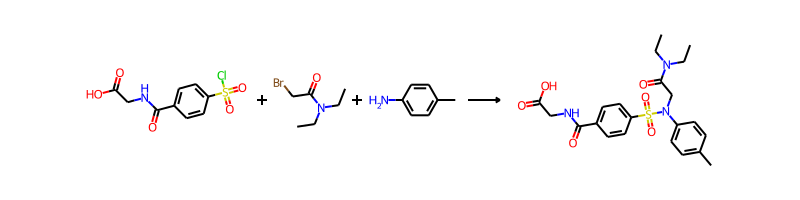

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCN(CC)C(=O)CBr.Cc1ccc(N)cc1>>CCN(CC)C(=O)CN(c1ccc(C)cc1)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 114430
RANK 38 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


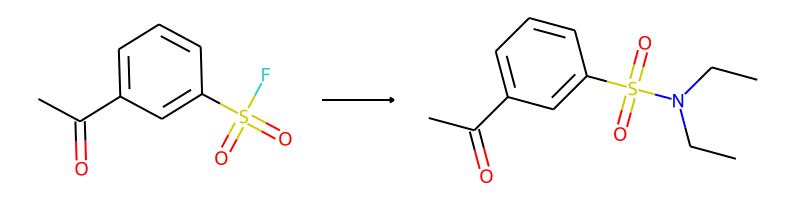

-> template: [F;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-N(-C-C)-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


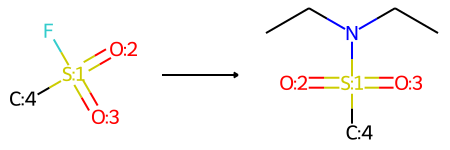

->No precursors could be generated!


--------------------------------------------------

Train index: 80169
RANK 39 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


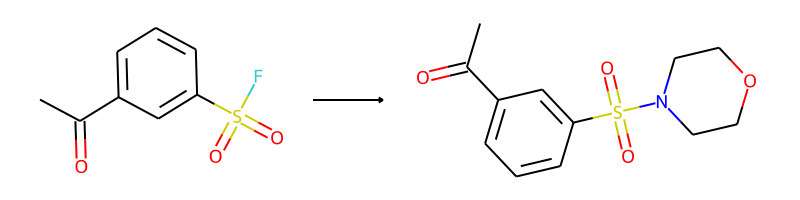

-> template: [F;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-O-C-C-1


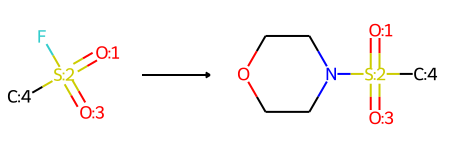

->No precursors could be generated!


--------------------------------------------------

Train index: 249843
RANK 40 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


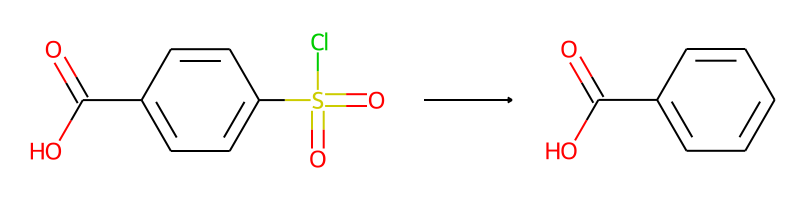

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0](=[O;H0;D1;+0])(=[O;H0;D1;+0])-[c;H0;D3;+0:2](:[c:1]):[c:3]>>[c:1]:[cH;D2;+0:2]:[c:3]


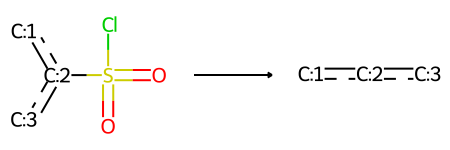

Product similarity 0.4523809523809524, overall 0.24836601307189546, smiles O=C(O)CNC(=O)c1ccccc1


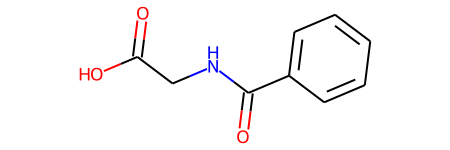

The proposed reaction is:


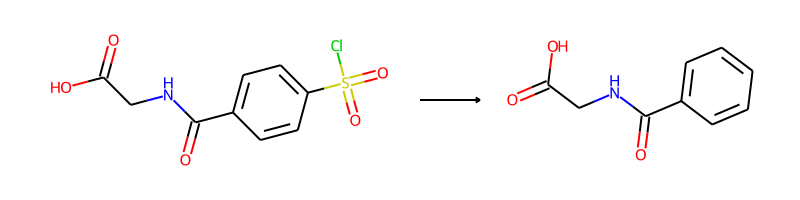

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1>>O=C(O)CNC(=O)c1ccccc1


--------------------------------------------------

Train index: 351225
RANK 41 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


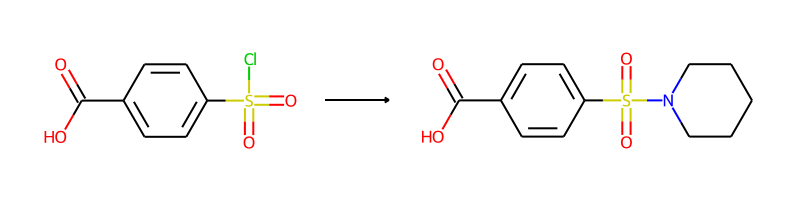

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-C-C-C-1


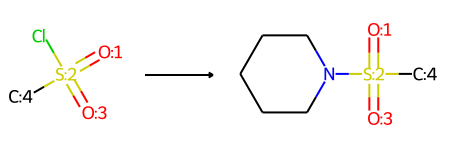

Product similarity 0.6567164179104478, overall 0.3605501902253439, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


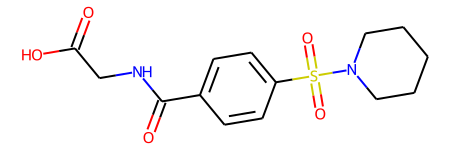

The proposed reaction is:


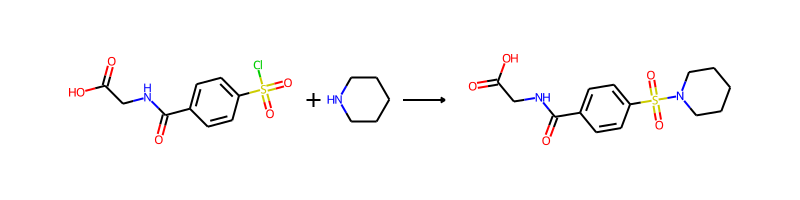

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1CCNCC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


--------------------------------------------------

Train index: 146816
RANK 42 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


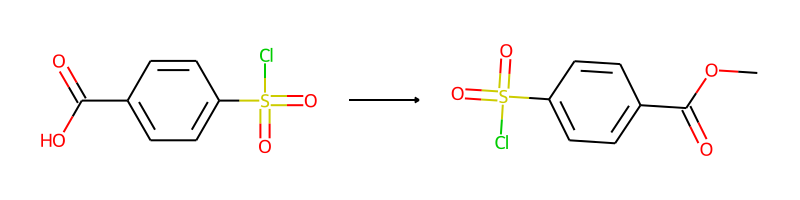

-> template: [O;D1;H0:3]=[C:2]-[OH;D1;+0:1]>>C-[O;H0;D2;+0:1]-[C:2]=[O;D1;H0:3]


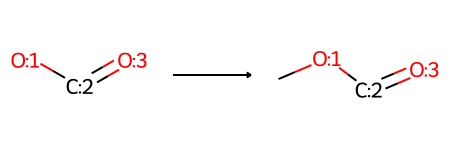

Product similarity 0.6346153846153846, overall 0.3484162895927602, smiles COC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


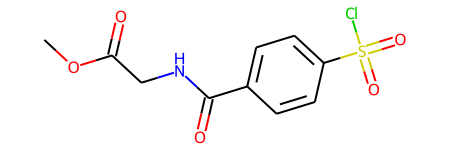

The proposed reaction is:


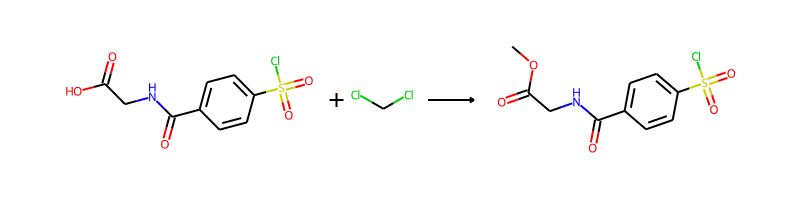

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.ClCCl>>COC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 352666
RANK 43 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


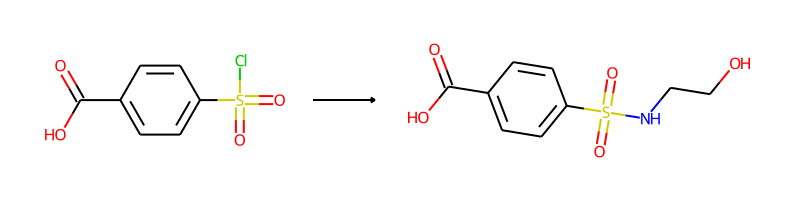

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>O-C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


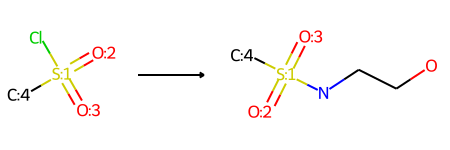

Product similarity 0.6166666666666667, overall 0.338562091503268, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCO)cc1


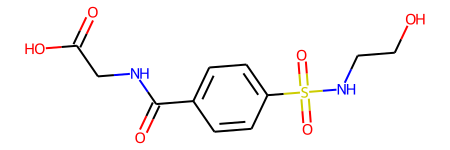

The proposed reaction is:


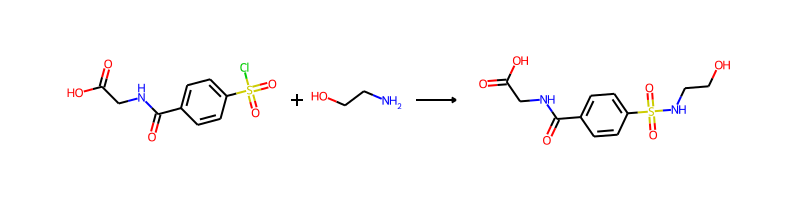

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NCCO>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCO)cc1


--------------------------------------------------

Train index: 148052
RANK 44 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


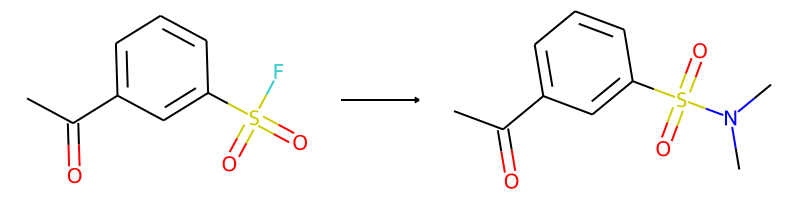

-> template: [F;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-N(-C)-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


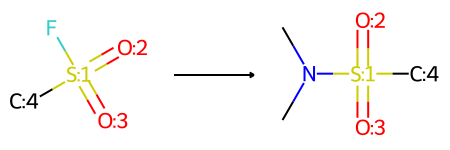

->No precursors could be generated!


--------------------------------------------------

Train index: 22772
RANK 45 PRECEDENT
REACTANT MATCH SCORE: 0.5490196078431373


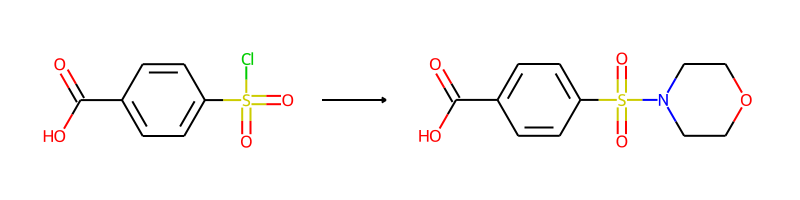

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-O-C-C-1


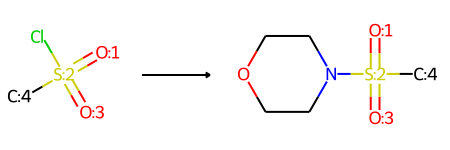

Product similarity 0.6567164179104478, overall 0.3605501902253439, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCOCC2)cc1


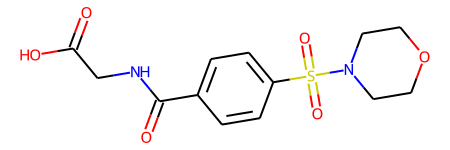

The proposed reaction is:


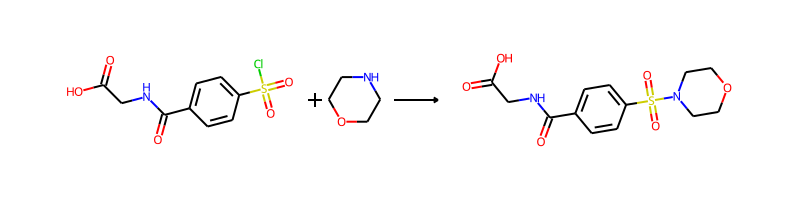

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1COCCN1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCOCC2)cc1


--------------------------------------------------

Train index: 337740
RANK 46 PRECEDENT
REACTANT MATCH SCORE: 0.5471698113207547


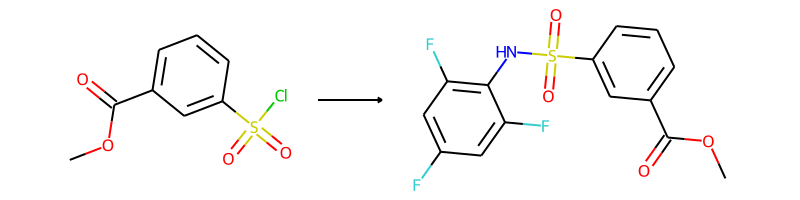

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>F-c1:c:c(-F):c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c(-F):c:1


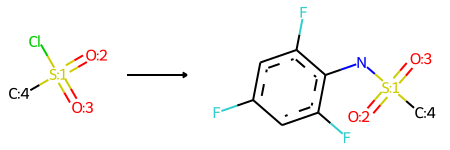

Product similarity 0.6923076923076923, overall 0.3788098693759071, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2c(F)cc(F)cc2F)cc1


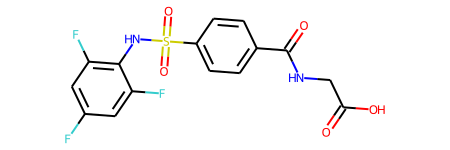

The proposed reaction is:


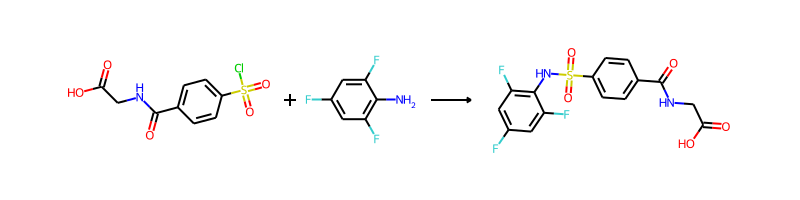

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Nc1c(F)cc(F)cc1F>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2c(F)cc(F)cc2F)cc1


--------------------------------------------------

Train index: 235523
RANK 47 PRECEDENT
REACTANT MATCH SCORE: 0.5471698113207547


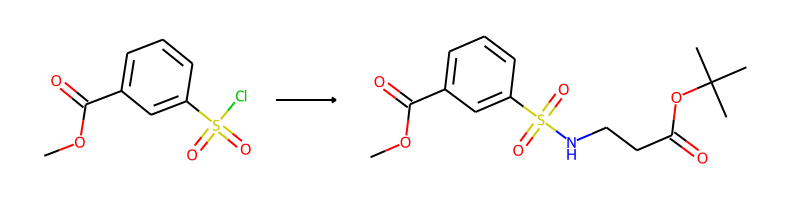

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C(-C)(-C)-O-C(=O)-C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


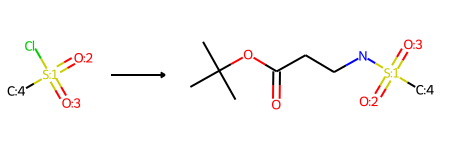

Product similarity 0.6883116883116883, overall 0.37662337662337664, smiles CC(C)(C)OC(=O)CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


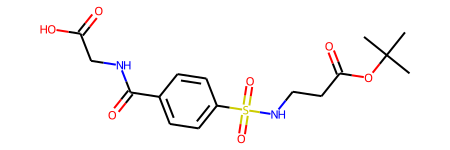

The proposed reaction is:


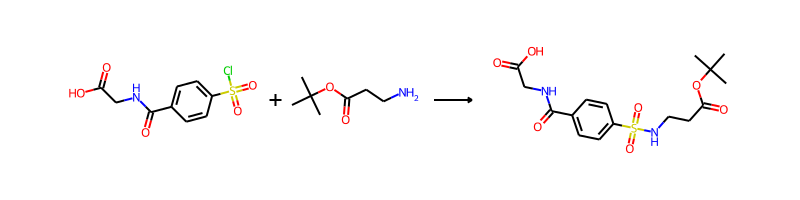

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)(C)OC(=O)CCN>>CC(C)(C)OC(=O)CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 85079
RANK 48 PRECEDENT
REACTANT MATCH SCORE: 0.5454545454545454


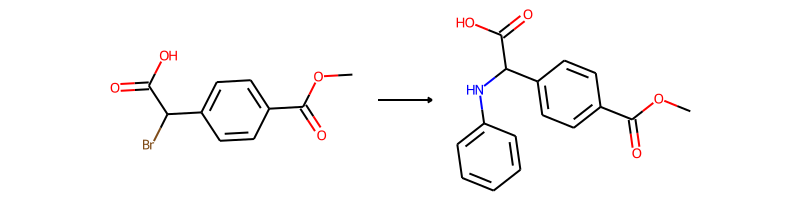

-> template: [Br;H0;D1;+0]-[CH;D3;+0:4](-[c:5])-[C:2](=[O;D1;H0:1])-[O;D1;H1:3]>>[O;D1;H0:1]=[C:2](-[O;D1;H1:3])-[CH;D3;+0:4](-[c:5])-N-c1:c:c:c:c:c:1


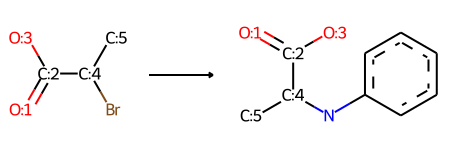

->No precursors could be generated!


--------------------------------------------------

Train index: 31914
RANK 49 PRECEDENT
REACTANT MATCH SCORE: 0.5441176470588235


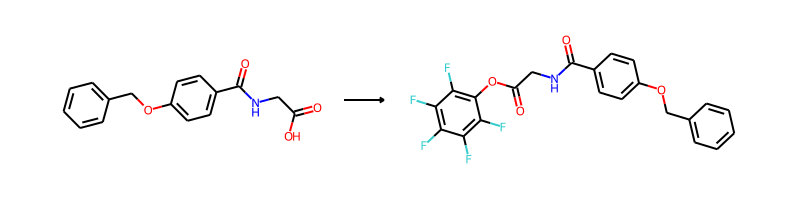

-> template: [C:3]-[C;H0;D3;+0:2](=[O;H0;D1;+0:1])-[OH;D1;+0:4]>>F-c1:c(-F):c(-F):c(-[O;H0;D2;+0:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]):c(-F):c:1-F


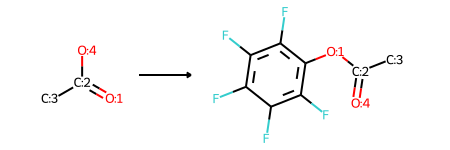

Product similarity 0.6804123711340206, overall 0.37022437841115824, smiles O=C(CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)Oc1c(F)c(F)c(F)c(F)c1F


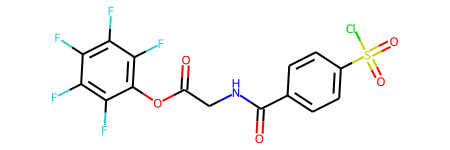

The proposed reaction is:


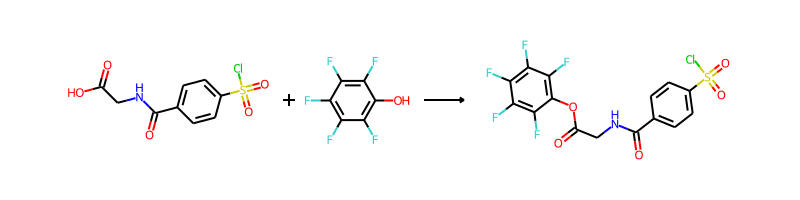

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Oc1c(F)c(F)c(F)c(F)c1F>>O=C(CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)Oc1c(F)c(F)c(F)c(F)c1F


--------------------------------------------------

Train index: 210171
RANK 50 PRECEDENT
REACTANT MATCH SCORE: 0.543859649122807


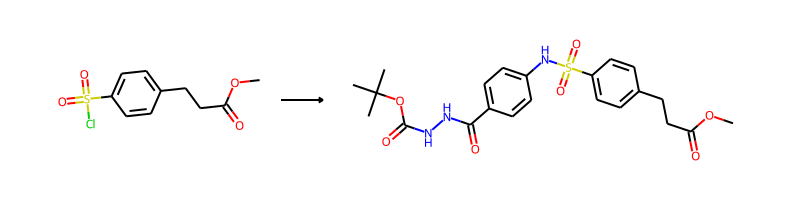

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C(-C)(-C)-O-C(=O)-N-N-C(=O)-c1:c:c:c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c:c:1


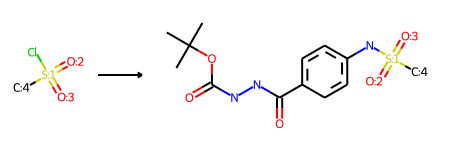

Product similarity 0.75, overall 0.4078947368421053, smiles CC(C)(C)OC(=O)NNC(=O)c1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


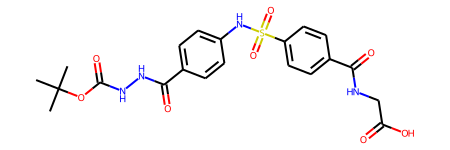

The proposed reaction is:


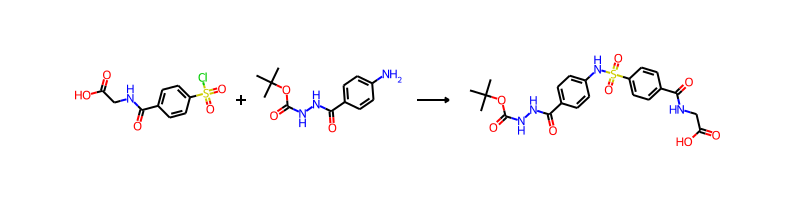

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)(C)OC(=O)NNC(=O)c1ccc(N)cc1>>CC(C)(C)OC(=O)NNC(=O)c1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)cc1


--------------------------------------------------

Train index: 365977
RANK 51 PRECEDENT
REACTANT MATCH SCORE: 0.543859649122807


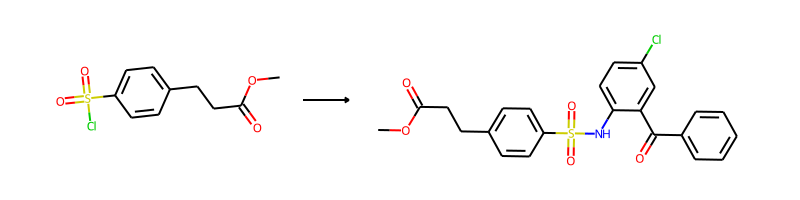

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>Cl-c1:c:c:c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c(-C(=O)-c2:c:c:c:c:c:2):c:1


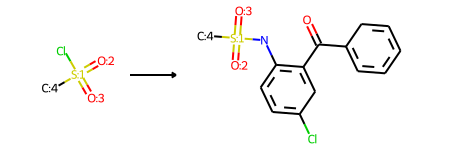

Product similarity 0.7425742574257426, overall 0.40385617509119337, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccc(Cl)cc2C(=O)c2ccccc2)cc1


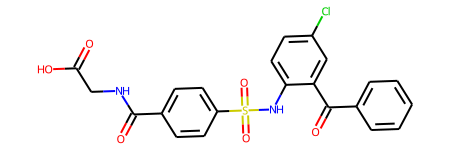

The proposed reaction is:


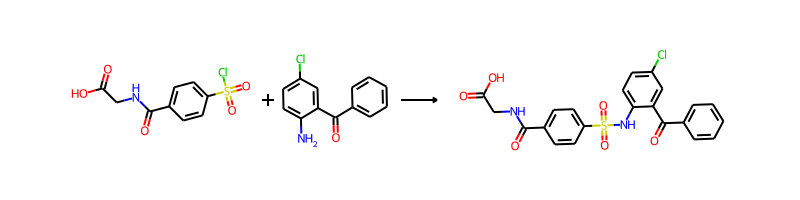

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Nc1ccc(Cl)cc1C(=O)c1ccccc1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccc(Cl)cc2C(=O)c2ccccc2)cc1


--------------------------------------------------

Train index: 249339
RANK 52 PRECEDENT
REACTANT MATCH SCORE: 0.5409836065573771


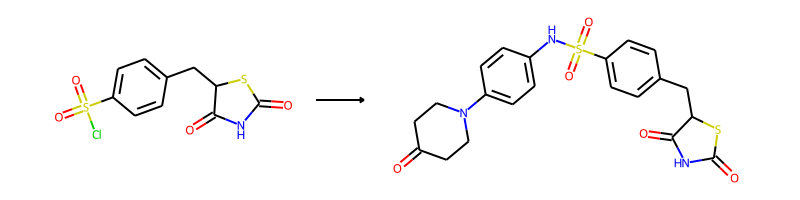

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>O=C1-C-C-N(-c2:c:c:c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c:c:2)-C-C-1


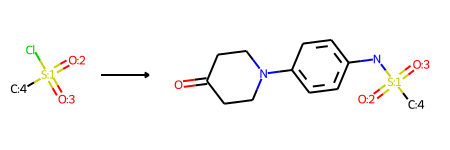

Product similarity 0.72, overall 0.3895081967213115, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccc(N3CCC(=O)CC3)cc2)cc1


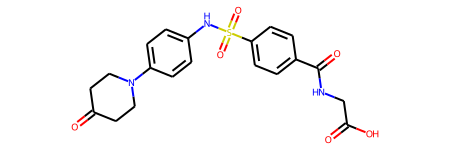

The proposed reaction is:


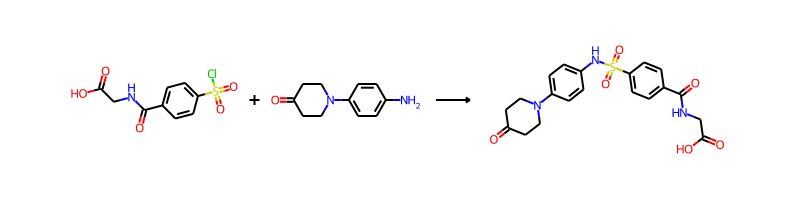

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Nc1ccc(N2CCC(=O)CC2)cc1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccc(N3CCC(=O)CC3)cc2)cc1


--------------------------------------------------

Train index: 239230
RANK 53 PRECEDENT
REACTANT MATCH SCORE: 0.5409836065573771


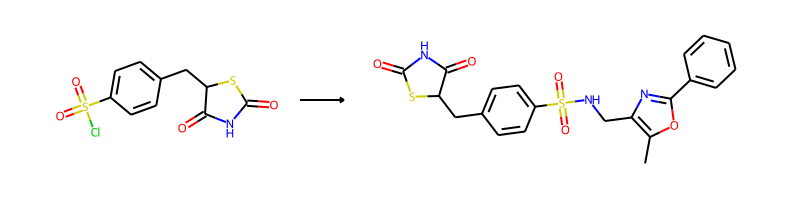

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-c1:o:c(-c2:c:c:c:c:c:2):n:c:1-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


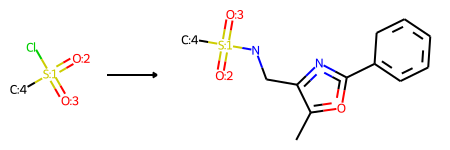

Product similarity 0.72, overall 0.3895081967213115, smiles Cc1oc(-c2ccccc2)nc1CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


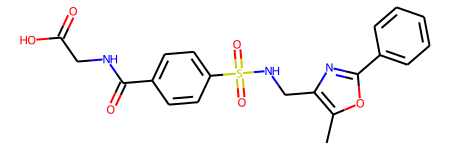

The proposed reaction is:


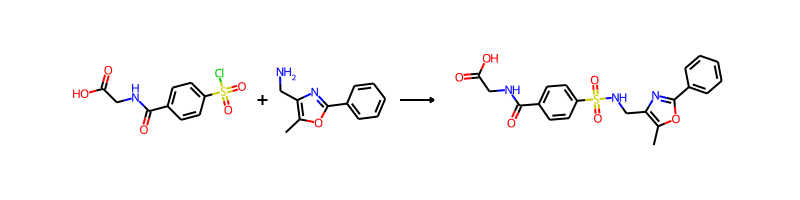

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Cc1oc(-c2ccccc2)nc1CN>>Cc1oc(-c2ccccc2)nc1CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 135349
RANK 54 PRECEDENT
REACTANT MATCH SCORE: 0.5384615384615384


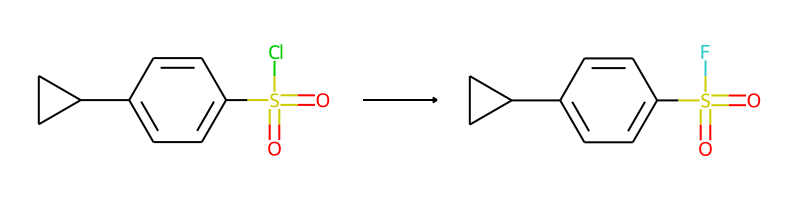

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>F-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


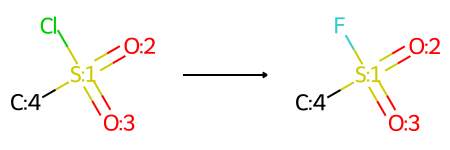

Product similarity 0.5384615384615384, overall 0.28994082840236685, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)F)cc1


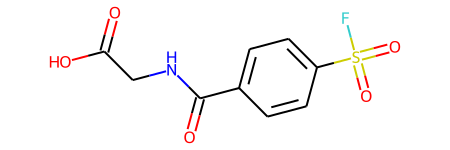

The proposed reaction is:


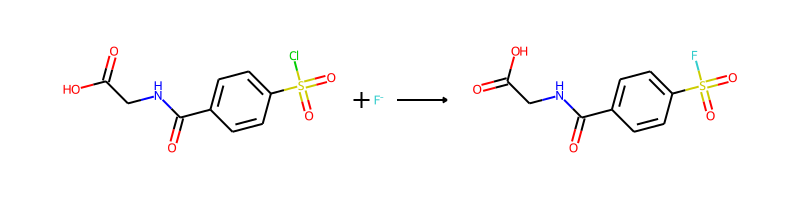

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[F-]>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)F)cc1


--------------------------------------------------

Train index: 2079
RANK 55 PRECEDENT
REACTANT MATCH SCORE: 0.5384615384615384


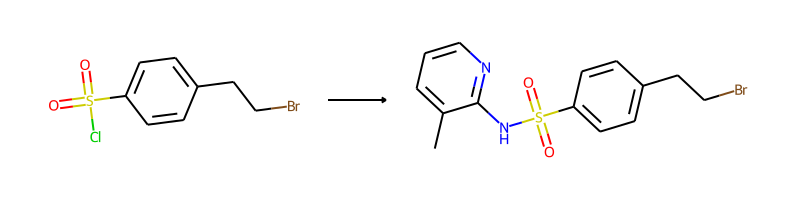

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-c1:c:c:c:n:c:1-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


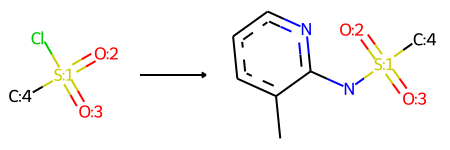

Product similarity 0.6712328767123288, overall 0.3614330874604847, smiles Cc1cccnc1NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


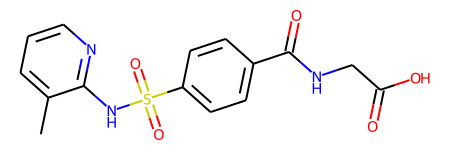

The proposed reaction is:


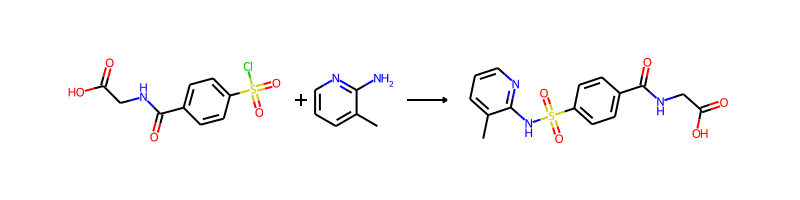

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Cc1cccnc1N>>Cc1cccnc1NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 261925
RANK 56 PRECEDENT
REACTANT MATCH SCORE: 0.5370370370370371


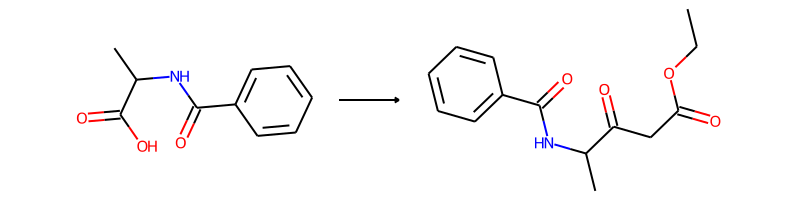

-> template: [C:2]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:3]>>C-C-O-C(=O)-C-[C;H0;D3;+0:1](-[C:2])=[O;H0;D1;+0:3]


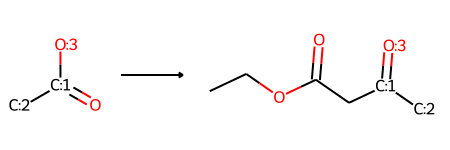

Product similarity 0.6323529411764706, overall 0.33959694989106753, smiles CCOC(=O)CC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


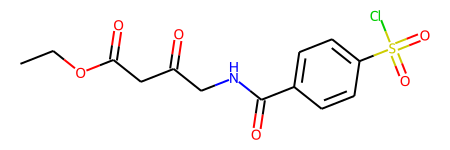

The proposed reaction is:


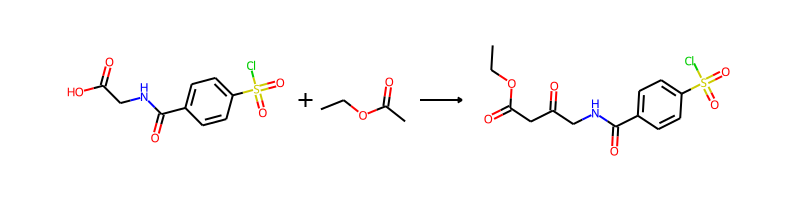

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCOC(C)=O>>CCOC(=O)CC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 375707
RANK 57 PRECEDENT
REACTANT MATCH SCORE: 0.5370370370370371


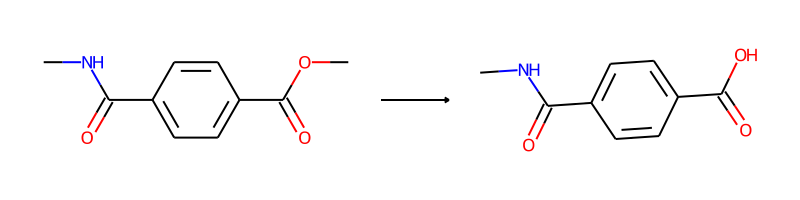

-> template: [C;H3;D1;+0]-[O;H0;D2;+0:3]-[C:2]=[O;D1;H0:1]>>[O;D1;H0:1]=[C:2]-[OH;D1;+0:3]


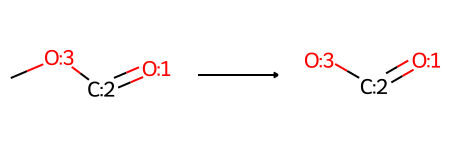

->No precursors could be generated!


--------------------------------------------------

Train index: 160735
RANK 58 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


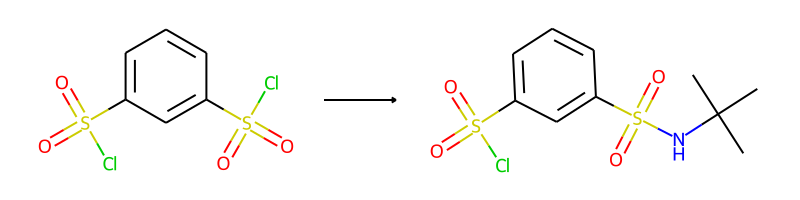

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C(-C)(-C)-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


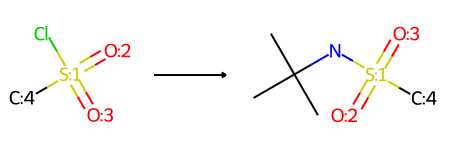

Product similarity 0.6031746031746031, overall 0.31865828092243187, smiles CC(C)(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


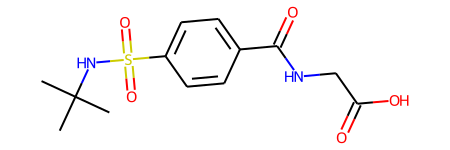

The proposed reaction is:


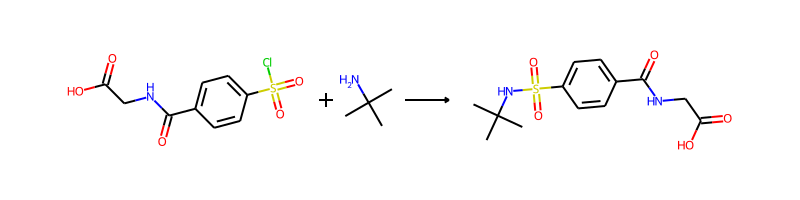

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)(C)N>>CC(C)(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 62263
RANK 59 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


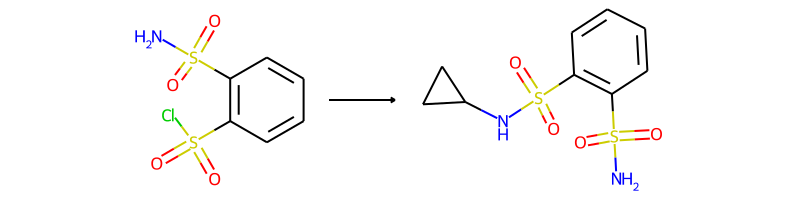

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-C1-C-C-1


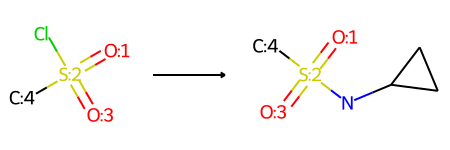

Product similarity 0.5967741935483871, overall 0.31527693244065735, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC2CC2)cc1


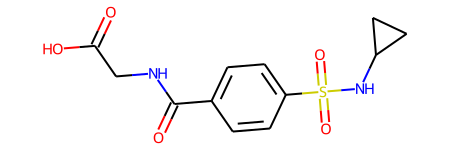

The proposed reaction is:


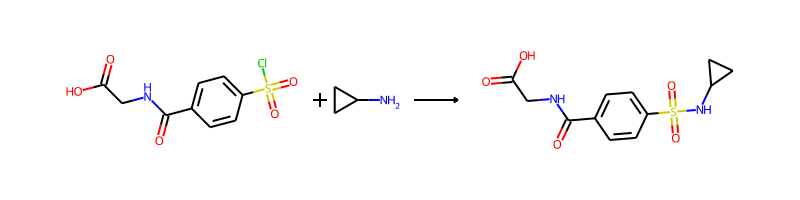

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC1CC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC2CC2)cc1


--------------------------------------------------

Train index: 154764
RANK 60 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


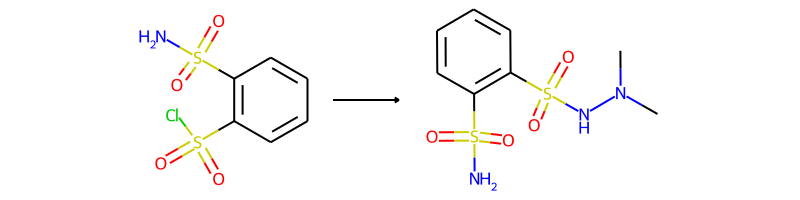

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-N(-C)-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


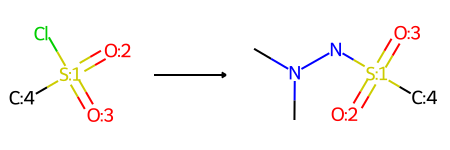

Product similarity 0.5901639344262295, overall 0.31178472007423447, smiles CN(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


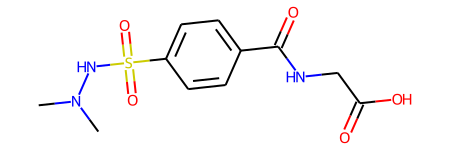

The proposed reaction is:


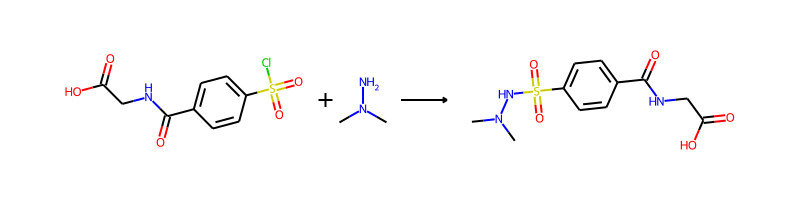

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CN(C)N>>CN(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 52683
RANK 61 PRECEDENT
REACTANT MATCH SCORE: 0.5272727272727272


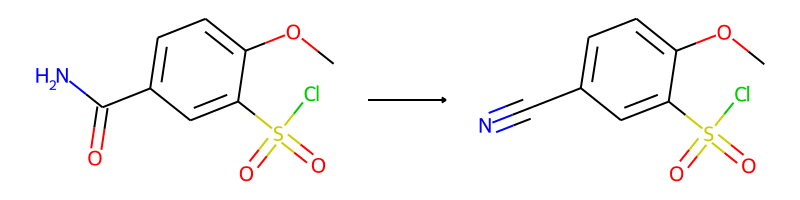

-> template: [NH2;D1;+0:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0])-[c:3]>>[N;H0;D1;+0:1]#[C;H0;D2;+0:2]-[c:3]


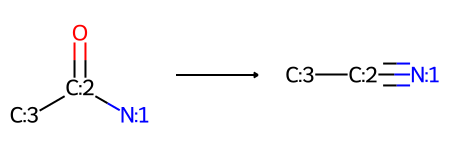

->No precursors could be generated!


--------------------------------------------------

Train index: 127451
RANK 62 PRECEDENT
REACTANT MATCH SCORE: 0.5272727272727272


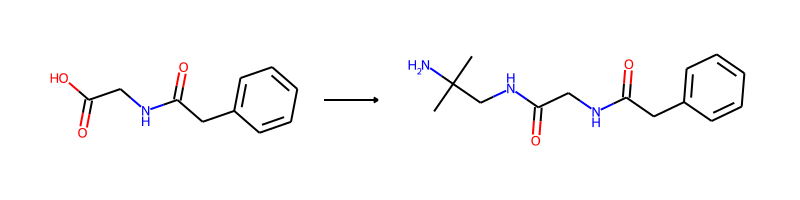

-> template: [C:2]-[C;H0;D3;+0:1](=[O;D1;H0:3])-[O;H1;D1;+0]>>C-C(-C)(-N)-C-N-[C;H0;D3;+0:1](-[C:2])=[O;D1;H0:3]


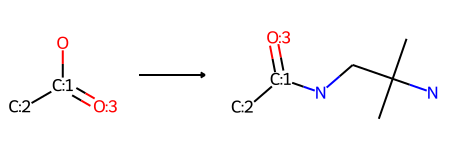

Product similarity 0.6176470588235294, overall 0.3256684491978609, smiles CC(C)(N)CNC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


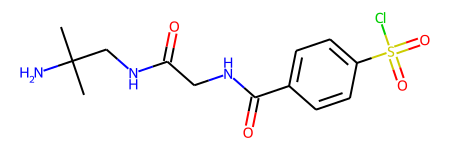

The proposed reaction is:


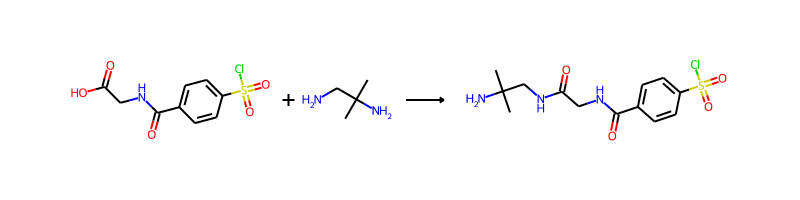

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)(N)CN>>CC(C)(N)CNC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 266330
RANK 63 PRECEDENT
REACTANT MATCH SCORE: 0.5272727272727272


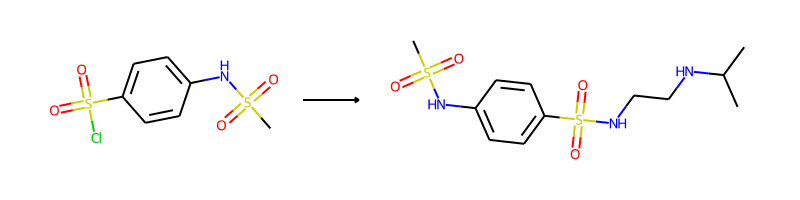

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C(-C)-N-C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


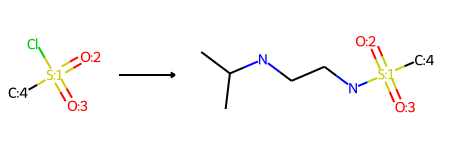

Product similarity 0.6388888888888888, overall 0.3368686868686868, smiles CC(C)NCCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


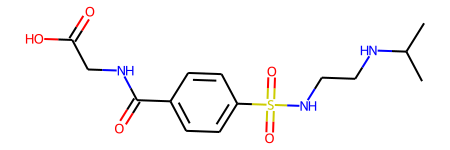

The proposed reaction is:


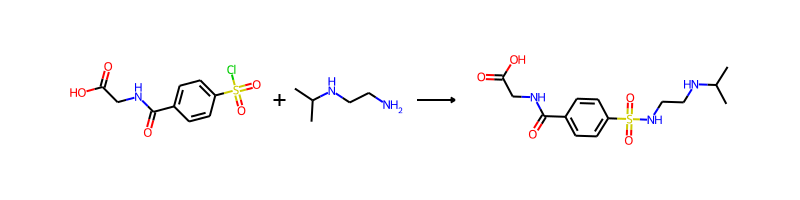

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)NCCN>>CC(C)NCCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 109733
RANK 64 PRECEDENT
REACTANT MATCH SCORE: 0.5272727272727272


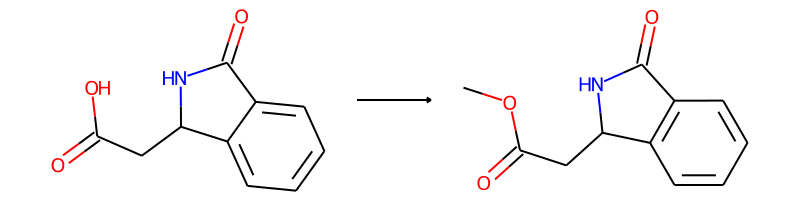

-> template: [C:3]-[C;H0;D3;+0:2](=[O;H0;D1;+0:1])-[OH;D1;+0:4]>>C-[O;H0;D2;+0:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]


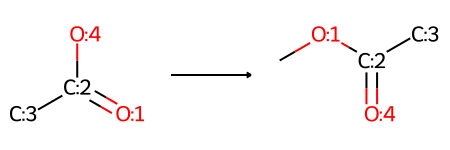

Product similarity 0.5517241379310345, overall 0.2909090909090909, smiles COC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


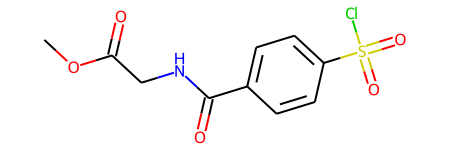

The proposed reaction is:


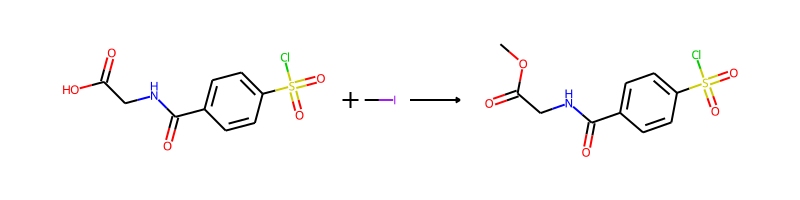

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CI>>COC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 14840
RANK 65 PRECEDENT
REACTANT MATCH SCORE: 0.5272727272727272


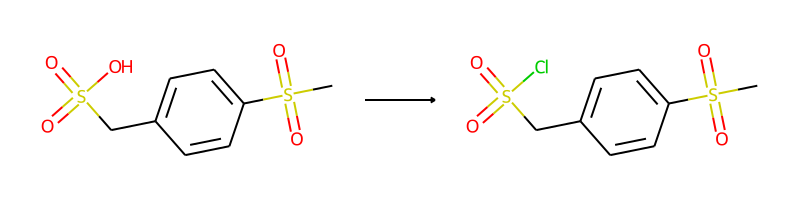

-> template: [C:2]-[S;H0;D4;+0:1](=[O;D1;H0:3])(=[O;H0;D1;+0])-[OH;D1;+0:4]>>Cl-[S;H0;D4;+0:1](-[C:2])(=[O;D1;H0:3])=[O;H0;D1;+0:4]


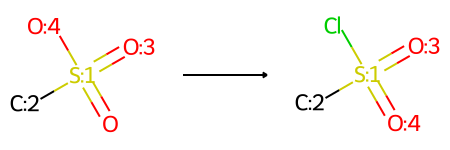

->No precursors could be generated!


--------------------------------------------------

Train index: 18783
RANK 66 PRECEDENT
REACTANT MATCH SCORE: 0.5263157894736842


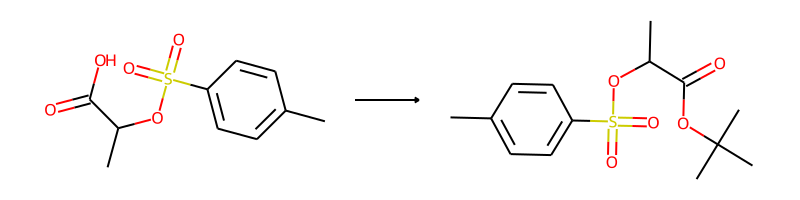

-> template: [O;D1;H0:3]=[C:2]-[OH;D1;+0:1]>>C-C(-C)(-C)-[O;H0;D2;+0:1]-[C:2]=[O;D1;H0:3]


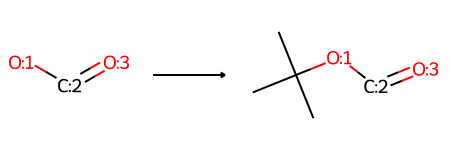

Product similarity 0.5970149253731343, overall 0.3142183817753338, smiles CC(C)(C)OC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


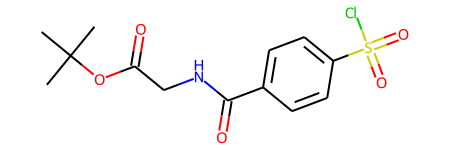

The proposed reaction is:


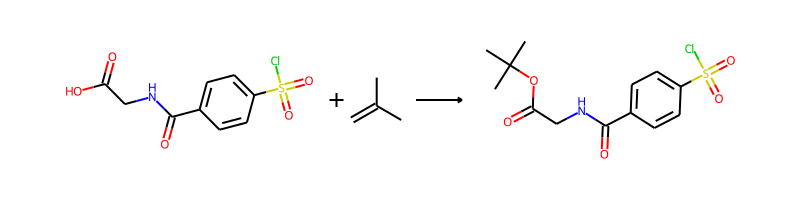

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C=C(C)C>>CC(C)(C)OC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 149914
RANK 67 PRECEDENT
REACTANT MATCH SCORE: 0.5263157894736842


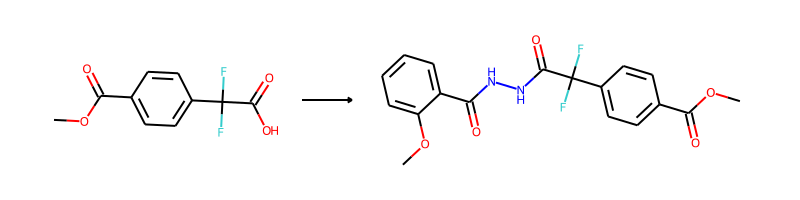

-> template: [C:2]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:3]>>C-O-c1:c:c:c:c:c:1-C(=O)-N-N-[C;H0;D3;+0:1](-[C:2])=[O;H0;D1;+0:3]


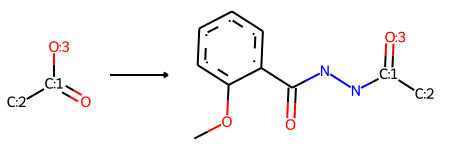

Product similarity 0.6966292134831461, overall 0.3666469544648137, smiles COc1ccccc1C(=O)NNC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


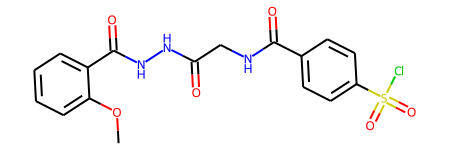

The proposed reaction is:


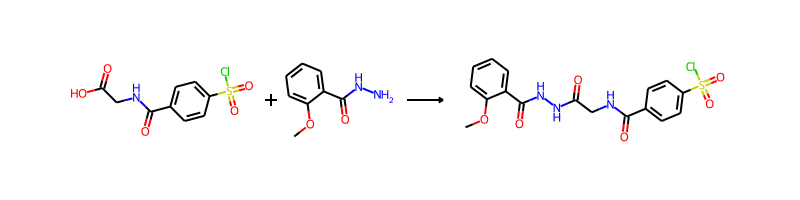

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COc1ccccc1C(=O)NN>>COc1ccccc1C(=O)NNC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 326724
RANK 68 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


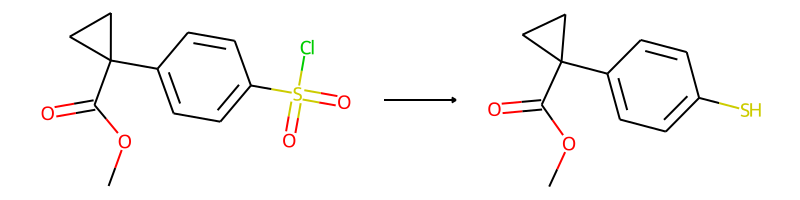

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;H0;D1;+0])(=[O;H0;D1;+0])-[c:2]>>[SH;D1;+0:1]-[c:2]


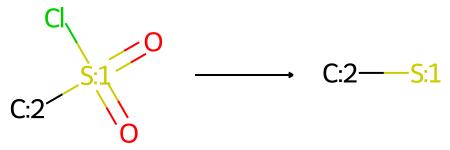

Product similarity 0.46153846153846156, overall 0.24250325945241202, smiles O=C(O)CNC(=O)c1ccc(S)cc1


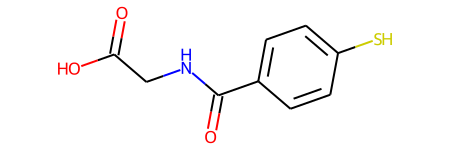

The proposed reaction is:


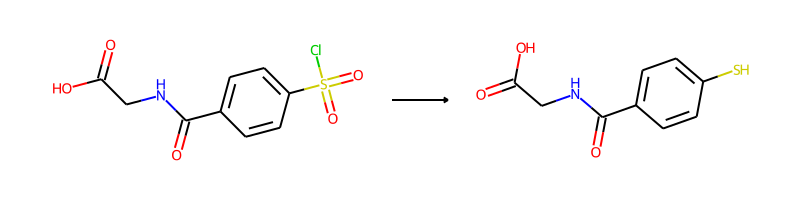

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1>>O=C(O)CNC(=O)c1ccc(S)cc1


--------------------------------------------------

Train index: 333292
RANK 69 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


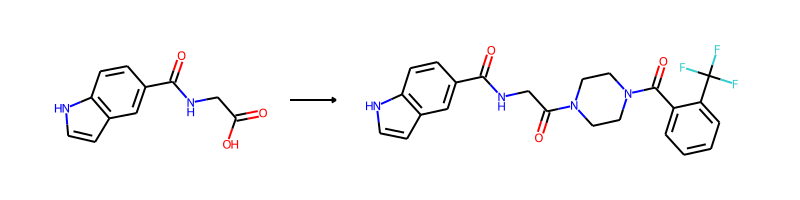

-> template: [C:2]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:3]>>F-C(-F)(-F)-c1:c:c:c:c:c:1-C(=O)-N1-C-C-N(-[C;H0;D3;+0:1](-[C:2])=[O;H0;D1;+0:3])-C-C-1


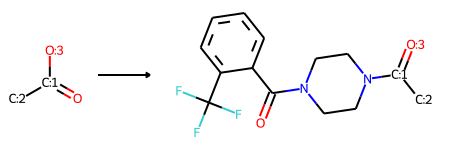

Product similarity 0.7383177570093458, overall 0.3879296689371139, smiles O=C(NCC(=O)N1CCN(C(=O)c2ccccc2C(F)(F)F)CC1)c1ccc(S(=O)(=O)Cl)cc1


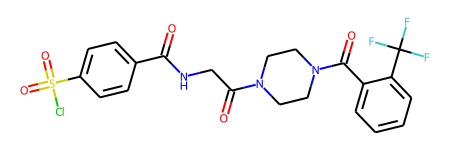

The proposed reaction is:


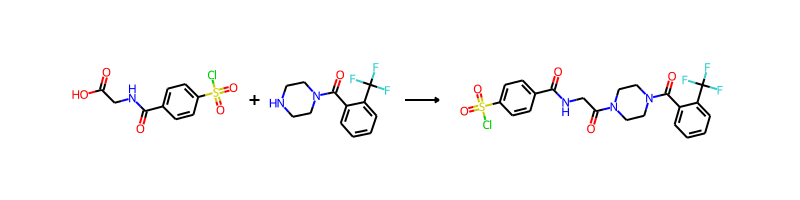

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.O=C(c1ccccc1C(F)(F)F)N1CCNCC1>>O=C(NCC(=O)N1CCN(C(=O)c2ccccc2C(F)(F)F)CC1)c1ccc(S(=O)(=O)Cl)cc1


--------------------------------------------------

Train index: 268681
RANK 70 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


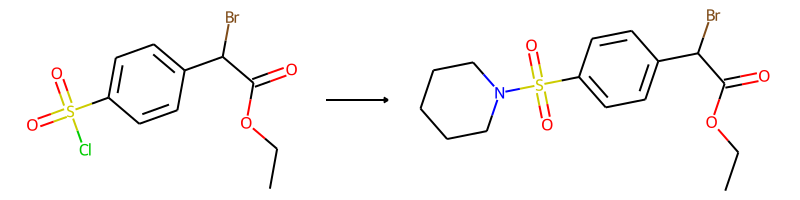

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-C-C-C-1


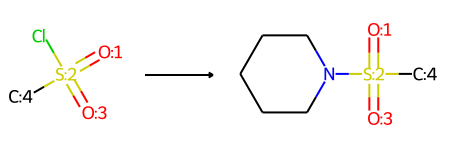

Product similarity 0.6266666666666667, overall 0.3292655367231639, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


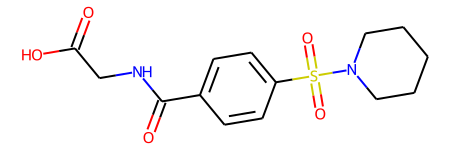

The proposed reaction is:


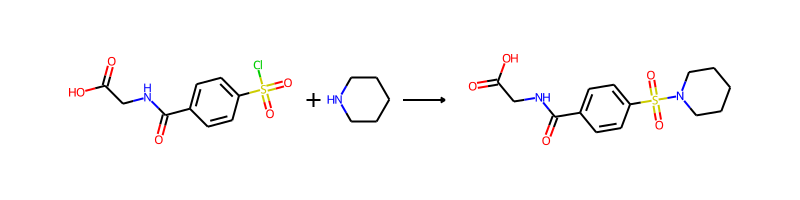

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1CCNCC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


--------------------------------------------------

Train index: 426564
RANK 71 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


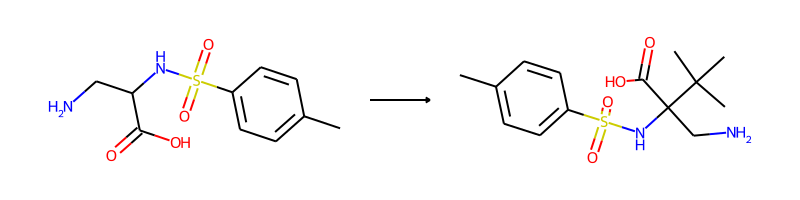

-> template: [#7:2]-[CH;D3;+0:1](-[C:3])-[C:4](=[O;D1;H0:5])-[O;D1;H1:6]>>C-C(-C)(-C)-[C;H0;D4;+0:1](-[#7:2])(-[C:3])-[C:4](=[O;D1;H0:5])-[O;D1;H1:6]


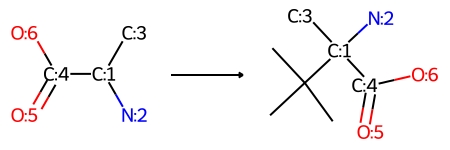

->No precursors could be generated!


--------------------------------------------------

Train index: 378089
RANK 72 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


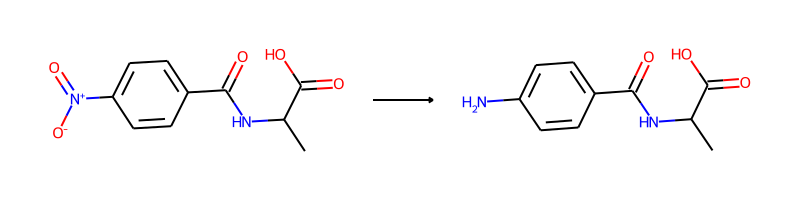

-> template: [O-;H0;D1]-[N+;H0;D3:1](=[O;H0;D1;+0])-[c:2]>>[NH2;D1;+0:1]-[c:2]


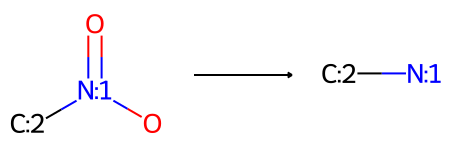

->No precursors could be generated!


--------------------------------------------------

Train index: 432981
RANK 73 PRECEDENT
REACTANT MATCH SCORE: 0.5230769230769231


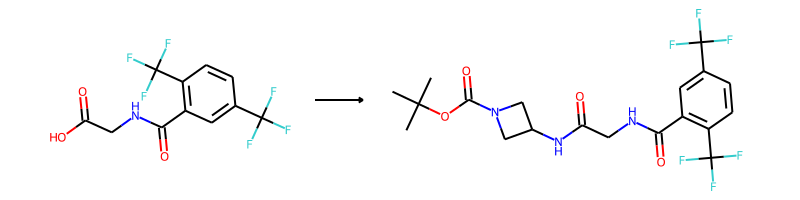

-> template: [C:2]-[C;H0;D3;+0:1](=[O;D1;H0:3])-[O;H1;D1;+0]>>C-C(-C)(-C)-O-C(=O)-N1-C-C(-N-[C;H0;D3;+0:1](-[C:2])=[O;D1;H0:3])-C-1


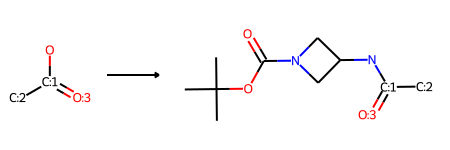

Product similarity 0.6702127659574468, overall 0.3505728314238953, smiles CC(C)(C)OC(=O)N1CC(NC(=O)CNC(=O)c2ccc(S(=O)(=O)Cl)cc2)C1


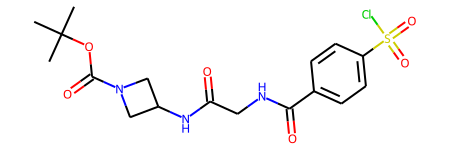

The proposed reaction is:


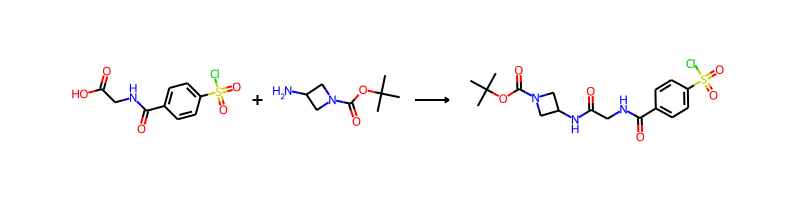

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)(C)OC(=O)N1CC(N)C1>>CC(C)(C)OC(=O)N1CC(NC(=O)CNC(=O)c2ccc(S(=O)(=O)Cl)cc2)C1


--------------------------------------------------

Train index: 188477
RANK 74 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


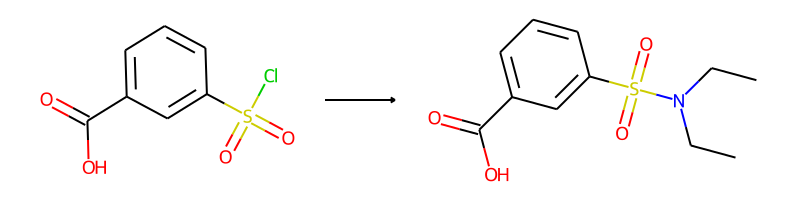

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-N(-C-C)-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


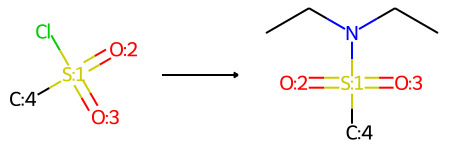

Product similarity 0.6031746031746031, overall 0.3131868131868132, smiles CCN(CC)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


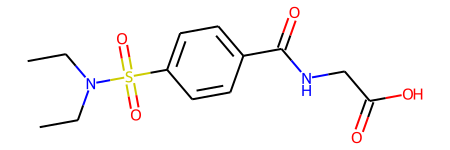

The proposed reaction is:


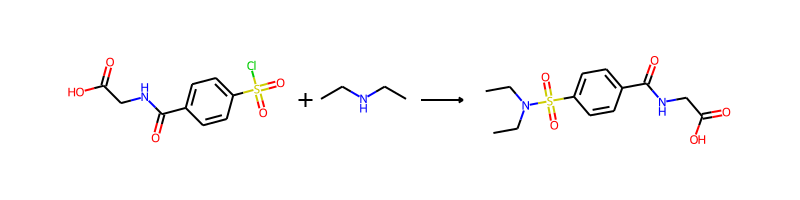

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCNCC>>CCN(CC)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 223099
RANK 75 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


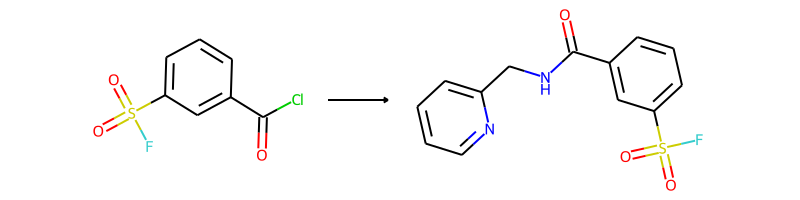

-> template: [Cl;H0;D1;+0]-[C;H0;D3;+0:2](=[O;D1;H0:1])-[c:3]>>[O;D1;H0:1]=[C;H0;D3;+0:2](-[c:3])-N-C-c1:c:c:c:c:n:1


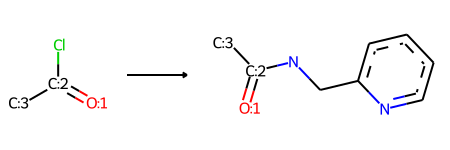

->No precursors could be generated!


--------------------------------------------------

Train index: 21654
RANK 76 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


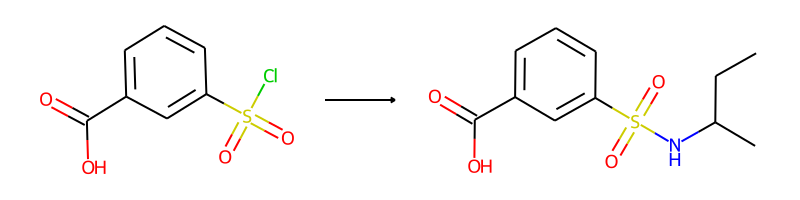

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-C(-C)-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


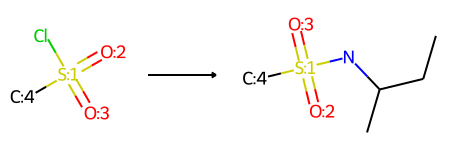

Product similarity 0.6031746031746031, overall 0.3131868131868132, smiles CCC(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


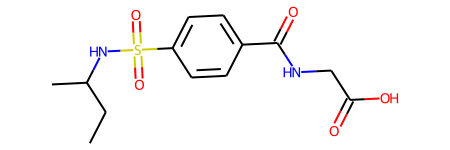

The proposed reaction is:


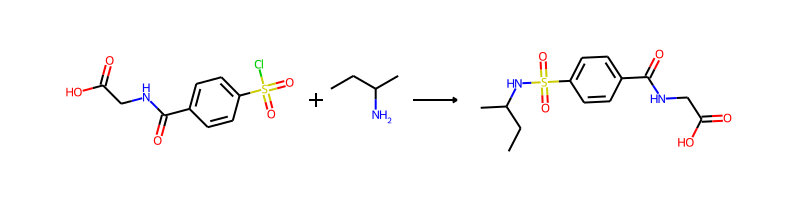

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCC(C)N>>CCC(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 181311
RANK 77 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


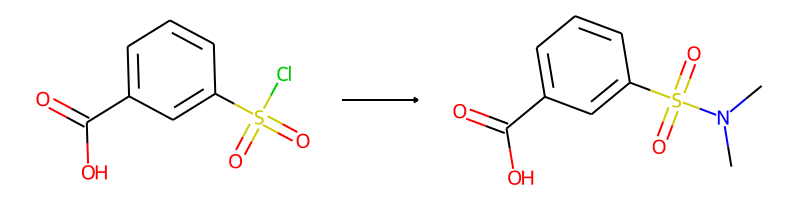

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-N(-C)-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


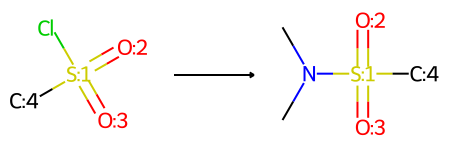

Product similarity 0.5614035087719298, overall 0.29149797570850206, smiles CN(C)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


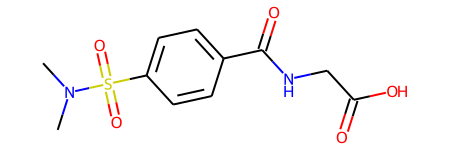

The proposed reaction is:


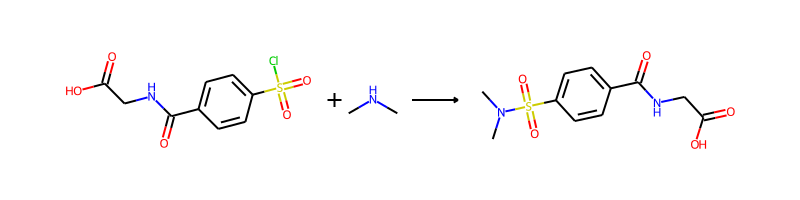

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CNC>>CN(C)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 67260
RANK 78 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


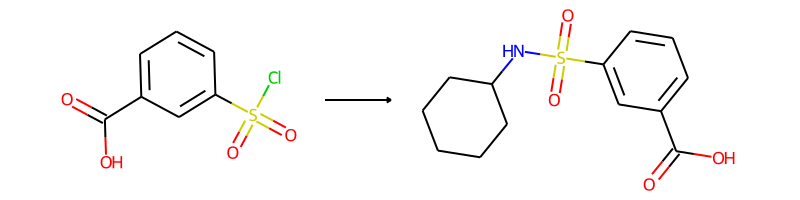

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-C1-C-C-C-C-C-1


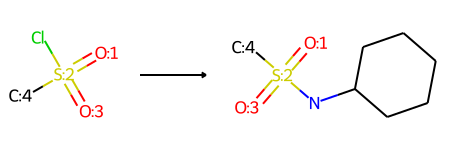

Product similarity 0.647887323943662, overall 0.3364030335861322, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC2CCCCC2)cc1


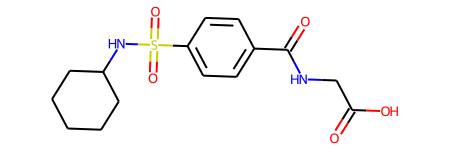

The proposed reaction is:


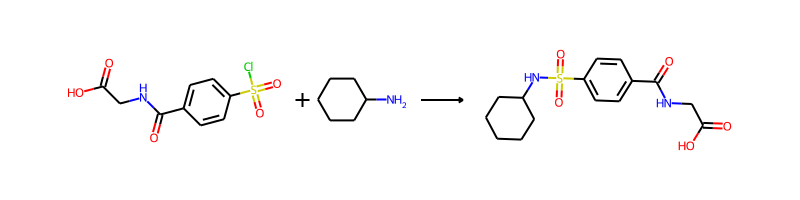

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC1CCCCC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC2CCCCC2)cc1


--------------------------------------------------

Train index: 218443
RANK 79 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


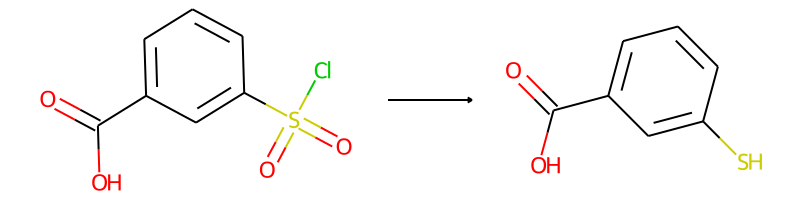

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;H0;D1;+0])(=[O;H0;D1;+0])-[c:2]>>[SH;D1;+0:1]-[c:2]


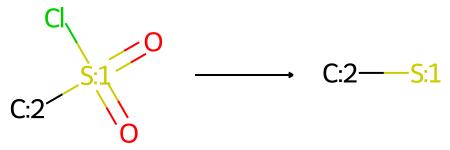

Product similarity 0.4444444444444444, overall 0.23076923076923078, smiles O=C(O)CNC(=O)c1ccc(S)cc1


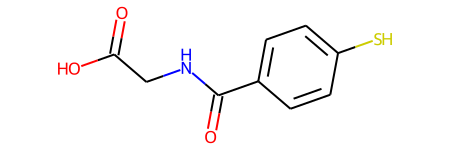

The proposed reaction is:


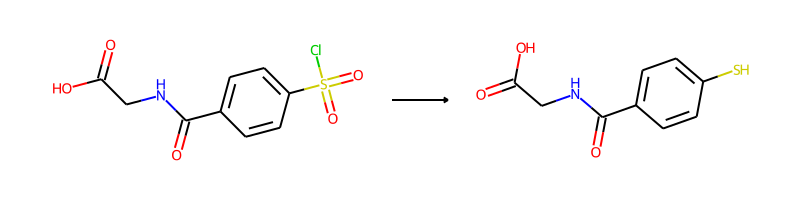

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1>>O=C(O)CNC(=O)c1ccc(S)cc1


--------------------------------------------------

Train index: 355458
RANK 80 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


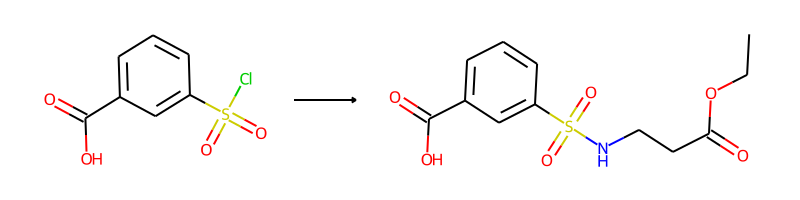

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-O-C(=O)-C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


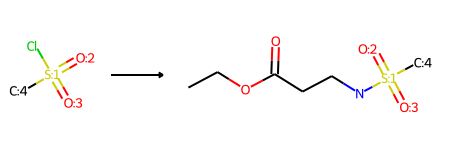

Product similarity 0.6527777777777778, overall 0.3389423076923077, smiles CCOC(=O)CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


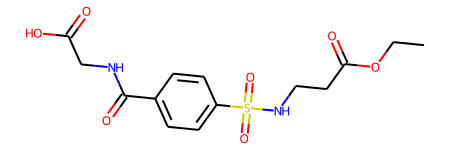

The proposed reaction is:


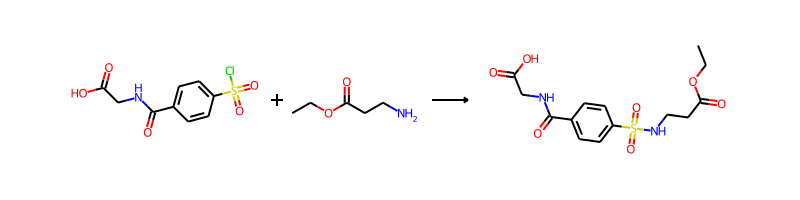

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCOC(=O)CCN>>CCOC(=O)CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 413847
RANK 81 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


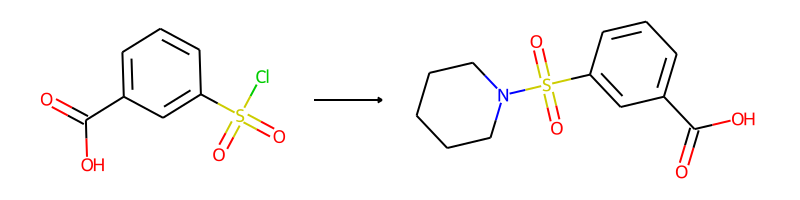

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-C-C-C-1


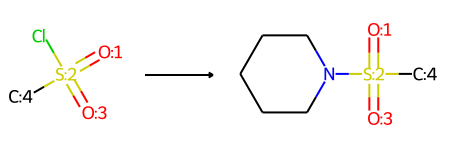

Product similarity 0.6323529411764706, overall 0.3283371040723982, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


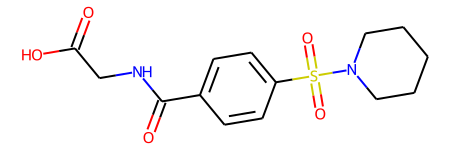

The proposed reaction is:


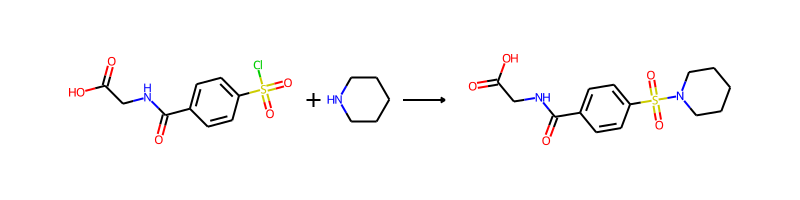

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1CCNCC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


--------------------------------------------------

Train index: 32616
RANK 82 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


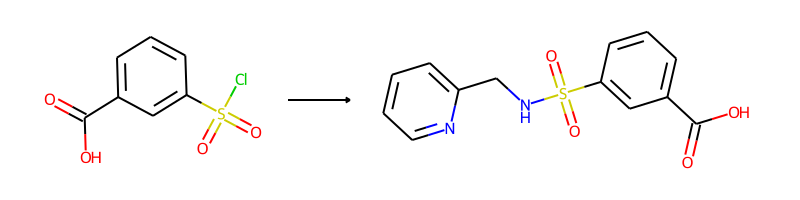

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-C-c1:c:c:c:c:n:1


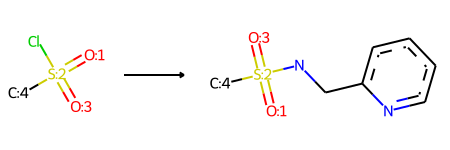

Product similarity 0.6621621621621622, overall 0.34381496881496887, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCc2ccccn2)cc1


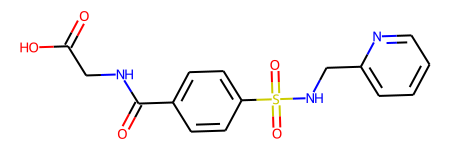

The proposed reaction is:


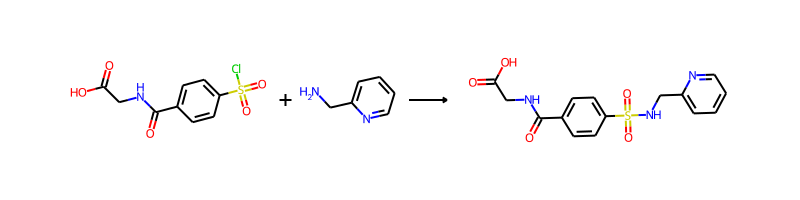

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NCc1ccccn1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCc2ccccn2)cc1


--------------------------------------------------

Train index: 265152
RANK 83 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


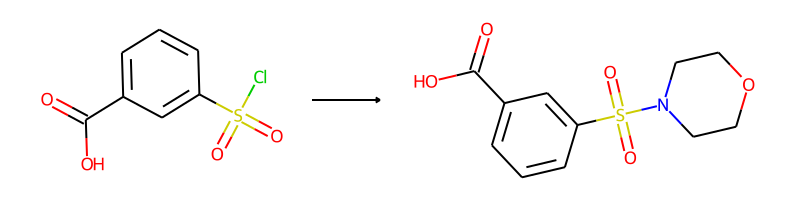

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-O-C-C-1


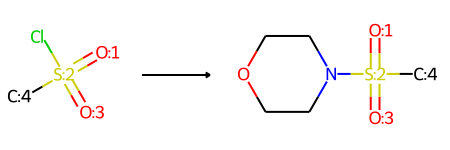

Product similarity 0.6323529411764706, overall 0.3283371040723982, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCOCC2)cc1


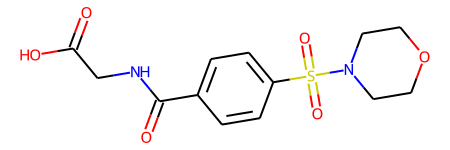

The proposed reaction is:


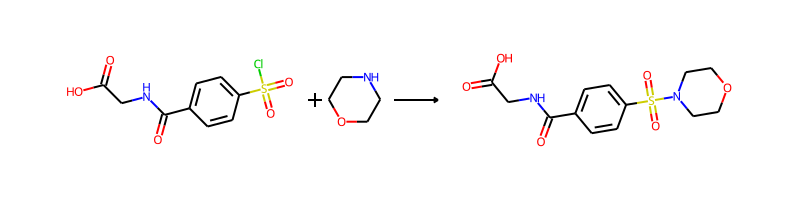

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1COCCN1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCOCC2)cc1


--------------------------------------------------

Train index: 305175
RANK 84 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


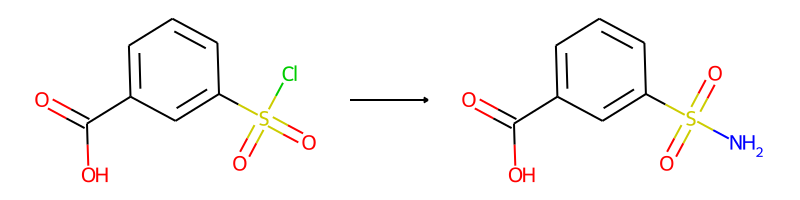

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


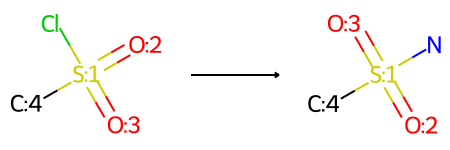

Product similarity 0.5192307692307693, overall 0.2696005917159764, smiles NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


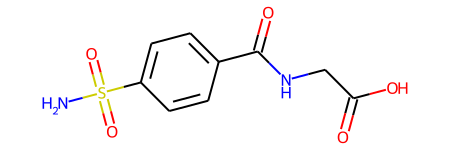

The proposed reaction is:


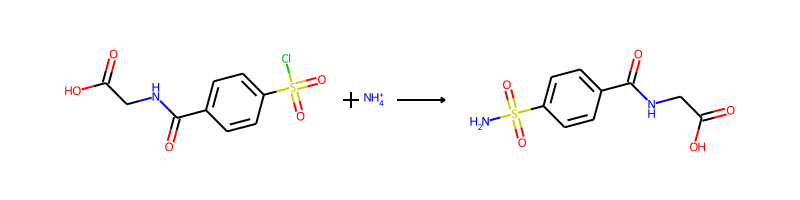

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[NH4+]>>NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 77169
RANK 85 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


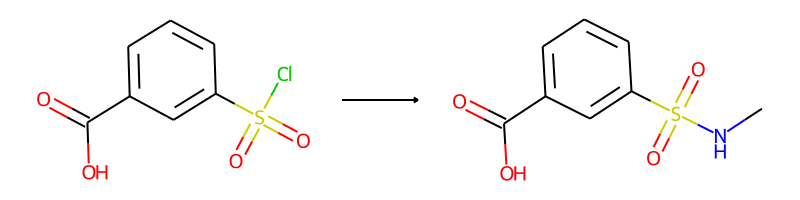

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


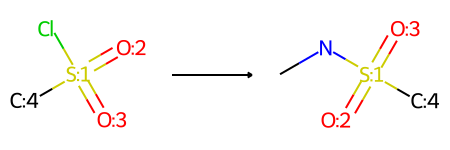

Product similarity 0.5454545454545454, overall 0.28321678321678323, smiles CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


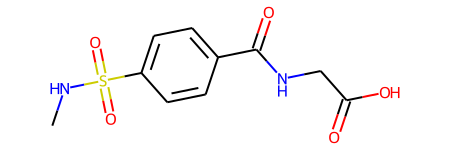

The proposed reaction is:


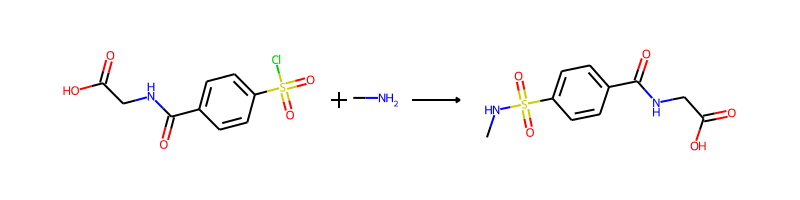

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CN>>CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 247765
RANK 86 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


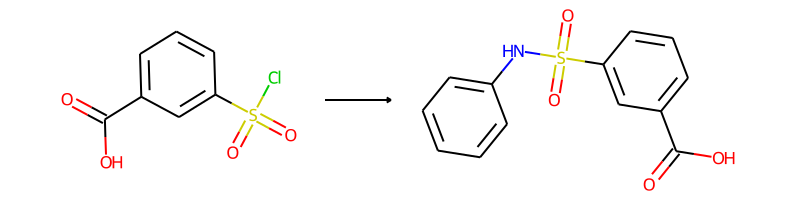

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-c1:c:c:c:c:c:1


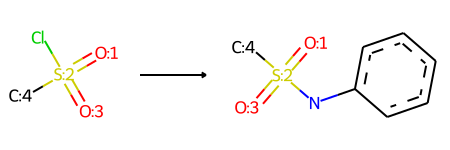

Product similarity 0.647887323943662, overall 0.3364030335861322, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccccc2)cc1


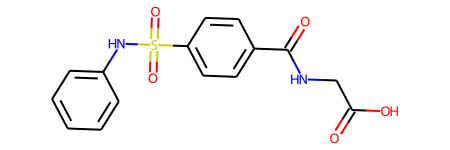

The proposed reaction is:


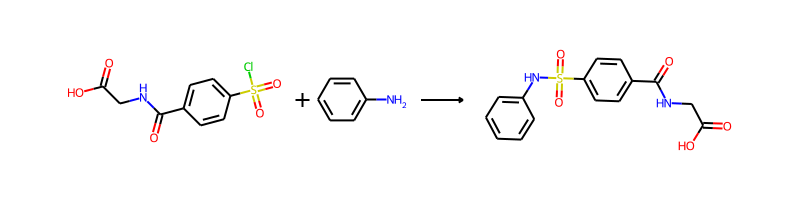

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Nc1ccccc1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccccc2)cc1


--------------------------------------------------

Train index: 391332
RANK 87 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


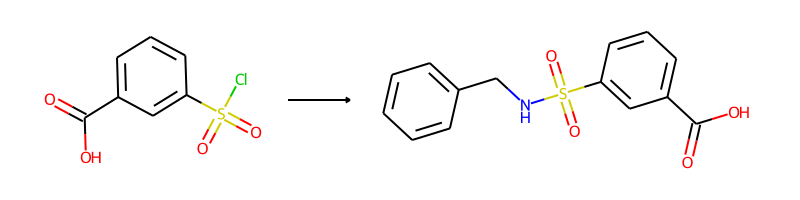

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-C-c1:c:c:c:c:c:1


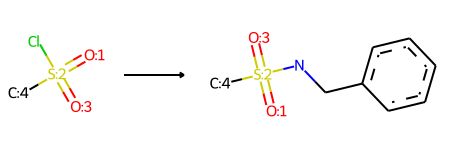

Product similarity 0.6621621621621622, overall 0.34381496881496887, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCc2ccccc2)cc1


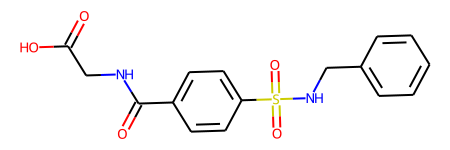

The proposed reaction is:


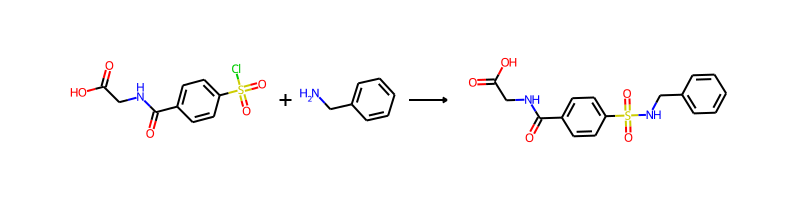

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NCc1ccccc1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCc2ccccc2)cc1


--------------------------------------------------

Train index: 165796
RANK 88 PRECEDENT
REACTANT MATCH SCORE: 0.5192307692307693


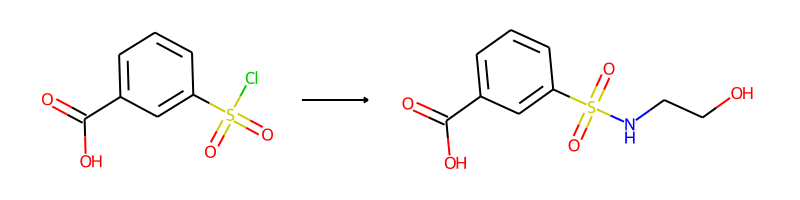

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>O-C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


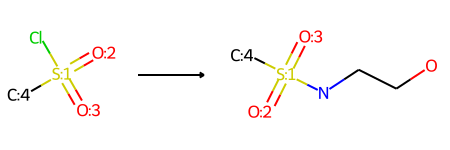

Product similarity 0.5901639344262295, overall 0.30643127364438844, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCO)cc1


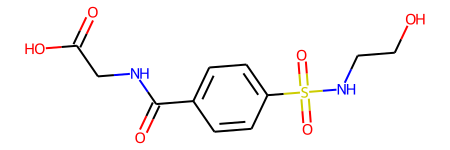

The proposed reaction is:


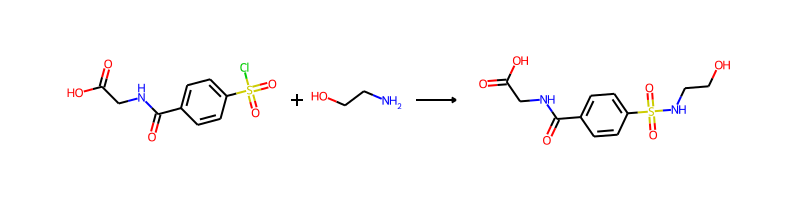

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NCCO>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NCCO)cc1


--------------------------------------------------

Train index: 7112
RANK 89 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


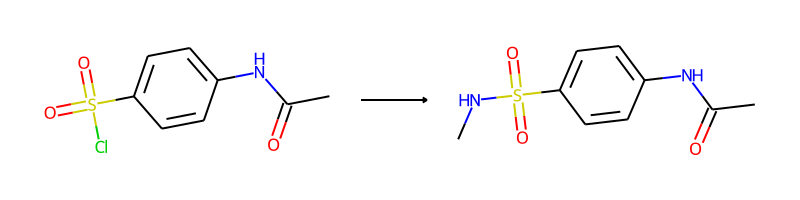

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


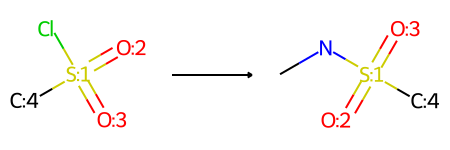

Product similarity 0.543859649122807, overall 0.2820012995451592, smiles CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


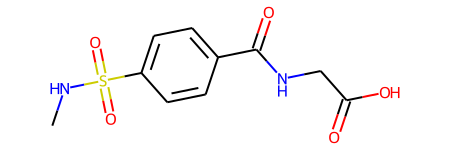

The proposed reaction is:


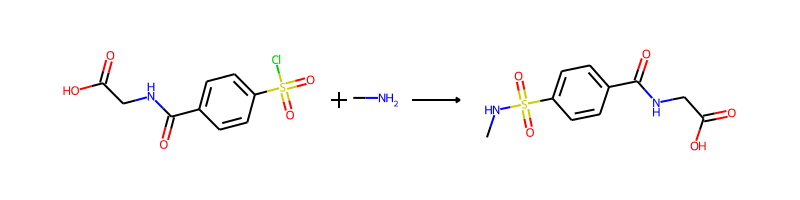

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CN>>CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 333970
RANK 90 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


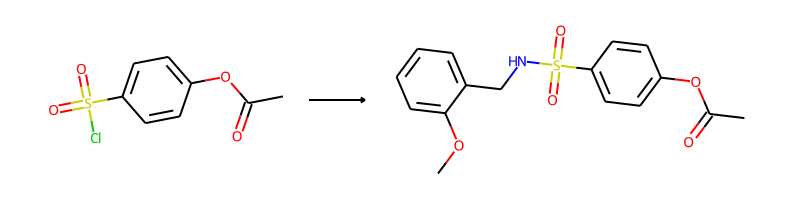

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-O-c1:c:c:c:c:c:1-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


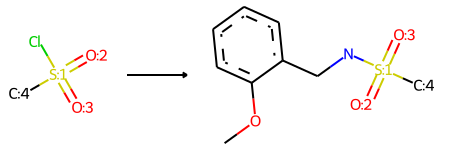

Product similarity 0.6790123456790124, overall 0.3520804755372656, smiles COc1ccccc1CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


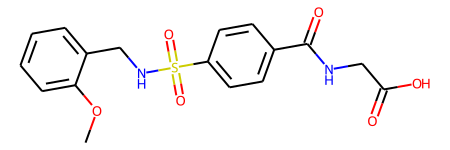

The proposed reaction is:


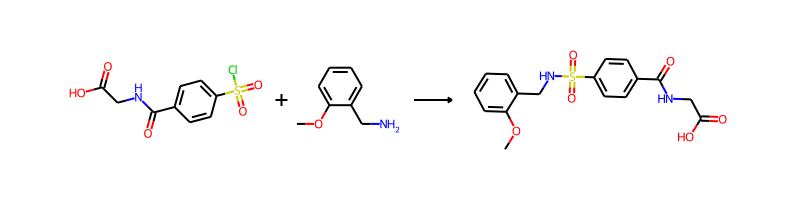

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COc1ccccc1CN>>COc1ccccc1CNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 276796
RANK 91 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


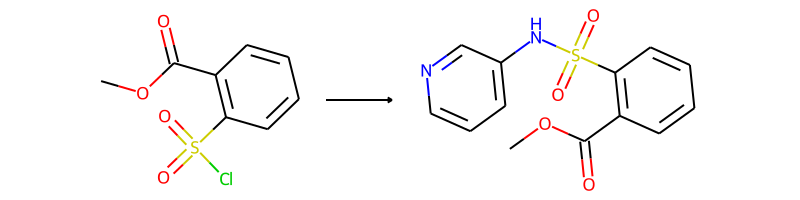

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-c1:c:c:c:n:c:1


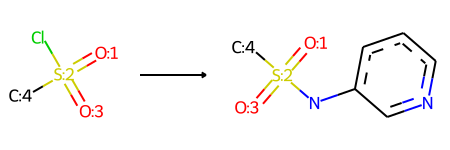

Product similarity 0.6438356164383562, overall 0.33384069000507355, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2cccnc2)cc1


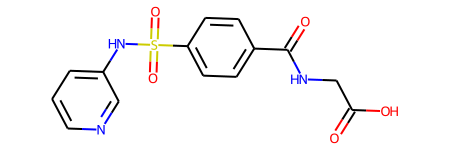

The proposed reaction is:


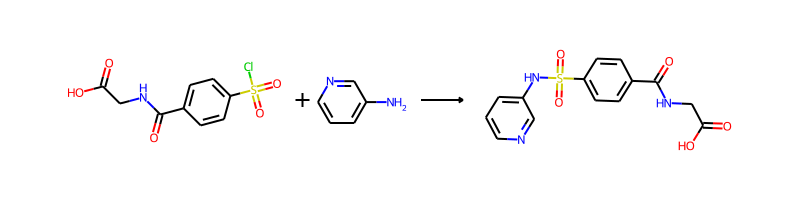

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Nc1cccnc1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2cccnc2)cc1


--------------------------------------------------

Train index: 133303
RANK 92 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


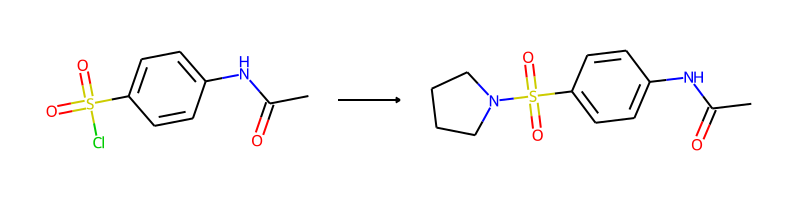

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-C-C-1


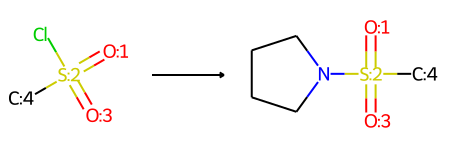

Product similarity 0.6119402985074627, overall 0.31730237700386954, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCC2)cc1


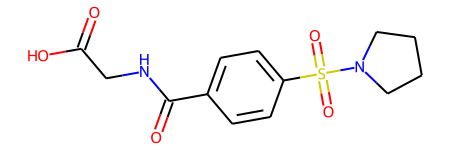

The proposed reaction is:


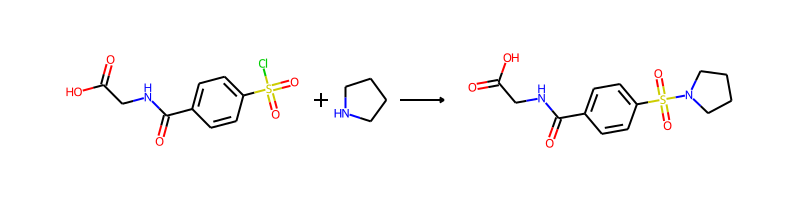

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1CCNC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCC2)cc1


--------------------------------------------------

Train index: 39175
RANK 93 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


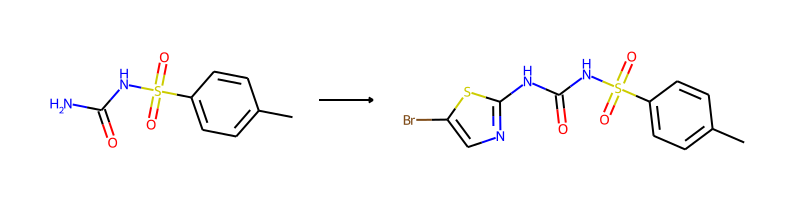

-> template: [#7:3]-[C:2](-[NH2;D1;+0:1])=[O;D1;H0:4]>>Br-c1:c:n:c(-[NH;D2;+0:1]-[C:2](-[#7:3])=[O;D1;H0:4]):s:1


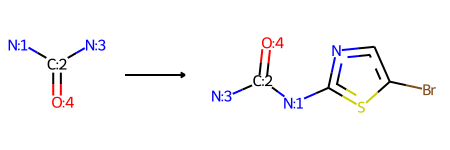

->No precursors could be generated!


--------------------------------------------------

Train index: 165088
RANK 94 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


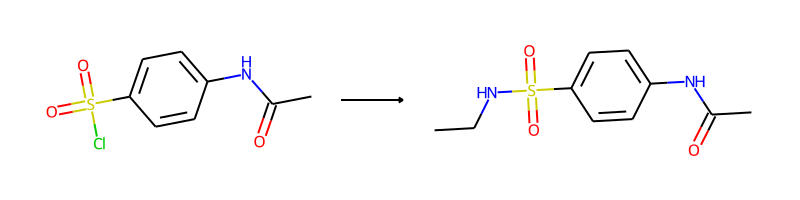

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


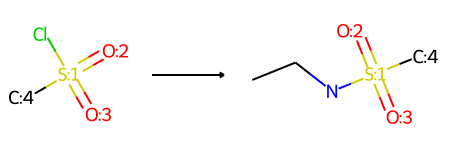

Product similarity 0.5666666666666667, overall 0.2938271604938271, smiles CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


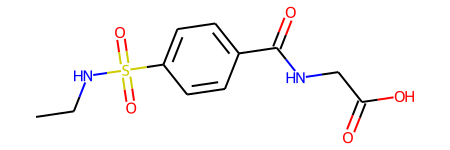

The proposed reaction is:


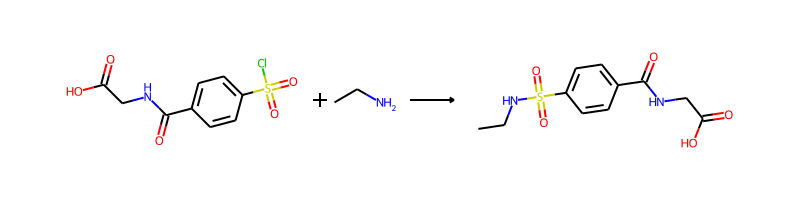

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCN>>CCNS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 172865
RANK 95 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


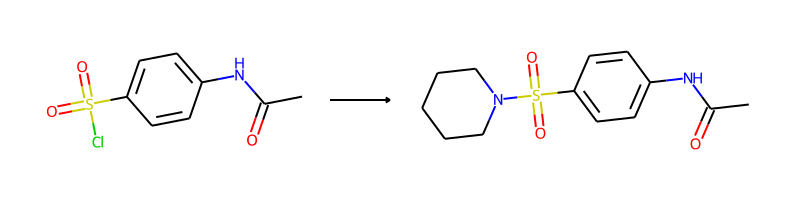

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N1-C-C-C-C-C-1


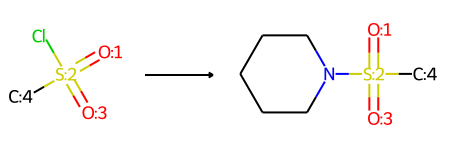

Product similarity 0.6285714285714286, overall 0.3259259259259259, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


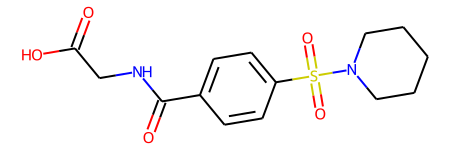

The proposed reaction is:


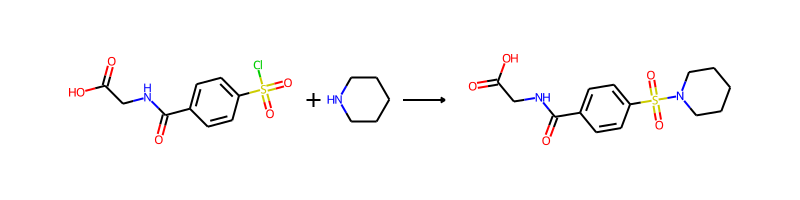

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.C1CCNCC1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)N2CCCCC2)cc1


--------------------------------------------------

Train index: 76468
RANK 96 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


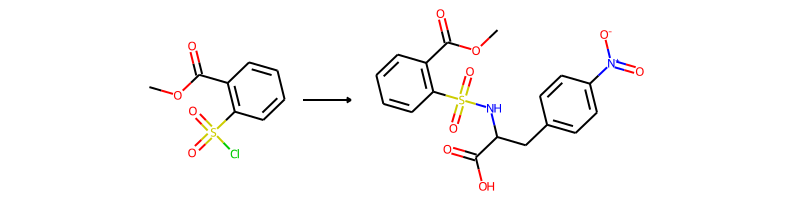

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>O-C(=O)-C(-C-c1:c:c:c(-[N+](=O)-[O-]):c:c:1)-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


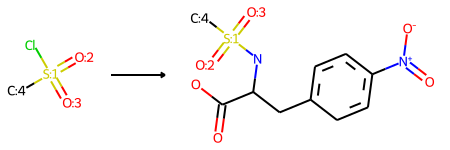

Product similarity 0.7204301075268817, overall 0.3735563520509757, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC(Cc2ccc([N+](=O)[O-])cc2)C(=O)O)cc1


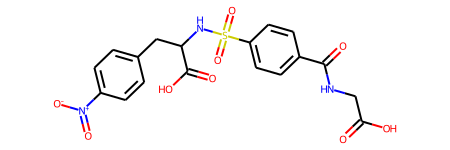

The proposed reaction is:


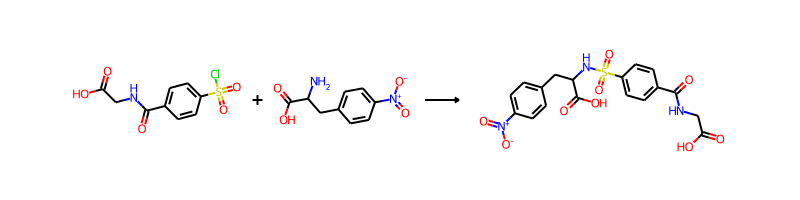

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC(Cc1ccc([N+](=O)[O-])cc1)C(=O)O>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)NC(Cc2ccc([N+](=O)[O-])cc2)C(=O)O)cc1


--------------------------------------------------

Train index: 192965
RANK 97 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


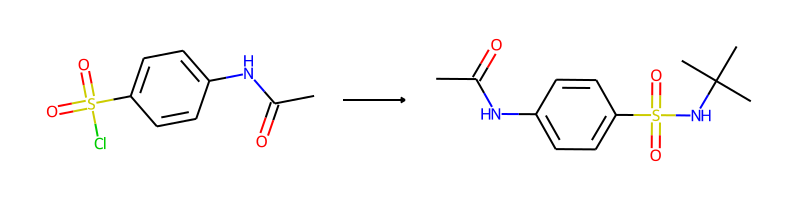

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C(-C)(-C)-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


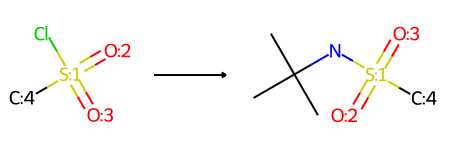

Product similarity 0.59375, overall 0.30787037037037035, smiles CC(C)(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


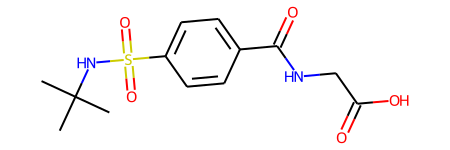

The proposed reaction is:


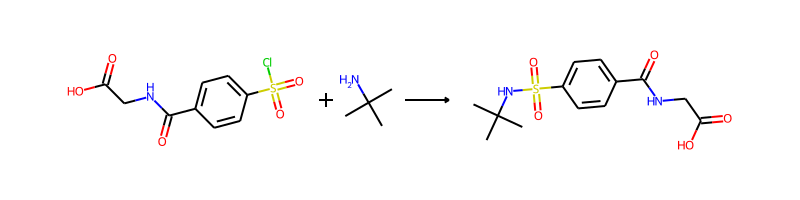

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(C)(C)N>>CC(C)(C)NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 388789
RANK 98 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


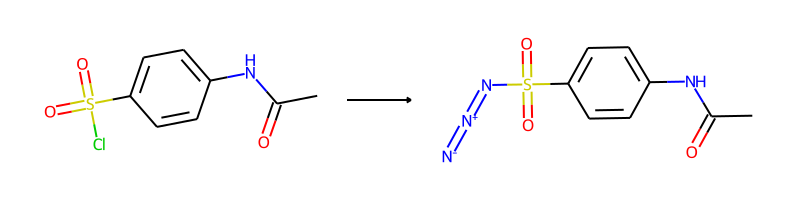

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>[N-]=[N+]=N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]


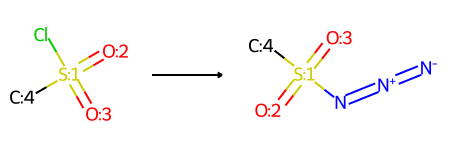

Product similarity 0.5666666666666667, overall 0.2938271604938271, smiles [N-]=[N+]=NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


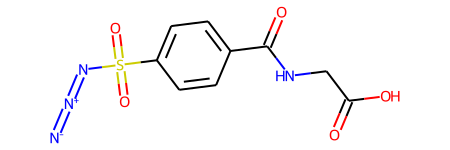

The proposed reaction is:


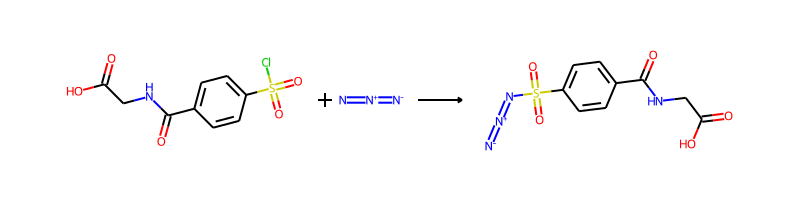

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[N-]=[N+]=[N-]>>[N-]=[N+]=NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1


--------------------------------------------------

Train index: 270935
RANK 99 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


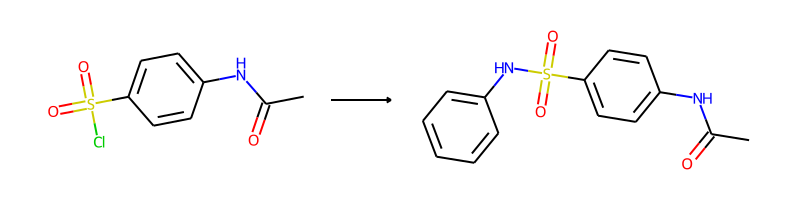

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:2](=[O;D1;H0:1])(=[O;D1;H0:3])-[c:4]>>[O;D1;H0:1]=[S;H0;D4;+0:2](=[O;D1;H0:3])(-[c:4])-N-c1:c:c:c:c:c:1


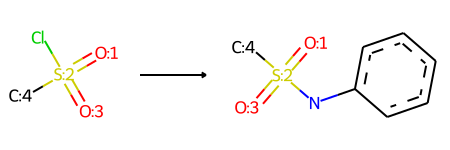

Product similarity 0.6438356164383562, overall 0.33384069000507355, smiles O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccccc2)cc1


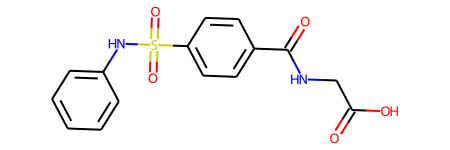

The proposed reaction is:


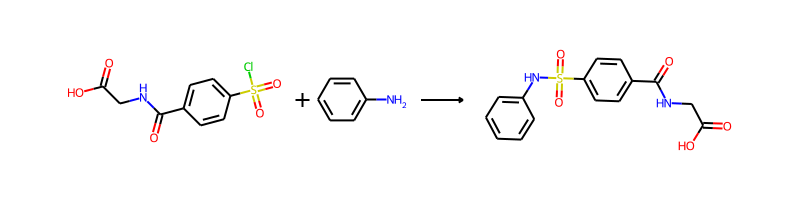

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Nc1ccccc1>>O=C(O)CNC(=O)c1ccc(S(=O)(=O)Nc2ccccc2)cc1


--------------------------------------------------

Train index: 386819
RANK 100 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


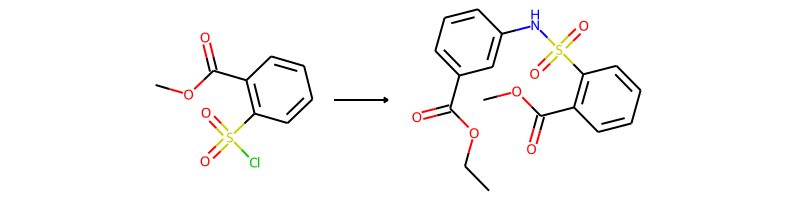

-> template: [Cl;H0;D1;+0]-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]>>C-C-O-C(=O)-c1:c:c:c:c(-N-[S;H0;D4;+0:1](=[O;D1;H0:2])(=[O;D1;H0:3])-[c:4]):c:1


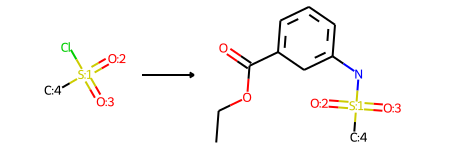

Product similarity 0.6976744186046512, overall 0.36175710594315247, smiles CCOC(=O)c1cccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)c1


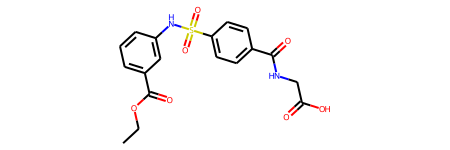

The proposed reaction is:


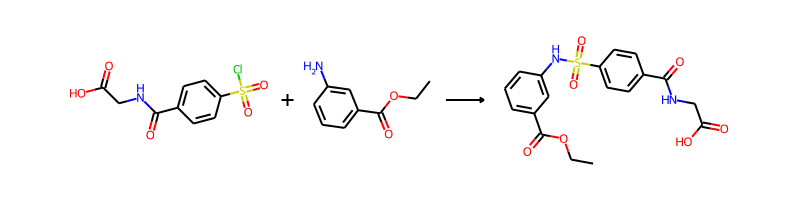

The reaction SMILES string is: O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CCOC(=O)c1cccc(N)c1>>CCOC(=O)c1cccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2)c1


,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles
0,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,N#CC1CN1C(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,[N#CC1CN1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.N#CC1CN1...
1,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,O=C(CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)NC(c1ccccc1)c...,[NC(c1ccccc1)c1ccccc1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.NC(c1ccc...
2,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,CC(NC(=O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1)C(C)(C)C,[CC(N)C(C)(C)C],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CC(N)C(C...
3,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,COC(=O)c1ccc(NS(=O)(=O)c2ccc(C(=O)NCC(=O)O)cc2...,[COC(=O)c1ccc(N)cc1],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.COC(=O)c...
4,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Oc2c(F)c(F)c(F)c(F...,[Oc1c(F)c(F)c(F)c(F)c1F],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.Oc1c(F)c...
...,...,...,...,...,...
56,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,[N-]=[N+]=NS(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1,[[N-]=[N+]=[N-]],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[N-]=[N+...
57,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,CN(C)S(=O)(=O)c1ccc(C(=O)NCC(=O)O)cc1,[CNC],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.CNC>>CN(...
58,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)F)cc1,[[F-]],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1.[F-]>>O=...
59,1,O=C(O)CNC(=O)c1ccc(S(=O)(=O)Cl)cc1,O=C(O)CNC(=O)c1ccc(S)cc1,[],O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1>>O=C(O)C...


In [42]:
diversify_SMILES ('O=C(NCC(O)=O)C1=CC=C(S(=O)(Cl)=O)C=C1',1, draw = True)

### Compound 2
Diversify the compound 'O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F'. Ref: CLEFMA—An anti-proliferative curcuminoid from structure–activity relationship studies on 3,5-bis(benzylidene)-4-piperidones.

In [26]:
import time

In [27]:
start = time.time()
iteration_1_init = diversify_SMILES ('O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F',1)
end = time.time()
print ('Time taken: {}'.format (end-start))

Time taken: 0.7142829895019531


In [28]:
iteration_1_init.head(2)

,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles
0,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,CN(C)c1ccccc1CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(...,[CN(C)c1ccccc1CC(=O)O],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
1,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,CN(C)c1ccccc1CC(=O)C1NC/C(=C\c2ccccc2F)C(=O)/C...,[CN(C)c1ccccc1CC(=O)O],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...


In [29]:
#get reaction SMILES
it1_rxn_smiles = iteration_1_init['Reaction_smiles'].tolist()

#get fast filter output
it1_ffOutput = ff_batch (it1_rxn_smiles)

2023-10-16 10:11:59.493120: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


INFO@fast_filter         : [1697465522.599s]	Starting to load fast filter


INFO@fast_filter         : [1697465523.165s]	Done loading fast filter


In [30]:
#intialize fast filter list
ff_scores = []

# loop through the diversification results
for row in iteration_1_init.itertuples():
    
    #append fast filter score to growing list
    ff_scores.append (it1_ffOutput[row[5]])

iteration_1_init['Fast filter'] = ff_scores

In [31]:
for row in iteration_1_init.sample(1).itertuples():
    print ('Reaction_smiles: {}'.format (row[5]))
    print ('Fast Filter Scores: {}'.format (row[6])) 

Reaction_smiles: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CC(=O)Cl>>CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1
Fast Filter Scores: 0.9986986517906189


In [32]:
#cut off fast filter scores above 0.5
iteration_1 = fast_filter_cutoff (iteration_1_init)

#reset the indices
iteration_1.reset_index(drop= True, inplace = True)

In [33]:
iteration_1.head(5)

,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles,Fast filter
0,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,CN(C)c1ccccc1CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(...,[CN(C)c1ccccc1CC(=O)O],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...,0.996892
1,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,CN(C)c1ccccc1CC(=O)C1NC/C(=C\c2ccccc2F)C(=O)/C...,[CN(C)c1ccccc1CC(=O)O],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...,0.928198
2,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(C(=O)NCCN(C2CC2)S(=O)(=...,"[O=C(Cl)Oc1ccc([N+](=O)[O-])cc1, NCCN(C1CC1)S(...",O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...,0.999998
3,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(C(=O)Cc2ccccc2)C/C1=C\c...,[O=C(Cl)Cc1ccccc1],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...,0.999727
4,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(C(=O)NCc2ccc(F)cc2)C/C1...,[O=C=NCc1ccc(F)cc1],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...,0.999957


In [34]:
iteration_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 6 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Iteration         25 non-null     int64  
 1   Reactant_input    25 non-null     object 
 2   Product_output    25 non-null     object 
 3   Coupling_partner  25 non-null     object 
 4   Reaction_smiles   25 non-null     object 
 5   Fast filter       25 non-null     float64
dtypes: float64(1), int64(1), object(4)
memory usage: 1.3+ KB


In [35]:
prod_list = iteration_1['Product_output'].tolist()
print ('The length of the original list is: {}'.format (len (prod_list)))
print ('The number of unique elements is: {}'.format (len (set(prod_list))))

The length of the original list is: 25
The number of unique elements is: 25


Input Compound:O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F


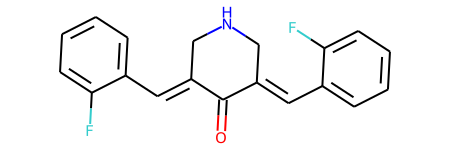

*****************
Analog #1


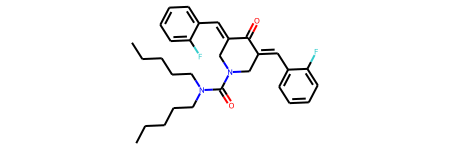

SMILES:CCCCCN(CCCCC)C(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1
*******************
Analog #2


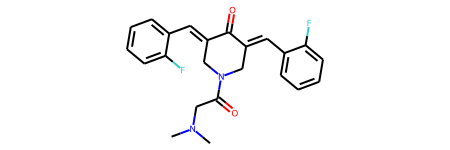

SMILES:CN(C)CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1
*******************
Analog #3


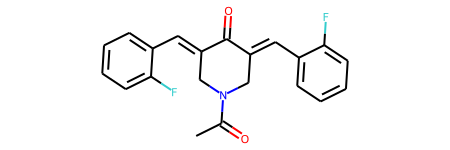

SMILES:CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1
*******************
Analog #4


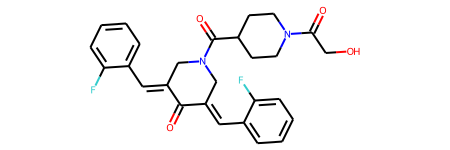

SMILES:O=C1/C(=C/c2ccccc2F)CN(C(=O)C2CCN(C(=O)CO)CC2)C/C1=C\c1ccccc1F
*******************
Analog #5


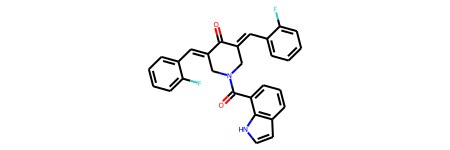

SMILES:O=C1/C(=C/c2ccccc2F)CN(C(=O)c2cccc3cc[nH]c23)C/C1=C\c1ccccc1F
*******************


In [39]:
#randomly sample 5 examples
iteration_1_5examples = iteration_1.sample (n = 5)
count = 0
for row in iteration_1_5examples.itertuples():
    count += 1
    if count == 1:
        print ('Input Compound:{}'.format (row[2]))
        reac = Chem.MolFromSmiles(row[2])
        display (reac)
        print ('*****************')
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

Input Compound:O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F


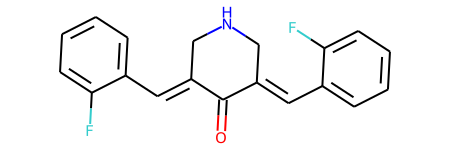

*****************
Analog #1


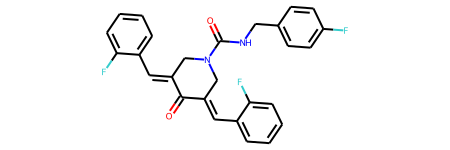

SMILES:O=C1/C(=C/c2ccccc2F)CN(C(=O)NCc2ccc(F)cc2)C/C1=C\c1ccccc1F
*******************
Analog #2


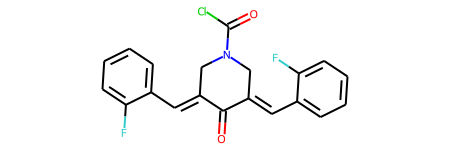

SMILES:O=C1/C(=C/c2ccccc2F)CN(C(=O)Cl)C/C1=C\c1ccccc1F
*******************
Analog #3


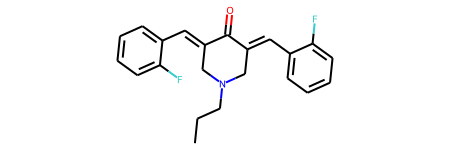

SMILES:CCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1
*******************
Analog #4


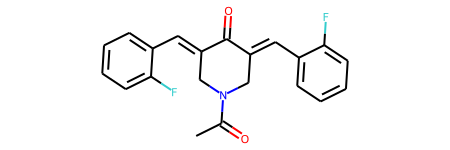

SMILES:CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1
*******************
Analog #5


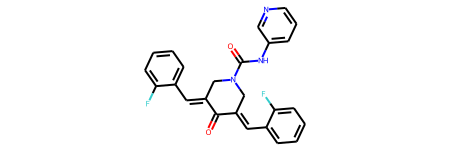

SMILES:O=C1/C(=C/c2ccccc2F)CN(C(=O)Nc2cccnc2)C/C1=C\c1ccccc1F
*******************


In [40]:
#randomly sample 5 examples
iteration_1_5examples = iteration_1.sample (n = 5)
count = 0
for row in iteration_1_5examples.itertuples():
    count += 1
    if count == 1:
        print ('Input Compound:{}'.format (row[2]))
        reac = Chem.MolFromSmiles(row[2])
        display (reac)
        print ('*****************')
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

SMILES: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F, reactant input:


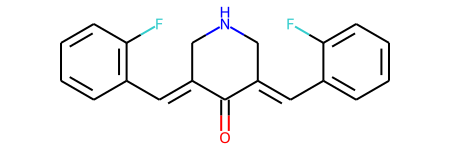



--------------------------------------------------

Train index: 338885
RANK 1 PRECEDENT
REACTANT MATCH SCORE: 0.6463414634146342


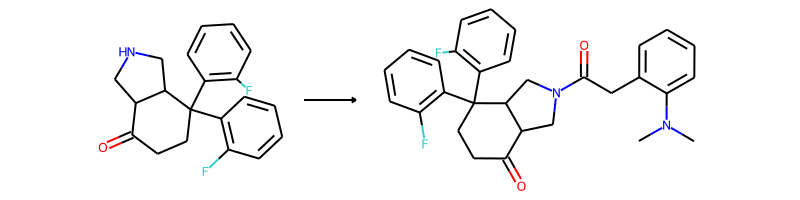

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-N(-C)-c1:c:c:c:c:c:1-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


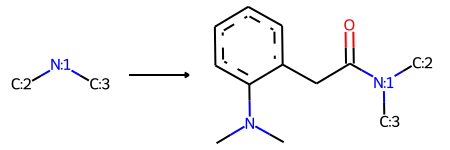

Product similarity 0.7478260869565218, overall 0.4833510074231177, smiles CN(C)c1ccccc1CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


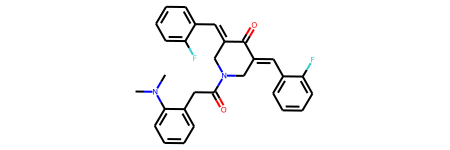

The proposed reaction is:


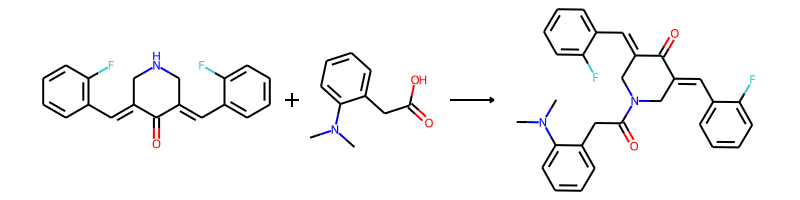

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CN(C)c1ccccc1CC(=O)O>>CN(C)c1ccccc1CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 434397
RANK 2 PRECEDENT
REACTANT MATCH SCORE: 0.6463414634146342


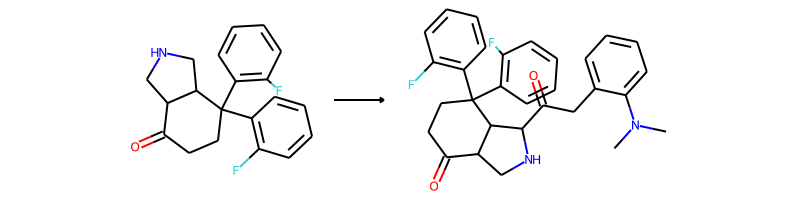

-> template: [#7:2]-[CH2;D2;+0:1]-[C:3]>>C-N(-C)-c1:c:c:c:c:c:1-C-C(=O)-[CH;D3;+0:1](-[#7:2])-[C:3]


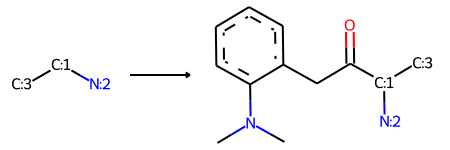

Product similarity 0.7478260869565218, overall 0.4833510074231177, smiles CN(C)c1ccccc1CC(=O)C1NC/C(=C\c2ccccc2F)C(=O)/C1=C/c1ccccc1F


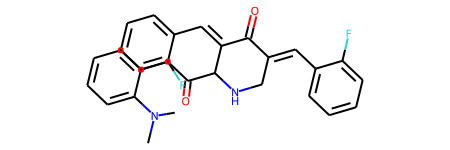

The proposed reaction is:


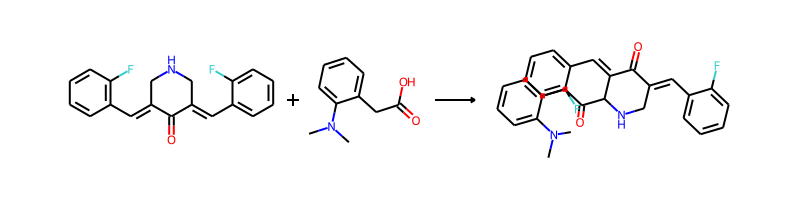

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CN(C)c1ccccc1CC(=O)O>>CN(C)c1ccccc1CC(=O)C1NC/C(=C\c2ccccc2F)C(=O)/C1=C/c1ccccc1F


--------------------------------------------------

Train index: 228711
RANK 3 PRECEDENT
REACTANT MATCH SCORE: 0.5949367088607594


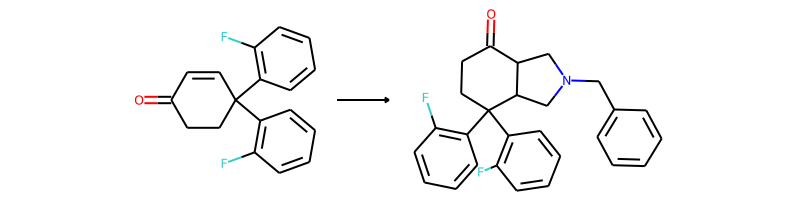

-> template: [C:1]-[CH;D2;+0:2]=[CH;D2;+0:3]-[C:4]=[O;D1;H0:5]>>[C:1]-[CH;D3;+0:2]1-C-N(-C-c2:c:c:c:c:c:2)-C-[CH;D3;+0:3]-1-[C:4]=[O;D1;H0:5]


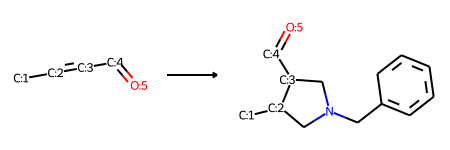

->No precursors could be generated!


--------------------------------------------------

Train index: 190880
RANK 4 PRECEDENT
REACTANT MATCH SCORE: 0.5857142857142857


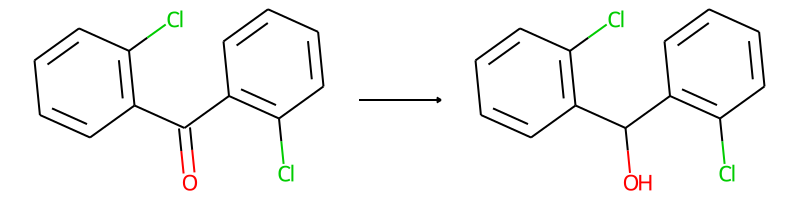

-> template: [O;H0;D1;+0:1]=[C;H0;D3;+0:2](-[c:3])-[c:4]>>[OH;D1;+0:1]-[CH;D3;+0:2](-[c:3])-[c:4]


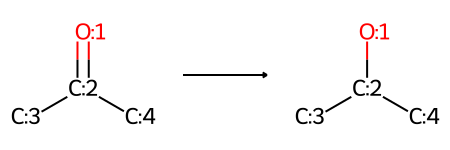

->No precursors could be generated!


--------------------------------------------------

Train index: 25390
RANK 5 PRECEDENT
REACTANT MATCH SCORE: 0.5783132530120482


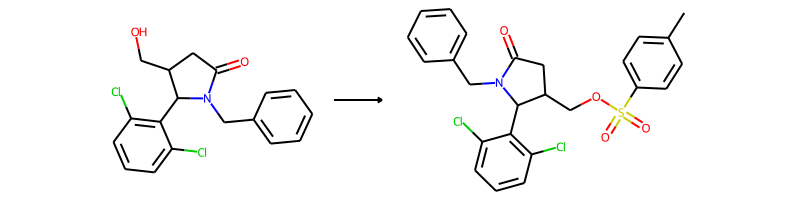

-> template: [C:2]-[OH;D1;+0:1]>>C-c1:c:c:c(-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]):c:c:1


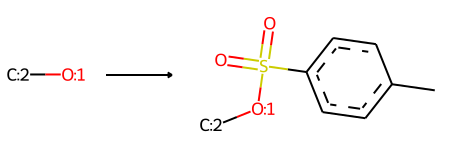

->No precursors could be generated!


--------------------------------------------------

Train index: 1999
RANK 6 PRECEDENT
REACTANT MATCH SCORE: 0.5697674418604651


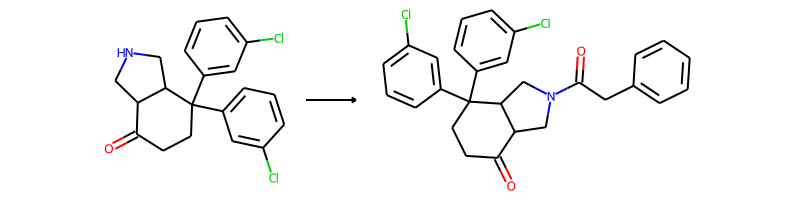

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O=C(-C-c1:c:c:c:c:c:1)-[N;H0;D3;+0:1](-[C:2])-[C:3]


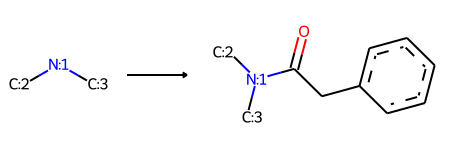

Product similarity 0.6696428571428571, overall 0.38154069767441856, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)Cc2ccccc2)C/C1=C\c1ccccc1F


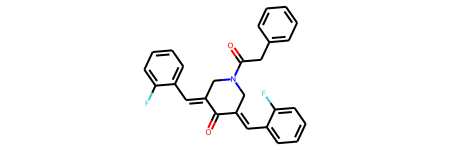

The proposed reaction is:


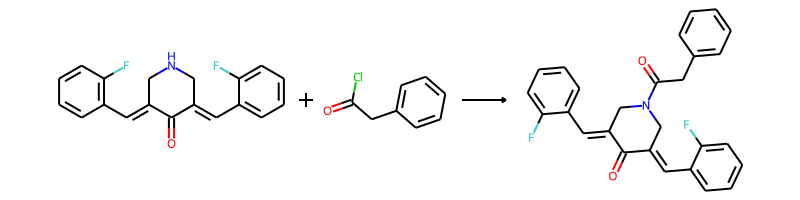

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C(Cl)Cc1ccccc1>>O=C1/C(=C/c2ccccc2F)CN(C(=O)Cc2ccccc2)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 61455
RANK 7 PRECEDENT
REACTANT MATCH SCORE: 0.5625


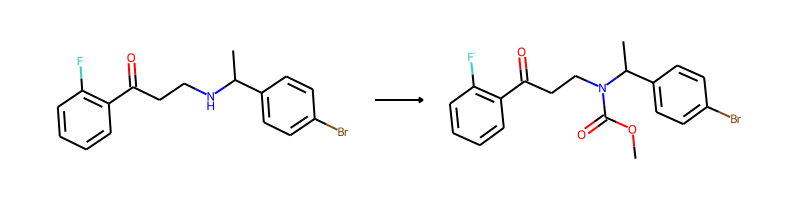

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-O-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


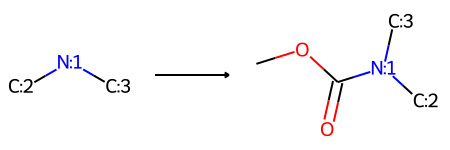

Product similarity 0.6292134831460674, overall 0.3539325842696629, smiles COC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


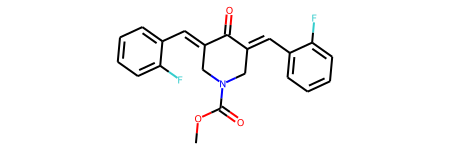

The proposed reaction is:


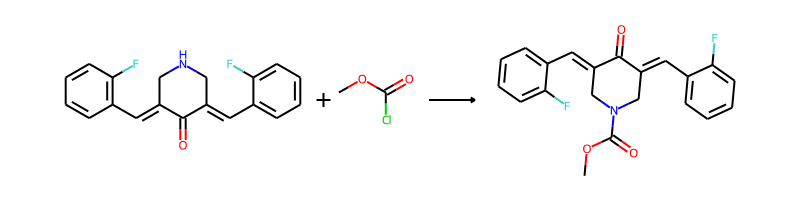

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.COC(=O)Cl>>COC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 353507
RANK 8 PRECEDENT
REACTANT MATCH SCORE: 0.5609756097560976


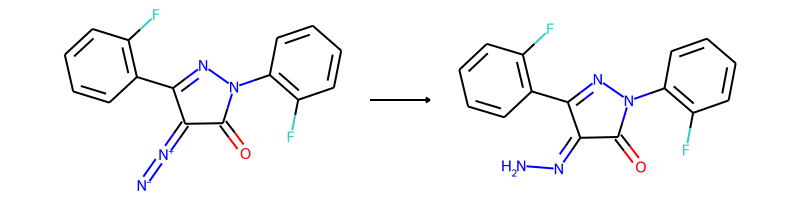

-> template: [#7:1]-[C:2](=[O;D1;H0:3])-[C:4]=[N+;H0;D2:5]=[N-;H0;D1:6]>>[#7:1]-[C:2](=[O;D1;H0:3])-[C:4]=[N;H0;D2;+0:5]-[NH2;D1;+0:6]


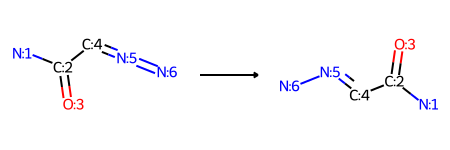

->No precursors could be generated!


--------------------------------------------------

Train index: 241548
RANK 9 PRECEDENT
REACTANT MATCH SCORE: 0.56


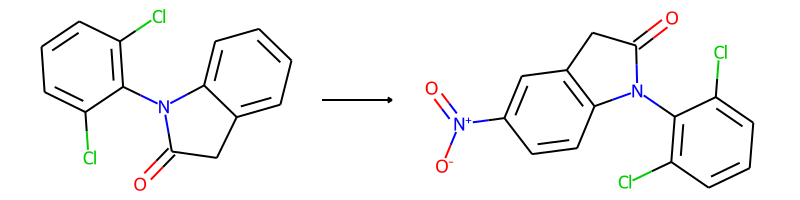

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O=[N+](-[O-])-[c;H0;D3;+0:1](:[c:2]):[c:3]


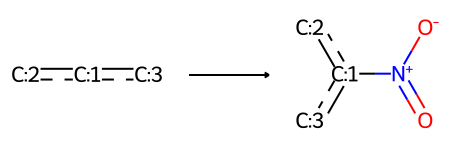

Product similarity 0.5975609756097561, overall 0.33463414634146343, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cc([N+](=O)[O-])ccc1F


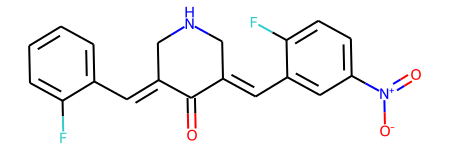

The proposed reaction is:


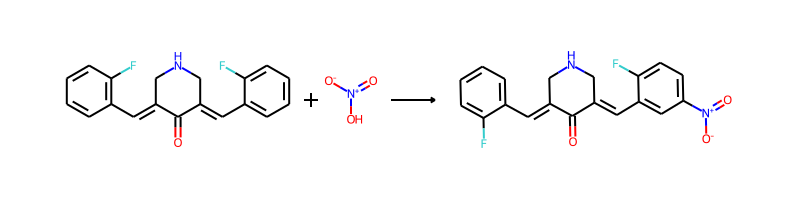

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cc([N+](=O)[O-])ccc1F
Product similarity 0.5232558139534884, overall 0.29302325581395355, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cccc([N+](=O)[O-])c1F


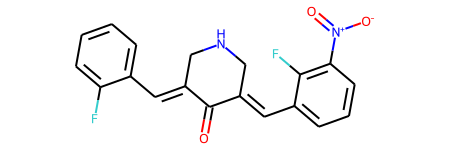

The proposed reaction is:


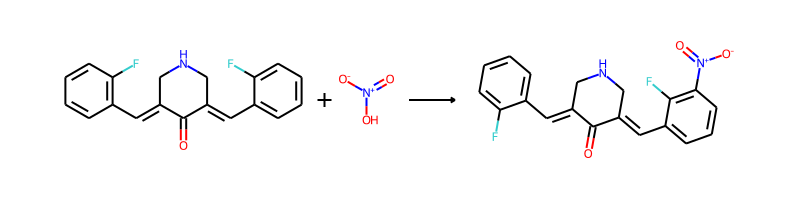

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cccc([N+](=O)[O-])c1F
Product similarity 0.5595238095238095, overall 0.31333333333333335, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccc([N+](=O)[O-])cc1F


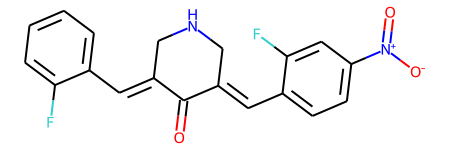

The proposed reaction is:


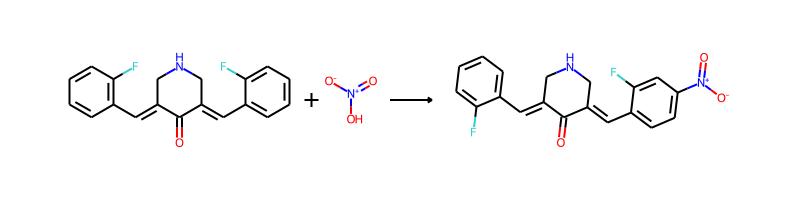

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccc([N+](=O)[O-])cc1F
Product similarity 0.5595238095238095, overall 0.31333333333333335, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1c(F)cccc1[N+](=O)[O-]


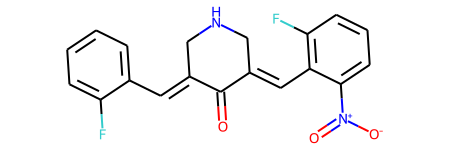

The proposed reaction is:


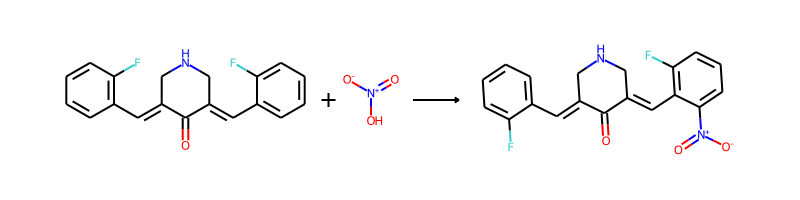

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1c(F)cccc1[N+](=O)[O-]


--------------------------------------------------

Train index: 269815
RANK 10 PRECEDENT
REACTANT MATCH SCORE: 0.5595238095238095


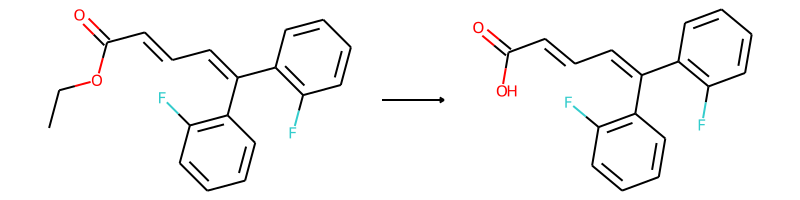

-> template: [C:1]=[C:2]-[C;H0;D3;+0:3](=[O;H0;D1;+0:5])-[O;H0;D2;+0:4]-[C;H2;D2;+0]-[C;H3;D1;+0]>>[C:1]=[C:2]-[C;H0;D3;+0:3](=[O;H0;D1;+0:4])-[OH;D1;+0:5]


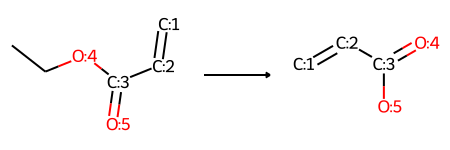

->No precursors could be generated!


--------------------------------------------------

Train index: 204538
RANK 11 PRECEDENT
REACTANT MATCH SCORE: 0.5540540540540541


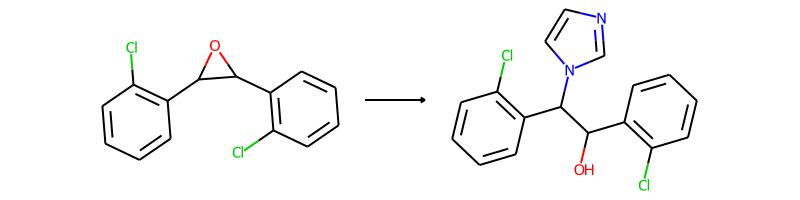

-> template: [c:4]-[CH;D3;+0:3]1-[C:2]-[O;H0;D2;+0:1]-1>>[OH;D1;+0:1]-[C:2]-[CH;D3;+0:3](-[c:4])-n1:c:c:n:c:1


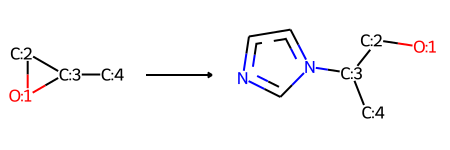

->No precursors could be generated!


--------------------------------------------------

Train index: 91592
RANK 12 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


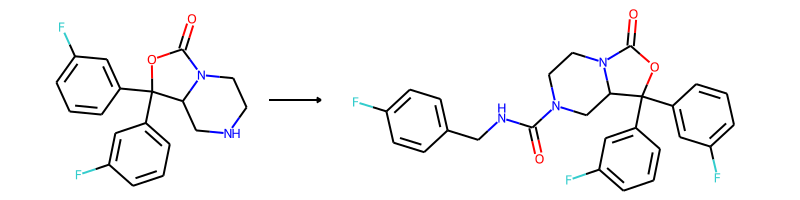

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>F-c1:c:c:c(-C-N-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]):c:c:1


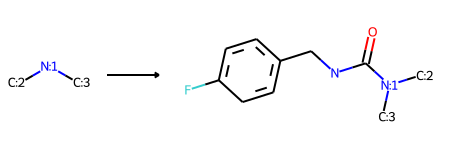

Product similarity 0.6694915254237288, overall 0.36937463471654003, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)NCc2ccc(F)cc2)C/C1=C\c1ccccc1F


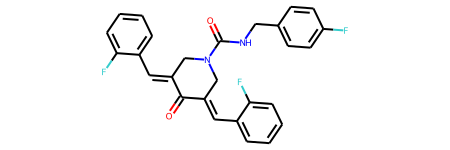

The proposed reaction is:


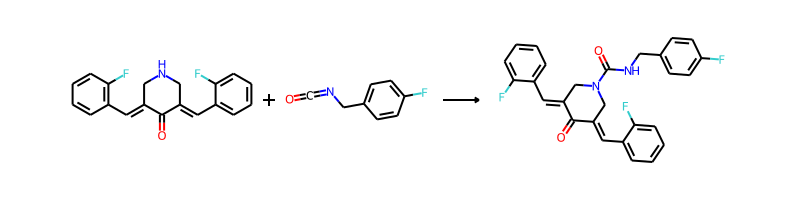

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C=NCc1ccc(F)cc1>>O=C1/C(=C/c2ccccc2F)CN(C(=O)NCc2ccc(F)cc2)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 344281
RANK 13 PRECEDENT
REACTANT MATCH SCORE: 0.5517241379310345


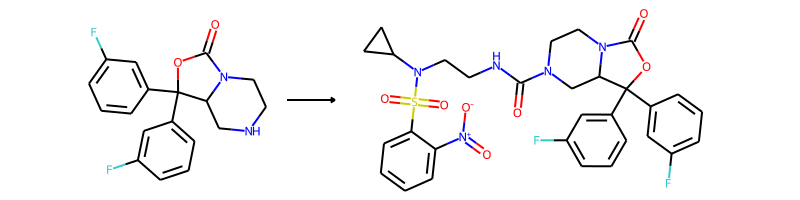

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O=C(-N-C-C-N(-C1-C-C-1)-S(=O)(=O)-c1:c:c:c:c:c:1-[N+](=O)-[O-])-[N;H0;D3;+0:1](-[C:2])-[C:3]


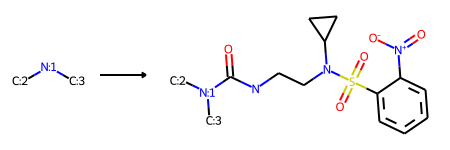

Product similarity 0.7291666666666666, overall 0.4022988505747126, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)NCCN(C2CC2)S(=O)(=O)c2ccccc2[N+](=O)[O-])C/C1=C\c1ccccc1F


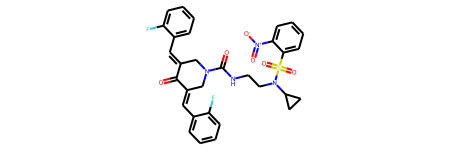

The proposed reaction is:


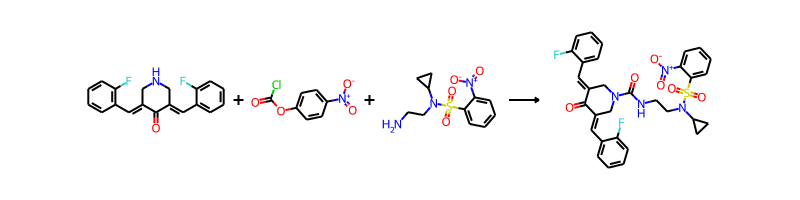

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C(Cl)Oc1ccc([N+](=O)[O-])cc1.NCCN(C1CC1)S(=O)(=O)c1ccccc1[N+](=O)[O-]>>O=C1/C(=C/c2ccccc2F)CN(C(=O)NCCN(C2CC2)S(=O)(=O)c2ccccc2[N+](=O)[O-])C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 354265
RANK 14 PRECEDENT
REACTANT MATCH SCORE: 0.5512820512820513


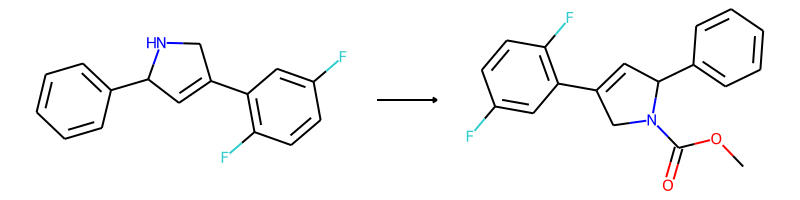

-> template: [C:4]1=[C:3]-[C:2]-[NH;D2;+0:1]-[C:5]-1>>C-O-C(=O)-[N;H0;D3;+0:1]1-[C:2]-[C:3]=[C:4]-[C:5]-1


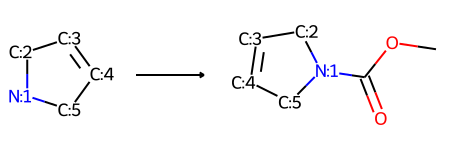

->No precursors could be generated!


--------------------------------------------------

Train index: 186503
RANK 15 PRECEDENT
REACTANT MATCH SCORE: 0.5512820512820513


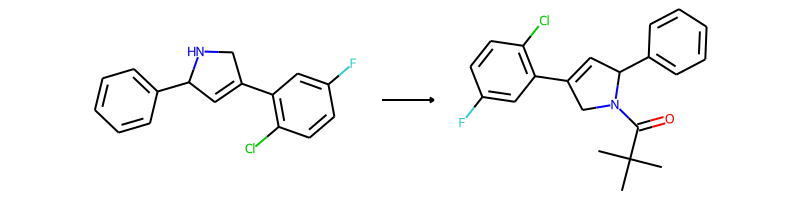

-> template: [C:4]1=[C:3]-[C:2]-[NH;D2;+0:1]-[C:5]-1>>C-C(-C)(-C)-C(=O)-[N;H0;D3;+0:1]1-[C:2]-[C:3]=[C:4]-[C:5]-1


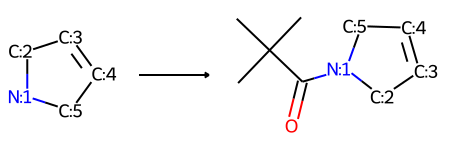

->No precursors could be generated!


--------------------------------------------------

Train index: 393366
RANK 16 PRECEDENT
REACTANT MATCH SCORE: 0.5512820512820513


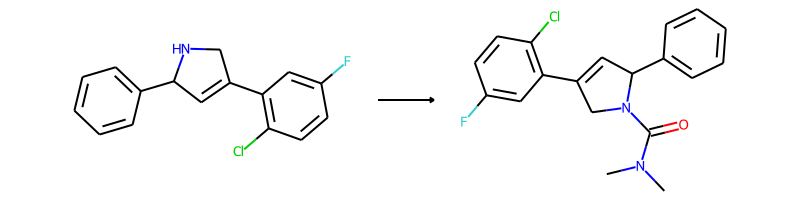

-> template: [C:4]1=[C:3]-[C:2]-[NH;D2;+0:1]-[C:5]-1>>C-N(-C)-C(=O)-[N;H0;D3;+0:1]1-[C:2]-[C:3]=[C:4]-[C:5]-1


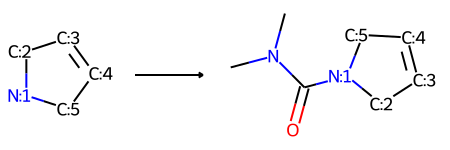

->No precursors could be generated!


--------------------------------------------------

Train index: 393073
RANK 17 PRECEDENT
REACTANT MATCH SCORE: 0.5512820512820513


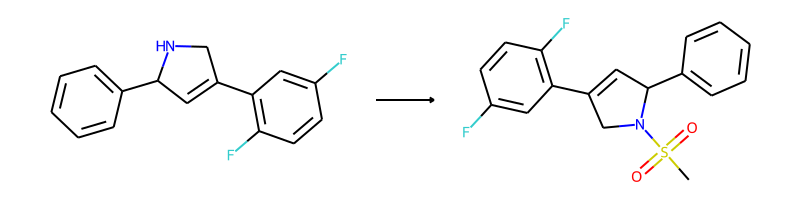

-> template: [C:4]1=[C:3]-[C:2]-[NH;D2;+0:1]-[C:5]-1>>C-S(=O)(=O)-[N;H0;D3;+0:1]1-[C:2]-[C:3]=[C:4]-[C:5]-1


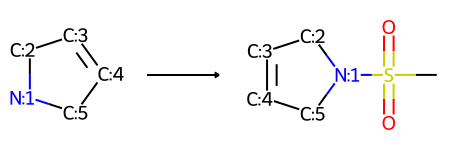

->No precursors could be generated!


--------------------------------------------------

Train index: 142338
RANK 18 PRECEDENT
REACTANT MATCH SCORE: 0.5512820512820513


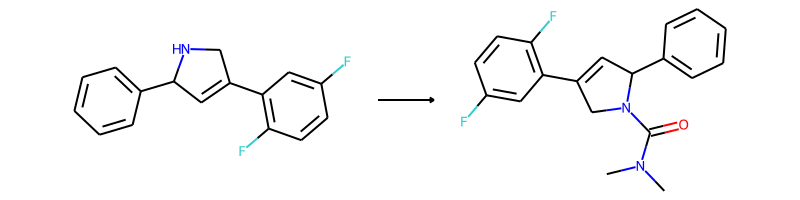

-> template: [C:4]1=[C:3]-[C:2]-[NH;D2;+0:1]-[C:5]-1>>C-N(-C)-C(=O)-[N;H0;D3;+0:1]1-[C:2]-[C:3]=[C:4]-[C:5]-1


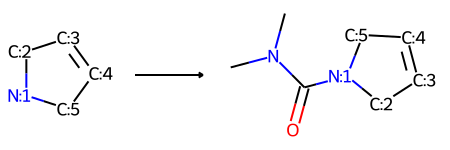

->No precursors could be generated!


--------------------------------------------------

Train index: 387811
RANK 19 PRECEDENT
REACTANT MATCH SCORE: 0.5465116279069767


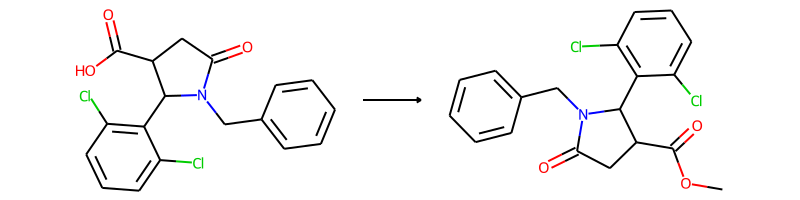

-> template: [O;D1;H0:3]=[C:2]-[OH;D1;+0:1]>>C-[O;H0;D2;+0:1]-[C:2]=[O;D1;H0:3]


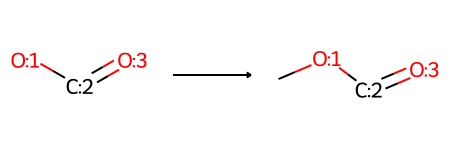

->No precursors could be generated!


--------------------------------------------------

Train index: 53975
RANK 20 PRECEDENT
REACTANT MATCH SCORE: 0.5465116279069767


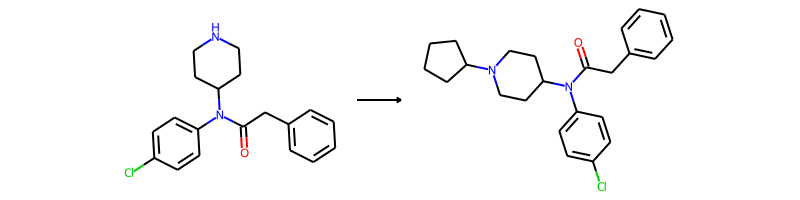

-> template: [C:1]-[NH;D2;+0:2]-[C:3]>>[C:1]-[N;H0;D3;+0:2](-[C:3])-C1-C-C-C-C-1


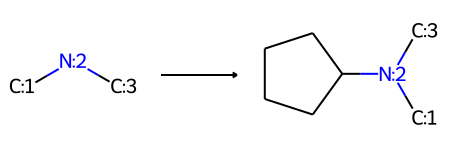

Product similarity 0.6138613861386139, overall 0.3354823854478471, smiles O=C1/C(=C/c2ccccc2F)CN(C2CCCC2)C/C1=C\c1ccccc1F


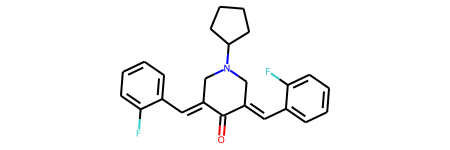

The proposed reaction is:


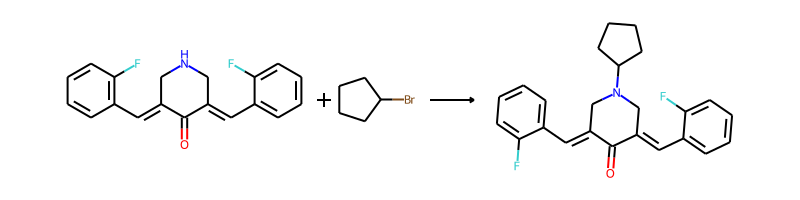

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.BrC1CCCC1>>O=C1/C(=C/c2ccccc2F)CN(C2CCCC2)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 248883
RANK 21 PRECEDENT
REACTANT MATCH SCORE: 0.5421686746987951


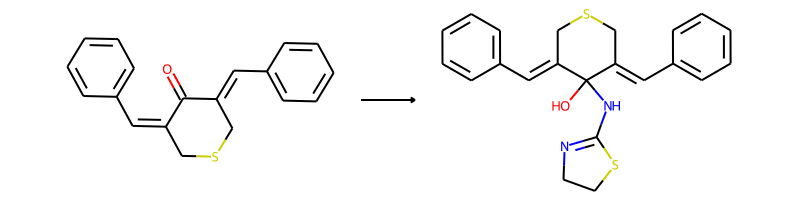

-> template: [C:1]=[C:2]-[C;H0;D3;+0:3](=[O;H0;D1;+0:4])-[C:5]=[C:6]>>[C:1]=[C:2]-[C;H0;D4;+0:3](-[OH;D1;+0:4])(-N-C1=N-C-C-S-1)-[C:5]=[C:6]


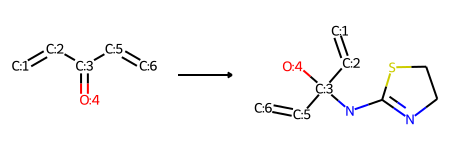

Product similarity 0.6237623762376238, overall 0.33818442085172373, smiles OC1(NC2=NCCS2)/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F


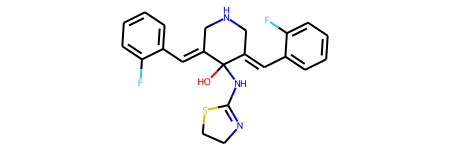

The proposed reaction is:


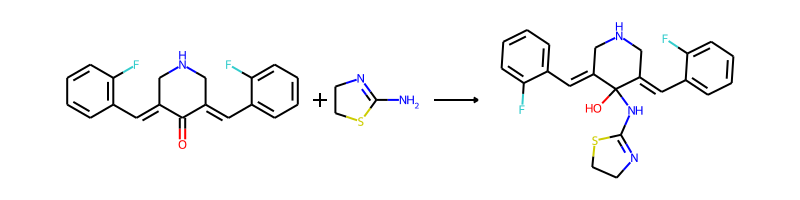

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.NC1=NCCS1>>OC1(NC2=NCCS2)/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 33302
RANK 22 PRECEDENT
REACTANT MATCH SCORE: 0.5416666666666666


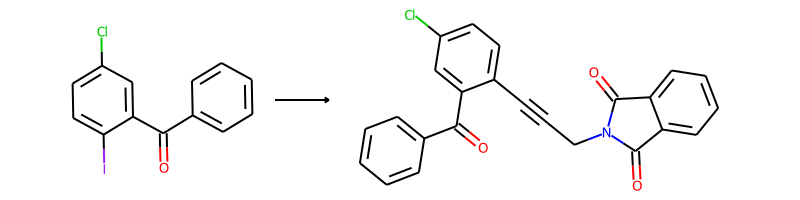

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5]>>O=C1-N(-C-C#C-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5])-C(=O)-c2:c:c:c:c:c:2-1


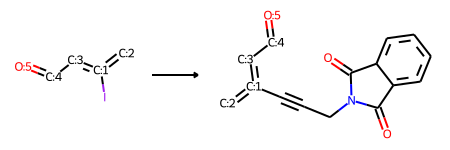

->No precursors could be generated!


--------------------------------------------------

Train index: 447337
RANK 23 PRECEDENT
REACTANT MATCH SCORE: 0.5416666666666666


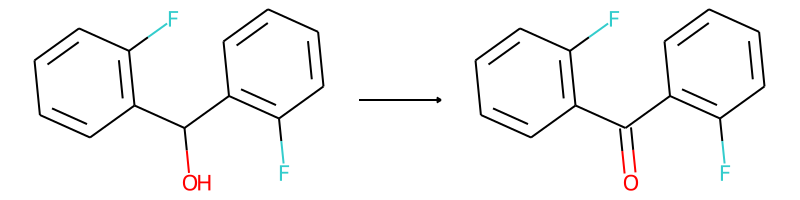

-> template: [OH;D1;+0:1]-[CH;D3;+0:2](-[c:3])-[c:4]>>[O;H0;D1;+0:1]=[C;H0;D3;+0:2](-[c:3])-[c:4]


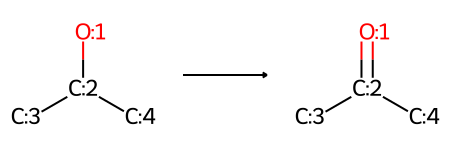

->No precursors could be generated!


--------------------------------------------------

Train index: 172906
RANK 24 PRECEDENT
REACTANT MATCH SCORE: 0.5416666666666666


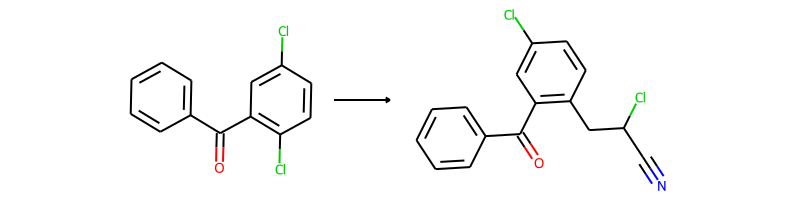

-> template: [Cl;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5]>>Cl-C(-C-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5])-C#N


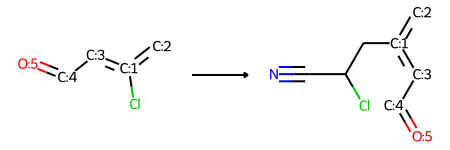

->No precursors could be generated!


--------------------------------------------------

Train index: 187834
RANK 25 PRECEDENT
REACTANT MATCH SCORE: 0.5416666666666666


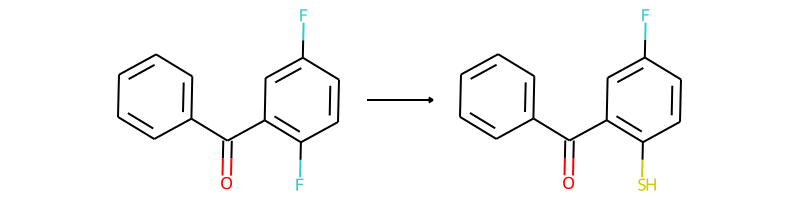

-> template: [F;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5]>>S-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5]


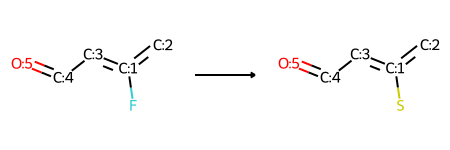

->No precursors could be generated!


--------------------------------------------------

Train index: 407386
RANK 26 PRECEDENT
REACTANT MATCH SCORE: 0.5416666666666666


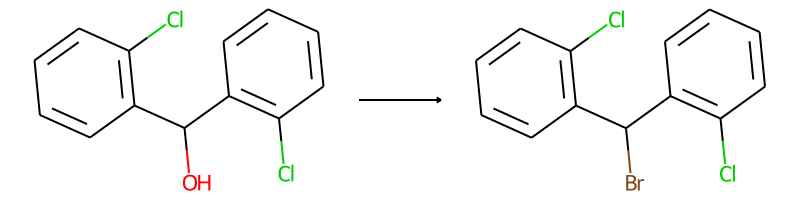

-> template: [O;H1;D1;+0]-[CH;D3;+0:1](-[c:2])-[c:3]>>Br-[CH;D3;+0:1](-[c:2])-[c:3]


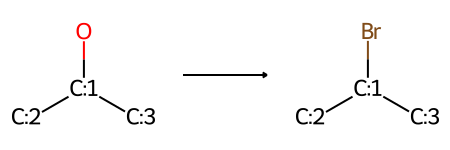

->No precursors could be generated!


--------------------------------------------------

Train index: 322999
RANK 27 PRECEDENT
REACTANT MATCH SCORE: 0.5416666666666666


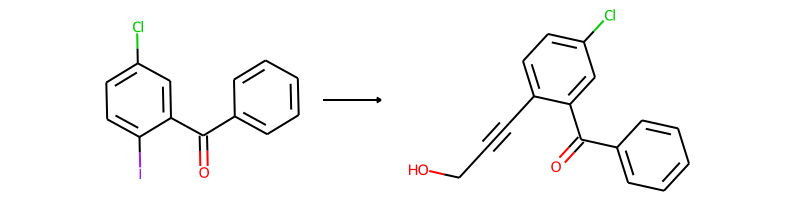

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5]>>O-C-C#C-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[O;D1;H0:5]


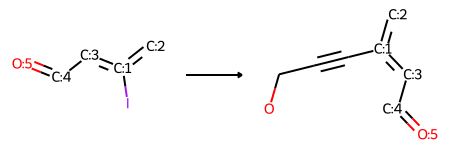

->No precursors could be generated!


--------------------------------------------------

Train index: 140086
RANK 28 PRECEDENT
REACTANT MATCH SCORE: 0.5416666666666666


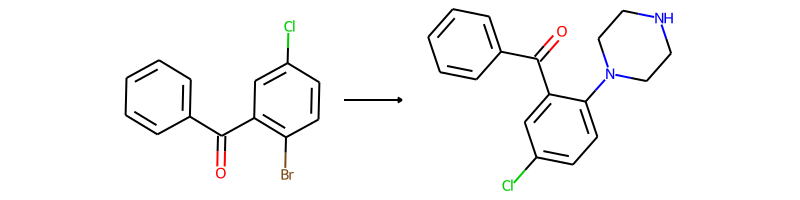

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:4](:[c:5]):[c:3]-[C:2]=[O;D1;H0:1]>>[O;D1;H0:1]=[C:2]-[c:3]:[c;H0;D3;+0:4](:[c:5])-N1-C-C-N-C-C-1


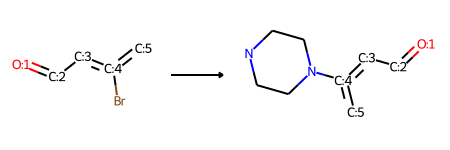

->No precursors could be generated!


--------------------------------------------------

Train index: 404455
RANK 29 PRECEDENT
REACTANT MATCH SCORE: 0.5375


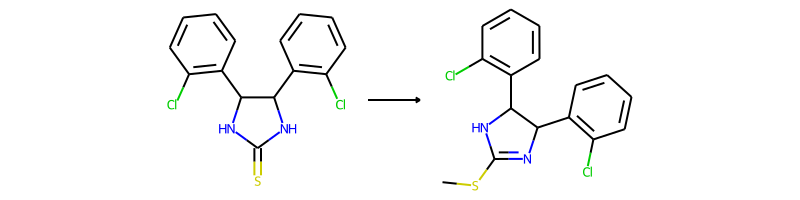

-> template: [#7:3]-[C;H0;D3;+0:2](=[S;H0;D1;+0:1])-[NH;D2;+0:4]-[C:5]>>C-[S;H0;D2;+0:1]-[C;H0;D3;+0:2](-[#7:3])=[N;H0;D2;+0:4]-[C:5]


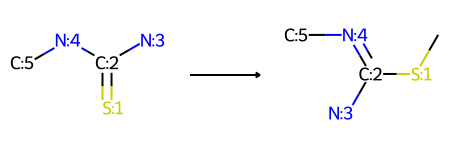

->No precursors could be generated!


--------------------------------------------------

Train index: 208908
RANK 30 PRECEDENT
REACTANT MATCH SCORE: 0.5375


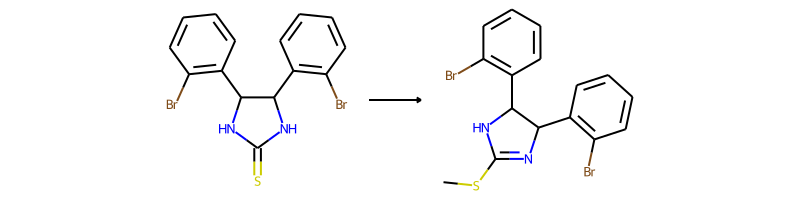

-> template: [#7:3]-[C;H0;D3;+0:2](=[S;H0;D1;+0:1])-[NH;D2;+0:4]-[C:5]>>C-[S;H0;D2;+0:1]-[C;H0;D3;+0:2](-[#7:3])=[N;H0;D2;+0:4]-[C:5]


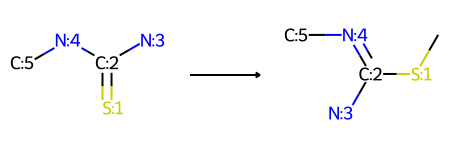

->No precursors could be generated!


--------------------------------------------------

Train index: 380481
RANK 31 PRECEDENT
REACTANT MATCH SCORE: 0.5365853658536586


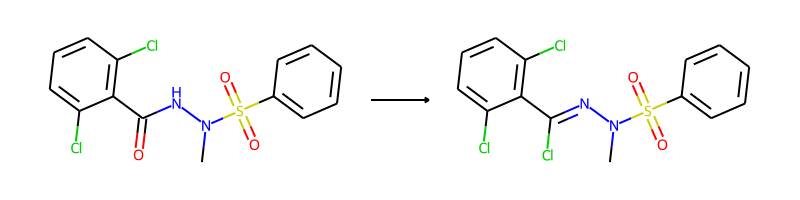

-> template: [#7:4]-[NH;D2;+0:3]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[c:2]>>Cl-[C;H0;D3;+0:1](-[c:2])=[N;H0;D2;+0:3]-[#7:4]


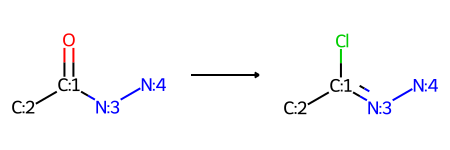

->No precursors could be generated!


--------------------------------------------------

Train index: 365443
RANK 32 PRECEDENT
REACTANT MATCH SCORE: 0.5348837209302325


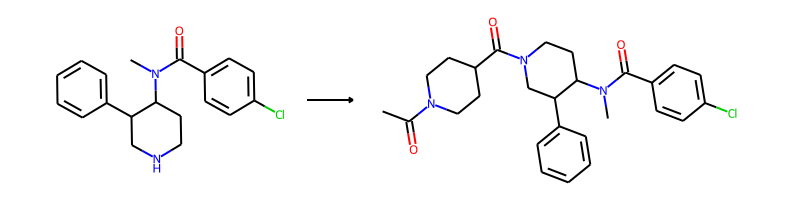

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C(=O)-N1-C-C-C(-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3])-C-C-1


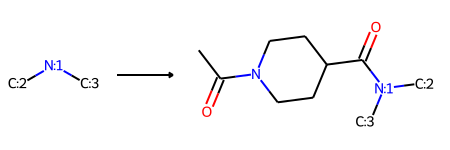

Product similarity 0.6551724137931034, overall 0.3504410585404972, smiles CC(=O)N1CCC(C(=O)N2C/C(=C\c3ccccc3F)C(=O)/C(=C/c3ccccc3F)C2)CC1


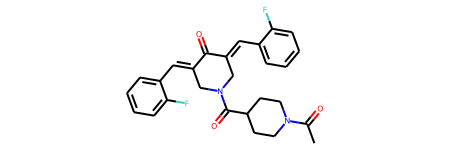

The proposed reaction is:


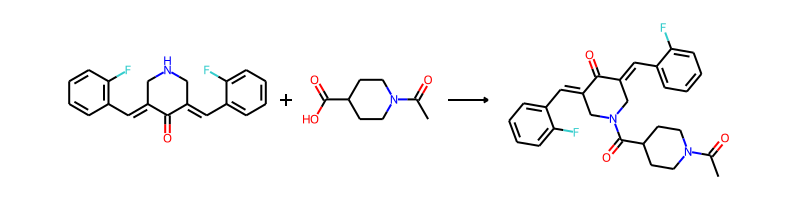

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CC(=O)N1CCC(C(=O)O)CC1>>CC(=O)N1CCC(C(=O)N2C/C(=C\c3ccccc3F)C(=O)/C(=C/c3ccccc3F)C2)CC1


--------------------------------------------------

Train index: 290908
RANK 33 PRECEDENT
REACTANT MATCH SCORE: 0.5340909090909091


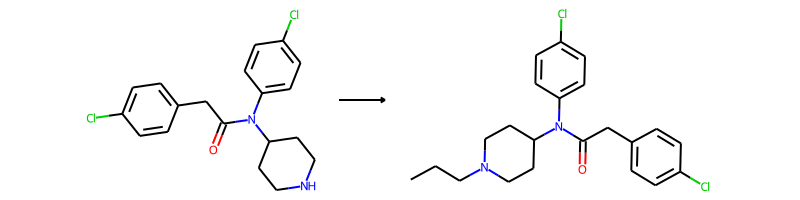

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


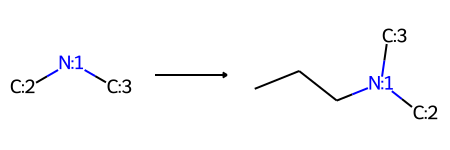

Product similarity 0.5729166666666666, overall 0.3059895833333333, smiles CCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


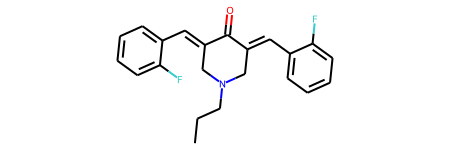

The proposed reaction is:


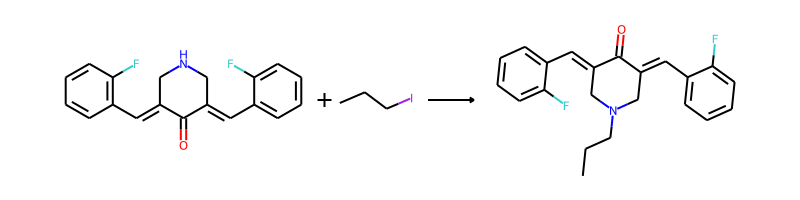

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CCCI>>CCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 264245
RANK 34 PRECEDENT
REACTANT MATCH SCORE: 0.5308641975308642


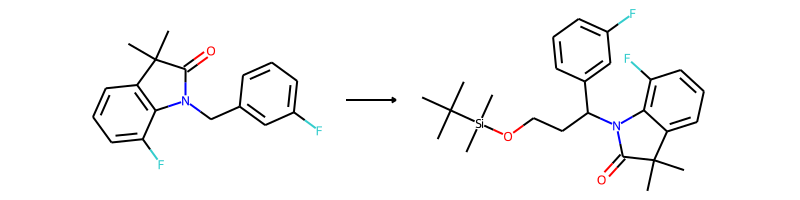

-> template: [O;D1;H0:5]=[C:4]-[#7:3]-[CH2;D2;+0:1]-[c:2]>>C-C(-C)(-C)-[Si](-C)(-C)-O-C-C-[CH;D3;+0:1](-[c:2])-[#7:3]-[C:4]=[O;D1;H0:5]


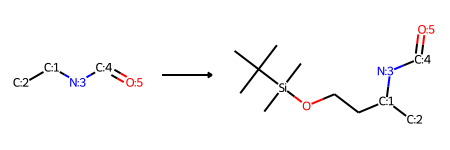

->No precursors could be generated!


--------------------------------------------------

Train index: 4983
RANK 35 PRECEDENT
REACTANT MATCH SCORE: 0.5301204819277109


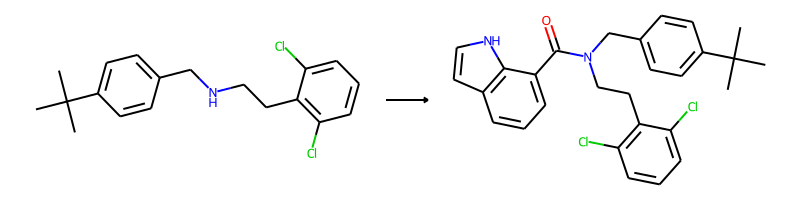

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O=C(-[N;H0;D3;+0:1](-[C:2])-[C:3])-c1:c:c:c:c2:c:c:[nH]:c:1:2


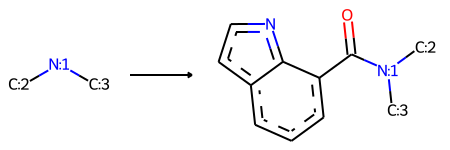

Product similarity 0.6608695652173913, overall 0.35034049240440024, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)c2cccc3cc[nH]c23)C/C1=C\c1ccccc1F


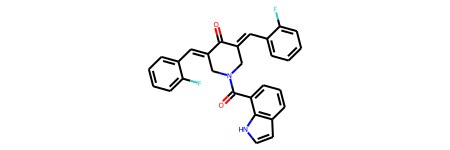

The proposed reaction is:


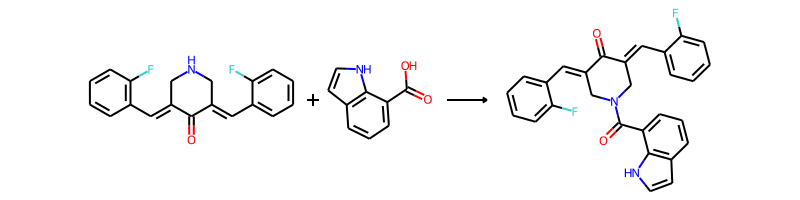

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C(O)c1cccc2cc[nH]c12>>O=C1/C(=C/c2ccccc2F)CN(C(=O)c2cccc3cc[nH]c23)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 7590
RANK 36 PRECEDENT
REACTANT MATCH SCORE: 0.5301204819277109


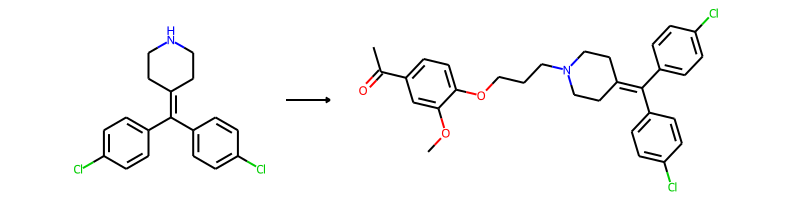

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-O-c1:c:c(-C(-C)=O):c:c:c:1-O-C-C-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


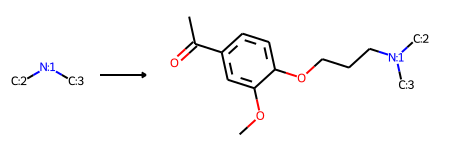

Product similarity 0.688, overall 0.3647228915662651, smiles COc1cc(C(C)=O)ccc1OCCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


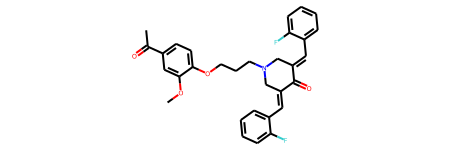

The proposed reaction is:


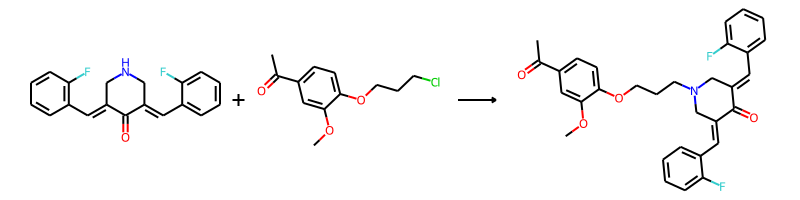

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.COc1cc(C(C)=O)ccc1OCCCCl>>COc1cc(C(C)=O)ccc1OCCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 186932
RANK 37 PRECEDENT
REACTANT MATCH SCORE: 0.5280898876404494


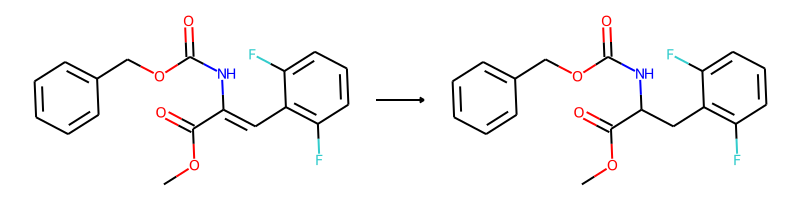

-> template: [#8:1]-[C:2](=[O;D1;H0:3])-[C;H0;D3;+0:4](-[#7:5]-[C:6]=[O;D1;H0:7])=[CH;D2;+0:8]-[c:9]>>[#8:1]-[C:2](=[O;D1;H0:3])-[CH;D3;+0:4](-[#7:5]-[C:6]=[O;D1;H0:7])-[CH2;D2;+0:8]-[c:9]


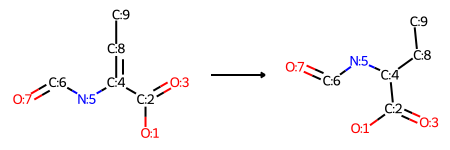

->No precursors could be generated!


--------------------------------------------------

Train index: 212236
RANK 38 PRECEDENT
REACTANT MATCH SCORE: 0.5277777777777778


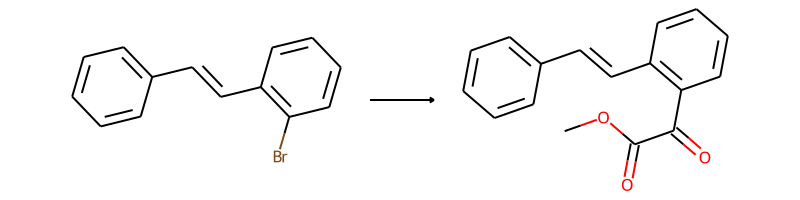

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[C:5]>>C-O-C(=O)-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]-[C:4]=[C:5]


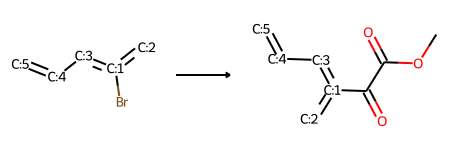

->No precursors could be generated!


--------------------------------------------------

Train index: 98273
RANK 39 PRECEDENT
REACTANT MATCH SCORE: 0.5274725274725275


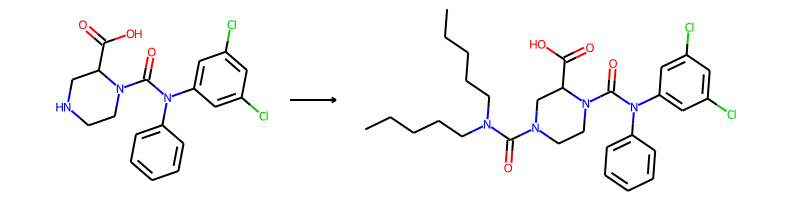

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C-C-C-C-N(-C-C-C-C-C)-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


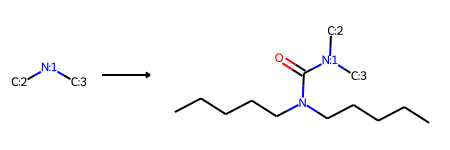

Product similarity 0.6614173228346457, overall 0.34887946698970324, smiles CCCCCN(CCCCC)C(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


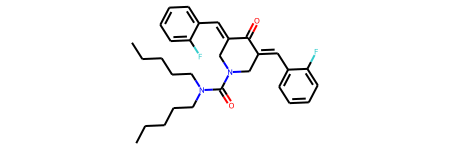

The proposed reaction is:


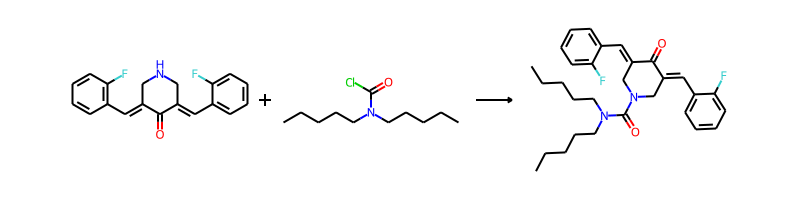

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CCCCCN(CCCCC)C(=O)Cl>>CCCCCN(CCCCC)C(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 193108
RANK 40 PRECEDENT
REACTANT MATCH SCORE: 0.527027027027027


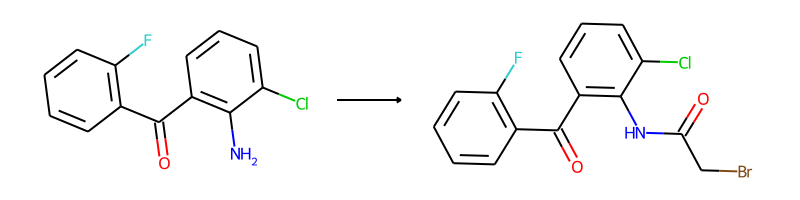

-> template: [NH2;D1;+0:1]-[c:2]>>Br-C-C(=O)-[NH;D2;+0:1]-[c:2]


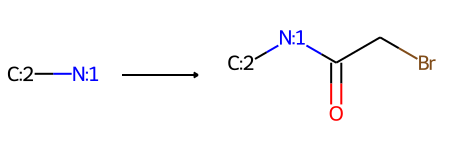

->No precursors could be generated!


--------------------------------------------------

Train index: 158999
RANK 41 PRECEDENT
REACTANT MATCH SCORE: 0.525


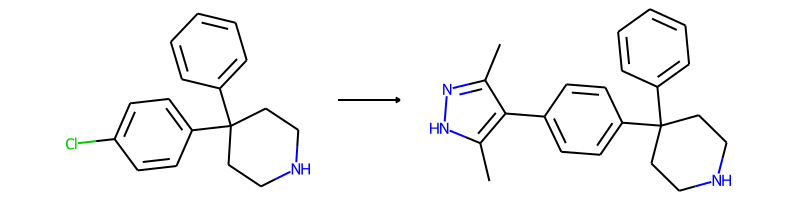

-> template: [Cl;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>C-c1:[nH]:n:c(-C):c:1-[c;H0;D3;+0:1](:[c:2]):[c:3]


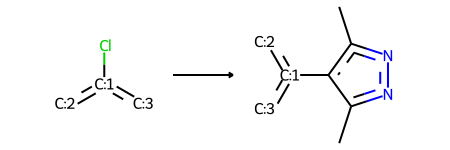

->No precursors could be generated!


--------------------------------------------------

Train index: 175097
RANK 42 PRECEDENT
REACTANT MATCH SCORE: 0.524390243902439


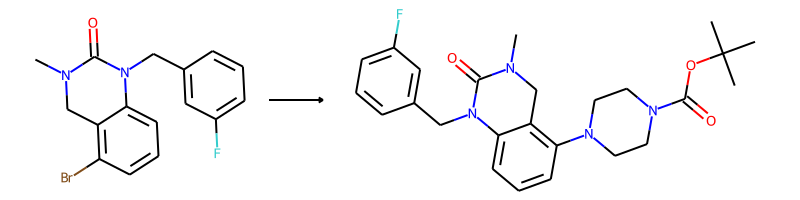

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>C-C(-C)(-C)-O-C(=O)-N1-C-C-N(-[c;H0;D3;+0:1](:[c:2]):[c:3])-C-C-1


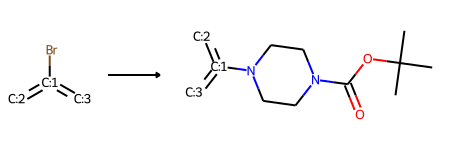

->No precursors could be generated!


--------------------------------------------------

Train index: 126391
RANK 43 PRECEDENT
REACTANT MATCH SCORE: 0.524390243902439


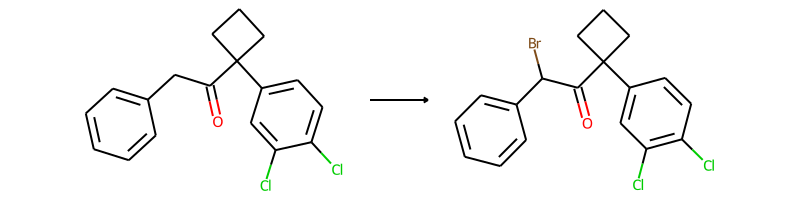

-> template: [O;D1;H0:4]=[C:3]-[CH2;D2;+0:1]-[c:2]>>Br-[CH;D3;+0:1](-[c:2])-[C:3]=[O;D1;H0:4]


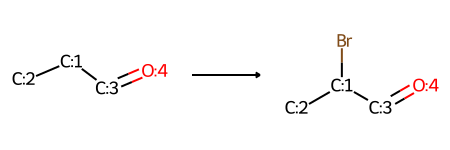

->No precursors could be generated!


--------------------------------------------------

Train index: 219857
RANK 44 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


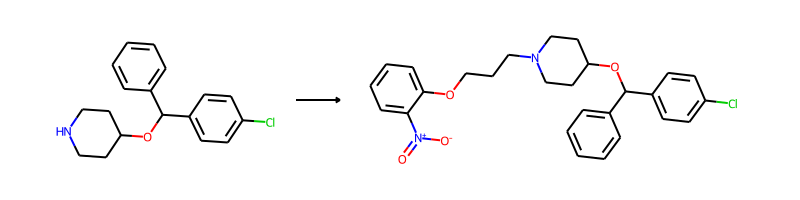

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O=[N+](-[O-])-c1:c:c:c:c:c:1-O-C-C-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


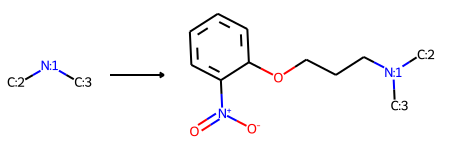

Product similarity 0.6694214876033058, overall 0.35064935064935066, smiles O=C1/C(=C/c2ccccc2F)CN(CCCOc2ccccc2[N+](=O)[O-])C/C1=C\c1ccccc1F


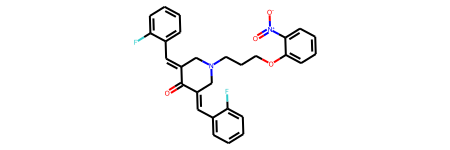

The proposed reaction is:


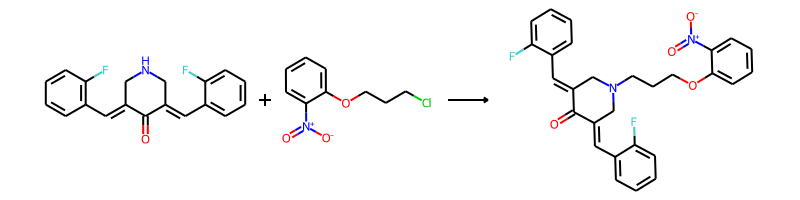

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])c1ccccc1OCCCCl>>O=C1/C(=C/c2ccccc2F)CN(CCCOc2ccccc2[N+](=O)[O-])C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 197784
RANK 45 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


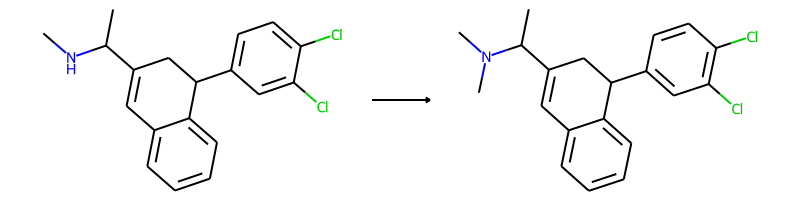

-> template: [C:5]=[C:4]-[C:3]-[NH;D2;+0:1]-[C;D1;H3:2]>>C-[N;H0;D3;+0:1](-[C;D1;H3:2])-[C:3]-[C:4]=[C:5]


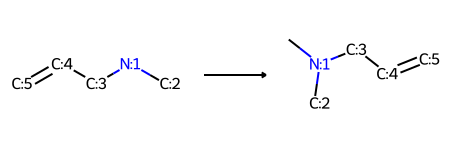

->No precursors could be generated!


--------------------------------------------------

Train index: 428869
RANK 46 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


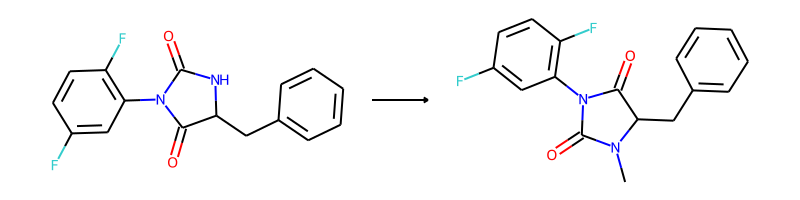

-> template: [O;D1;H0:7]=[C:6]1-[#7:5]-[C:3](=[O;D1;H0:4])-[C:2]-[NH;D2;+0:1]-1>>C-[N;H0;D3;+0:1]1-[C:2]-[C:3](=[O;D1;H0:4])-[#7:5]-[C:6]-1=[O;D1;H0:7]


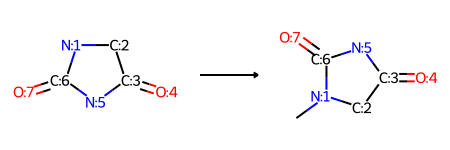

->No precursors could be generated!


--------------------------------------------------

Train index: 23477
RANK 47 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


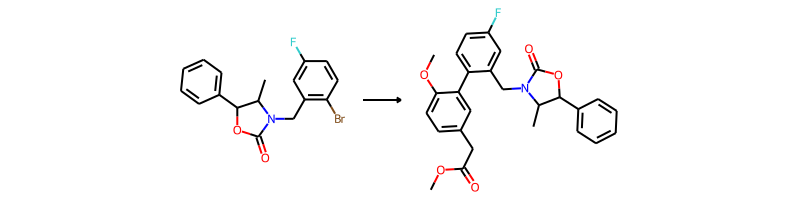

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>C-O-C(=O)-C-c1:c:c:c(-O-C):c(-[c;H0;D3;+0:1](:[c:2]):[c:3]):c:1


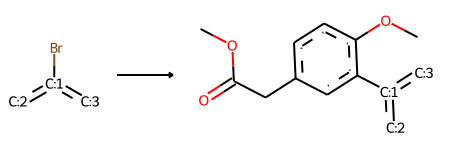

->No precursors could be generated!


--------------------------------------------------

Train index: 70007
RANK 48 PRECEDENT
REACTANT MATCH SCORE: 0.5232558139534884


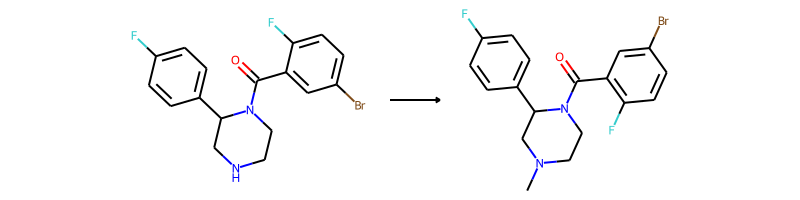

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-[N;H0;D3;+0:1](-[C:2])-[C:3]


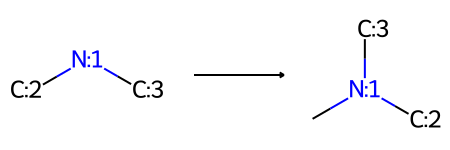

Product similarity 0.5340909090909091, overall 0.2794661733615222, smiles CN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


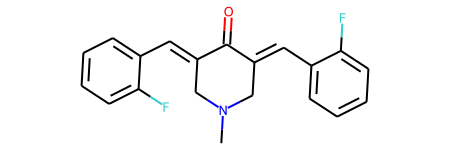

The proposed reaction is:


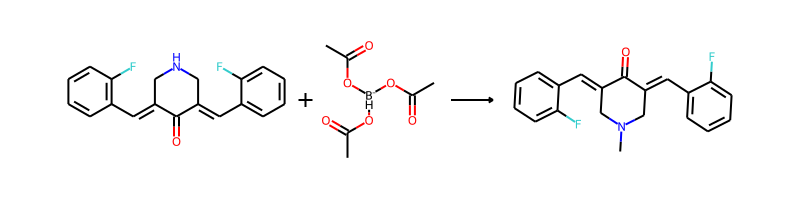

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CC(=O)O[BH-](OC(C)=O)OC(C)=O>>CN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 388425
RANK 49 PRECEDENT
REACTANT MATCH SCORE: 0.5227272727272727


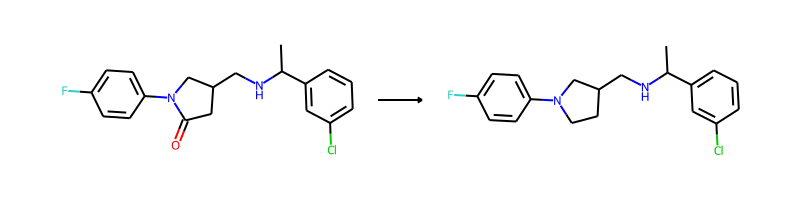

-> template: [#7:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0]>>[#7:1]-[CH2;D2;+0:2]-[C:3]


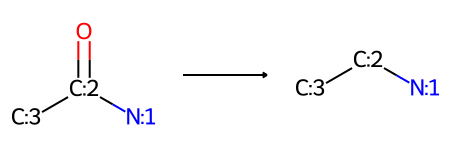

->No precursors could be generated!


--------------------------------------------------

Train index: 177518
RANK 50 PRECEDENT
REACTANT MATCH SCORE: 0.5222222222222223


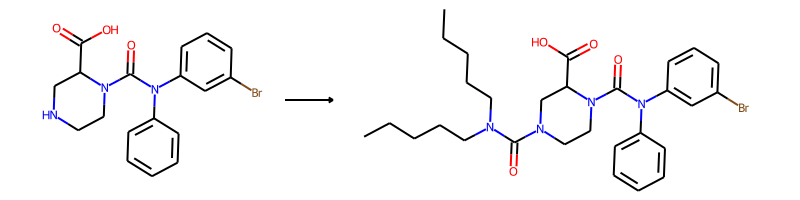

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C-C-C-C-N(-C-C-C-C-C)-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


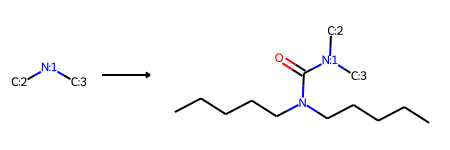

Product similarity 0.6587301587301587, overall 0.3440035273368607, smiles CCCCCN(CCCCC)C(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


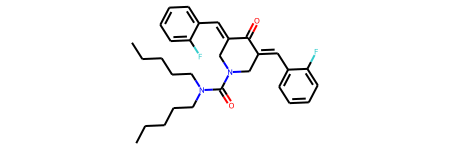

The proposed reaction is:


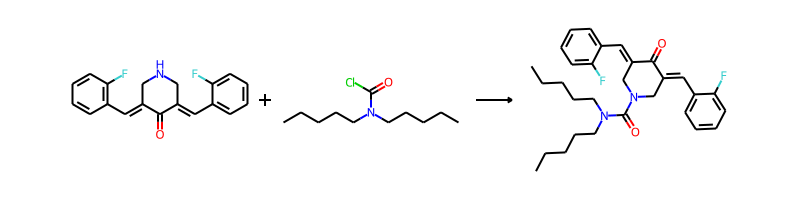

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CCCCCN(CCCCC)C(=O)Cl>>CCCCCN(CCCCC)C(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 50894
RANK 51 PRECEDENT
REACTANT MATCH SCORE: 0.5222222222222223


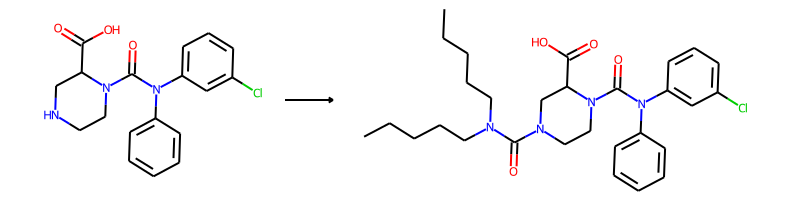

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C-C-C-C-N(-C-C-C-C-C)-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


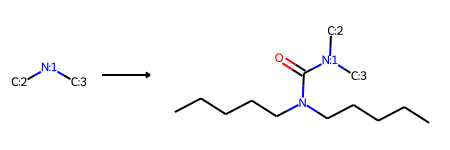

Product similarity 0.6587301587301587, overall 0.3440035273368607, smiles CCCCCN(CCCCC)C(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


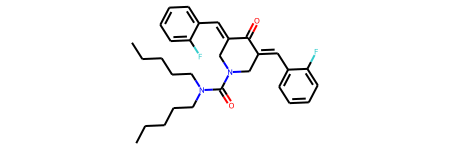

The proposed reaction is:


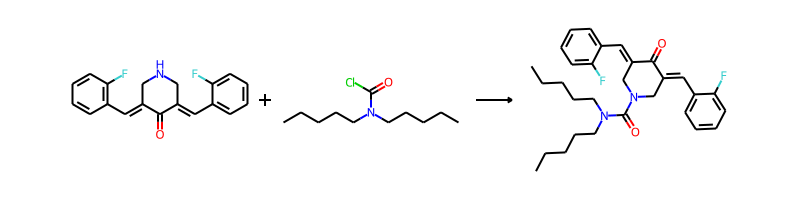

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CCCCCN(CCCCC)C(=O)Cl>>CCCCCN(CCCCC)C(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 339425
RANK 52 PRECEDENT
REACTANT MATCH SCORE: 0.5222222222222223


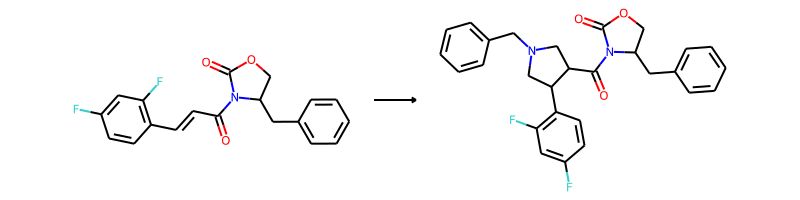

-> template: [#7:1]-[C:2](=[O;D1;H0:3])-[CH;D2;+0:4]=[CH;D2;+0:5]-[c:6]>>[#7:1]-[C:2](=[O;D1;H0:3])-[CH;D3;+0:4]1-C-N(-C-c2:c:c:c:c:c:2)-C-[CH;D3;+0:5]-1-[c:6]


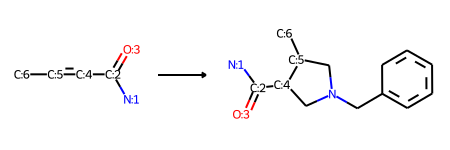

->No precursors could be generated!


--------------------------------------------------

Train index: 185240
RANK 53 PRECEDENT
REACTANT MATCH SCORE: 0.5222222222222223


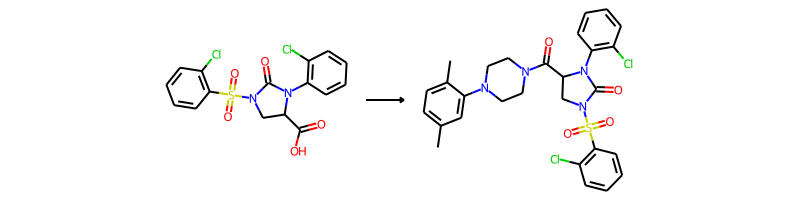

-> template: [#7:4]-[C:3]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:2]>>C-c1:c:c:c(-C):c(-N2-C-C-N(-[C;H0;D3;+0:1](=[O;H0;D1;+0:2])-[C:3]-[#7:4])-C-C-2):c:1


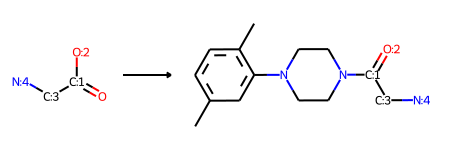

->No precursors could be generated!


--------------------------------------------------

Train index: 245040
RANK 54 PRECEDENT
REACTANT MATCH SCORE: 0.5222222222222223


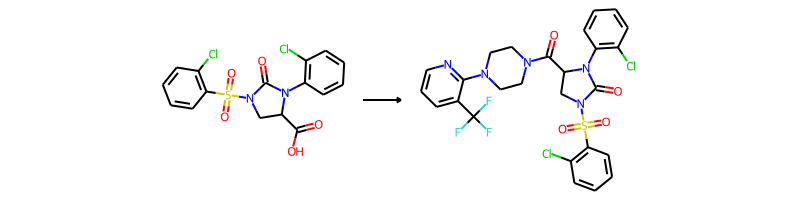

-> template: [#7:4]-[C:3]-[C;H0;D3;+0:1](=[O;H0;D1;+0])-[OH;D1;+0:2]>>F-C(-F)(-F)-c1:c:c:c:n:c:1-N1-C-C-N(-[C;H0;D3;+0:1](=[O;H0;D1;+0:2])-[C:3]-[#7:4])-C-C-1


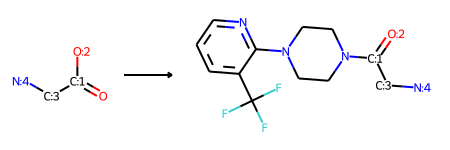

->No precursors could be generated!


--------------------------------------------------

Train index: 383695
RANK 55 PRECEDENT
REACTANT MATCH SCORE: 0.5217391304347826


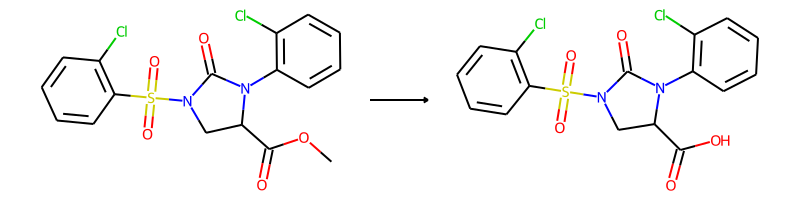

-> template: [#7:1]-[C:2]-[C;H0;D3;+0:3](=[O;H0;D1;+0:5])-[O;H0;D2;+0:4]-[C;H3;D1;+0]>>[#7:1]-[C:2]-[C;H0;D3;+0:3](=[O;H0;D1;+0:4])-[OH;D1;+0:5]


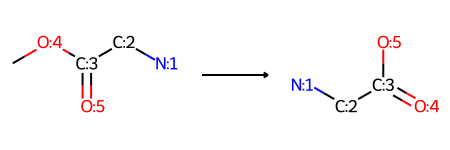

->No precursors could be generated!


--------------------------------------------------

Train index: 167831
RANK 56 PRECEDENT
REACTANT MATCH SCORE: 0.5205479452054794


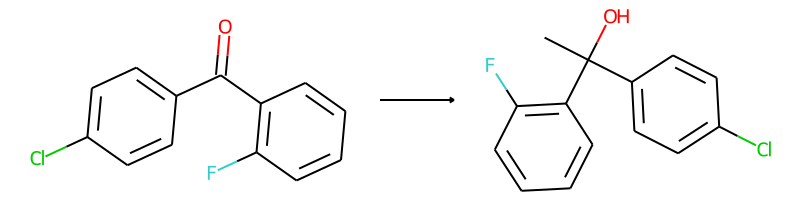

-> template: [O;H0;D1;+0:2]=[C;H0;D3;+0:1](-[c:3])-[c:4]>>C-[C;H0;D4;+0:1](-[OH;D1;+0:2])(-[c:3])-[c:4]


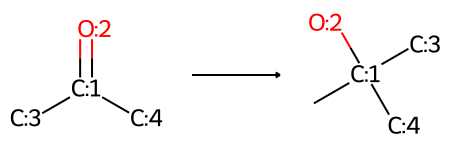

->No precursors could be generated!


--------------------------------------------------

Train index: 48532
RANK 57 PRECEDENT
REACTANT MATCH SCORE: 0.5205479452054794


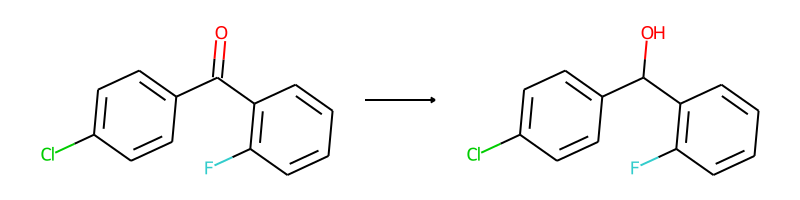

-> template: [O;H0;D1;+0:1]=[C;H0;D3;+0:2](-[c:3])-[c:4]>>[OH;D1;+0:1]-[CH;D3;+0:2](-[c:3])-[c:4]


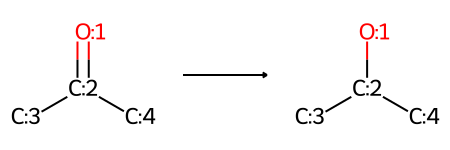

->No precursors could be generated!


--------------------------------------------------

Train index: 232655
RANK 58 PRECEDENT
REACTANT MATCH SCORE: 0.5205479452054794


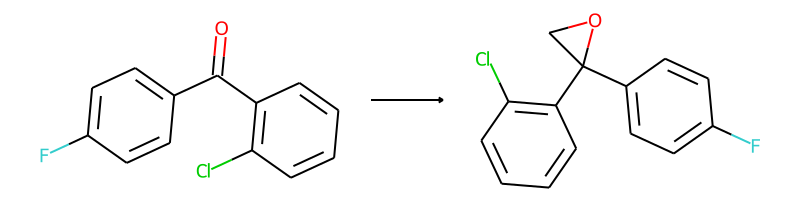

-> template: [O;H0;D1;+0:4]=[C;H0;D3;+0:2](-[c:1])-[c:3]>>[c:1]-[C;H0;D4;+0:2]1(-[c:3])-C-[O;H0;D2;+0:4]-1


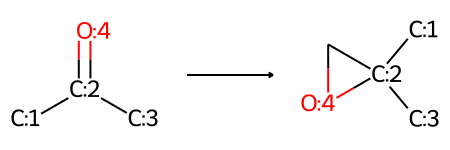

->No precursors could be generated!


--------------------------------------------------

Train index: 50492
RANK 59 PRECEDENT
REACTANT MATCH SCORE: 0.5205479452054794


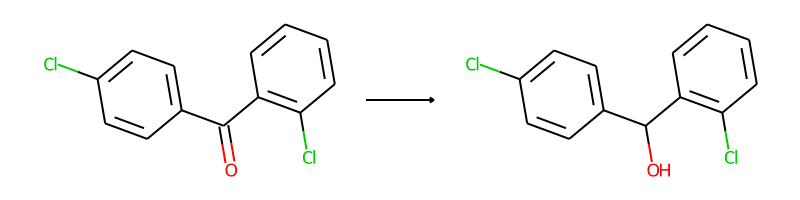

-> template: [O;H0;D1;+0:1]=[C;H0;D3;+0:2](-[c:3])-[c:4]>>[OH;D1;+0:1]-[CH;D3;+0:2](-[c:3])-[c:4]


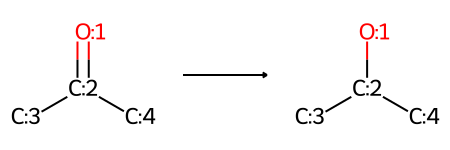

->No precursors could be generated!


--------------------------------------------------

Train index: 376998
RANK 60 PRECEDENT
REACTANT MATCH SCORE: 0.5205479452054794


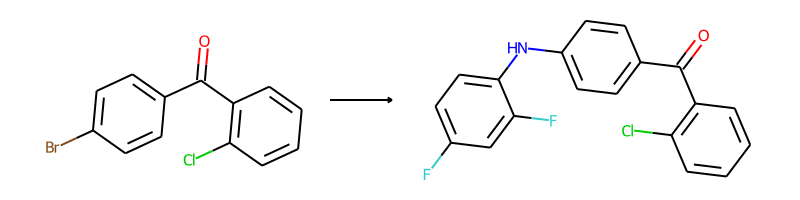

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>F-c1:c:c:c(-N-[c;H0;D3;+0:1](:[c:2]):[c:3]):c(-F):c:1


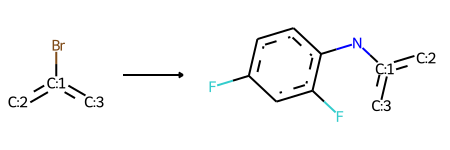

->No precursors could be generated!


--------------------------------------------------

Train index: 407828
RANK 61 PRECEDENT
REACTANT MATCH SCORE: 0.52


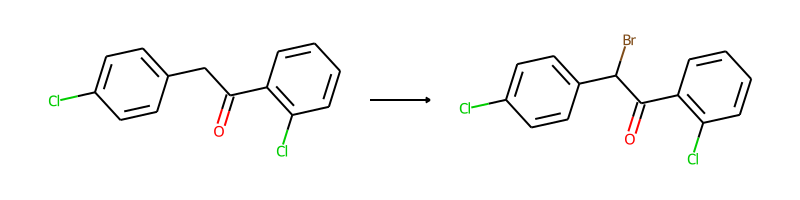

-> template: [O;D1;H0:4]=[C:3]-[CH2;D2;+0:1]-[c:2]>>Br-[CH;D3;+0:1](-[c:2])-[C:3]=[O;D1;H0:4]


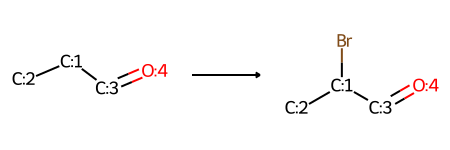

->No precursors could be generated!


--------------------------------------------------

Train index: 80908
RANK 62 PRECEDENT
REACTANT MATCH SCORE: 0.52


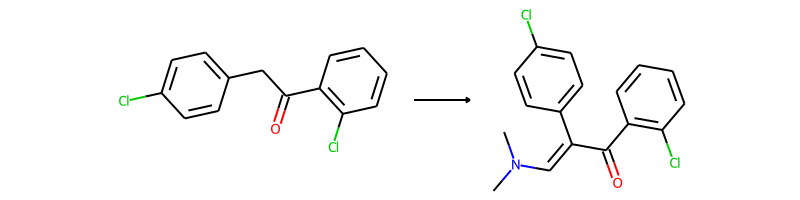

-> template: [O;D1;H0:4]=[C:3]-[CH2;D2;+0:1]-[c:2]>>C-N(-C)-C=[C;H0;D3;+0:1](-[c:2])-[C:3]=[O;D1;H0:4]


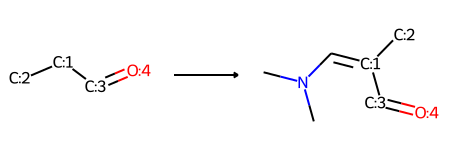

->No precursors could be generated!


--------------------------------------------------

Train index: 280743
RANK 63 PRECEDENT
REACTANT MATCH SCORE: 0.5194805194805194


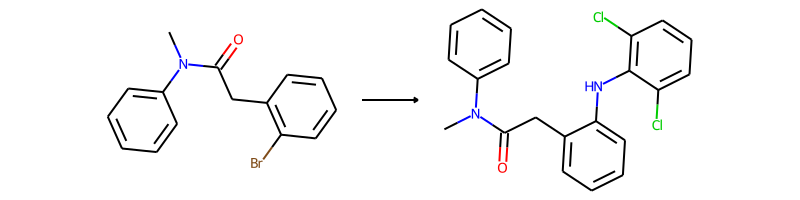

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>Cl-c1:c:c:c:c(-Cl):c:1-N-[c;H0;D3;+0:1](:[c:2]):[c:3]


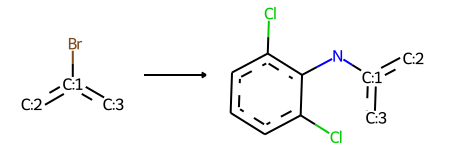

->No precursors could be generated!


--------------------------------------------------

Train index: 107568
RANK 64 PRECEDENT
REACTANT MATCH SCORE: 0.5194805194805194


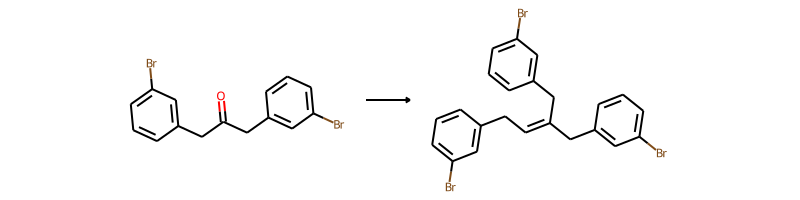

-> template: [C:2]-[C;H0;D3;+0:1](-[C:3])=[O;H0;D1;+0]>>Br-c1:c:c:c:c(-C-C=[C;H0;D3;+0:1](-[C:2])-[C:3]):c:1


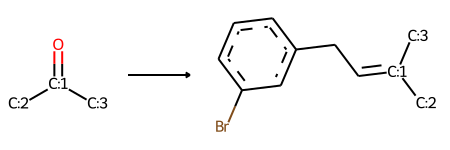

Product similarity 0.6336633663366337, overall 0.32917577472032916, smiles Fc1ccccc1/C=C1\CNC/C(=C\c2ccccc2F)C1=CCc1cccc(Br)c1


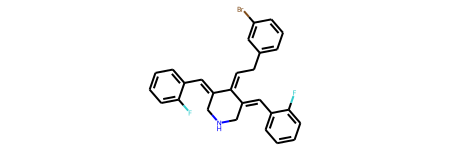

The proposed reaction is:


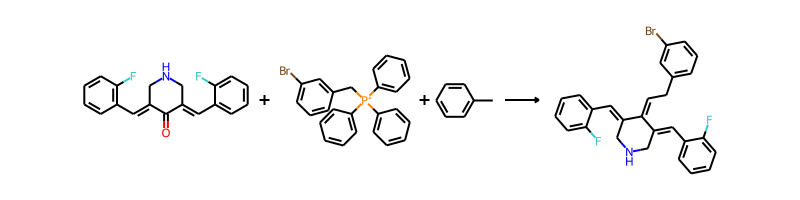

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.Brc1cccc(C[P+](c2ccccc2)(c2ccccc2)c2ccccc2)c1.Cc1ccccc1>>Fc1ccccc1/C=C1\CNC/C(=C\c2ccccc2F)C1=CCc1cccc(Br)c1


--------------------------------------------------

Train index: 339356
RANK 65 PRECEDENT
REACTANT MATCH SCORE: 0.5194805194805194


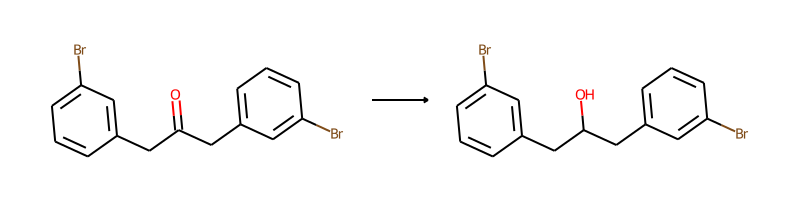

-> template: [C:1]-[C;H0;D3;+0:2](-[C:3])=[O;H0;D1;+0:4]>>[C:1]-[CH;D3;+0:2](-[C:3])-[OH;D1;+0:4]


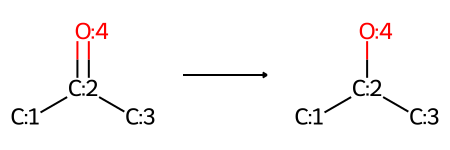

Product similarity 0.5194805194805194, overall 0.2698600101197503, smiles OC1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F


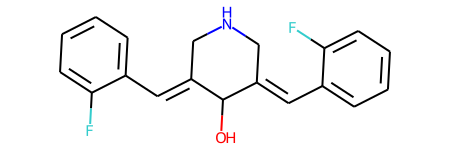

The proposed reaction is:


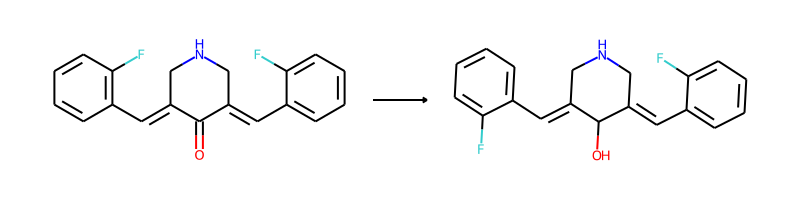

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F>>OC1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 238939
RANK 66 PRECEDENT
REACTANT MATCH SCORE: 0.5189873417721519


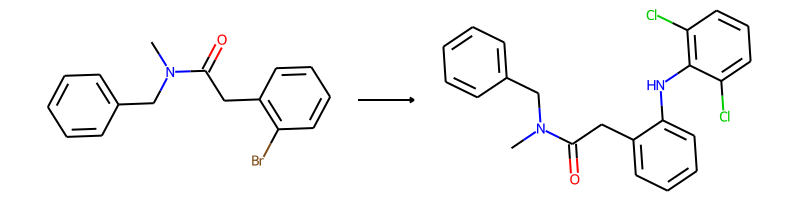

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>Cl-c1:c:c:c:c(-Cl):c:1-N-[c;H0;D3;+0:1](:[c:2]):[c:3]


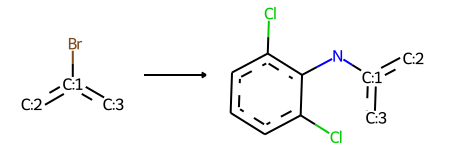

->No precursors could be generated!


--------------------------------------------------

Train index: 44725
RANK 67 PRECEDENT
REACTANT MATCH SCORE: 0.5189873417721519


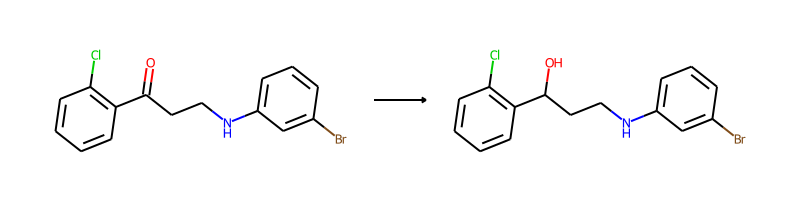

-> template: [C:1]-[C;H0;D3;+0:2](=[O;H0;D1;+0:3])-[c:4]>>[C:1]-[CH;D3;+0:2](-[OH;D1;+0:3])-[c:4]


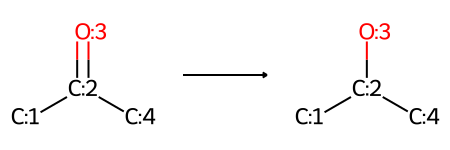

->No precursors could be generated!


--------------------------------------------------

Train index: 295023
RANK 68 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


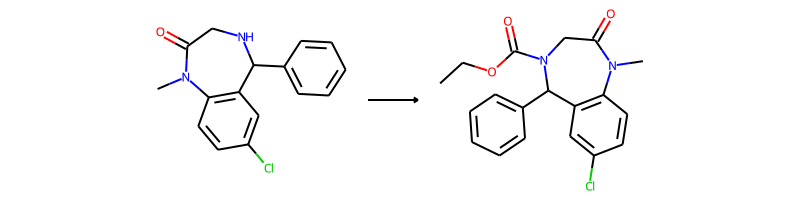

-> template: [#7:5]-[C:4](=[O;D1;H0:6])-[C:3]-[NH;D2;+0:1]-[C:2]>>C-C-O-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4](-[#7:5])=[O;D1;H0:6]


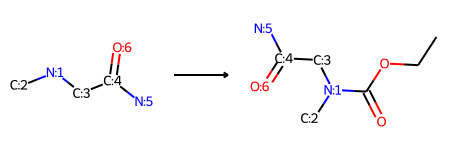

->No precursors could be generated!


--------------------------------------------------

Train index: 157395
RANK 69 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


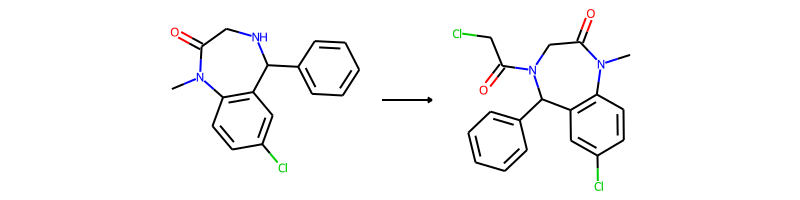

-> template: [#7:5]-[C:4](=[O;D1;H0:6])-[C:3]-[NH;D2;+0:1]-[C:2]>>Cl-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4](-[#7:5])=[O;D1;H0:6]


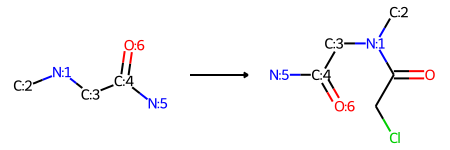

->No precursors could be generated!


--------------------------------------------------

Train index: 250348
RANK 70 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


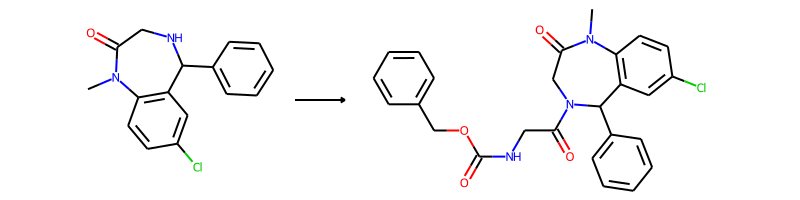

-> template: [#7:5]-[C:4](=[O;D1;H0:6])-[C:3]-[NH;D2;+0:1]-[C:2]>>O=C(-N-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4](-[#7:5])=[O;D1;H0:6])-O-C-c1:c:c:c:c:c:1


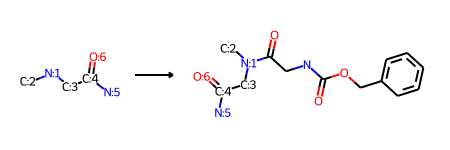

->No precursors could be generated!


--------------------------------------------------

Train index: 372994
RANK 71 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


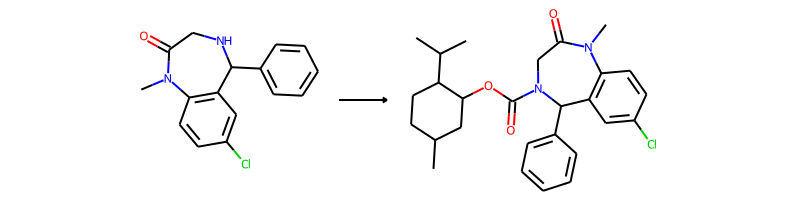

-> template: [#7:5]-[C:4](=[O;D1;H0:6])-[C:3]-[NH;D2;+0:1]-[C:2]>>C-C1-C-C-C(-C(-C)-C)-C(-O-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4](-[#7:5])=[O;D1;H0:6])-C-1


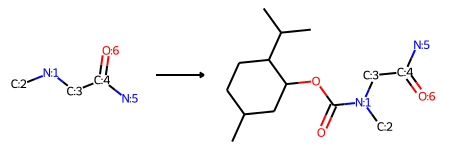

->No precursors could be generated!


--------------------------------------------------

Train index: 87770
RANK 72 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


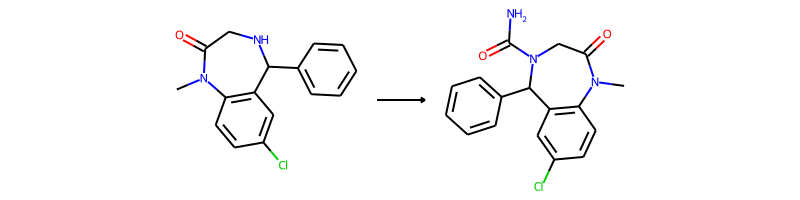

-> template: [#7:5]-[C:4](=[O;D1;H0:6])-[C:3]-[NH;D2;+0:1]-[C:2]>>N-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4](-[#7:5])=[O;D1;H0:6]


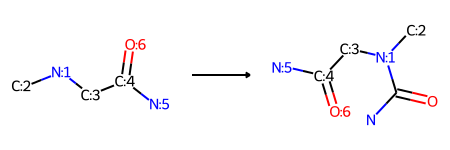

->No precursors could be generated!


--------------------------------------------------

Train index: 176452
RANK 73 PRECEDENT
REACTANT MATCH SCORE: 0.5185185185185185


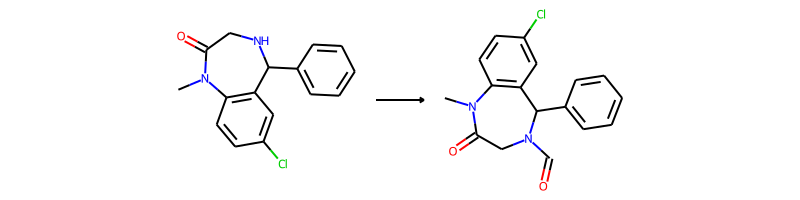

-> template: [#7:5]-[C:4](=[O;D1;H0:6])-[C:3]-[NH;D2;+0:1]-[C:2]>>O=C-[N;H0;D3;+0:1](-[C:2])-[C:3]-[C:4](-[#7:5])=[O;D1;H0:6]


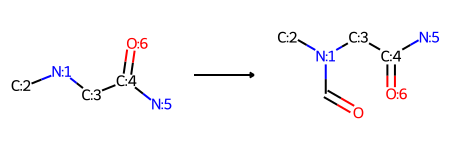

->No precursors could be generated!


--------------------------------------------------

Train index: 217579
RANK 74 PRECEDENT
REACTANT MATCH SCORE: 0.5180722891566265


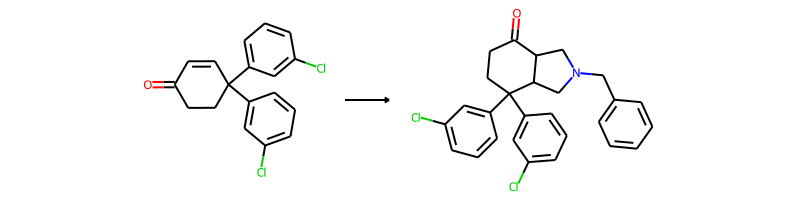

-> template: [C:1]-[CH;D2;+0:2]=[CH;D2;+0:3]-[C:4]=[O;D1;H0:5]>>[C:1]-[CH;D3;+0:2]1-C-N(-C-c2:c:c:c:c:c:2)-C-[CH;D3;+0:3]-1-[C:4]=[O;D1;H0:5]


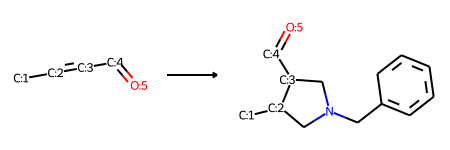

->No precursors could be generated!


--------------------------------------------------

Train index: 46982
RANK 75 PRECEDENT
REACTANT MATCH SCORE: 0.5180722891566265


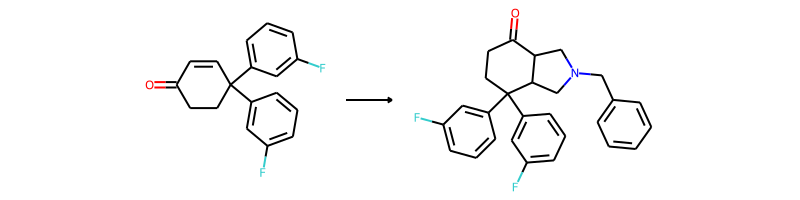

-> template: [C:1]-[CH;D2;+0:2]=[CH;D2;+0:3]-[C:4]=[O;D1;H0:5]>>[C:1]-[CH;D3;+0:2]1-C-N(-C-c2:c:c:c:c:c:2)-C-[CH;D3;+0:3]-1-[C:4]=[O;D1;H0:5]


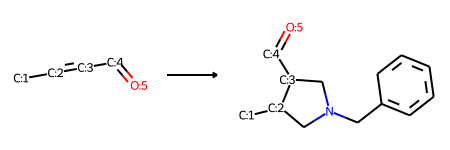

->No precursors could be generated!


--------------------------------------------------

Train index: 284001
RANK 76 PRECEDENT
REACTANT MATCH SCORE: 0.5180722891566265


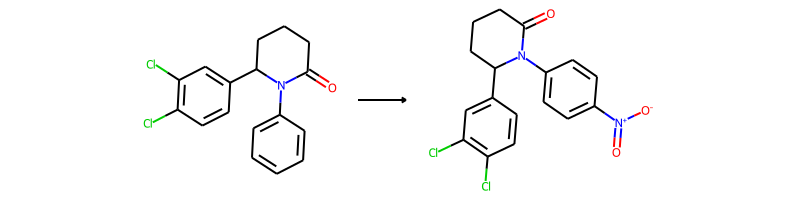

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O=[N+](-[O-])-[c;H0;D3;+0:1](:[c:2]):[c:3]


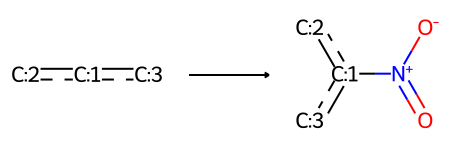

Product similarity 0.5217391304347826, overall 0.27029858564693554, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cc([N+](=O)[O-])ccc1F


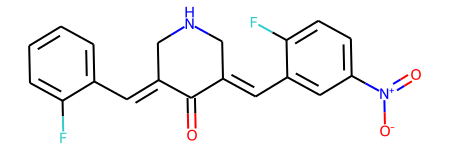

The proposed reaction is:


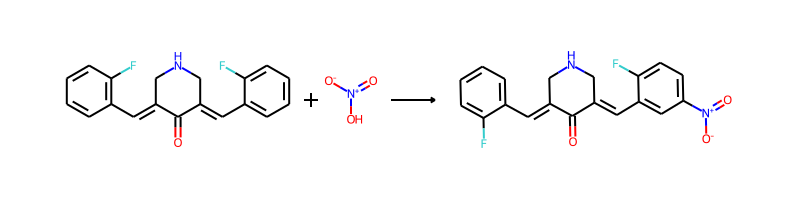

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cc([N+](=O)[O-])ccc1F
Product similarity 0.5217391304347826, overall 0.27029858564693554, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cccc([N+](=O)[O-])c1F


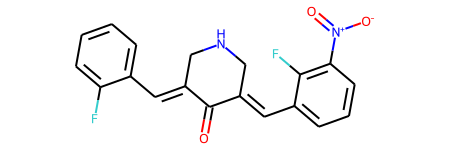

The proposed reaction is:


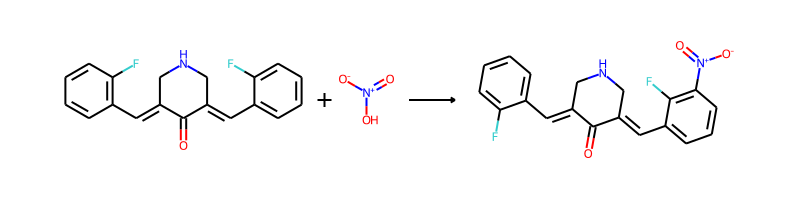

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1cccc([N+](=O)[O-])c1F
Product similarity 0.5384615384615384, overall 0.2789620018535681, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccc([N+](=O)[O-])cc1F


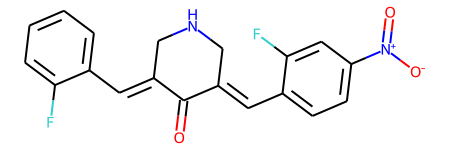

The proposed reaction is:


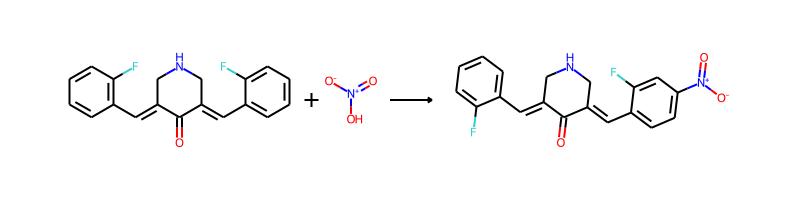

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccc([N+](=O)[O-])cc1F
Product similarity 0.5053763440860215, overall 0.2618214794662521, smiles O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1c(F)cccc1[N+](=O)[O-]


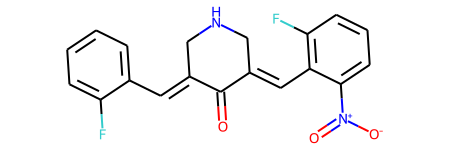

The proposed reaction is:


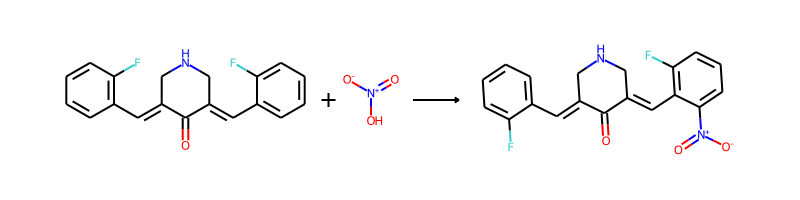

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=[N+]([O-])O>>O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1c(F)cccc1[N+](=O)[O-]


--------------------------------------------------

Train index: 264155
RANK 77 PRECEDENT
REACTANT MATCH SCORE: 0.5176470588235295


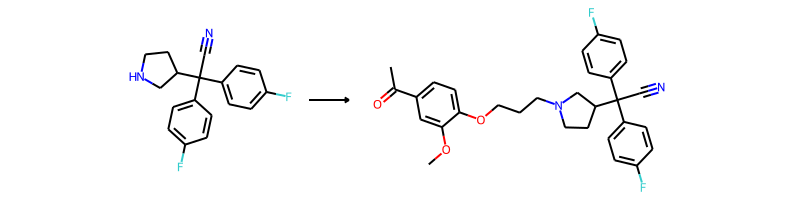

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-O-c1:c:c(-C(-C)=O):c:c:c:1-O-C-C-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


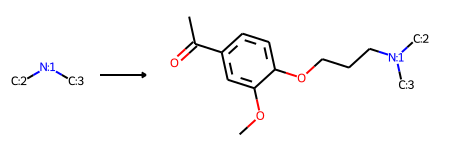

Product similarity 0.6771653543307087, overall 0.35053265400648453, smiles COc1cc(C(C)=O)ccc1OCCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


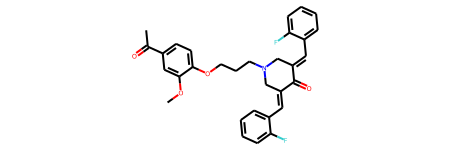

The proposed reaction is:


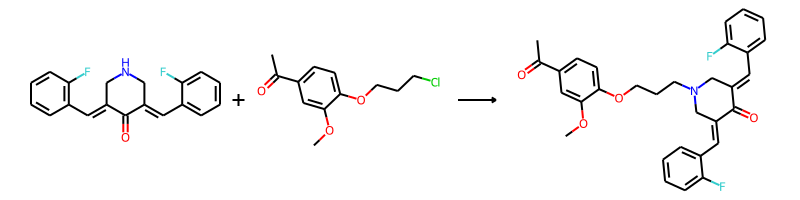

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.COc1cc(C(C)=O)ccc1OCCCCl>>COc1cc(C(C)=O)ccc1OCCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 347274
RANK 78 PRECEDENT
REACTANT MATCH SCORE: 0.5176470588235295


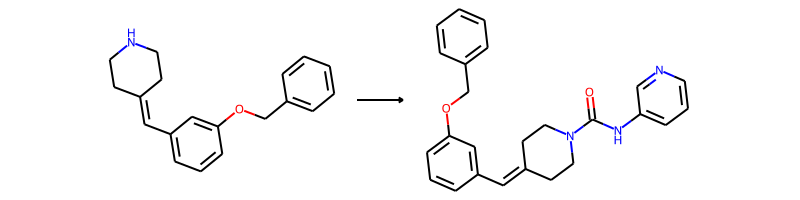

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O=C(-N-c1:c:c:c:n:c:1)-[N;H0;D3;+0:1](-[C:2])-[C:3]


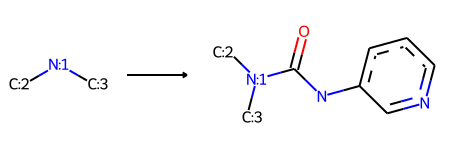

Product similarity 0.6306306306306306, overall 0.3264440911499735, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)Nc2cccnc2)C/C1=C\c1ccccc1F


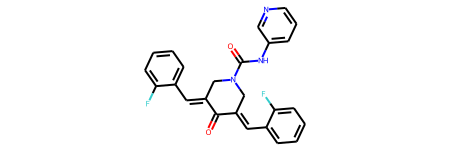

The proposed reaction is:


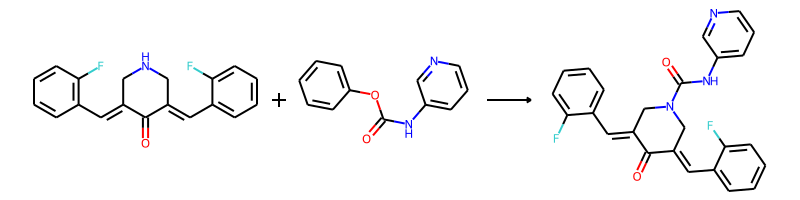

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C(Nc1cccnc1)Oc1ccccc1>>O=C1/C(=C/c2ccccc2F)CN(C(=O)Nc2cccnc2)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 256457
RANK 79 PRECEDENT
REACTANT MATCH SCORE: 0.5176470588235295


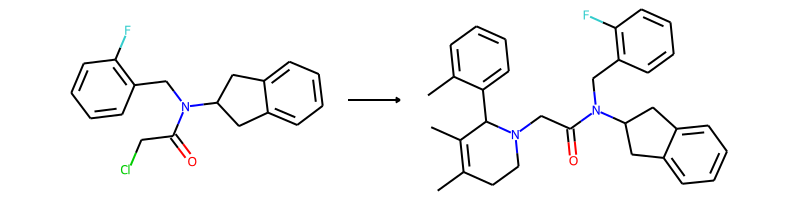

-> template: [#7:3]-[C:2](=[O;D1;H0:4])-[CH2;D2;+0:1]-[Cl;H0;D1;+0]>>C-C1=C(-C)-C(-c2:c:c:c:c:c:2-C)-N(-[CH2;D2;+0:1]-[C:2](-[#7:3])=[O;D1;H0:4])-C-C-1


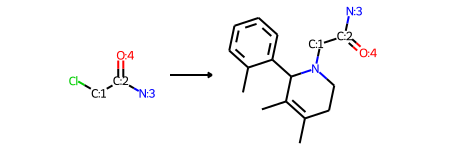

->No precursors could be generated!


--------------------------------------------------

Train index: 115859
RANK 80 PRECEDENT
REACTANT MATCH SCORE: 0.5168539325842697


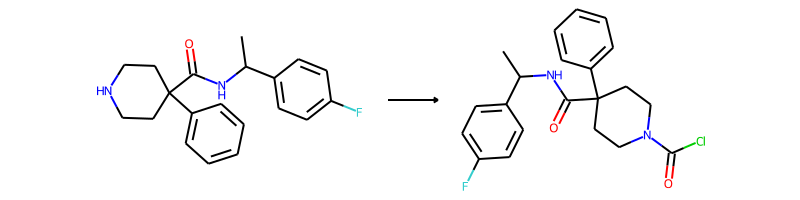

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>Cl-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


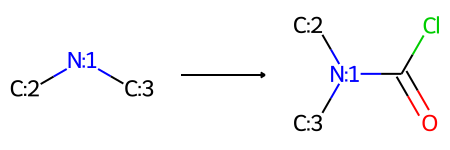

Product similarity 0.5520833333333334, overall 0.2853464419475656, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)Cl)C/C1=C\c1ccccc1F


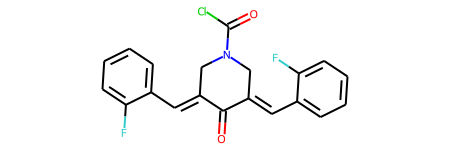

The proposed reaction is:


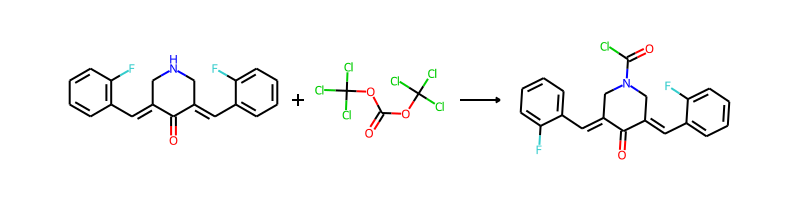

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C(OC(Cl)(Cl)Cl)OC(Cl)(Cl)Cl>>O=C1/C(=C/c2ccccc2F)CN(C(=O)Cl)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 307080
RANK 81 PRECEDENT
REACTANT MATCH SCORE: 0.5131578947368421


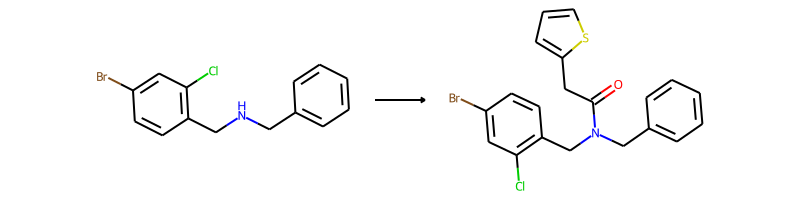

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O=C(-C-c1:c:c:c:s:1)-[N;H0;D3;+0:1](-[C:2])-[C:3]


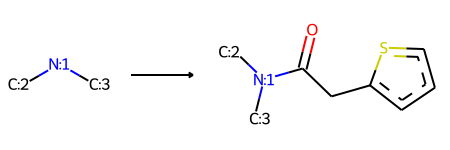

Product similarity 0.6262626262626263, overall 0.3213716108452951, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)Cc2cccs2)C/C1=C\c1ccccc1F


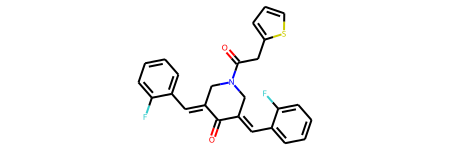

The proposed reaction is:


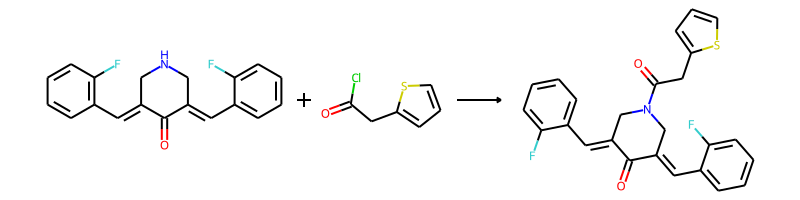

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C(Cl)Cc1cccs1>>O=C1/C(=C/c2ccccc2F)CN(C(=O)Cc2cccs2)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 324653
RANK 82 PRECEDENT
REACTANT MATCH SCORE: 0.5128205128205128


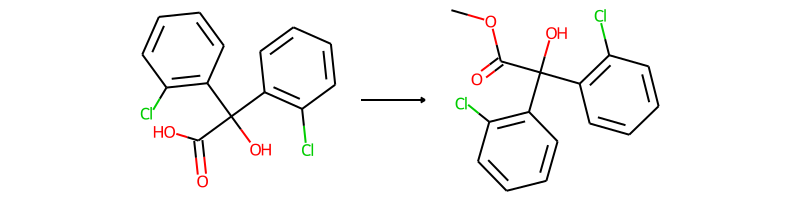

-> template: [O;D1;H0:3]=[C:2]-[OH;D1;+0:1]>>C-[O;H0;D2;+0:1]-[C:2]=[O;D1;H0:3]


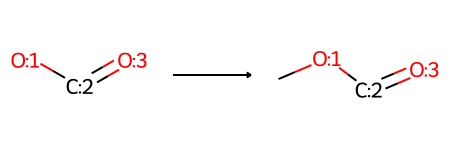

->No precursors could be generated!


--------------------------------------------------

Train index: 279712
RANK 83 PRECEDENT
REACTANT MATCH SCORE: 0.5125


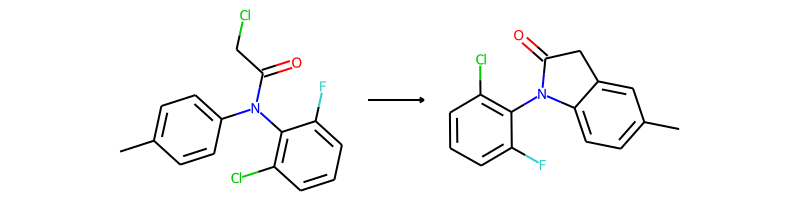

-> template: [Cl;H0;D1;+0]-[CH2;D2;+0:7]-[C:2](=[O;D1;H0:1])-[#7:3]-[c:4]:[cH;D2;+0:5]:[c:6]>>[O;D1;H0:1]=[C:2]1-[#7:3]-[c:4]:[c;H0;D3;+0:5](:[c:6])-[CH2;D2;+0:7]-1


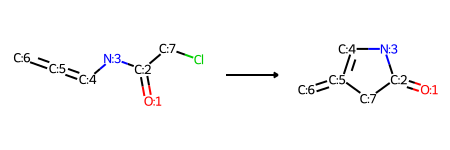

->No precursors could be generated!


--------------------------------------------------

Train index: 65115
RANK 84 PRECEDENT
REACTANT MATCH SCORE: 0.5121951219512195


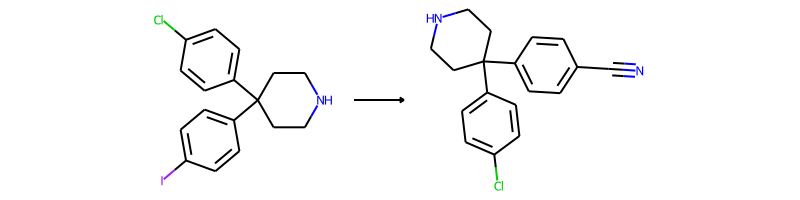

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>N#C-[c;H0;D3;+0:1](:[c:2]):[c:3]


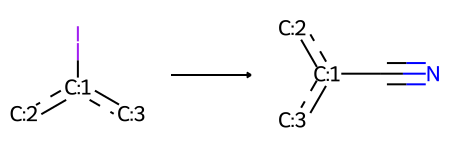

->No precursors could be generated!


--------------------------------------------------

Train index: 157251
RANK 85 PRECEDENT
REACTANT MATCH SCORE: 0.5121951219512195


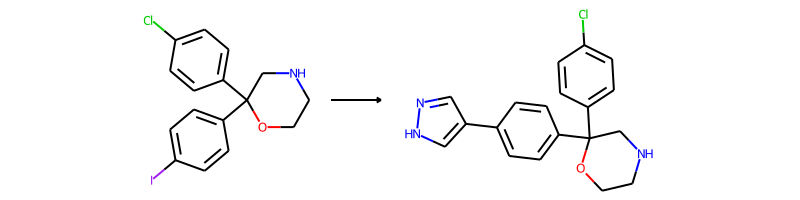

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:2](:[c:1]):[c:3]>>[c:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:[nH]:n:c:1


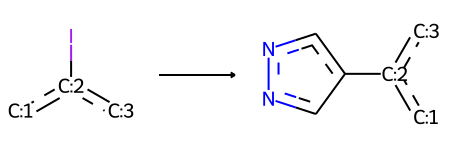

->No precursors could be generated!


--------------------------------------------------

Train index: 229189
RANK 86 PRECEDENT
REACTANT MATCH SCORE: 0.5121951219512195


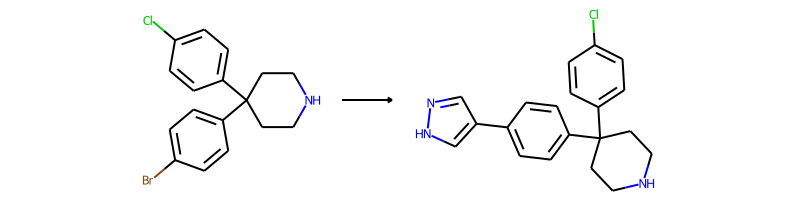

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:2](:[c:1]):[c:3]>>[c:1]:[c;H0;D3;+0:2](:[c:3])-c1:c:[nH]:n:c:1


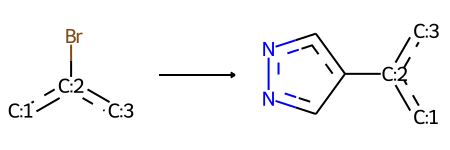

->No precursors could be generated!


--------------------------------------------------

Train index: 168040
RANK 87 PRECEDENT
REACTANT MATCH SCORE: 0.5121951219512195


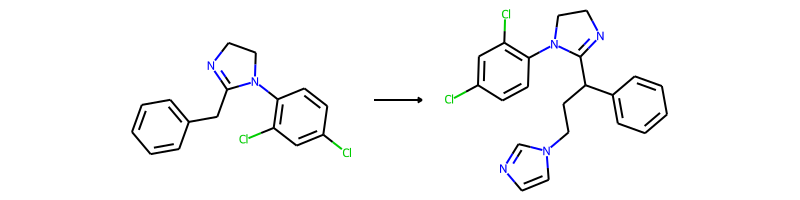

-> template: [#7:1]-[C:2](=[#7:3])-[CH2;D2;+0:4]-[c:5]>>[#7:1]-[C:2](=[#7:3])-[CH;D3;+0:4](-[c:5])-C-C-n1:c:c:n:c:1


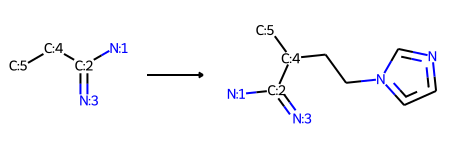

->No precursors could be generated!


--------------------------------------------------

Train index: 93170
RANK 88 PRECEDENT
REACTANT MATCH SCORE: 0.5119047619047619


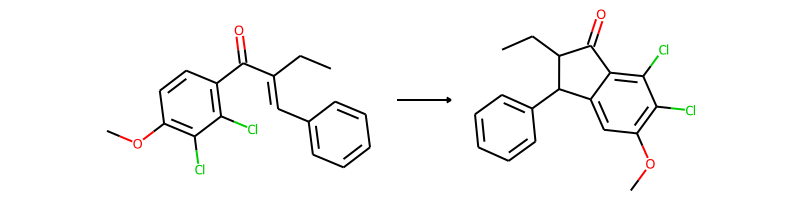

-> template: [C:1]-[C;H0;D3;+0:2](=[CH;D2;+0:8]-[c:9])-[C:3](=[O;D1;H0:4])-[c:5]:[cH;D2;+0:6]:[c:7]>>[C:1]-[CH;D3;+0:2]1-[C:3](=[O;D1;H0:4])-[c:5]:[c;H0;D3;+0:6](:[c:7])-[CH;D3;+0:8]-1-[c:9]


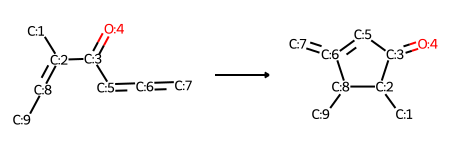

->No precursors could be generated!


--------------------------------------------------

Train index: 299932
RANK 89 PRECEDENT
REACTANT MATCH SCORE: 0.5119047619047619


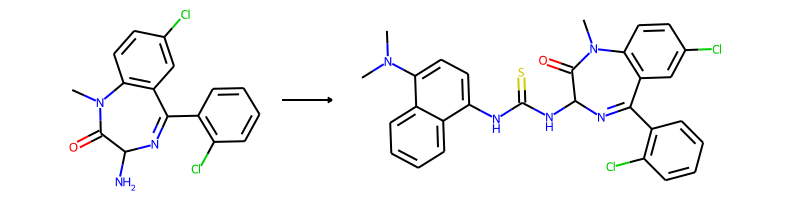

-> template: [#7:5]-[C:4](=[O;D1;H0:6])-[C:2](-[#7:3])-[NH2;D1;+0:1]>>C-N(-C)-c1:c:c:c(-N-C(=S)-[NH;D2;+0:1]-[C:2](-[#7:3])-[C:4](-[#7:5])=[O;D1;H0:6]):c2:c:c:c:c:c:1:2


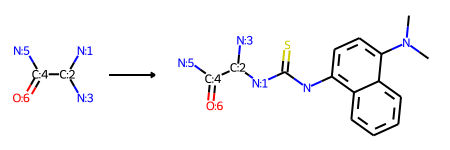

->No precursors could be generated!


--------------------------------------------------

Train index: 112930
RANK 90 PRECEDENT
REACTANT MATCH SCORE: 0.5119047619047619


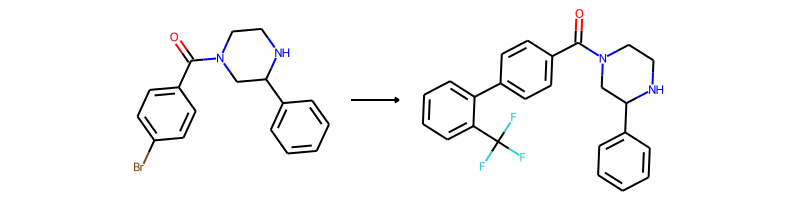

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>F-C(-F)(-F)-c1:c:c:c:c:c:1-[c;H0;D3;+0:1](:[c:2]):[c:3]


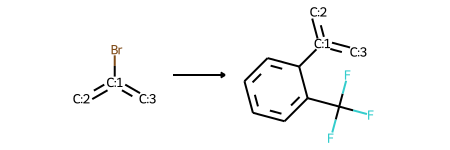

->No precursors could be generated!


--------------------------------------------------

Train index: 37504
RANK 91 PRECEDENT
REACTANT MATCH SCORE: 0.5119047619047619


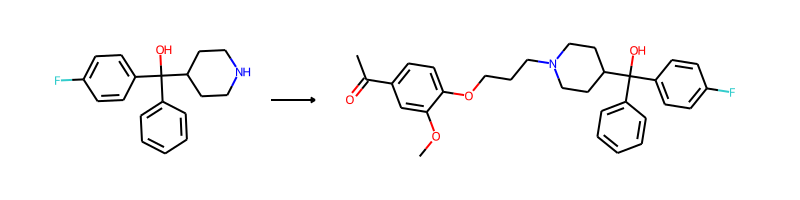

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-O-c1:c:c(-C(-C)=O):c:c:c:1-O-C-C-C-[N;H0;D3;+0:1](-[C:2])-[C:3]


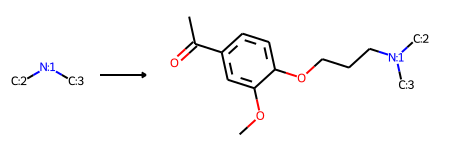

Product similarity 0.6746031746031746, overall 0.3453325774754346, smiles COc1cc(C(C)=O)ccc1OCCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


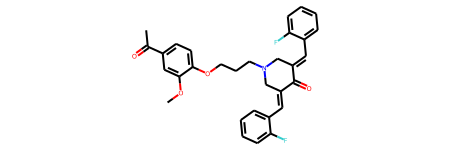

The proposed reaction is:


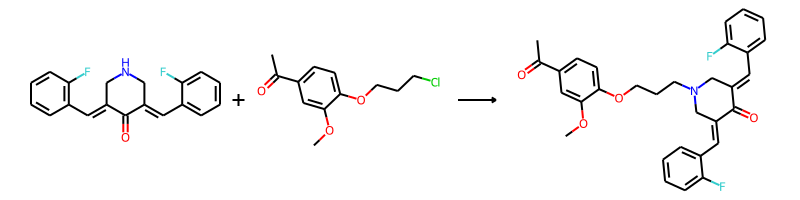

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.COc1cc(C(C)=O)ccc1OCCCCl>>COc1cc(C(C)=O)ccc1OCCCN1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 427615
RANK 92 PRECEDENT
REACTANT MATCH SCORE: 0.5119047619047619


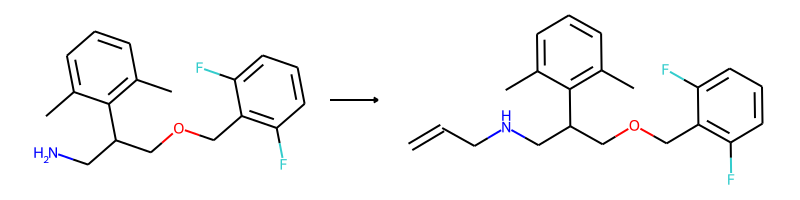

-> template: [C:2]-[NH2;D1;+0:1]>>C=C-C-[NH;D2;+0:1]-[C:2]


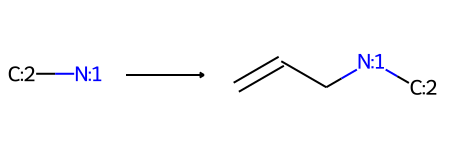

->No precursors could be generated!


--------------------------------------------------

Train index: 438338
RANK 93 PRECEDENT
REACTANT MATCH SCORE: 0.5116279069767442


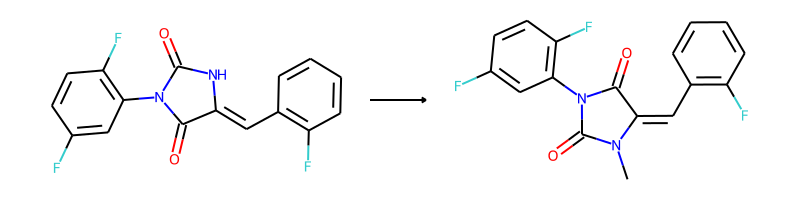

-> template: [C:3]=[C:2]1-[NH;D2;+0:1]-[C:7](=[O;D1;H0:8])-[#7:6]-[C:4]-1=[O;D1;H0:5]>>C-[N;H0;D3;+0:1]1-[C:2](=[C:3])-[C:4](=[O;D1;H0:5])-[#7:6]-[C:7]-1=[O;D1;H0:8]


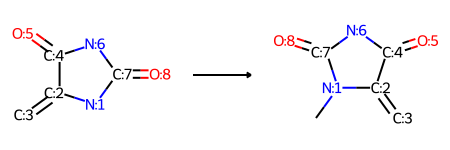

->No precursors could be generated!


--------------------------------------------------

Train index: 416945
RANK 94 PRECEDENT
REACTANT MATCH SCORE: 0.5116279069767442


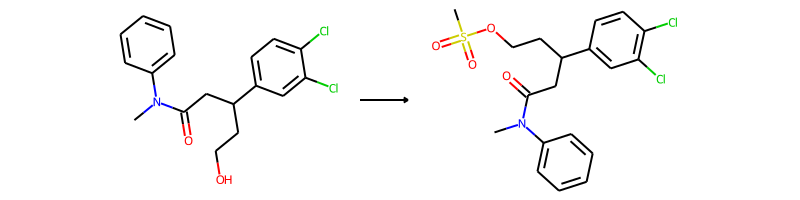

-> template: [C:2]-[OH;D1;+0:1]>>C-S(=O)(=O)-[O;H0;D2;+0:1]-[C:2]


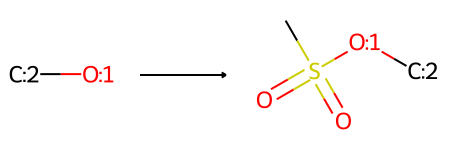

->No precursors could be generated!


--------------------------------------------------

Train index: 318528
RANK 95 PRECEDENT
REACTANT MATCH SCORE: 0.5116279069767442


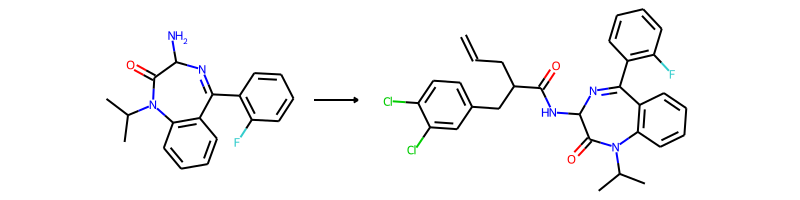

-> template: [#7:3]-[C:2](-[NH2;D1;+0:1])-[C:4](-[#7:5])=[O;D1;H0:6]>>C=C-C-C(-C-c1:c:c:c(-Cl):c(-Cl):c:1)-C(=O)-[NH;D2;+0:1]-[C:2](-[#7:3])-[C:4](-[#7:5])=[O;D1;H0:6]


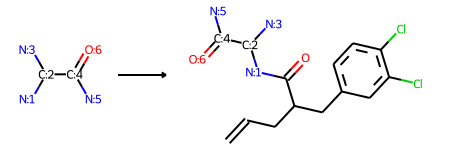

->No precursors could be generated!


--------------------------------------------------

Train index: 388147
RANK 96 PRECEDENT
REACTANT MATCH SCORE: 0.5116279069767442


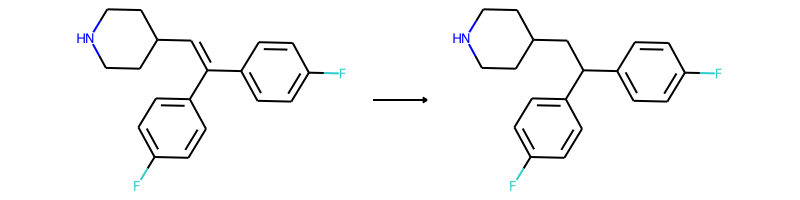

-> template: [C:1]-[CH;D2;+0:2]=[C;H0;D3;+0:3](-[c:4])-[c:5]>>[C:1]-[CH2;D2;+0:2]-[CH;D3;+0:3](-[c:4])-[c:5]


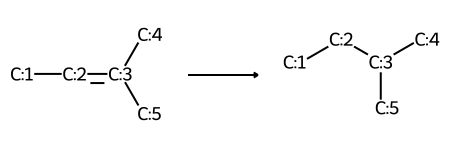

->No precursors could be generated!


--------------------------------------------------

Train index: 330862
RANK 97 PRECEDENT
REACTANT MATCH SCORE: 0.5116279069767442


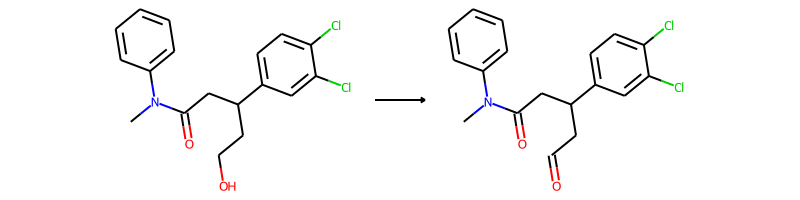

-> template: [C:1]-[CH2;D2;+0:2]-[OH;D1;+0:3]>>[C:1]-[CH;D2;+0:2]=[O;H0;D1;+0:3]


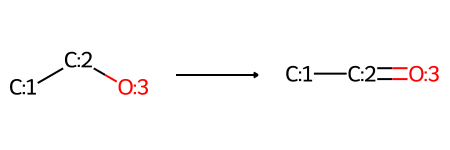

->No precursors could be generated!


--------------------------------------------------

Train index: 347818
RANK 98 PRECEDENT
REACTANT MATCH SCORE: 0.5113636363636364


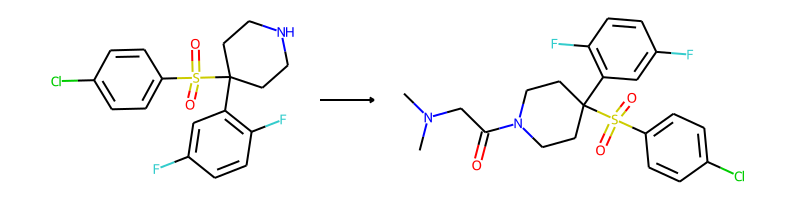

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-N(-C)-C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


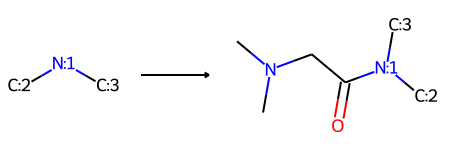

Product similarity 0.5825242718446602, overall 0.29788172992056483, smiles CN(C)CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


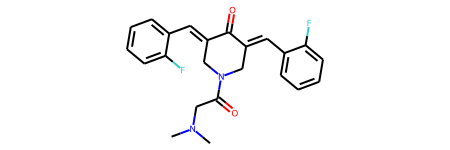

The proposed reaction is:


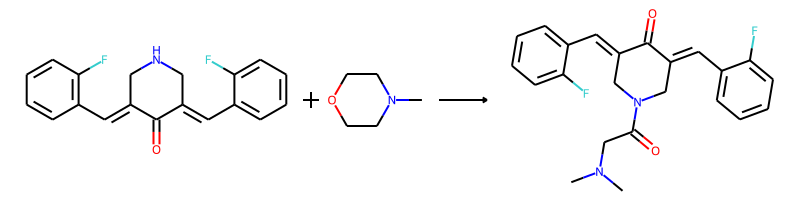

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CN1CCOCC1>>CN(C)CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


--------------------------------------------------

Train index: 1492
RANK 99 PRECEDENT
REACTANT MATCH SCORE: 0.5113636363636364


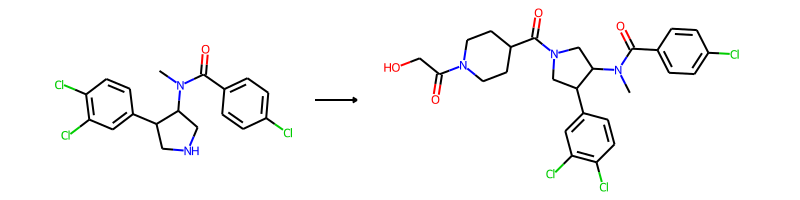

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>O-C-C(=O)-N1-C-C-C(-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3])-C-C-1


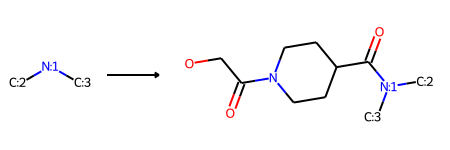

Product similarity 0.6446280991735537, overall 0.3296393688955672, smiles O=C1/C(=C/c2ccccc2F)CN(C(=O)C2CCN(C(=O)CO)CC2)C/C1=C\c1ccccc1F


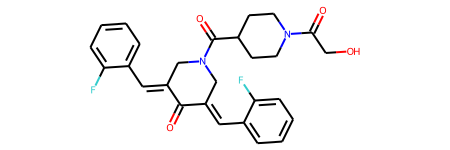

The proposed reaction is:


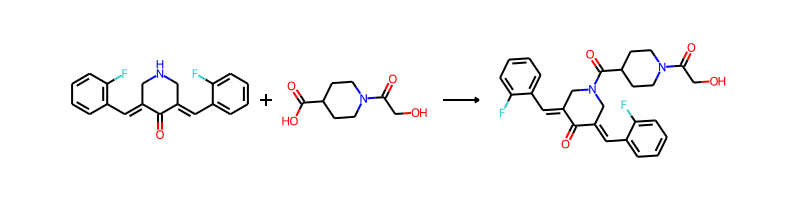

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.O=C(O)C1CCN(C(=O)CO)CC1>>O=C1/C(=C/c2ccccc2F)CN(C(=O)C2CCN(C(=O)CO)CC2)C/C1=C\c1ccccc1F


--------------------------------------------------

Train index: 212565
RANK 100 PRECEDENT
REACTANT MATCH SCORE: 0.5113636363636364


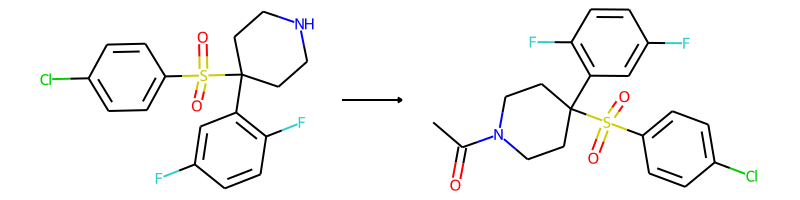

-> template: [C:2]-[NH;D2;+0:1]-[C:3]>>C-C(=O)-[N;H0;D3;+0:1](-[C:2])-[C:3]


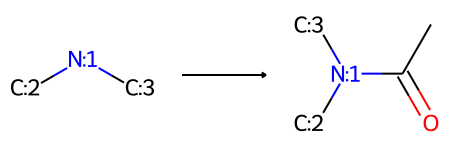

Product similarity 0.5473684210526316, overall 0.2799043062200957, smiles CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


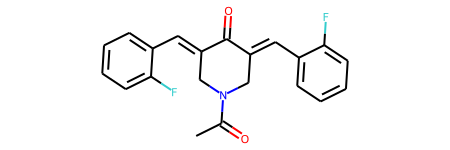

The proposed reaction is:


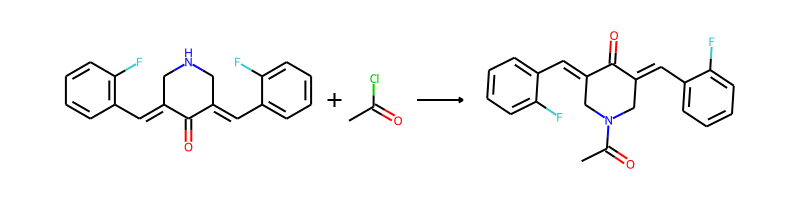

The reaction SMILES string is: O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F.CC(=O)Cl>>CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1


,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles
0,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,CN(C)c1ccccc1CC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(...,[CN(C)c1ccccc1CC(=O)O],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
1,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,CN(C)c1ccccc1CC(=O)C1NC/C(=C\c2ccccc2F)C(=O)/C...,[CN(C)c1ccccc1CC(=O)O],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
2,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(C(=O)NCCN(C2CC2)S(=O)(=...,"[O=C(Cl)Oc1ccc([N+](=O)[O-])cc1, NCCN(C1CC1)S(...",O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
3,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(C(=O)Cc2ccccc2)C/C1=C\c...,[O=C(Cl)Cc1ccccc1],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
4,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(C(=O)NCc2ccc(F)cc2)C/C1...,[O=C=NCc1ccc(F)cc1],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
5,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,COc1cc(C(C)=O)ccc1OCCCN1C/C(=C\c2ccccc2F)C(=O)...,[COc1cc(C(C)=O)ccc1OCCCCl],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
6,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,COC(=O)N1C/C(=C\c2ccccc2F)C(=O)/C(=C/c2ccccc2F)C1,[COC(=O)Cl],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
7,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(CCCOc2ccccc2[N+](=O)[O-...,[O=[N+]([O-])c1ccccc1OCCCCl],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
8,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,CC(=O)N1CCC(C(=O)N2C/C(=C\c3ccccc3F)C(=O)/C(=C...,[CC(=O)N1CCC(C(=O)O)CC1],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...
9,1,O=C1/C(=C/c2ccccc2F)CNC/C1=C\c1ccccc1F,O=C1/C(=C/c2ccccc2F)CN(C(=O)c2cccc3cc[nH]c23)C...,[O=C(O)c1cccc2cc[nH]c12],O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C...


In [41]:
diversify_SMILES ('O=C(/C(CNC/1)=C/C2=C(F)C=CC=C2)C1=C\C3=CC=CC=C3F',1, draw = True)

### Iteration 2
Go through analogs that came out out iteration 1 and rediversify.

In [46]:
#get a list of input SMILES
input_smiles_list = iteration_1['Product_output'].tolist()

from joblib import Parallel, delayed

start = time.time()
output_iter2_init = Parallel(n_jobs=20, verbose=10)(delayed(diversify_SMILES) (smiles, 2) \
                                               for smiles in input_smiles_list)
end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=20)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   4 out of  28 | elapsed:   33.2s remaining:  3.3min
[Parallel(n_jobs=20)]: Done   7 out of  28 | elapsed:   46.4s remaining:  2.3min
[Parallel(n_jobs=20)]: Done  10 out of  28 | elapsed:  1.1min remaining:  2.0min
[Parallel(n_jobs=20)]: Done  13 out of  28 | elapsed:  1.4min remaining:  1.6min
[Parallel(n_jobs=20)]: Done  16 out of  28 | elapsed:  1.6min remaining:  1.2min
[Parallel(n_jobs=20)]: Done  19 out of  28 | elapsed:  2.0min remaining:   57.0s
[Parallel(n_jobs=20)]: Done  22 out of  28 | elapsed:  2.3min remaining:   37.5s
[Parallel(n_jobs=20)]: Done  25 out of  28 | elapsed:  2.5min remaining:   17.9s
[Parallel(n_jobs=20)]: Done  28 out of  28 | elapsed:  2.8min remaining:    0.0s
[Parallel(n_jobs=20)]: Done  28 out of  28 | elapsed:  2.8min finished


Time taken: 166.4154407978058


In [61]:
#start the clock
start = time.time()

output = []

for smiles in input_smiles_list:
    output.append (diversify_SMILES (smiles,2))

end = time.time()

In [63]:
len (output)

28

In [64]:
print ('Time taken: {}'.format (end-start))

Time taken: 28.620548248291016


In [66]:
iteration_2_init = pd.concat(output, ignore_index = True)

In [67]:
iteration_2_init.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568 entries, 0 to 567
Data columns (total 5 columns):
Iteration           568 non-null int64
Reactant_input      568 non-null object
Product_output      568 non-null object
Coupling_partner    568 non-null object
Reaction_smiles     568 non-null object
dtypes: int64(1), object(4)
memory usage: 22.3+ KB


In [68]:
#get reaction SMILES
it2_rxn_smiles = iteration_2_init['Reaction_smiles'].tolist()

#get fast filter output
it2_ffOutput = ff_batch (it2_rxn_smiles)

INFO@fast_filter         : [1682954652.703s]	Starting to load fast filter
INFO@fast_filter         : [1682954653.825s]	Done loading fast filter


In [69]:
#intialize fast filter list
ff_scores = []

# loop through the diversification results
for row in iteration_2_init.itertuples():
    
    #append fast filter score to growing list
    ff_scores.append (it2_ffOutput[row[5]])

iteration_2_init['Fast filter'] = ff_scores

In [70]:
#cut off fast filter scores above 0.5
iteration_2 = fast_filter_cutoff (iteration_2_init)

#reset the indices
iteration_2.reset_index(drop= True, inplace = True)

In [71]:
iteration_2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 559 entries, 0 to 558
Data columns (total 6 columns):
Iteration           559 non-null int64
Reactant_input      559 non-null object
Product_output      559 non-null object
Coupling_partner    559 non-null object
Reaction_smiles     559 non-null object
Fast filter         559 non-null float64
dtypes: float64(1), int64(1), object(4)
memory usage: 26.3+ KB


Analog #1


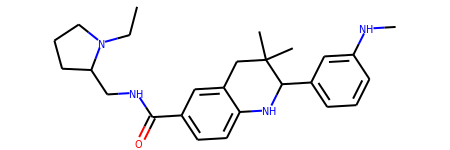

SMILES:CCN1CCCC1CNC(=O)c1ccc2c(c1)CC(C)(C)C(c1cccc(NC)c1)N2
*******************
Analog #2


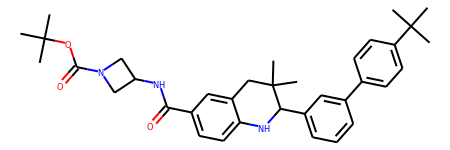

SMILES:CC(C)(C)OC(=O)N1CC(NC(=O)c2ccc3c(c2)CC(C)(C)C(c2cccc(-c4ccc(C(C)(C)C)cc4)c2)N3)C1
*******************
Analog #3


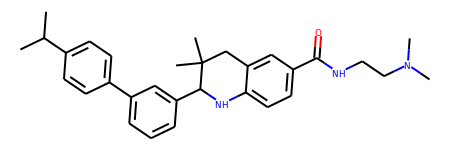

SMILES:CC(C)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NCCN(C)C)cc4CC3(C)C)c2)cc1
*******************
Analog #4


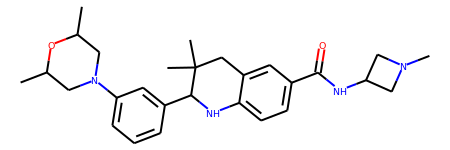

SMILES:CC1CN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5)cc4CC3(C)C)c2)CC(C)O1
*******************
Analog #5


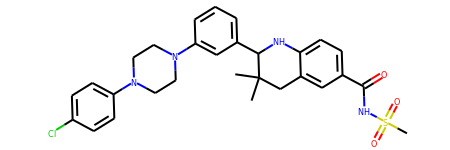

SMILES:CC1(C)Cc2cc(C(=O)NS(C)(=O)=O)ccc2NC1c1cccc(N2CCN(c3ccc(Cl)cc3)CC2)c1
*******************


In [72]:
#randomly sample 5 examples
iteration_2_5examples = iteration_2.sample (n = 5)
count = 0
for row in iteration_2_5examples.itertuples():
    count += 1
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

### Iteration 3

In [73]:
raw_list = iteration_2['Product_output'].tolist()
print ('Length of raw list is: {}'.format (len(raw_list)))
input_smiles_list_3 = list(set(raw_list))
print ('Length after removing duplicates: {}'.format (len(input_smiles_list_3)))

Length of raw list is: 559
Length after removing duplicates: 410


In [74]:
#start the clock
start = time.time()

output = []

for smiles in input_smiles_list_3:
    output.append (diversify_SMILES (smiles,2))

end = time.time()
print ('Time taken: {}'.format (end-start))

Time taken: 377.47927498817444


In [75]:
iteration_3_init = pd.concat(output, ignore_index = True)

iteration_3_init.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4182 entries, 0 to 4181
Data columns (total 5 columns):
Iteration           4182 non-null object
Reactant_input      4182 non-null object
Product_output      4182 non-null object
Coupling_partner    4182 non-null object
Reaction_smiles     4182 non-null object
dtypes: object(5)
memory usage: 163.5+ KB


In [76]:
#get reaction SMILES
it3_rxn_smiles = iteration_3_init['Reaction_smiles'].tolist()

#get fast filter output
it3_ffOutput = ff_batch (it3_rxn_smiles)

INFO@fast_filter         : [1682955428.324s]	Starting to load fast filter
INFO@fast_filter         : [1682955429.115s]	Done loading fast filter


In [79]:
#intialize fast filter list
ff_scores = []

# loop through the diversification results
for row in iteration_3_init.itertuples():
    
    #append fast filter score to growing list
    ff_scores.append (it3_ffOutput[row[5]])

iteration_3_init['Fast filter'] = ff_scores

In [81]:
#cut off fast filter scores above 0.5
iteration_3 = fast_filter_cutoff (iteration_3_init)

#reset the indices
iteration_3.reset_index(drop= True, inplace = True)

In [82]:
iteration_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3987 entries, 0 to 3986
Data columns (total 6 columns):
Iteration           3987 non-null object
Reactant_input      3987 non-null object
Product_output      3987 non-null object
Coupling_partner    3987 non-null object
Reaction_smiles     3987 non-null object
Fast filter         3987 non-null float64
dtypes: float64(1), object(5)
memory usage: 187.0+ KB


In [153]:
iteration_3.head()

,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles,Fast filter
0,2,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NS(C)(=O)=...,[CS(N)(=O)=O],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.999817
1,2,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NS(=O)(=O)...,[NS(=O)(=O)C1CC1],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.999982
2,2,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NCCC(=O)OC...,[COC(=O)CCN],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.999928
3,2,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NC5CN(C(=O...,[CC(C)(C)OC(=O)N1CC(N)C1],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,1.000000
4,2,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NS(=O)(=O)...,[NS(=O)(=O)c1ccccc1],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.998531


In [154]:
#change iteration 3 'Iteration' column- they were labeled as 2 instead of 3
for index in iteration_3.index:
    
    #change the column information
    iteration_3.loc[index, 'Iteration'] = 3
    
iteration_3.head()

/home/karthiksankar2/anaconda3/envs/RDKIT_BinaryClassification/lib/python3.7/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[item] = s


,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles,Fast filter
0,3,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NS(C)(=O)=...,[CS(N)(=O)=O],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.999817
1,3,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NS(=O)(=O)...,[NS(=O)(=O)C1CC1],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.999982
2,3,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NCCC(=O)OC...,[COC(=O)CCN],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.999928
3,3,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NC5CN(C(=O...,[CC(C)(C)OC(=O)N1CC(N)C1],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,1.000000
4,3,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NS(=O)(=O)...,[NS(=O)(=O)c1ccccc1],CCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)O)cc4CC3(C...,0.998531


In [155]:
iteration_3.tail()

,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles,Fast filter
3982,3,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)N(C5CCCCCC...,[BrC1CCCCCC1],Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,0.961681
3983,3,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)N(C5CCCC5)...,[BrC1CCCC1],Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,0.912808
3984,3,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)N(CCOCc5cc...,[CS(=O)(=O)OCCOCc1ccccc1],Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,0.997175
3985,3,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,C=CCN(C(=O)c1ccc2c(c1)CC(C)(C)C(c1cccc(N3CCN(c...,[C=CCBr],Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,0.999699
3986,3,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)N(C(C)C)C5...,[CC(C)Br],Cc1ccccc1N1CCN(c2cccc(C3Nc4ccc(C(=O)NC5CN(C)C5...,0.988107


Analog #1


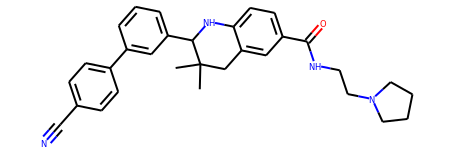

SMILES:CC1(C)Cc2cc(C(=O)NCCN3CCCC3)ccc2NC1c1cccc(-c2ccc(C#N)cc2)c1
*******************
Analog #2


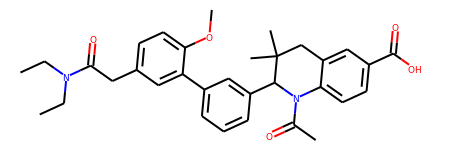

SMILES:CCN(CC)C(=O)Cc1ccc(OC)c(-c2cccc(C3N(C(C)=O)c4ccc(C(=O)O)cc4CC3(C)C)c2)c1
*******************
Analog #3


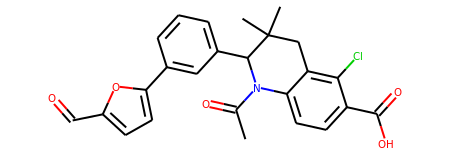

SMILES:CC(=O)N1c2ccc(C(=O)O)c(Cl)c2CC(C)(C)C1c1cccc(-c2ccc(C=O)o2)c1
*******************
Analog #4


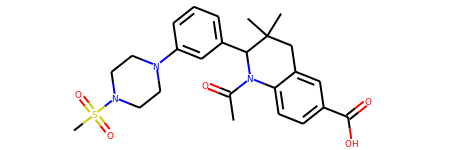

SMILES:CC(=O)N1c2ccc(C(=O)O)cc2CC(C)(C)C1c1cccc(N2CCN(S(C)(=O)=O)CC2)c1
*******************
Analog #5


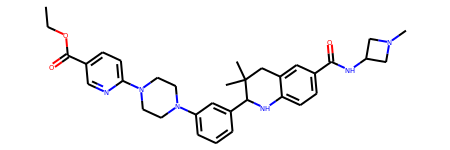

SMILES:CCOC(=O)c1ccc(N2CCN(c3cccc(C4Nc5ccc(C(=O)NC6CN(C)C6)cc5CC4(C)C)c3)CC2)nc1
*******************


In [83]:
#randomly sample 5 examples
iteration_3_5examples = iteration_3.sample (n = 5)
count = 0
for row in iteration_3_5examples.itertuples():
    count += 1
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

In [84]:
raw_list = iteration_3['Product_output'].tolist()
print ('Length of raw list is: {}'.format (len(raw_list)))
input_smiles_list_4 = list(set(raw_list))
print ('Length after removing duplicates: {}'.format (len(input_smiles_list_4)))

Length of raw list is: 3987
Length after removing duplicates: 3566


### Iteration 3 Parallelized

In [86]:
raw_list = iteration_2['Product_output'].tolist()
print ('Length of raw list is: {}'.format (len(raw_list)))
input_smiles_list_3 = list(set(raw_list))
print ('Length after removing duplicates: {}'.format (len(input_smiles_list_3)))

Length of raw list is: 559
Length after removing duplicates: 410


In [89]:
# Yield successive n-sized
# chunks from l.
def divide_chunks(l, n):
     
    # looping till length l
    for i in range(0, len(l), n):
        yield l[i:i + n]
        
# number of elements per batch
num_cores = 4

#import math for rounding up
import math
n = math.ceil(len(input_smiles_list_3)/num_cores)

#break into 4 separate batches
input_smiles_batch3 = list(divide_chunks(input_smiles_list_3, n))

In [91]:
from joblib import Parallel, delayed

start = time.time()

output_iter3_prll = Parallel(n_jobs=num_cores, verbose=10)(delayed(diversify_batch) (smiles_batch, 3) \
                                               for smiles_batch in input_smiles_batch3)

end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=4)]: Using backend LokyBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done   1 tasks      | elapsed:  1.8min
[Parallel(n_jobs=4)]: Done   2 out of   4 | elapsed:  1.9min remaining:  1.9min
[Parallel(n_jobs=4)]: Done   4 out of   4 | elapsed:  2.1min remaining:    0.0s
[Parallel(n_jobs=4)]: Done   4 out of   4 | elapsed:  2.1min finished


Time taken: 123.71694254875183


In [93]:
output_iter3_prll_pd = pd.concat(output_iter3_prll,ignore_index = True)

In [100]:
output_iter3_prll_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4182 entries, 0 to 4181
Data columns (total 5 columns):
Iteration           4182 non-null object
Reactant_input      4182 non-null object
Product_output      4182 non-null object
Coupling_partner    4182 non-null object
Reaction_smiles     4182 non-null object
dtypes: object(5)
memory usage: 163.5+ KB


### Iteration 4 parallelized

In [95]:
raw_list = iteration_3['Product_output'].tolist()
print ('Length of raw list is: {}'.format (len(raw_list)))
input_smiles_list_4 = list(set(raw_list))
print ('Length after removing duplicates: {}'.format (len(input_smiles_list_4)))

Length of raw list is: 3987
Length after removing duplicates: 3566


In [96]:
# number of elements per batch
num_cores = 10

#import math for rounding up
import math
n = math.ceil(len(input_smiles_list_4)/num_cores)

#break into 10 separate batches
input_smiles_batch4 = list(divide_chunks(input_smiles_list_4, n))

In [99]:
start = time.time()

output_iter4_prll_list = Parallel(n_jobs=num_cores, verbose=10)(delayed(diversify_batch) (smiles_batch, 4) \
                                               for smiles_batch in input_smiles_batch4)

end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   3 out of  10 | elapsed:  6.7min remaining: 15.6min
[Parallel(n_jobs=10)]: Done   5 out of  10 | elapsed:  6.9min remaining:  6.9min
[Parallel(n_jobs=10)]: Done   7 out of  10 | elapsed:  7.0min remaining:  3.0min
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:  7.2min finished


Time taken: 435.3950514793396


In [101]:
output_iter4_prll_pd = pd.concat(output_iter4_prll_list, ignore_index = True)

In [102]:
output_iter4_prll_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 32614 entries, 0 to 32613
Data columns (total 5 columns):
Iteration           32614 non-null object
Reactant_input      32614 non-null object
Product_output      32614 non-null object
Coupling_partner    32614 non-null object
Reaction_smiles     32614 non-null object
dtypes: object(5)
memory usage: 1.2+ MB


In [103]:
# get all reaction SMILES into a list
iter4_rxns = output_iter4_prll_pd ['Reaction_smiles'].tolist()

#number of cores
num_cores = 10

#round up, n is the number of examples sent to each core
n = math.ceil (len(iter4_rxns)/num_cores)

#break into 10 separate batched
iter4_rxns_batch4 = list (divide_chunks(iter4_rxns, n))

len (iter4_rxns_batch4)

10

In [104]:
start = time.time()

rxn_iter4_list = Parallel(n_jobs=num_cores, verbose=10)(delayed(ff_batch) (rxn_smiles_batch) \
                                               for rxn_smiles_batch in iter4_rxns_batch4)

end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   3 out of  10 | elapsed:   39.7s remaining:  1.5min
[Parallel(n_jobs=10)]: Done   5 out of  10 | elapsed:   42.9s remaining:   42.9s
[Parallel(n_jobs=10)]: Done   7 out of  10 | elapsed:   43.8s remaining:   18.8s


Time taken: 48.060433864593506


[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:   48.1s finished


In [106]:
rxnSMILES_FF_4 = {}

for item in rxn_iter4_list:
    rxnSMILES_FF_4.update(item)

In [107]:
#intialize fast filter list
ff_scores = []

# loop through the diversification results
for row in output_iter4_prll_pd.itertuples():
    
    #append fast filter score to growing list
    ff_scores.append (rxnSMILES_FF_4[row[5]])

output_iter4_prll_pd['Fast filter'] = ff_scores

In [109]:
#cut off fast filter scores above 0.5
iteration_4 = fast_filter_cutoff (output_iter4_prll_pd)

#reset the indices
iteration_4.reset_index(drop= True, inplace = True)

In [110]:
iteration_4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30751 entries, 0 to 30750
Data columns (total 6 columns):
Iteration           30751 non-null object
Reactant_input      30751 non-null object
Product_output      30751 non-null object
Coupling_partner    30751 non-null object
Reaction_smiles     30751 non-null object
Fast filter         30751 non-null float64
dtypes: float64(1), object(5)
memory usage: 1.4+ MB


Analog #1


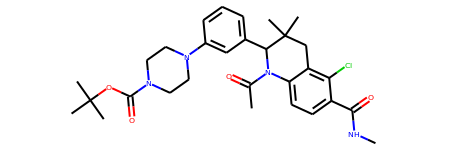

SMILES:CNC(=O)c1ccc2c(c1Cl)CC(C)(C)C(c1cccc(N3CCN(C(=O)OC(C)(C)C)CC3)c1)N2C(C)=O
*******************
Analog #2


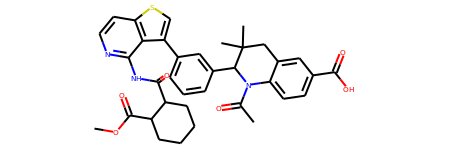

SMILES:COC(=O)C1CCCCC1C(=O)Nc1nccc2scc(-c3cccc(C4N(C(C)=O)c5ccc(C(=O)O)cc5CC4(C)C)c3)c12
*******************
Analog #3


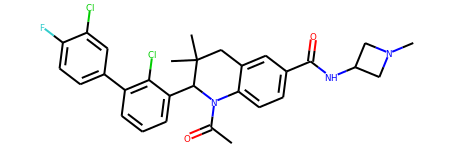

SMILES:CC(=O)N1c2ccc(C(=O)NC3CN(C)C3)cc2CC(C)(C)C1c1cccc(-c2ccc(F)c(Cl)c2)c1Cl
*******************
Analog #4


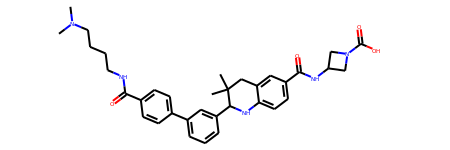

SMILES:CN(C)CCCCNC(=O)c1ccc(-c2cccc(C3Nc4ccc(C(=O)NC5CN(C(=O)O)C5)cc4CC3(C)C)c2)cc1
*******************
Analog #5


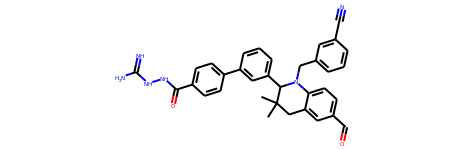

SMILES:CC1(C)Cc2cc(C=O)ccc2N(Cc2cccc(C#N)c2)C1c1cccc(-c2ccc(C(=O)NNC(=N)N)cc2)c1
*******************


In [114]:
#randomly sample 5 examples
iteration_4_5examples = iteration_4.sample (n = 5)
count = 0
for row in iteration_4_5examples.itertuples():
    count += 1
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

### Iteration 5 

In [112]:
raw_list = iteration_4['Product_output'].tolist()
print ('Length of raw list is: {}'.format (len(raw_list)))
input_smiles_list_5 = list(set(raw_list))
print ('Length after removing duplicates: {}'.format (len(input_smiles_list_5)))

Length of raw list is: 30751
Length after removing duplicates: 27725


In [113]:
# number of elements per batch
num_cores = 20

#import math for rounding up
import math
n = math.ceil(len(input_smiles_list_5)/num_cores)

#break into 20 separate batches
input_smiles_batch5 = list(divide_chunks(input_smiles_list_5, n))

In [115]:
start = time.time()

output_iter5_prll_list = Parallel(n_jobs=num_cores, verbose=10)(delayed(diversify_batch) (smiles_batch, 5) \
                                               for smiles_batch in input_smiles_batch5)

end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=20)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   2 out of  20 | elapsed: 30.3min remaining: 272.5min
[Parallel(n_jobs=20)]: Done   5 out of  20 | elapsed: 33.5min remaining: 100.6min
[Parallel(n_jobs=20)]: Done   8 out of  20 | elapsed: 33.9min remaining: 50.8min
[Parallel(n_jobs=20)]: Done  11 out of  20 | elapsed: 34.1min remaining: 27.9min
[Parallel(n_jobs=20)]: Done  14 out of  20 | elapsed: 34.7min remaining: 14.9min
[Parallel(n_jobs=20)]: Done  17 out of  20 | elapsed: 35.0min remaining:  6.2min
[Parallel(n_jobs=20)]: Done  20 out of  20 | elapsed: 35.3min remaining:    0.0s
[Parallel(n_jobs=20)]: Done  20 out of  20 | elapsed: 35.3min finished


Time taken: 2116.7818751335144


In [116]:
output_iter5_prll_pd = pd.concat(output_iter5_prll_list, ignore_index = True)

In [117]:
output_iter5_prll_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287570 entries, 0 to 287569
Data columns (total 5 columns):
Iteration           287570 non-null object
Reactant_input      287570 non-null object
Product_output      287570 non-null object
Coupling_partner    287570 non-null object
Reaction_smiles     287570 non-null object
dtypes: object(5)
memory usage: 11.0+ MB


In [118]:
# get all reaction SMILES into a list
iter5_rxns = output_iter5_prll_pd ['Reaction_smiles'].tolist()

#number of cores
num_cores = 20

#round up, n is the number of examples sent to each core
n = math.ceil (len(iter5_rxns)/num_cores)

#break into 10 separate batched
iter5_rxns_batch = list (divide_chunks(iter5_rxns, n))

len (iter5_rxns_batch)

20

In [119]:
start = time.time()

rxn_iter5_list = Parallel(n_jobs=num_cores, verbose=10)(delayed(ff_batch) (rxn_smiles_batch) \
                                               for rxn_smiles_batch in iter5_rxns_batch)

end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=20)]: Using backend LokyBackend with 20 concurrent workers.
[Parallel(n_jobs=20)]: Done   2 out of  20 | elapsed:  5.8min remaining: 52.4min
[Parallel(n_jobs=20)]: Done   5 out of  20 | elapsed:  6.0min remaining: 18.0min
[Parallel(n_jobs=20)]: Done   8 out of  20 | elapsed:  6.1min remaining:  9.1min
[Parallel(n_jobs=20)]: Done  11 out of  20 | elapsed:  6.3min remaining:  5.1min
[Parallel(n_jobs=20)]: Done  14 out of  20 | elapsed:  6.7min remaining:  2.9min
[Parallel(n_jobs=20)]: Done  17 out of  20 | elapsed:  6.8min remaining:  1.2min


Time taken: 414.997998714447


[Parallel(n_jobs=20)]: Done  20 out of  20 | elapsed:  6.9min remaining:    0.0s
[Parallel(n_jobs=20)]: Done  20 out of  20 | elapsed:  6.9min finished


In [120]:
#combine the fast filter parallelized results into a single dictionary
rxnSMILES_FF_5 = {}

for item in rxn_iter5_list:
    rxnSMILES_FF_5.update(item)

In [122]:
#intialize fast filter list
ff_scores = []

# loop through the diversification results
for row in output_iter5_prll_pd.itertuples():
    
    #append fast filter score to growing list
    ff_scores.append (rxnSMILES_FF_5[row[5]])

output_iter5_prll_pd['Fast filter'] = ff_scores

In [123]:
output_iter5_prll_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 287570 entries, 0 to 287569
Data columns (total 6 columns):
Iteration           287570 non-null object
Reactant_input      287570 non-null object
Product_output      287570 non-null object
Coupling_partner    287570 non-null object
Reaction_smiles     287570 non-null object
Fast filter         287570 non-null float64
dtypes: float64(1), object(5)
memory usage: 13.2+ MB


In [124]:
#cut off fast filter scores above 0.5
iteration_5 = fast_filter_cutoff (output_iter5_prll_pd)

#reset the indices
iteration_5.reset_index(drop= True, inplace = True)

In [125]:
iteration_5.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 275718 entries, 0 to 275717
Data columns (total 6 columns):
Iteration           275718 non-null object
Reactant_input      275718 non-null object
Product_output      275718 non-null object
Coupling_partner    275718 non-null object
Reaction_smiles     275718 non-null object
Fast filter         275718 non-null float64
dtypes: float64(1), object(5)
memory usage: 12.6+ MB


Analog #1


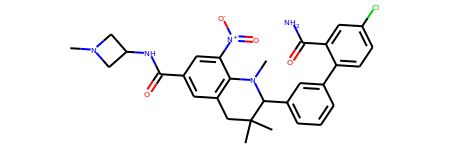

SMILES:CN1CC(NC(=O)c2cc3c(c([N+](=O)[O-])c2)N(C)C(c2cccc(-c4ccc(Cl)cc4C(N)=O)c2)C(C)(C)C3)C1
*******************
Analog #2


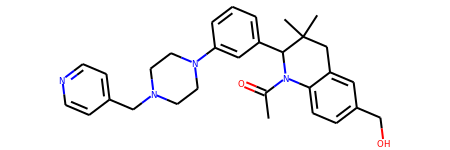

SMILES:CC(=O)N1c2ccc(CO)cc2CC(C)(C)C1c1cccc(N2CCN(Cc3ccncc3)CC2)c1
*******************
Analog #3


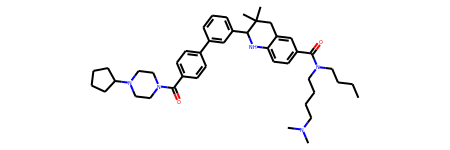

SMILES:CCCCN(CCCCN(C)C)C(=O)c1ccc2c(c1)CC(C)(C)C(c1cccc(-c3ccc(C(=O)N4CCN(C5CCCC5)CC4)cc3)c1)N2
*******************
Analog #4


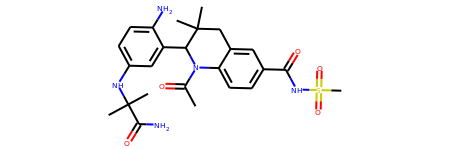

SMILES:CC(=O)N1c2ccc(C(=O)NS(C)(=O)=O)cc2CC(C)(C)C1c1cc(NC(C)(C)C(N)=O)ccc1N
*******************
Analog #5


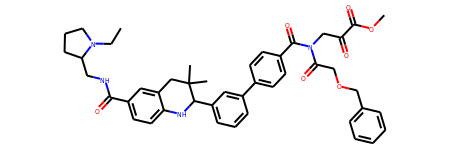

SMILES:CCN1CCCC1CNC(=O)c1ccc2c(c1)CC(C)(C)C(c1cccc(-c3ccc(C(=O)N(CC(=O)C(=O)OC)C(=O)COCc4ccccc4)cc3)c1)N2
*******************


In [126]:
#randomly sample 5 examples
iteration_5_5examples = iteration_5.sample (n = 5)
count = 0
for row in iteration_5_5examples.itertuples():
    count += 1
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

### Iteration 6

In [130]:
raw_list = iteration_5['Product_output'].tolist()
print ('Length of raw list is: {}'.format (len(raw_list)))
input_smiles_list_6 = list(set(raw_list))
print ('Length after removing duplicates: {}'.format (len(input_smiles_list_6)))

Length of raw list is: 275718
Length after removing duplicates: 232033


In [131]:
# number of elements per batch
num_cores = 25

#import math for rounding up
import math
n = math.ceil(len(input_smiles_list_6)/num_cores)

#break into 25 separate batches
input_smiles_batch6 = list(divide_chunks(input_smiles_list_6, n))

In [133]:
start = time.time()

output_iter6_prll_list = Parallel(n_jobs=num_cores, verbose=10)(delayed(diversify_batch) (smiles_batch, 6) \
                                               for smiles_batch in input_smiles_batch6)

end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=25)]: Using backend LokyBackend with 25 concurrent workers.
[Parallel(n_jobs=25)]: Done   3 out of  25 | elapsed: 286.1min remaining: 2097.9min
[Parallel(n_jobs=25)]: Done   6 out of  25 | elapsed: 289.0min remaining: 915.1min
[Parallel(n_jobs=25)]: Done   9 out of  25 | elapsed: 292.6min remaining: 520.1min
[Parallel(n_jobs=25)]: Done  12 out of  25 | elapsed: 292.8min remaining: 317.2min
[Parallel(n_jobs=25)]: Done  15 out of  25 | elapsed: 293.3min remaining: 195.5min
[Parallel(n_jobs=25)]: Done  18 out of  25 | elapsed: 295.3min remaining: 114.8min
[Parallel(n_jobs=25)]: Done  21 out of  25 | elapsed: 296.0min remaining: 56.4min
[Parallel(n_jobs=25)]: Done  25 out of  25 | elapsed: 299.9min finished


Time taken: 17994.262449026108


In [137]:
len (output_iter6_prll_list)

25

In [134]:
output_iter6_prll_pd = pd.concat(output_iter6_prll_list, ignore_index = True)

In [139]:
output_iter6_prll_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3481732 entries, 0 to 3481731
Data columns (total 5 columns):
Iteration           object
Reactant_input      object
Product_output      object
Coupling_partner    object
Reaction_smiles     object
dtypes: object(5)
memory usage: 132.8+ MB


In [141]:
# get all reaction SMILES into a list
iter6_rxns = output_iter6_prll_pd ['Reaction_smiles'].tolist()

len (iter6_rxns)

3481732

In [142]:
#number of cores
num_cores = 25

#round up, n is the number of examples sent to each core
n = math.ceil (len(iter6_rxns)/num_cores)

#break into 10 separate batched
iter6_rxns_batch = list (divide_chunks(iter6_rxns, n))

len (iter6_rxns_batch)

25

In [143]:
start = time.time()

rxn_iter6_list = Parallel(n_jobs=num_cores, verbose=10)(delayed(ff_batch) (rxn_smiles_batch) \
                                               for rxn_smiles_batch in iter6_rxns_batch)

end = time.time()
print ('Time taken: {}'.format (end-start))

[Parallel(n_jobs=25)]: Using backend LokyBackend with 25 concurrent workers.
[Parallel(n_jobs=25)]: Done   3 out of  25 | elapsed: 48.0min remaining: 351.7min
[Parallel(n_jobs=25)]: Done   6 out of  25 | elapsed: 48.5min remaining: 153.5min
[Parallel(n_jobs=25)]: Done   9 out of  25 | elapsed: 48.5min remaining: 86.3min
[Parallel(n_jobs=25)]: Done  12 out of  25 | elapsed: 49.1min remaining: 53.2min
[Parallel(n_jobs=25)]: Done  15 out of  25 | elapsed: 50.7min remaining: 33.8min
[Parallel(n_jobs=25)]: Done  18 out of  25 | elapsed: 50.9min remaining: 19.8min
[Parallel(n_jobs=25)]: Done  21 out of  25 | elapsed: 51.0min remaining:  9.7min


Time taken: 3123.1073927879333


[Parallel(n_jobs=25)]: Done  25 out of  25 | elapsed: 52.1min finished


In [144]:
#combine the fast filter parallelized results into a single dictionary
rxnSMILES_FF_6 = {}

for item in rxn_iter6_list:
    rxnSMILES_FF_6.update(item)

In [146]:
#intialize fast filter list
ff_scores = []

# loop through the diversification results
for row in output_iter6_prll_pd.itertuples():
    
    #append fast filter score to growing list
    ff_scores.append (rxnSMILES_FF_6[row[5]])

output_iter6_prll_pd['Fast filter'] = ff_scores

In [147]:
output_iter6_prll_pd.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3481732 entries, 0 to 3481731
Data columns (total 6 columns):
Iteration           object
Reactant_input      object
Product_output      object
Coupling_partner    object
Reaction_smiles     object
Fast filter         float64
dtypes: float64(1), object(5)
memory usage: 159.4+ MB


In [148]:
#cut off fast filter scores above 0.5
iteration_6 = fast_filter_cutoff (output_iter6_prll_pd)

#reset the indices
iteration_6.reset_index(drop= True, inplace = True)

In [149]:
iteration_6.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3401054 entries, 0 to 3401053
Data columns (total 6 columns):
Iteration           object
Reactant_input      object
Product_output      object
Coupling_partner    object
Reaction_smiles     object
Fast filter         float64
dtypes: float64(1), object(5)
memory usage: 155.7+ MB


Analog #1


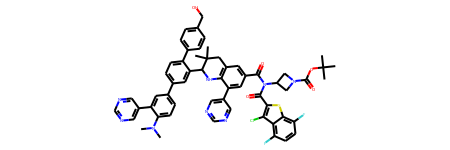

SMILES:CN(C)c1ccc(-c2ccc(-c3ccc(CO)cc3)c(C3Nc4c(cc(C(=O)N(C(=O)c5sc6c(F)ccc(F)c6c5Cl)C5CN(C(=O)OC(C)(C)C)C5)cc4-c4cncnc4)CC3(C)C)c2)cc1-c1cncnc1
*******************
Analog #2


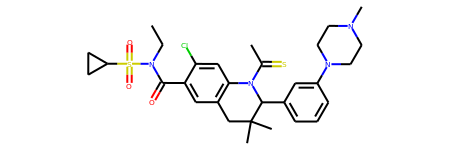

SMILES:CCN(C(=O)c1cc2c(cc1Cl)N(C(C)=S)C(c1cccc(N3CCN(C)CC3)c1)C(C)(C)C2)S(=O)(=O)C1CC1
*******************
Analog #3


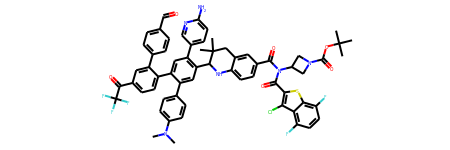

SMILES:CN(C)c1ccc(-c2cc(C3Nc4ccc(C(=O)N(C(=O)c5sc6c(F)ccc(F)c6c5Cl)C5CN(C(=O)OC(C)(C)C)C5)cc4CC3(C)C)c(-c3ccc(N)nc3)cc2-c2ccc(C(=O)C(F)(F)F)cc2-c2ccc(C=O)cc2)cc1
*******************
Analog #4


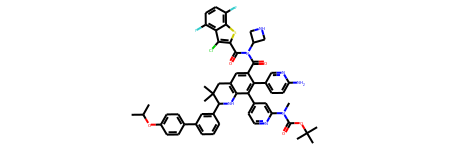

SMILES:CC(C)Oc1ccc(-c2cccc(C3Nc4c(cc(C(=O)N(C(=O)c5sc6c(F)ccc(F)c6c5Cl)C5CNC5)c(-c5ccc(N)nc5)c4-c4ccnc(N(C)C(=O)OC(C)(C)C)c4)CC3(C)C)c2)cc1
*******************
Analog #5


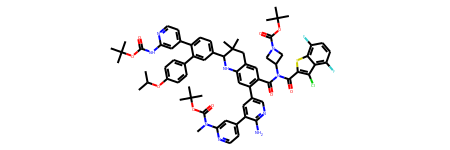

SMILES:CC(C)Oc1ccc(-c2cc(C3Nc4cc(-c5cnc(N)c(-c6ccnc(N(C)C(=O)OC(C)(C)C)c6)c5)c(C(=O)N(C(=O)c5sc6c(F)ccc(F)c6c5Cl)C5CN(C(=O)OC(C)(C)C)C5)cc4CC3(C)C)ccc2-c2ccnc(NC(=O)OC(C)(C)C)c2)cc1
*******************


In [151]:
#randomly sample 5 examples
iteration_6_5examples = iteration_6.sample (n = 5)
count = 0
for row in iteration_6_5examples.itertuples():
    count += 1
    print ('Analog #{}'.format (count))
    prod = Chem.MolFromSmiles (row[3])
    display (prod)
    print ('SMILES:{}'.format (row[3]))
    print ('*******************')

In [152]:
raw_list = iteration_6['Product_output'].tolist()
print ('Length of raw list is: {}'.format (len(raw_list)))
input_smiles_list_7 = list(set(raw_list))
print ('Length after removing duplicates: {}'.format (len(input_smiles_list_7)))

Length of raw list is: 3401054
Length after removing duplicates: 2540954


### Understand the overlap between the three lists

In [71]:
def intersection (lst1, lst2):
    return list (set(lst1) & set (lst2))

In [74]:
len (set (input_smiles_list))

51

In [75]:
len (intersection (input_smiles_list,input_smiles_list_3 ))

7

In [76]:
len (intersection(input_smiles_list_3,input_smiles_list_4))

269

### Save the results from the six iterations

In [156]:
import os
os.getcwd()

'/data/karthiksankar2/SAR/Datasets/Coley_WLN/CompoundDiversification_GitHubCopy/8.Platform_ForMultiStepEnumeration'

In [157]:
#combine all iterations into one list
frames = [iteration_1, iteration_2, iteration_3,\
         iteration_4, iteration_5, iteration_6]

#formally concatenate them
result_diversification_6iter = pd.concat(frames)

#get an understanding of what it looks like
result_diversification_6iter.head()

,Iteration,Reactant_input,Product_output,Coupling_partner,Reaction_smiles,Fast filter
0,1,CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1,CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(NC2(C(=O)O)CC...,[NC1(C(=O)[O-])CC1],CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1.NC1(C(=...,0.999544
1,1,CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1,CC1(C)Cc2cc(C(=O)NS(=O)(=O)C3CC3)ccc2NC1c1cccc...,[NS(=O)(=O)C1CC1],CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1.NS(=O)(...,0.999995
2,1,CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1,CC1(C)Cc2cc(C(=O)NS(C)(=O)=O)ccc2NC1c1cccc(Br)c1,[CS(N)(=O)=O],CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1.CS(N)(=...,0.999925
3,1,CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1,CC(C)(C)OC(=O)N1CC(NC(=O)c2ccc3c(c2)CC(C)(C)C(...,[CC(C)(C)OC(=O)N1CC(N)C1],CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1.CC(C)(C...,0.999999
4,1,CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1,CC1(C)Cc2cc(C(=O)NS(=O)(=O)c3ccccc3)ccc2NC1c1c...,[NS(=O)(=O)c1ccccc1],CC1(C)Cc2cc(C(=O)O)ccc2NC1c1cccc(Br)c1.NS(=O)(...,0.999397


In [158]:
len (result_diversification_6iter['Iteration'].tolist())

3712097

In [159]:
result_diversification_6iter.to_pickle('Diversify_6iter.pkl')

In [160]:
result_diversification_6iter.to_csv('Diversify_6iter.csv')

### Make figures for each step

In [81]:
#jx_cache = {} #jx_cache is a dictionary
draw = True            
debug = False
result_print = False
coupling_partner_figure = False

getfp = lambda smi: AllChem.GetMorganFingerprint(Chem.MolFromSmiles(smi),2, useFeatures=True)

def do_one_v4_SMILES (smiles, draw=draw, debug=debug, max_prec=100, testlimit = 100, result_print = result_print):
    
    #get reactant smiles
    react_smiles = []
    react_smiles.append (smiles)
    
    # for the moment, it is just an empty string
    rec_for_printing = '' 
    
    #loads reactant SMILES into RDKit object
    ex = Chem.MolFromSmiles(smiles) 
    
    #loads reactant SMILES into RDChiral object
    rct = rdchiralReactants(smiles)
    
    #if Draw = True, then Print Mol {Index}
    if draw:
        print ('Reactant input:')
        display (ex)
        
    #if Debug = True, then Print {Product SMILES} + go to new line +
    # True reaction: {reaction smiles}
    
    if debug:
        rec_for_printing += 'Desired Reactant:' + '\n'
        rec_for_printing += smiles + '\n'
        
  
    #get the fingerprint of the reactant
    fp = getfp(smiles)
    
    #calculates similarity metric between fingerprint 
    # and all fingerprints in the database
    sims = similarity_metric (fp, [fp_ for fp_ in datasub['react_fp']])
    
    #sort the similarity metric in reverse order
    js = np.argsort(sims) [::-1]
    
    
    # Get probability of precursors
    probs = {}
    coreact = {}
    
    for ji,j in enumerate (js[:max_prec]):
        
        #get the index in the similarity search
        jx = datasub.index[j]
        
        #draw out the most similar reactions
        if draw: 
            print('\n\n'+'-'*50+'\n')
            print ('Train index: {}'.format (jx))
            print ('RANK {} PRECEDENT'.format(ji+1))
            print ('REACTANT MATCH SCORE: {}'.format(sims[j]))
            draw_rxn_smi (datasub['rxn_smiles'][jx])
        
        #debug statement- Reaction precedent rank, similarity score, and reaction smiles addition!
        if debug:
            rec_for_printing += '\nReaction precedent {}, prod similarity {}\n'.format(ji+1, sims[j])
            rec_for_printing += '-> rxn_smiles {}\n'.format(datasub['rxn_smiles'][jx])
        
        try:  
            #extract the template
            template = datasub['template'][jx]

            #get product reference fingerprint
            prods_ref_fp = getfp(datasub['rxn_smiles'][jx].split('>')[2])

            #load the reaction into an rdchiral object
            rxn = rdchiralReaction(template)

            #save it to the cache
            #jx_cache[jx] = (rxn, template, prods_ref_fp)

            #debug statement- print the reaction template and index
            if debug:
                rec_for_printing += '-> template: {}\n'.format(template)
                rec_for_printing += '-> jx/ index: {}\n'.format(jx)

            #draw: draw out the template
            if draw:
                print('-> template: {}'.format(template))
                rxn_for_display = rdChemReactions.ReactionFromSmarts(template)
                display (rxn_for_display)

        except:

            if debug:
                rec_for_printing += '-> Template extraction failed! \n'

            if draw:
                print ('-> Template extraction failed!')

            #if it fails, move to the next reaction
            continue 

        try:
            # try running the rdchiral reaction
            outcomes = rdchiralRun (rxn, rct, combine_enantiomers=False)
        
        #if running the rdchiral reaction is not possible go into this exception routine
        except Exception as e:
            print(e)
            outcomes = []
            continue
        
        #if you are unable to generate outcomes and draw -> print an error message
        if not outcomes and draw:
            print('->No precursors could be generated!')
            
        #if you are unable to generate outcomes and debug -> print an error message
        if not outcomes and debug:
            rec_for_printing += '-> Template application failed! \n'
            
        for products in outcomes:
            
            #proposed product fingerprint
            products_fp = getfp(products)
            
            #compare proposed and precedent product fp
            products_sim = similarity_metric(products_fp, [prods_ref_fp])[0]
            
            #debug statement
            if debug:
                rec_for_printing += 'prod sim {}, overall {}, smiles {}\n'.format(products_sim, products_sim*sims[j], products)
            
            #draw statement
            if draw:
                print('Product similarity {}, overall {}, smiles {}'.format(
                    products_sim, products_sim*sims[j], products))
                display(Chem.MolFromSmiles(products))
                
            #assemble the reaction
            rxn_to_print = ''

            #add core reactant
            rxn_to_print += smiles

            #add coreactants
            coreactants_draw = datasub ['Reaction Partner (s)'][jx]
            for reactant in coreactants_draw:
                rxn_to_print += '.' + reactant

            #add products
            rxn_to_print += '>>' + products
                  
                
            if draw:
                #display the reaction
                print ('The proposed reaction is:')
                draw_rxn_smi(rxn_to_print)
                print ('The reaction SMILES string is: {}'.format (rxn_to_print))
                
                
            if products in probs:
                if (products_sim*sims[j]) > probs[products][0]:
                    probs[products] = [products_sim*sims[j]]
                    coreact[products] = datasub ['Reaction Partner (s)'][jx]
            else:
                probs[products] = [products_sim*sims[j]]
                coreact[products] = datasub ['Reaction Partner (s)'][jx]
    
    
    return None

Reactant input:


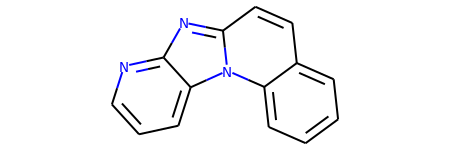



--------------------------------------------------

Train index: 340732
RANK 1 PRECEDENT
REACTANT MATCH SCORE: 0.603448275862069


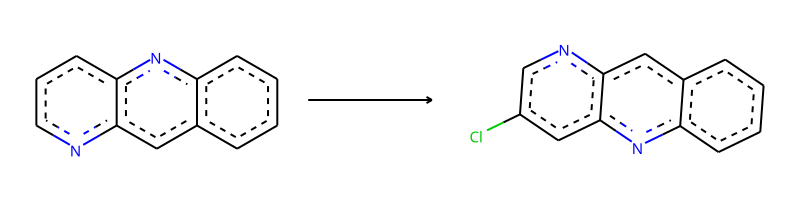

-> template: [#7;a:3]:[c:2]:[cH;D2;+0:1]:[c:4]:[c:5]:[#7;a:6]>>Cl-[c;H0;D3;+0:1](:[c:2]:[#7;a:3]):[c:4]:[c:5]:[#7;a:6]


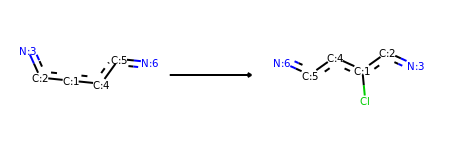

Product similarity 0.5396825396825397, overall 0.32567049808429116, smiles Clc1ccnc2nc3ccc4ccccc4n3c12


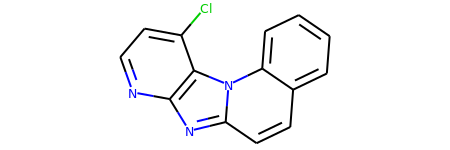

The proposed reaction is:


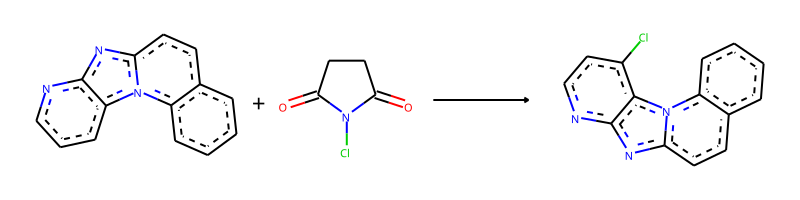

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1Cl>>Clc1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.6166666666666667, overall 0.3721264367816092, smiles Clc1cnc2nc3ccc4ccccc4n3c2c1


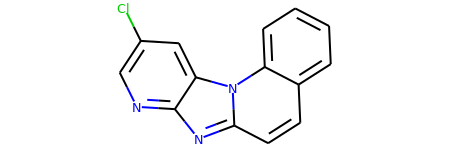

The proposed reaction is:


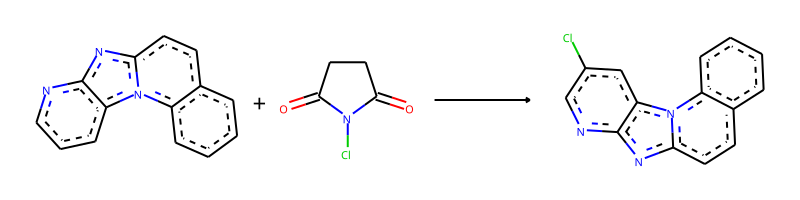

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1Cl>>Clc1cnc2nc3ccc4ccccc4n3c2c1


--------------------------------------------------

Train index: 38575
RANK 2 PRECEDENT
REACTANT MATCH SCORE: 0.5573770491803278


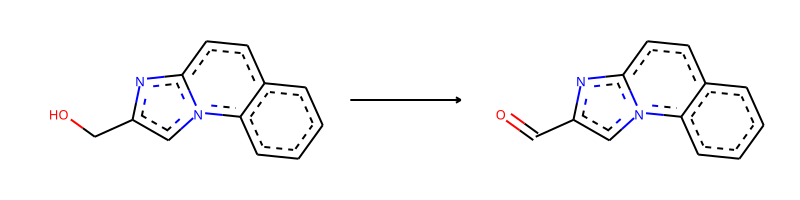

-> template: [#7;a:1]:[c:2](-[CH2;D2;+0:3]-[OH;D1;+0:4]):[c:5]:[#7;a:6]>>[#7;a:1]:[c:2](-[CH;D2;+0:3]=[O;H0;D1;+0:4]):[c:5]:[#7;a:6]


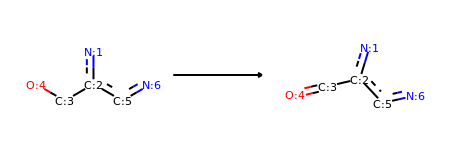

->No precursors could be generated!


--------------------------------------------------

Train index: 185137
RANK 3 PRECEDENT
REACTANT MATCH SCORE: 0.5538461538461539


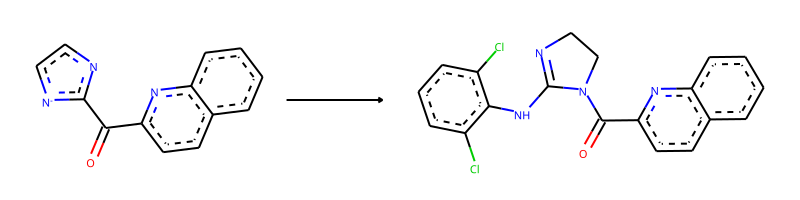

-> template: [#7;a:4]:[c:3]-[C;H0;D3;+0:1](=[O;D1;H0:2])-[c;H0;D3;+0]1:[n-;H0;D2]:[c;H1;D2;+0]:[c;H1;D2;+0]:[n;H0;D2;+0]:1>>Cl-c1:c:c:c:c(-Cl):c:1-N-C1=N-C-C-N-1-[C;H0;D3;+0:1](=[O;D1;H0:2])-[c:3]:[#7;a:4]


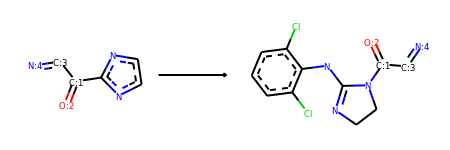

->No precursors could be generated!


--------------------------------------------------

Train index: 459810
RANK 4 PRECEDENT
REACTANT MATCH SCORE: 0.55


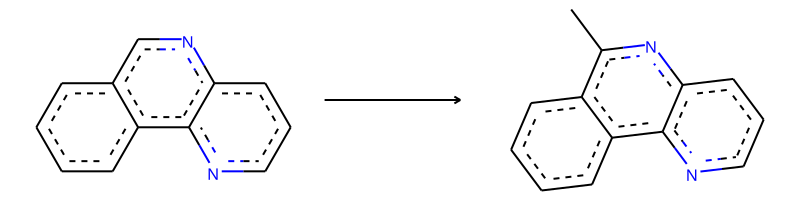

-> template: [#7;a:2]:[cH;D2;+0:1]:[c:3]>>C-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


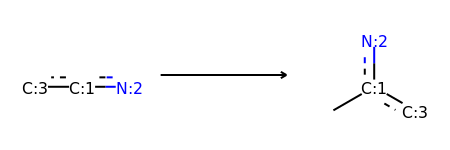

Product similarity 0.515625, overall 0.28359375000000003, smiles Cc1ccc2c(n1)nc1ccc3ccccc3n12


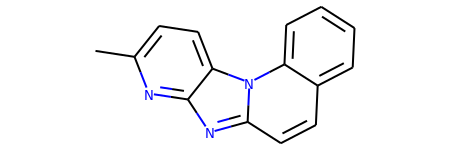

The proposed reaction is:


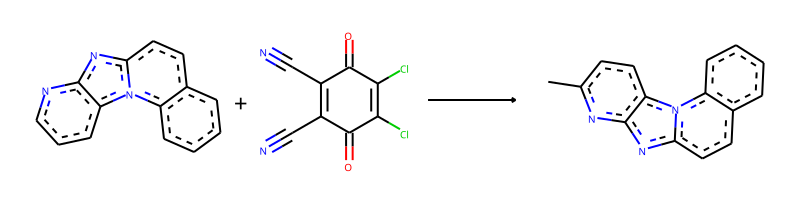

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.N#CC1=C(C#N)C(=O)C(Cl)=C(Cl)C1=O>>Cc1ccc2c(n1)nc1ccc3ccccc3n12


--------------------------------------------------

Train index: 184908
RANK 5 PRECEDENT
REACTANT MATCH SCORE: 0.55


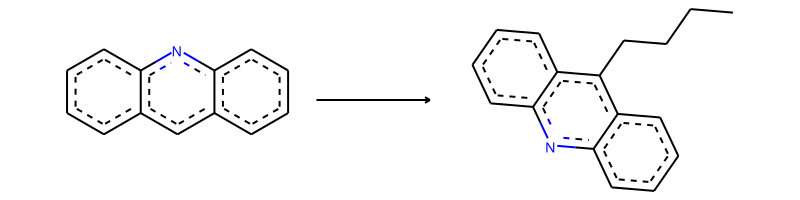

-> template: [#7;a:4]1:[c:5]:[c:6]:[cH;D2;+0:1]:[c:2]:[c:3]:1>>C-C-C-C-[c;H0;D3;+0:1]1:[c:2]:[c:3]:[#7;a:4]:[c:5]:[c:6]:1


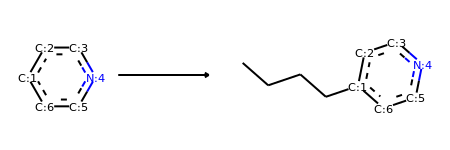

Product similarity 0.5972222222222222, overall 0.3284722222222222, smiles CCCCc1cc2nc3ncccc3n2c2ccccc12


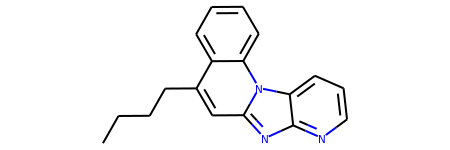

The proposed reaction is:


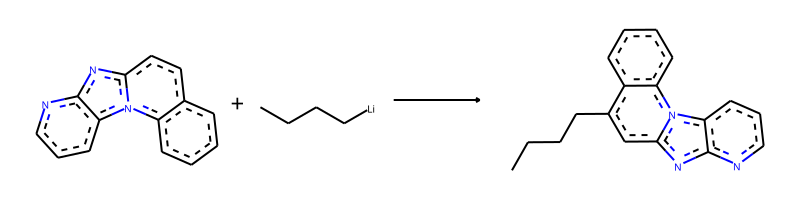

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.[Li]CCCC>>CCCCc1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.5753424657534246, overall 0.3164383561643836, smiles CCCCc1ccnc2nc3ccc4ccccc4n3c12


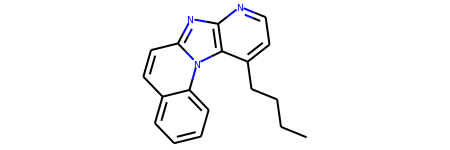

The proposed reaction is:


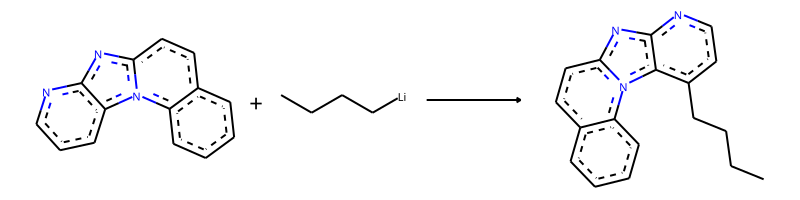

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.[Li]CCCC>>CCCCc1ccnc2nc3ccc4ccccc4n3c12


--------------------------------------------------

Train index: 224936
RANK 6 PRECEDENT
REACTANT MATCH SCORE: 0.5492957746478874


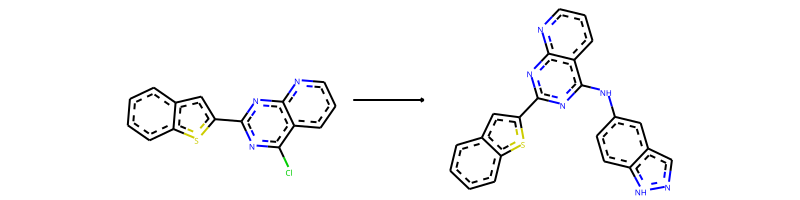

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]:[c:4](:[#7;a:5]):[#7;a:6]>>[#7;a:1]:[c;H0;D3;+0:2](-N-c1:c:c:c2:[nH]:n:c:c:2:c:1):[c:3]:[c:4](:[#7;a:5]):[#7;a:6]


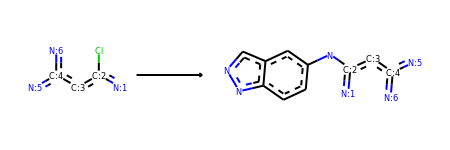

->No precursors could be generated!


--------------------------------------------------

Train index: 199547
RANK 7 PRECEDENT
REACTANT MATCH SCORE: 0.5492957746478874


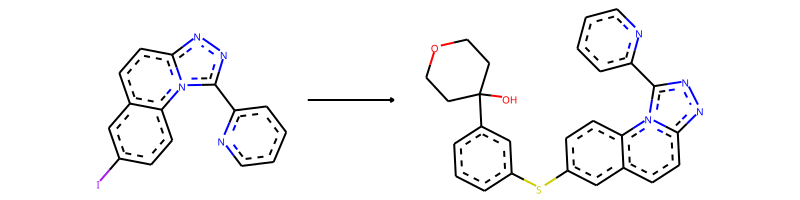

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>O-C1(-c2:c:c:c:c(-S-[c;H0;D3;+0:1](:[c:2]):[c:3]):c:2)-C-C-O-C-C-1


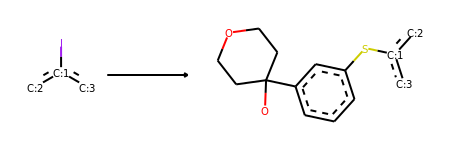

->No precursors could be generated!


--------------------------------------------------

Train index: 90774
RANK 8 PRECEDENT
REACTANT MATCH SCORE: 0.5492957746478874


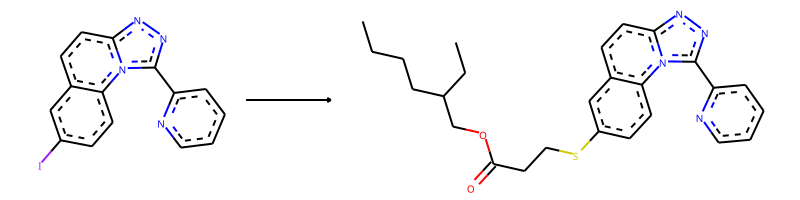

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>C-C-C-C-C(-C-C)-C-O-C(=O)-C-C-S-[c;H0;D3;+0:1](:[c:2]):[c:3]


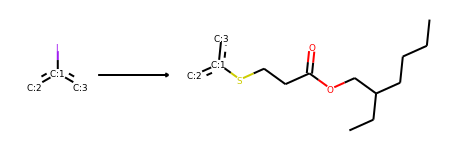

->No precursors could be generated!


--------------------------------------------------

Train index: 213271
RANK 9 PRECEDENT
REACTANT MATCH SCORE: 0.5492957746478874


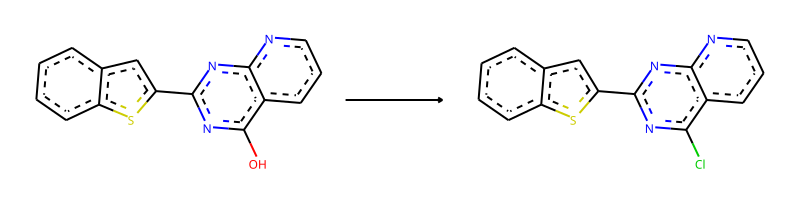

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[O;H1;D1;+0]):[c:3]:[c:4](:[#7;a:5]):[#7;a:6]>>Cl-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]:[c:4](:[#7;a:5]):[#7;a:6]


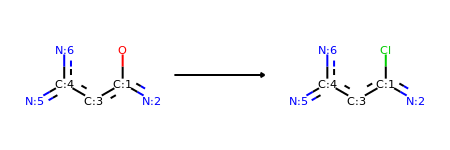

->No precursors could be generated!


--------------------------------------------------

Train index: 470734
RANK 10 PRECEDENT
REACTANT MATCH SCORE: 0.5396825396825397


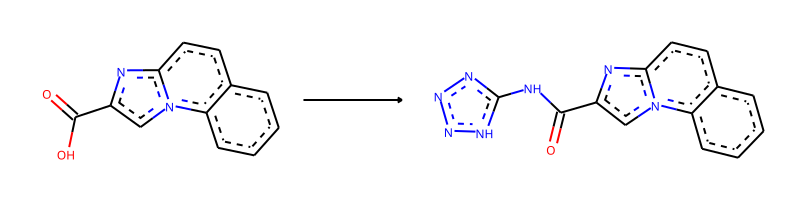

-> template: [#7;a:1]:[c:2](:[c:3]:[#7;a:4])-[C;H0;D3;+0:5](=[O;H0;D1;+0])-[OH;D1;+0:6]>>[#7;a:1]:[c:2](:[c:3]:[#7;a:4])-[C;H0;D3;+0:5](=[O;H0;D1;+0:6])-N-c1:[nH]:n:n:n:1


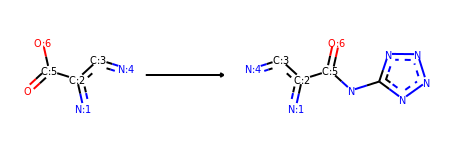

->No precursors could be generated!


--------------------------------------------------

Train index: 367420
RANK 11 PRECEDENT
REACTANT MATCH SCORE: 0.5352112676056338


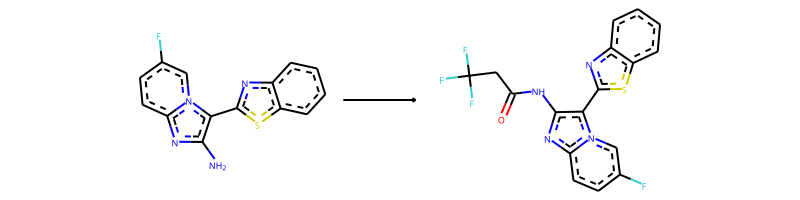

-> template: [#7;a:3]:[c:2](-[NH2;D1;+0:1]):[c:4]:[#7;a:5]>>F-C(-F)(-F)-C-C(=O)-[NH;D2;+0:1]-[c:2](:[#7;a:3]):[c:4]:[#7;a:5]


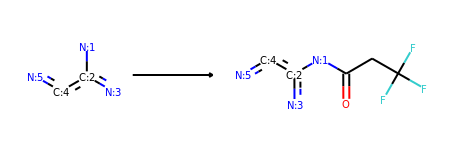

->No precursors could be generated!


--------------------------------------------------

Train index: 404587
RANK 12 PRECEDENT
REACTANT MATCH SCORE: 0.5352112676056338


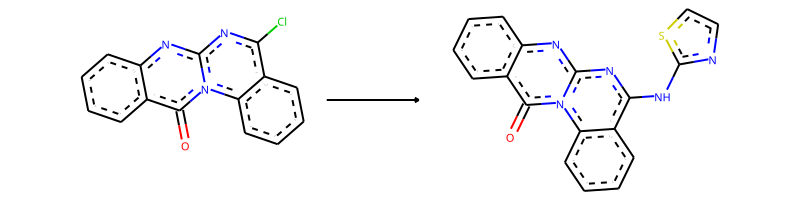

-> template: [#7;a:1]:[c;H0;D3;+0:2](-[Cl;H0;D1;+0]):[c:3]:[c:4]:[#7;a:5]>>[#7;a:1]:[c;H0;D3;+0:2](-N-c1:n:c:c:s:1):[c:3]:[c:4]:[#7;a:5]


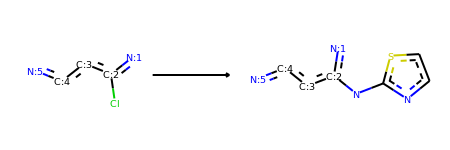

->No precursors could be generated!


--------------------------------------------------

Train index: 295380
RANK 13 PRECEDENT
REACTANT MATCH SCORE: 0.5333333333333333


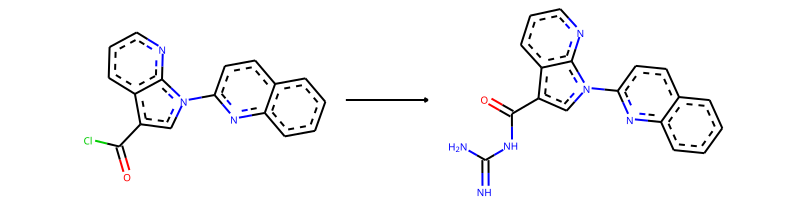

-> template: [#7;a:5]:[c:4]:[c:3]-[C;H0;D3;+0:1](-[Cl;H0;D1;+0])=[O;D1;H0:2]>>N-C(=N)-N-[C;H0;D3;+0:1](=[O;D1;H0:2])-[c:3]:[c:4]:[#7;a:5]


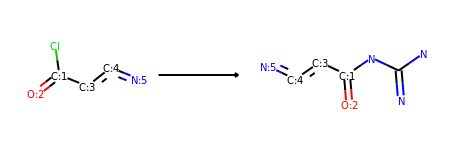

->No precursors could be generated!


--------------------------------------------------

Train index: 398384
RANK 14 PRECEDENT
REACTANT MATCH SCORE: 0.53125


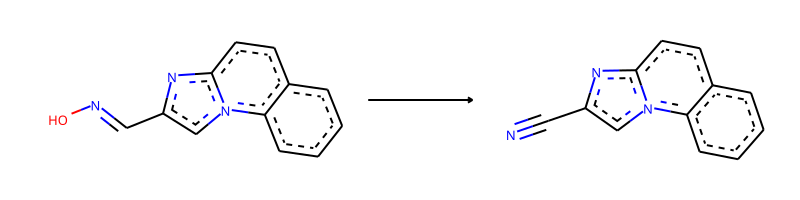

-> template: [#7;a:1]:[c:2](-[CH;D2;+0:3]=[N;H0;D2;+0:4]-[O;H1;D1;+0]):[c:5]:[#7;a:6]>>[#7;a:1]:[c:2](-[C;H0;D2;+0:3]#[N;H0;D1;+0:4]):[c:5]:[#7;a:6]


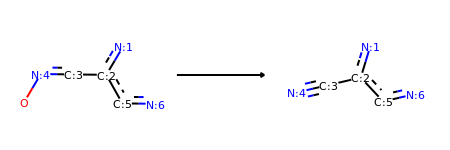

->No precursors could be generated!


--------------------------------------------------

Train index: 74218
RANK 15 PRECEDENT
REACTANT MATCH SCORE: 0.53125


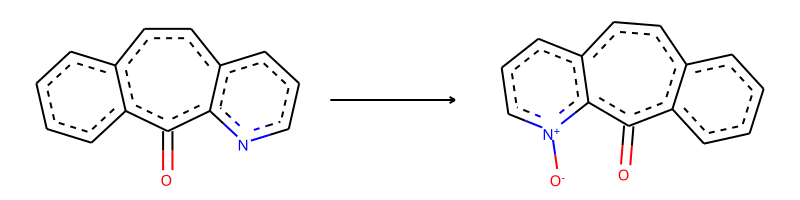

-> template: [c:2]:[n;H0;D2;+0:1]:[c:3]>>[O-]-[n+;H0;D3:1](:[c:2]):[c:3]


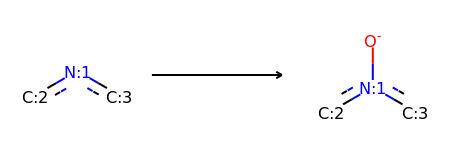

Product similarity 0.5, overall 0.265625, smiles [O-][n+]1cccc2c1nc1ccc3ccccc3n12


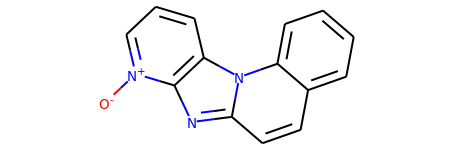

The proposed reaction is:


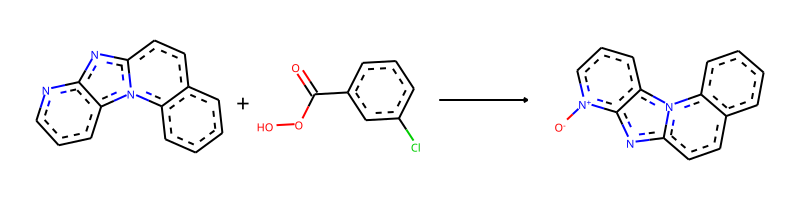

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(OO)c1cccc(Cl)c1>>[O-][n+]1cccc2c1nc1ccc3ccccc3n12
Product similarity 0.43661971830985913, overall 0.23195422535211266, smiles [O-][n+]1c2ncccc2n2c3ccccc3ccc21


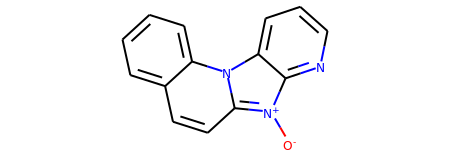

The proposed reaction is:


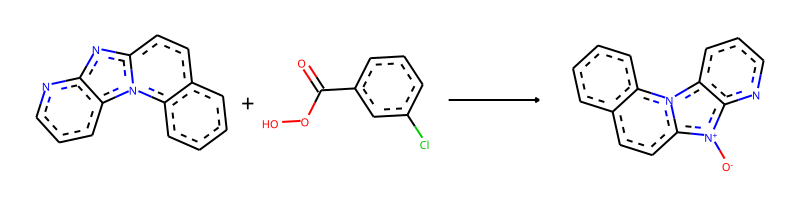

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(OO)c1cccc(Cl)c1>>[O-][n+]1c2ncccc2n2c3ccccc3ccc21


--------------------------------------------------

Train index: 141929
RANK 16 PRECEDENT
REACTANT MATCH SCORE: 0.53125


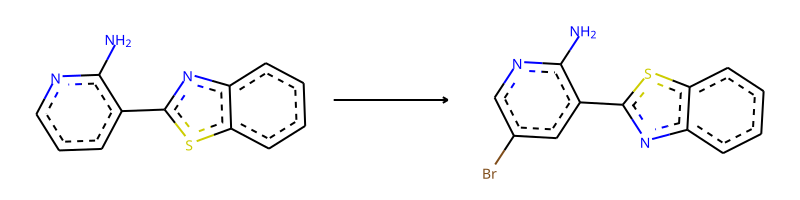

-> template: [#7;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>Br-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#7;a:4]


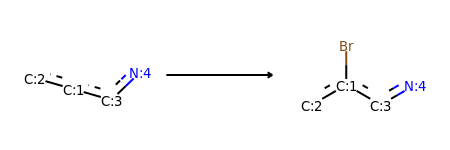

Product similarity 0.5, overall 0.265625, smiles Brc1cc2ccccc2n2c1nc1ncccc12


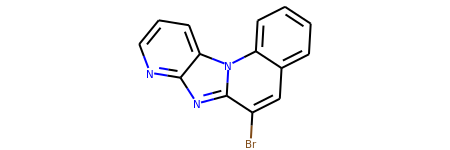

The proposed reaction is:


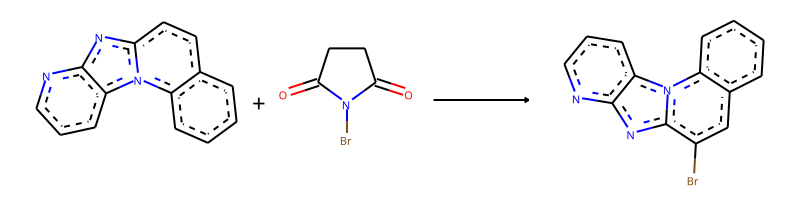

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1Br>>Brc1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.5454545454545454, overall 0.28977272727272724, smiles Brc1cnc2nc3ccc4ccccc4n3c2c1


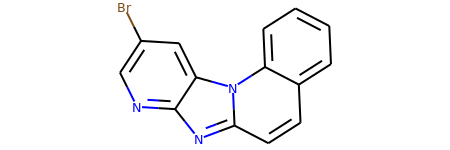

The proposed reaction is:


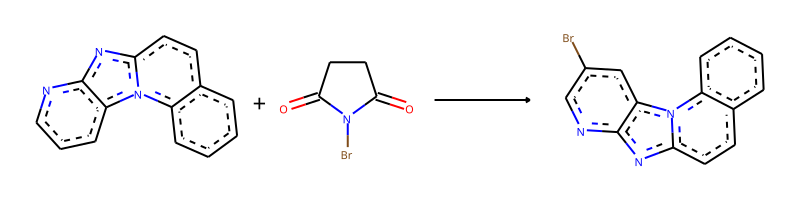

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1Br>>Brc1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.4782608695652174, overall 0.25407608695652173, smiles Brc1cccc2ccc3nc4ncccc4n3c12


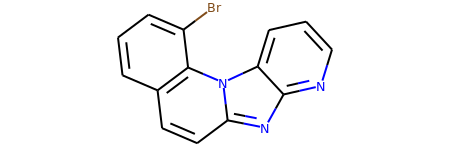

The proposed reaction is:


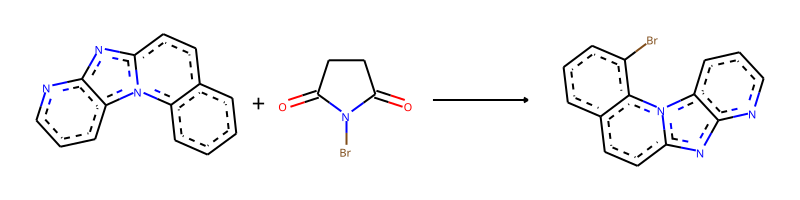

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1Br>>Brc1cccc2ccc3nc4ncccc4n3c12
Product similarity 0.5, overall 0.265625, smiles Brc1ccnc2nc3ccc4ccccc4n3c12


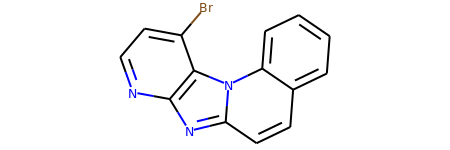

The proposed reaction is:


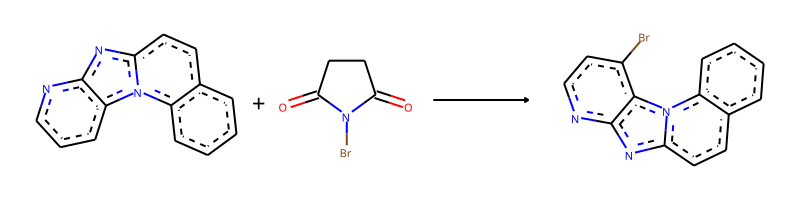

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1Br>>Brc1ccnc2nc3ccc4ccccc4n3c12


--------------------------------------------------

Train index: 400589
RANK 17 PRECEDENT
REACTANT MATCH SCORE: 0.53125


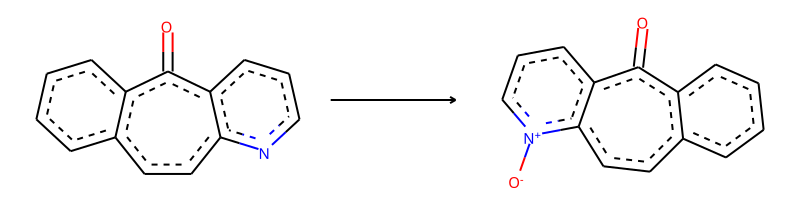

-> template: [c:2]:[n;H0;D2;+0:1]:[c:3]>>[O-]-[n+;H0;D3:1](:[c:2]):[c:3]


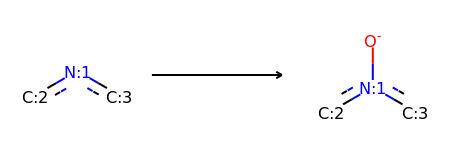

Product similarity 0.5, overall 0.265625, smiles [O-][n+]1cccc2c1nc1ccc3ccccc3n12


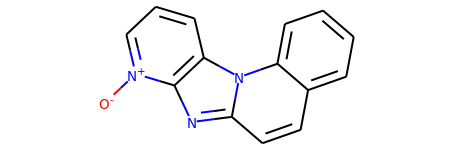

The proposed reaction is:


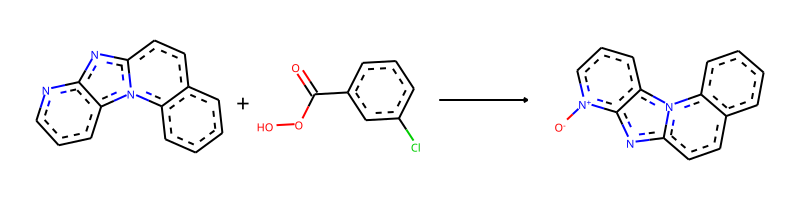

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(OO)c1cccc(Cl)c1>>[O-][n+]1cccc2c1nc1ccc3ccccc3n12
Product similarity 0.43661971830985913, overall 0.23195422535211266, smiles [O-][n+]1c2ncccc2n2c3ccccc3ccc21


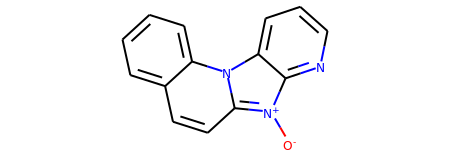

The proposed reaction is:


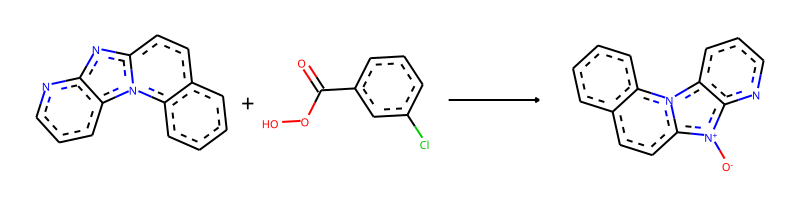

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(OO)c1cccc(Cl)c1>>[O-][n+]1c2ncccc2n2c3ccccc3ccc21


--------------------------------------------------

Train index: 168600
RANK 18 PRECEDENT
REACTANT MATCH SCORE: 0.5303030303030303


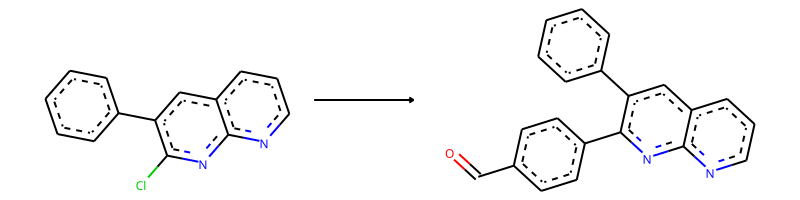

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>O=C-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


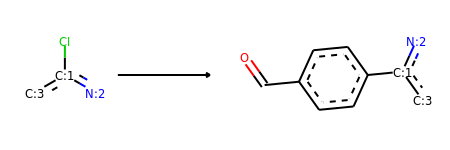

->No precursors could be generated!


--------------------------------------------------

Train index: 124825
RANK 19 PRECEDENT
REACTANT MATCH SCORE: 0.5303030303030303


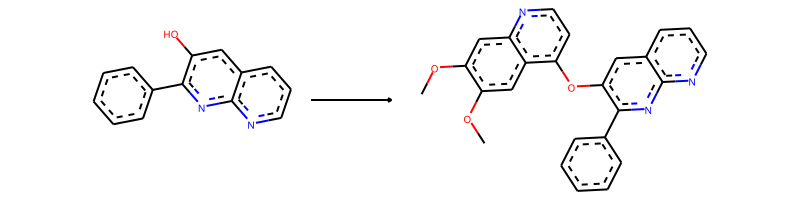

-> template: [#7;a:4]:[c:3]:[c:2]-[OH;D1;+0:1]>>C-O-c1:c:c2:n:c:c:c(-[O;H0;D2;+0:1]-[c:2]:[c:3]:[#7;a:4]):c:2:c:c:1-O-C


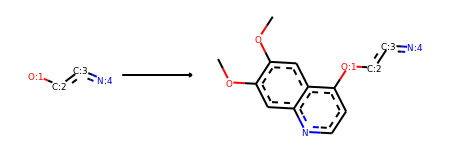

->No precursors could be generated!


--------------------------------------------------

Train index: 379481
RANK 20 PRECEDENT
REACTANT MATCH SCORE: 0.5303030303030303


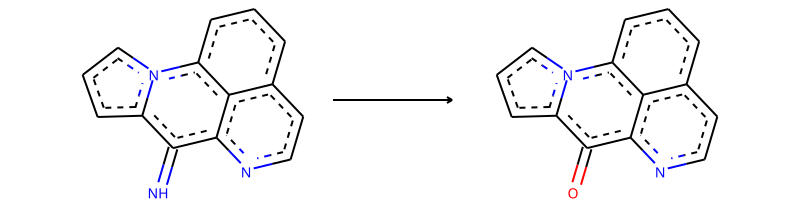

-> template: [#7;a:3]:[c:2]:[c;H0;D3;+0:1](=[N;H1;D1;+0]):[c:4]:[#7;a:5]>>O=[c;H0;D3;+0:1](:[c:2]:[#7;a:3]):[c:4]:[#7;a:5]


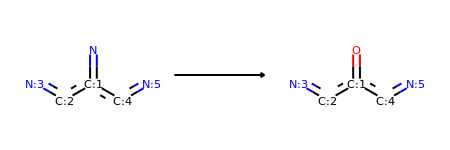

->No precursors could be generated!


--------------------------------------------------

Train index: 167553
RANK 21 PRECEDENT
REACTANT MATCH SCORE: 0.5303030303030303


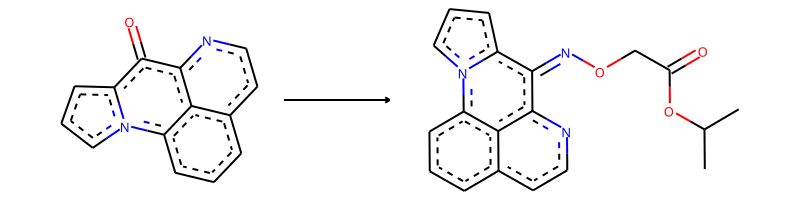

-> template: [#7;a:3]:[c:2]:[c;H0;D3;+0:1](=[O;H0;D1;+0]):[c:4]:[#7;a:5]>>C-C(-C)-O-C(=O)-C-O-N=[c;H0;D3;+0:1](:[c:2]:[#7;a:3]):[c:4]:[#7;a:5]


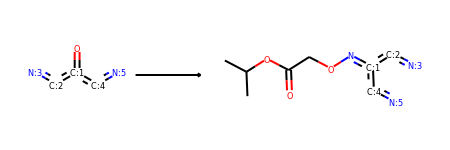

->No precursors could be generated!


--------------------------------------------------

Train index: 322321
RANK 22 PRECEDENT
REACTANT MATCH SCORE: 0.5285714285714286


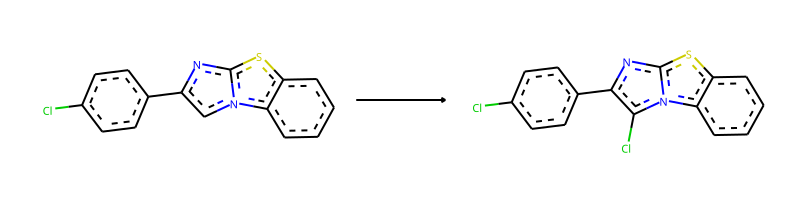

-> template: [#16;a:4]:[c:3]1:[#7;a:2]:[cH;D2;+0:1]:[c:6]:[#7;a:5]:1>>Cl-[c;H0;D3;+0:1]1:[#7;a:2]:[c:3](:[#16;a:4]):[#7;a:5]:[c:6]:1


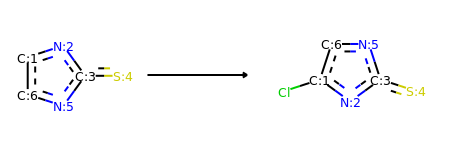

->No precursors could be generated!


--------------------------------------------------

Train index: 241783
RANK 23 PRECEDENT
REACTANT MATCH SCORE: 0.5285714285714286


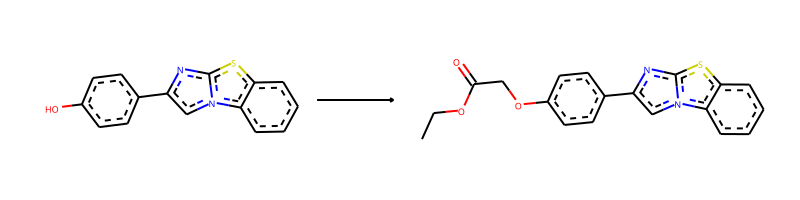

-> template: [OH;D1;+0:1]-[c:2]>>C-C-O-C(=O)-C-[O;H0;D2;+0:1]-[c:2]


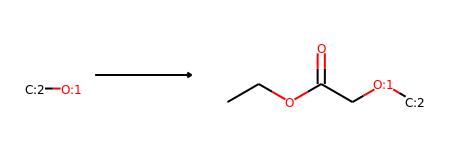

->No precursors could be generated!


--------------------------------------------------

Train index: 18399
RANK 24 PRECEDENT
REACTANT MATCH SCORE: 0.5285714285714286


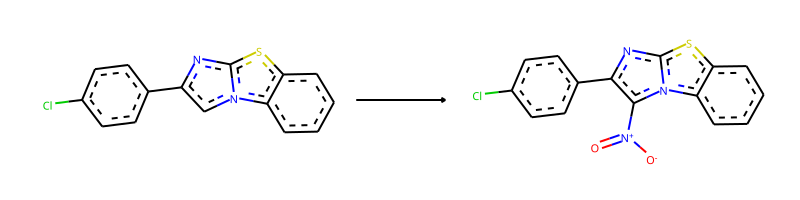

-> template: [#16;a:4]:[c:3]1:[#7;a:5]:[c:6]:[cH;D2;+0:1]:[#7;a:2]:1>>O=[N+](-[O-])-[c;H0;D3;+0:1]1:[#7;a:2]:[c:3](:[#16;a:4]):[#7;a:5]:[c:6]:1


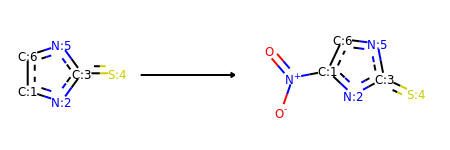

->No precursors could be generated!


--------------------------------------------------

Train index: 135483
RANK 25 PRECEDENT
REACTANT MATCH SCORE: 0.5285714285714286


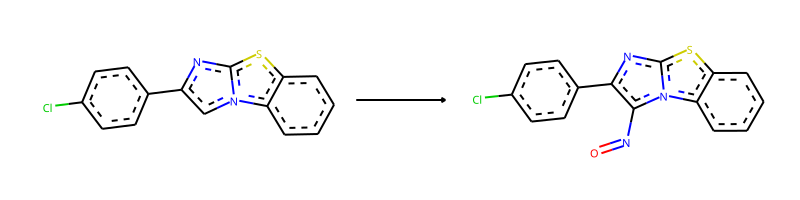

-> template: [#16;a:4]:[c:3]1:[#7;a:5]:[c:6]:[cH;D2;+0:1]:[#7;a:2]:1>>O=N-[c;H0;D3;+0:1]1:[#7;a:2]:[c:3](:[#16;a:4]):[#7;a:5]:[c:6]:1


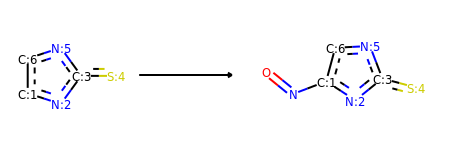

->No precursors could be generated!


--------------------------------------------------

Train index: 143045
RANK 26 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


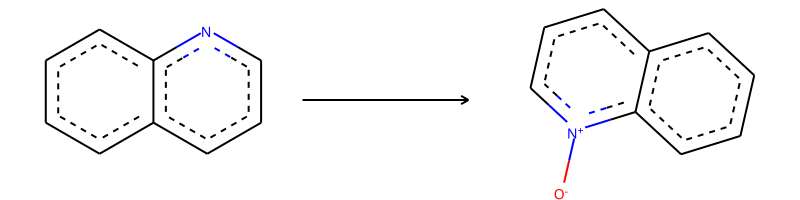

-> template: [c:2]:[n;H0;D2;+0:1]:[c:3]>>[O-]-[n+;H0;D3:1](:[c:2]):[c:3]


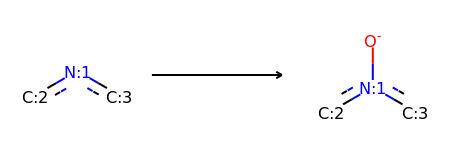

Product similarity 0.46551724137931033, overall 0.24593363695510734, smiles [O-][n+]1cccc2c1nc1ccc3ccccc3n12


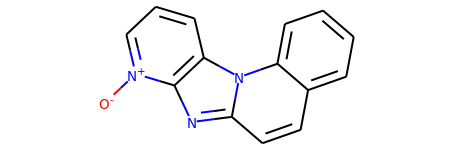

The proposed reaction is:


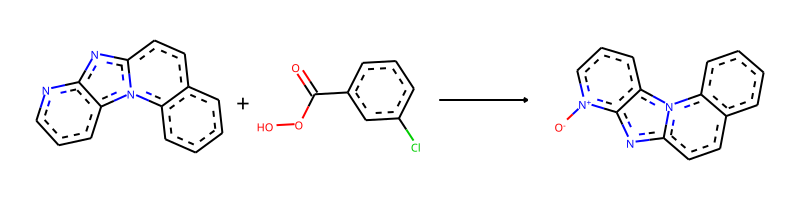

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(OO)c1cccc(Cl)c1>>[O-][n+]1cccc2c1nc1ccc3ccccc3n12
Product similarity 0.39344262295081966, overall 0.20785648004948964, smiles [O-][n+]1c2ncccc2n2c3ccccc3ccc21


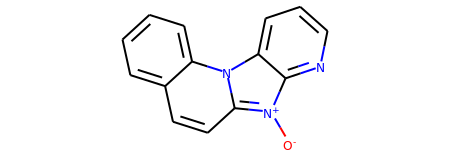

The proposed reaction is:


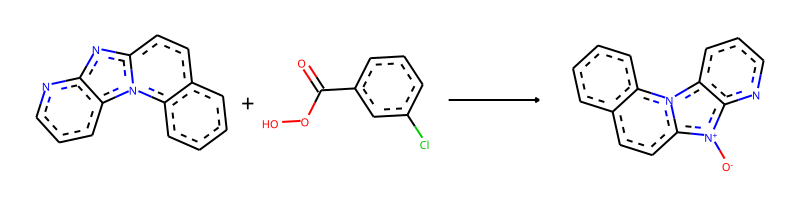

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(OO)c1cccc(Cl)c1>>[O-][n+]1c2ncccc2n2c3ccccc3ccc21


--------------------------------------------------

Train index: 447014
RANK 27 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


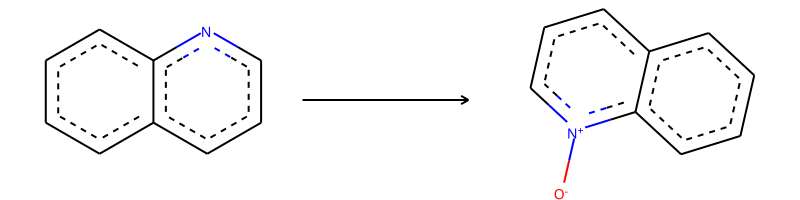

-> template: [c:2]:[n;H0;D2;+0:1]:[c:3]>>[O-]-[n+;H0;D3:1](:[c:2]):[c:3]


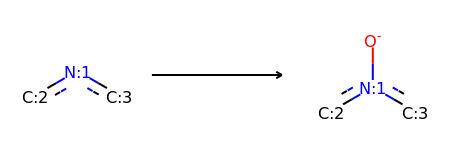

Product similarity 0.46551724137931033, overall 0.24593363695510734, smiles [O-][n+]1cccc2c1nc1ccc3ccccc3n12


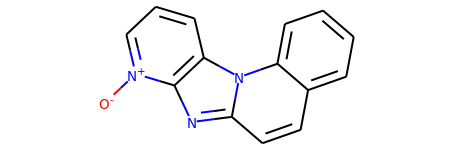

The proposed reaction is:


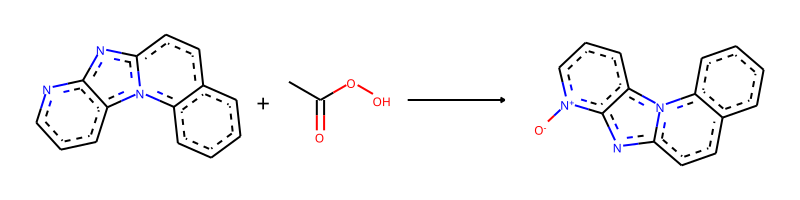

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)OO>>[O-][n+]1cccc2c1nc1ccc3ccccc3n12
Product similarity 0.39344262295081966, overall 0.20785648004948964, smiles [O-][n+]1c2ncccc2n2c3ccccc3ccc21


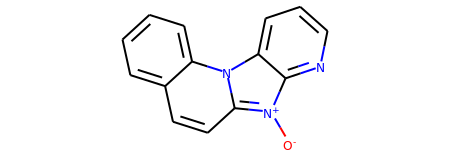

The proposed reaction is:


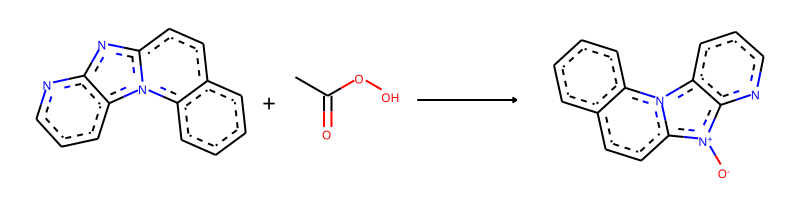

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)OO>>[O-][n+]1c2ncccc2n2c3ccccc3ccc21


--------------------------------------------------

Train index: 86432
RANK 28 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


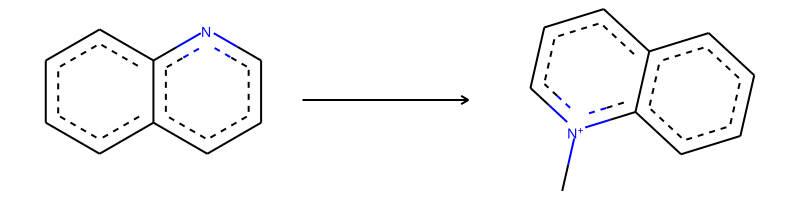

-> template: [c:2]:[n;H0;D2;+0:1]:[c:3]>>C-[n+;H0;D3:1](:[c:2]):[c:3]


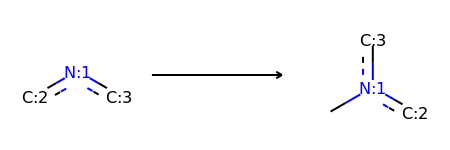

Product similarity 0.39344262295081966, overall 0.20785648004948964, smiles C[n+]1c2ncccc2n2c3ccccc3ccc21


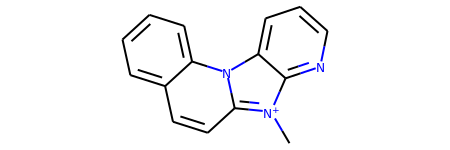

The proposed reaction is:


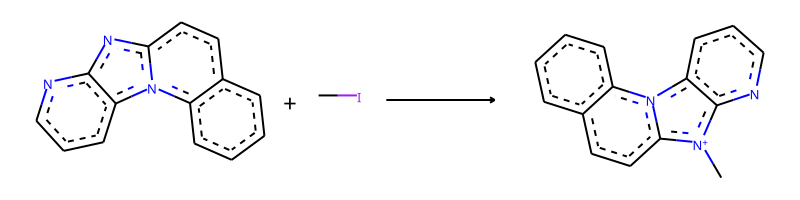

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CI>>C[n+]1c2ncccc2n2c3ccccc3ccc21
Product similarity 0.46551724137931033, overall 0.24593363695510734, smiles C[n+]1cccc2c1nc1ccc3ccccc3n12


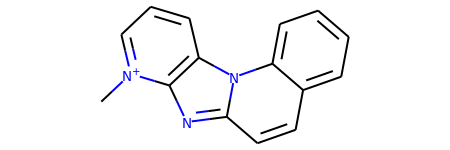

The proposed reaction is:


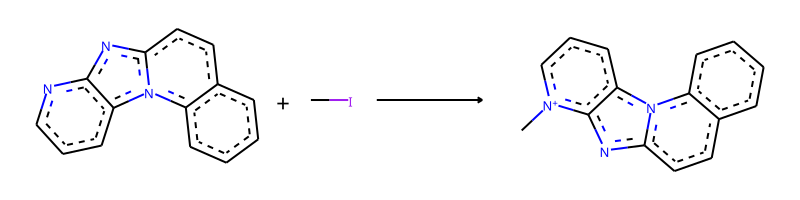

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CI>>C[n+]1cccc2c1nc1ccc3ccccc3n12


--------------------------------------------------

Train index: 475773
RANK 29 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


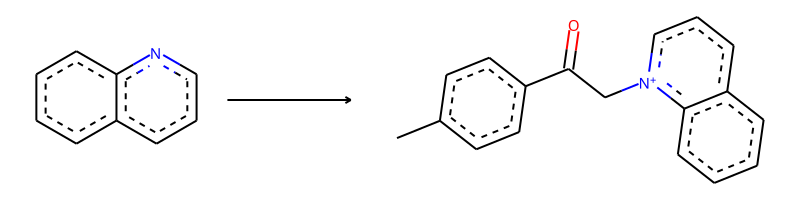

-> template: [c:2]:[n;H0;D2;+0:1]:[c:3]>>C-c1:c:c:c(-C(=O)-C-[n+;H0;D3:1](:[c:2]):[c:3]):c:c:1


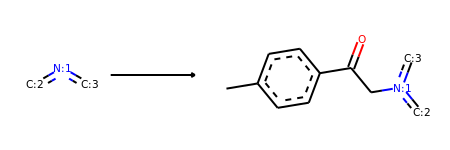

Product similarity 0.6309523809523809, overall 0.3333333333333333, smiles Cc1ccc(C(=O)C[n+]2cccc3c2nc2ccc4ccccc4n23)cc1


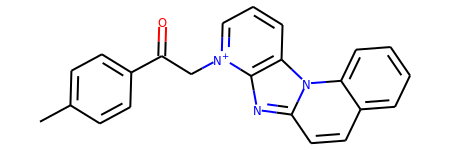

The proposed reaction is:


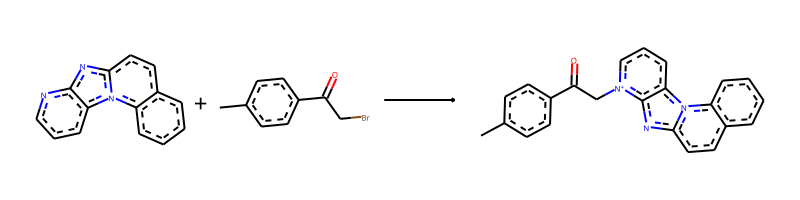

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Cc1ccc(C(=O)CBr)cc1>>Cc1ccc(C(=O)C[n+]2cccc3c2nc2ccc4ccccc4n23)cc1
Product similarity 0.5747126436781609, overall 0.30362177401865104, smiles Cc1ccc(C(=O)C[n+]2c3ncccc3n3c4ccccc4ccc32)cc1


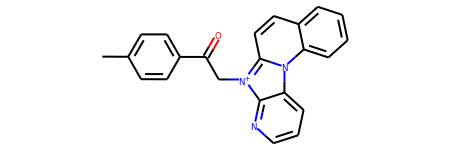

The proposed reaction is:


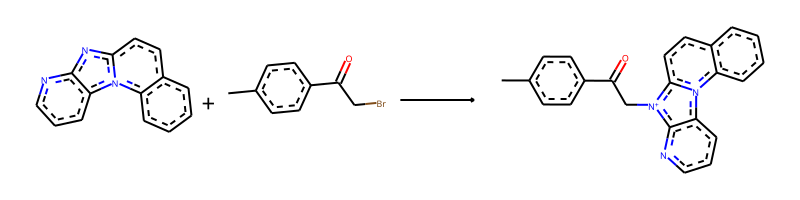

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Cc1ccc(C(=O)CBr)cc1>>Cc1ccc(C(=O)C[n+]2c3ncccc3n3c4ccccc4ccc32)cc1


--------------------------------------------------

Train index: 369707
RANK 30 PRECEDENT
REACTANT MATCH SCORE: 0.5283018867924528


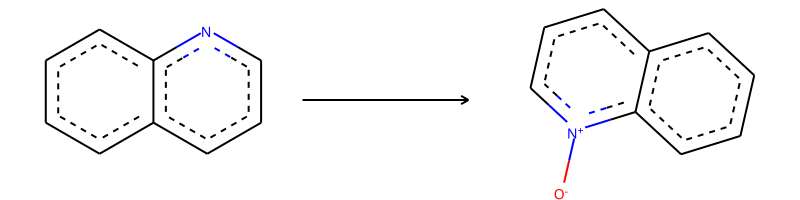

-> template: [c:2]:[n;H0;D2;+0:1]:[c:3]>>[O-]-[n+;H0;D3:1](:[c:2]):[c:3]


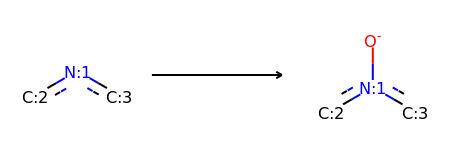

Product similarity 0.46551724137931033, overall 0.24593363695510734, smiles [O-][n+]1cccc2c1nc1ccc3ccccc3n12


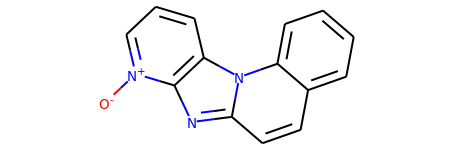

The proposed reaction is:


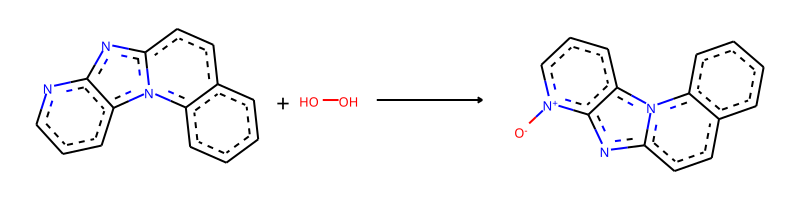

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.OO>>[O-][n+]1cccc2c1nc1ccc3ccccc3n12
Product similarity 0.39344262295081966, overall 0.20785648004948964, smiles [O-][n+]1c2ncccc2n2c3ccccc3ccc21


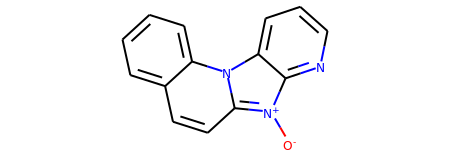

The proposed reaction is:


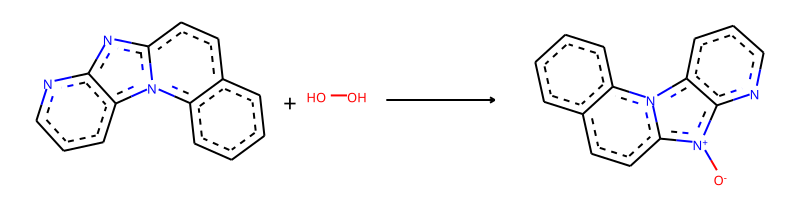

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.OO>>[O-][n+]1c2ncccc2n2c3ccccc3ccc21


--------------------------------------------------

Train index: 452507
RANK 31 PRECEDENT
REACTANT MATCH SCORE: 0.5277777777777778


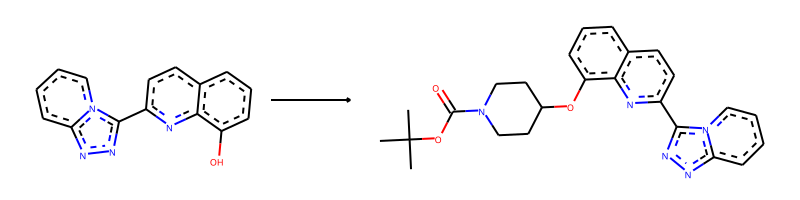

-> template: [#7;a:4]:[c:3]:[c:2]-[OH;D1;+0:1]>>C-C(-C)(-C)-O-C(=O)-N1-C-C-C(-[O;H0;D2;+0:1]-[c:2]:[c:3]:[#7;a:4])-C-C-1


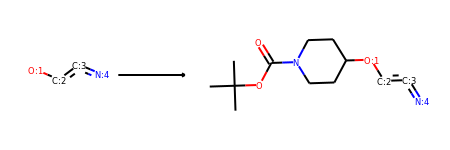

->No precursors could be generated!


--------------------------------------------------

Train index: 282478
RANK 32 PRECEDENT
REACTANT MATCH SCORE: 0.5277777777777778


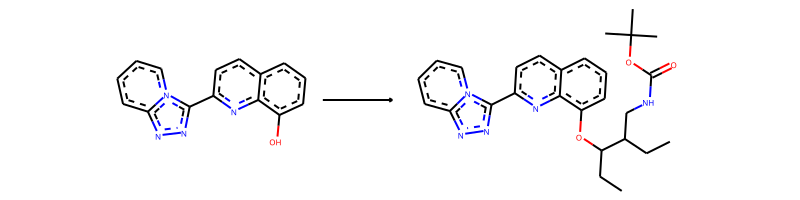

-> template: [#7;a:4]:[c:3]:[c:2]-[OH;D1;+0:1]>>C-C-C(-C-N-C(=O)-O-C(-C)(-C)-C)-C(-C-C)-[O;H0;D2;+0:1]-[c:2]:[c:3]:[#7;a:4]


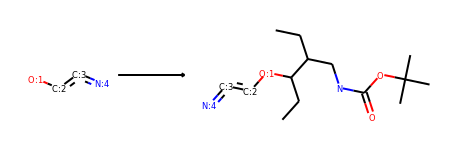

->No precursors could be generated!


--------------------------------------------------

Train index: 156628
RANK 33 PRECEDENT
REACTANT MATCH SCORE: 0.5277777777777778


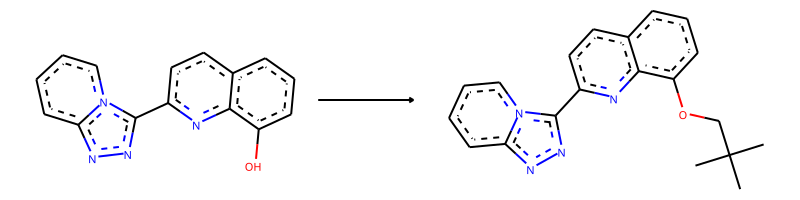

-> template: [#7;a:4]:[c:3]:[c:2]-[OH;D1;+0:1]>>C-C(-C)(-C)-C-[O;H0;D2;+0:1]-[c:2]:[c:3]:[#7;a:4]


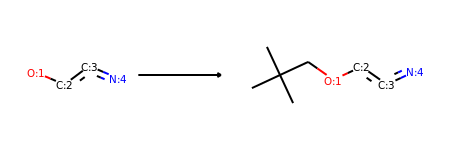

->No precursors could be generated!


--------------------------------------------------

Train index: 256576
RANK 34 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


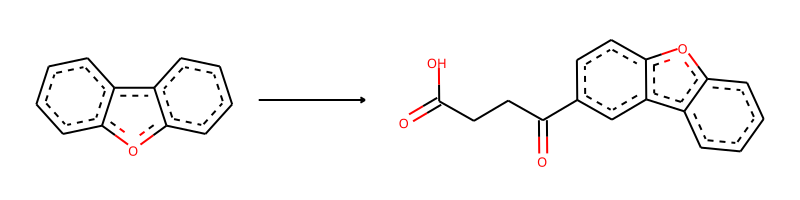

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O-C(=O)-C-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


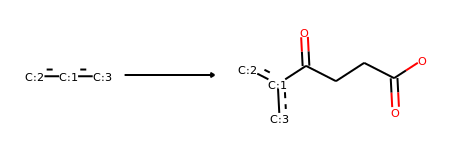

Product similarity 0.5949367088607594, overall 0.3125938639776872, smiles O=C(O)CCC(=O)c1ccc2ccc3nc4ncccc4n3c2c1


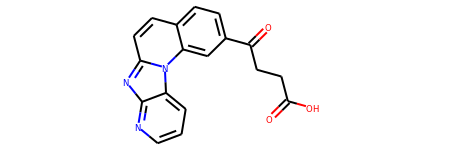

The proposed reaction is:


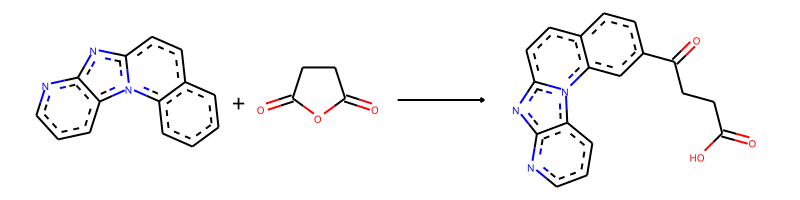

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1ccc2ccc3nc4ncccc4n3c2c1
Product similarity 0.5949367088607594, overall 0.3125938639776872, smiles O=C(O)CCC(=O)c1ccnc2nc3ccc4ccccc4n3c12


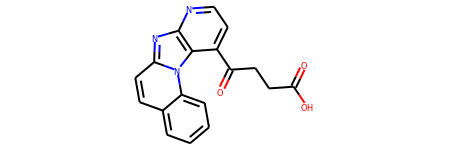

The proposed reaction is:


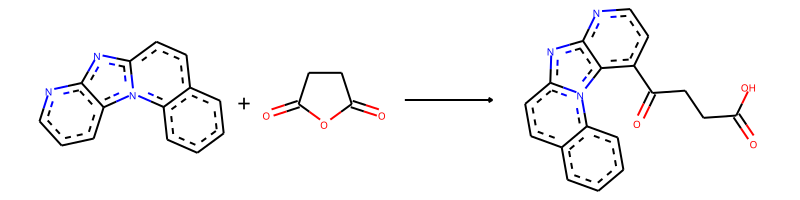

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.6363636363636364, overall 0.3343605546995378, smiles O=C(O)CCC(=O)c1cc2ccccc2n2c1nc1ncccc12


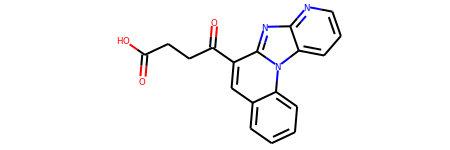

The proposed reaction is:


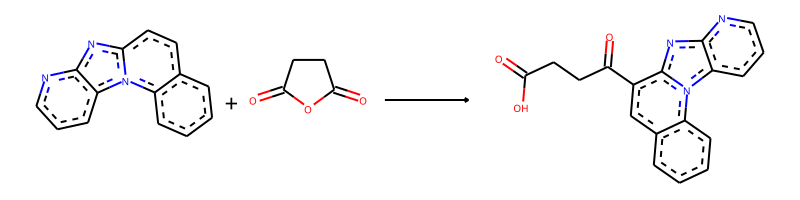

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.6153846153846154, overall 0.3233376792698827, smiles O=C(O)CCC(=O)c1cccc2c1ccc1nc3ncccc3n12


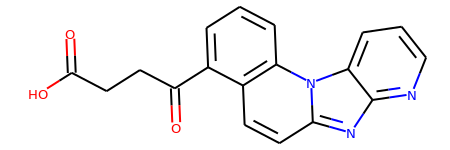

The proposed reaction is:


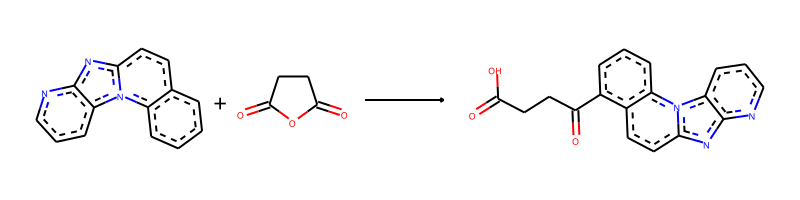

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1cccc2c1ccc1nc3ncccc3n12
Product similarity 0.6363636363636364, overall 0.3343605546995378, smiles O=C(O)CCC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1


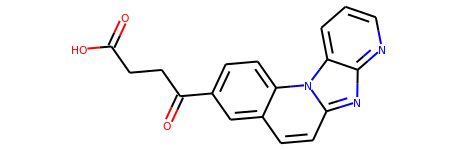

The proposed reaction is:


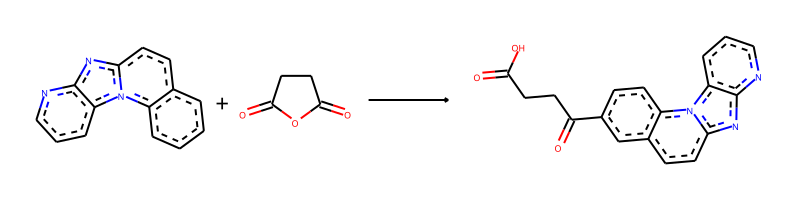

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1
Product similarity 0.6153846153846154, overall 0.3233376792698827, smiles O=C(O)CCC(=O)c1cc2nc3ncccc3n2c2ccccc12


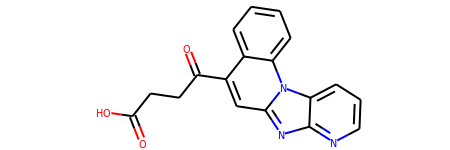

The proposed reaction is:


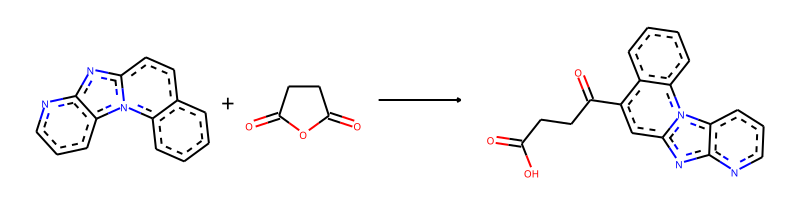

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.5949367088607594, overall 0.3125938639776872, smiles O=C(O)CCC(=O)c1cnc2nc3ccc4ccccc4n3c2c1


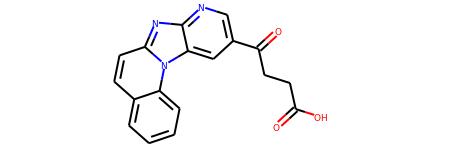

The proposed reaction is:


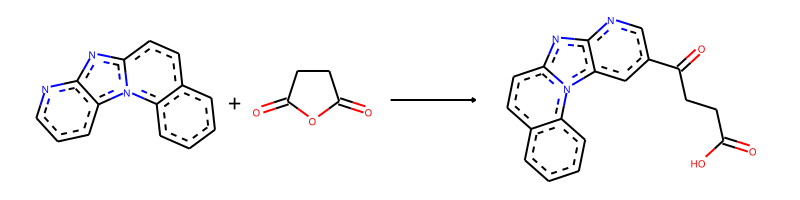

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.5949367088607594, overall 0.3125938639776872, smiles O=C(O)CCC(=O)c1cccc2ccc3nc4ncccc4n3c12


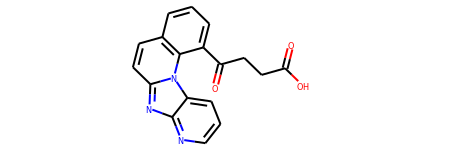

The proposed reaction is:


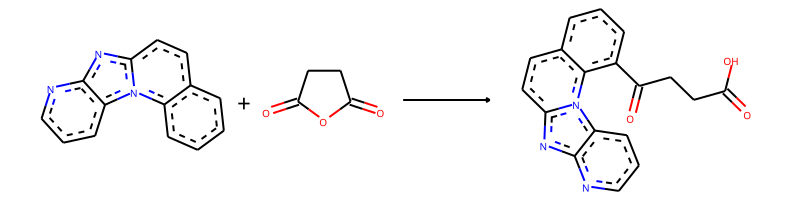

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)O1>>O=C(O)CCC(=O)c1cccc2ccc3nc4ncccc4n3c12


--------------------------------------------------

Train index: 126321
RANK 35 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


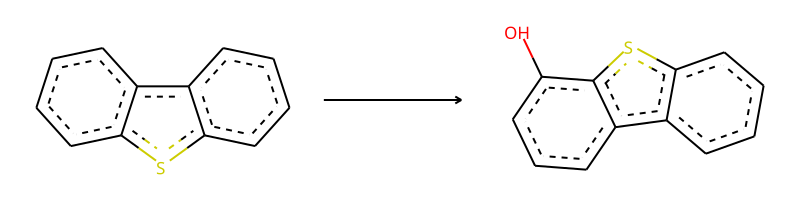

-> template: [#16;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#16;a:4]


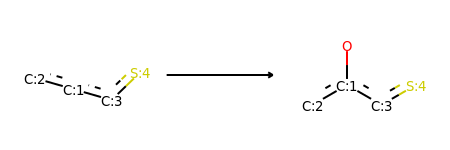

->No precursors could be generated!


--------------------------------------------------

Train index: 429291
RANK 36 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


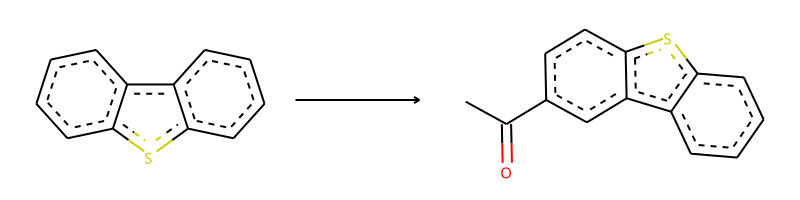

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


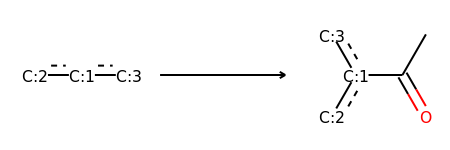

Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1ccc2ccc3nc4ncccc4n3c2c1


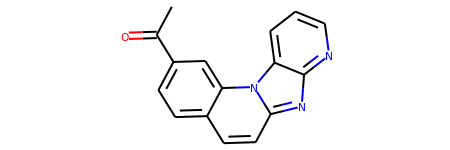

The proposed reaction is:


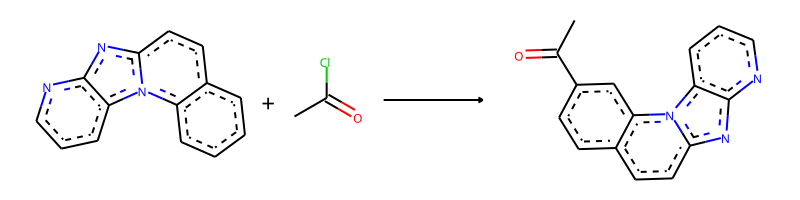

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccc2ccc3nc4ncccc4n3c2c1
Product similarity 0.5522388059701493, overall 0.29015937262838354, smiles CC(=O)c1cc2nc3ncccc3n2c2ccccc12


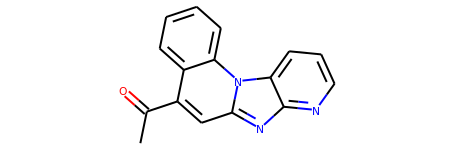

The proposed reaction is:


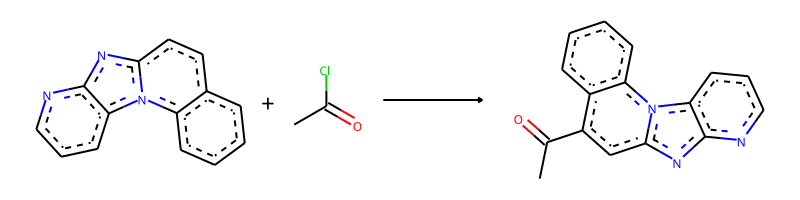

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1cnc2nc3ccc4ccccc4n3c2c1


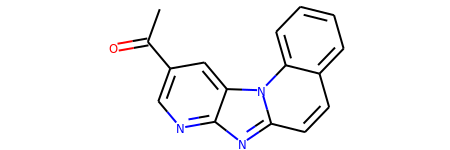

The proposed reaction is:


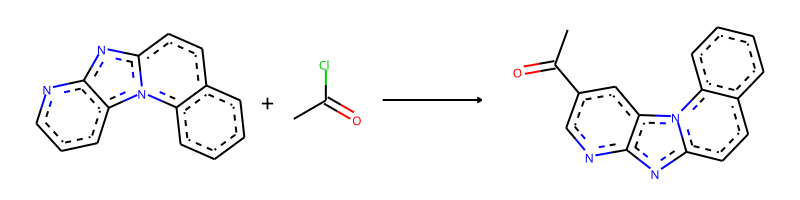

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.5757575757575758, overall 0.30251669234720086, smiles CC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1


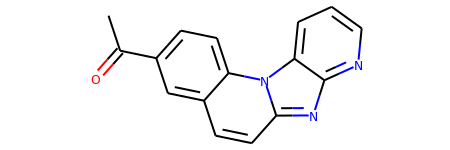

The proposed reaction is:


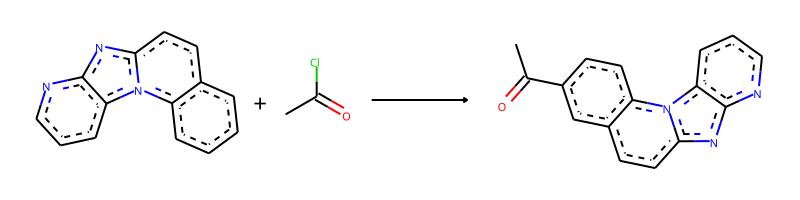

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1
Product similarity 0.5757575757575758, overall 0.30251669234720086, smiles CC(=O)c1cc2ccccc2n2c1nc1ncccc12


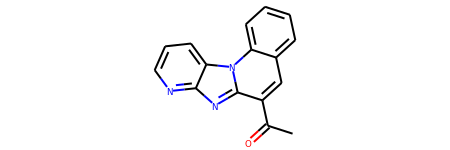

The proposed reaction is:


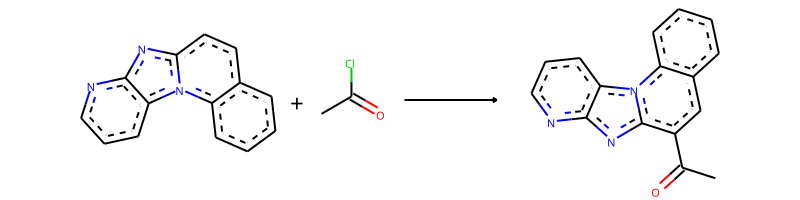

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1ccnc2nc3ccc4ccccc4n3c12


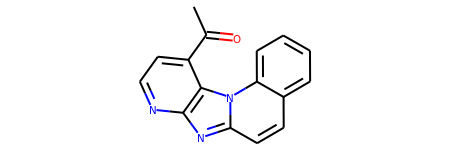

The proposed reaction is:


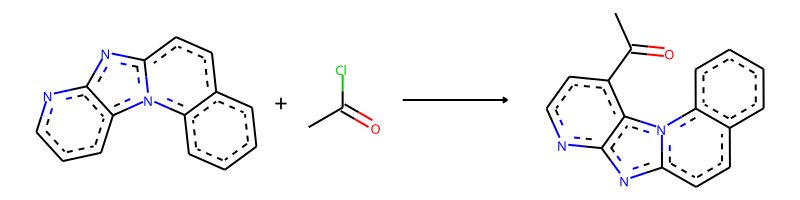

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.5522388059701493, overall 0.29015937262838354, smiles CC(=O)c1cccc2c1ccc1nc3ncccc3n12


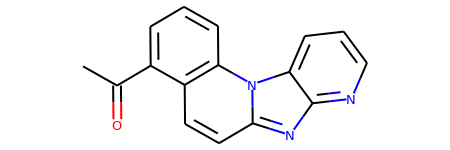

The proposed reaction is:


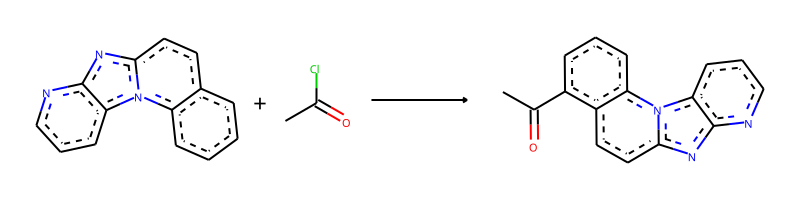

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cccc2c1ccc1nc3ncccc3n12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1cccc2ccc3nc4ncccc4n3c12


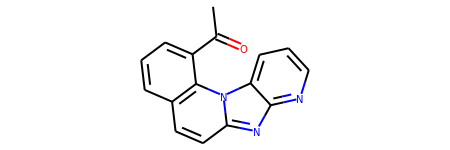

The proposed reaction is:


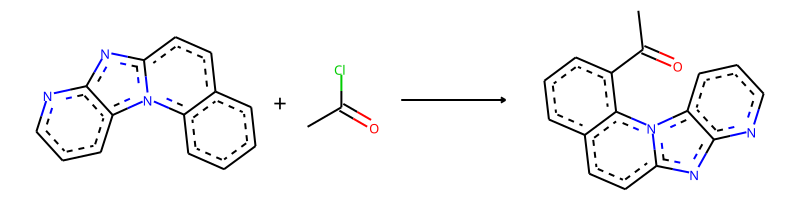

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cccc2ccc3nc4ncccc4n3c12


--------------------------------------------------

Train index: 144594
RANK 37 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


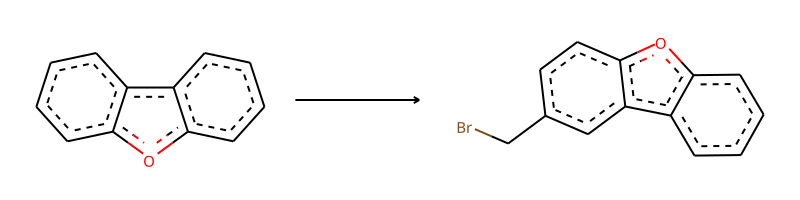

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>Br-C-[c;H0;D3;+0:1](:[c:2]):[c:3]


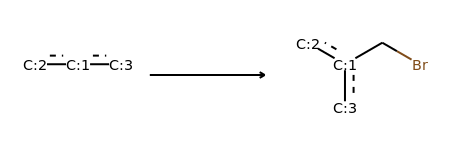

Product similarity 0.5625, overall 0.29555084745762716, smiles BrCc1cc2ccccc2n2c1nc1ncccc12


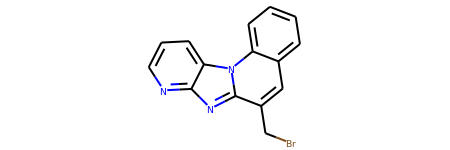

The proposed reaction is:


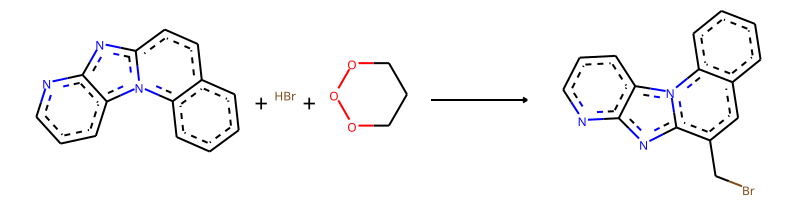

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.5625, overall 0.29555084745762716, smiles BrCc1ccc2c(ccc3nc4ncccc4n32)c1


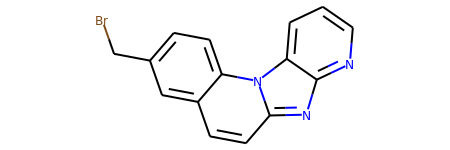

The proposed reaction is:


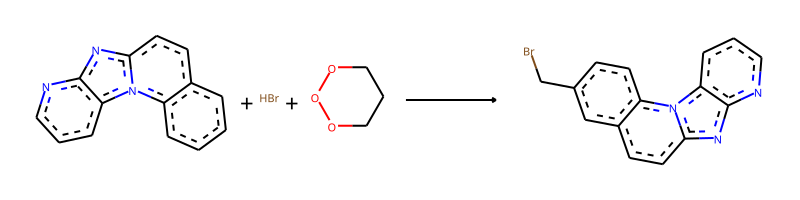

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1ccc2c(ccc3nc4ncccc4n32)c1
Product similarity 0.5151515151515151, overall 0.2706728299948639, smiles BrCc1ccc2ccc3nc4ncccc4n3c2c1


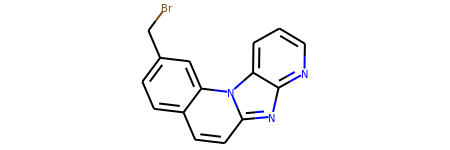

The proposed reaction is:


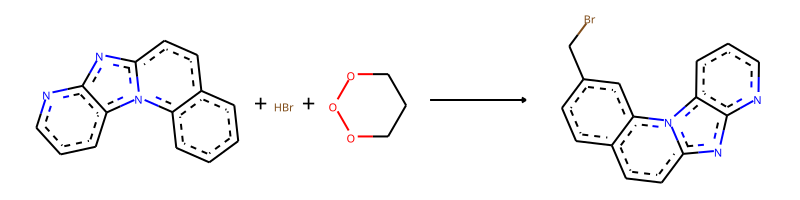

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1ccc2ccc3nc4ncccc4n3c2c1
Product similarity 0.5384615384615384, overall 0.28292046936114734, smiles BrCc1cccc2c1ccc1nc3ncccc3n12


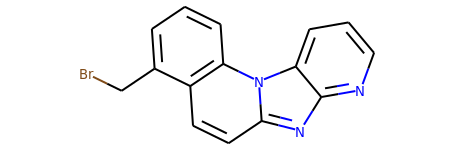

The proposed reaction is:


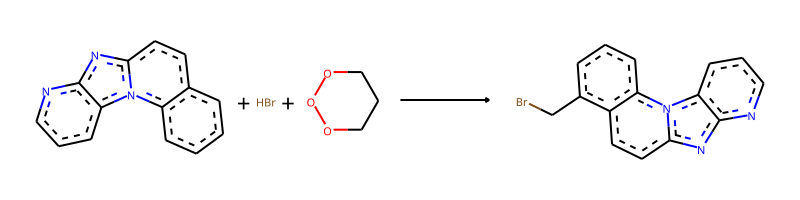

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1cccc2c1ccc1nc3ncccc3n12
Product similarity 0.5384615384615384, overall 0.28292046936114734, smiles BrCc1cc2nc3ncccc3n2c2ccccc12


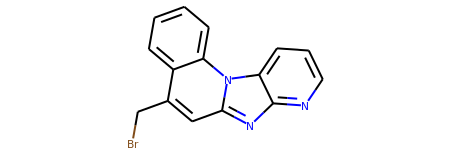

The proposed reaction is:


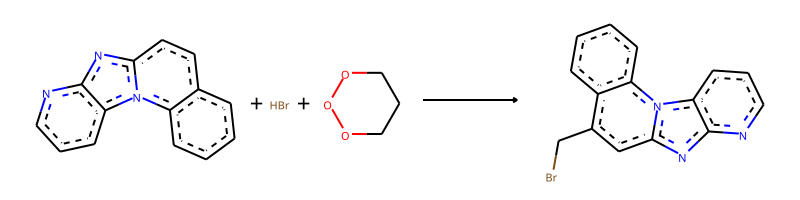

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.5151515151515151, overall 0.2706728299948639, smiles BrCc1cnc2nc3ccc4ccccc4n3c2c1


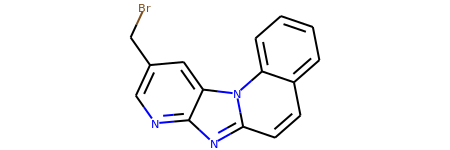

The proposed reaction is:


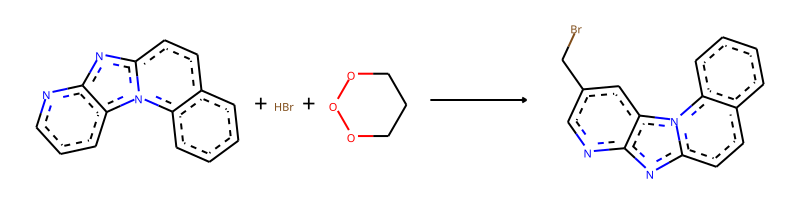

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.5151515151515151, overall 0.2706728299948639, smiles BrCc1cccc2ccc3nc4ncccc4n3c12


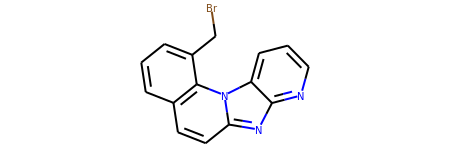

The proposed reaction is:


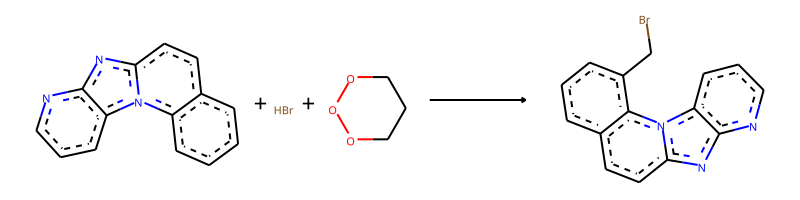

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1cccc2ccc3nc4ncccc4n3c12
Product similarity 0.5151515151515151, overall 0.2706728299948639, smiles BrCc1ccnc2nc3ccc4ccccc4n3c12


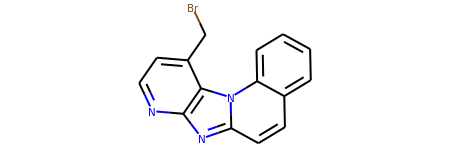

The proposed reaction is:


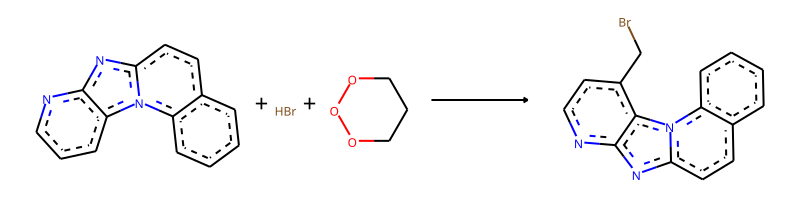

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.Br.C1COOOC1>>BrCc1ccnc2nc3ccc4ccccc4n3c12


--------------------------------------------------

Train index: 307904
RANK 38 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


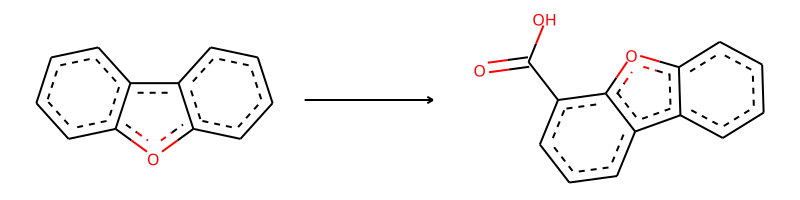

-> template: [#8;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#8;a:4]


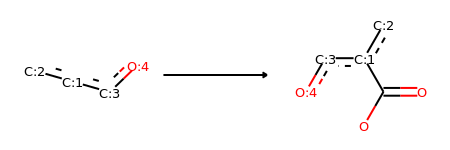

->No precursors could be generated!


--------------------------------------------------

Train index: 129917
RANK 39 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


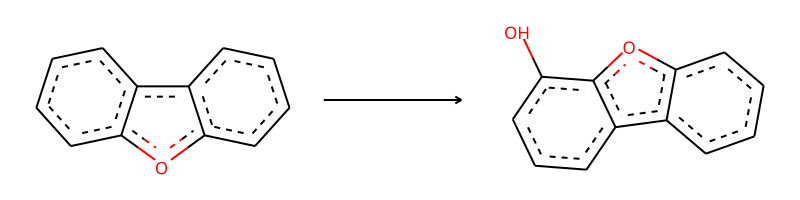

-> template: [#8;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#8;a:4]


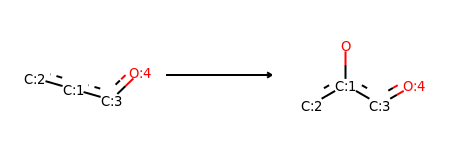

->No precursors could be generated!


--------------------------------------------------

Train index: 268438
RANK 40 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


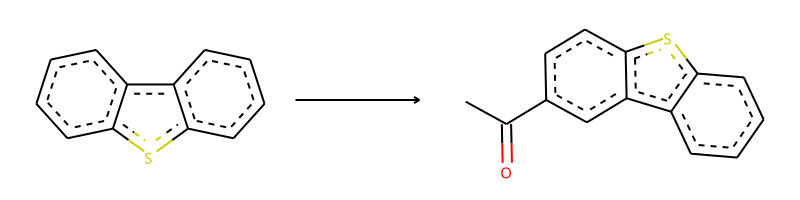

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


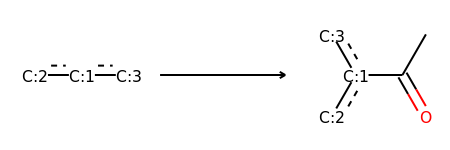

Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1ccc2ccc3nc4ncccc4n3c2c1


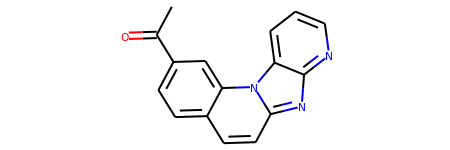

The proposed reaction is:


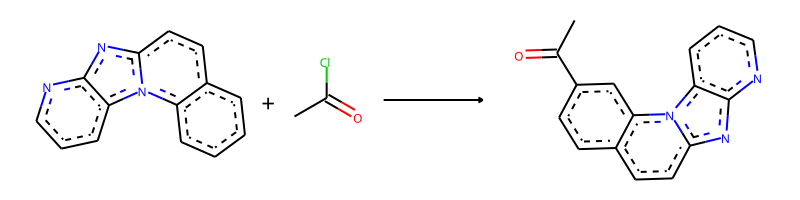

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccc2ccc3nc4ncccc4n3c2c1
Product similarity 0.5522388059701493, overall 0.29015937262838354, smiles CC(=O)c1cc2nc3ncccc3n2c2ccccc12


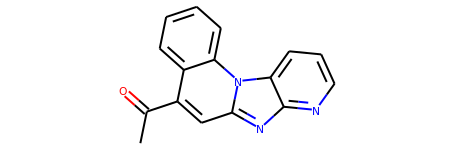

The proposed reaction is:


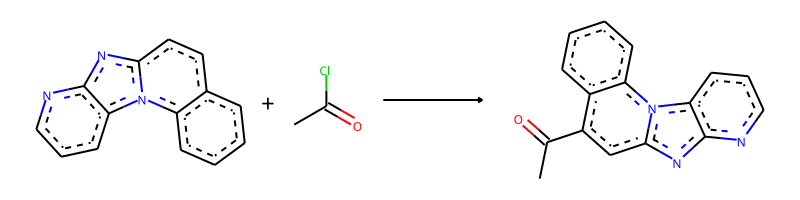

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1cnc2nc3ccc4ccccc4n3c2c1


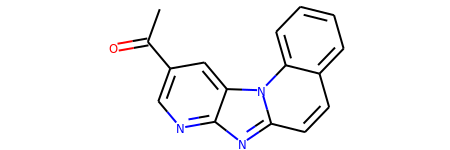

The proposed reaction is:


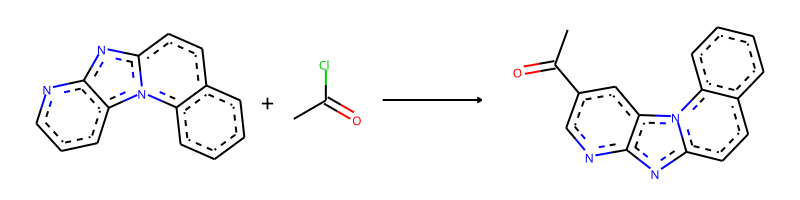

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.5757575757575758, overall 0.30251669234720086, smiles CC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1


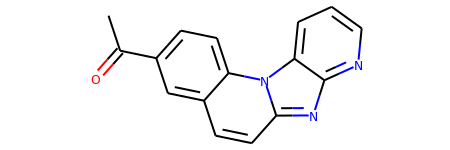

The proposed reaction is:


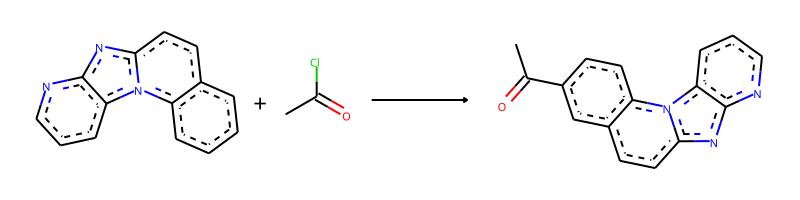

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1
Product similarity 0.5757575757575758, overall 0.30251669234720086, smiles CC(=O)c1cc2ccccc2n2c1nc1ncccc12


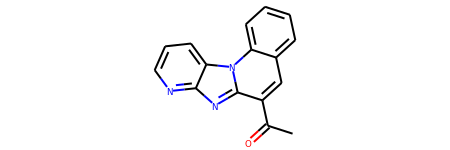

The proposed reaction is:


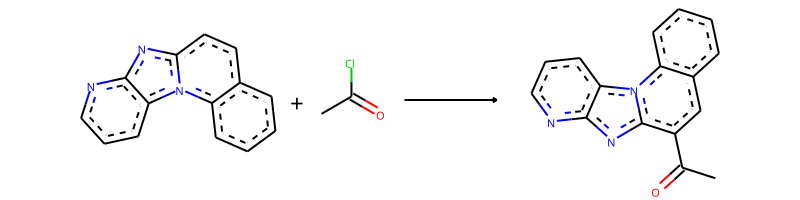

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1ccnc2nc3ccc4ccccc4n3c12


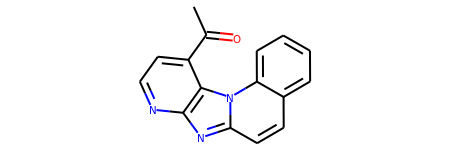

The proposed reaction is:


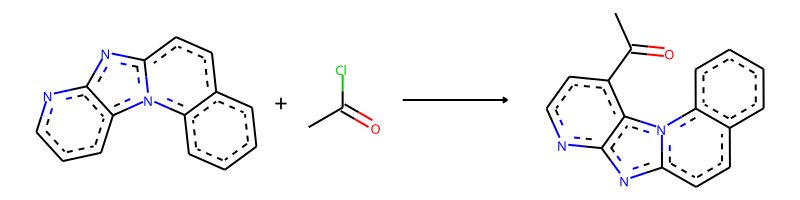

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.5522388059701493, overall 0.29015937262838354, smiles CC(=O)c1cccc2c1ccc1nc3ncccc3n12


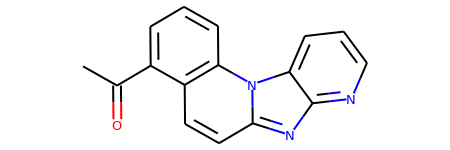

The proposed reaction is:


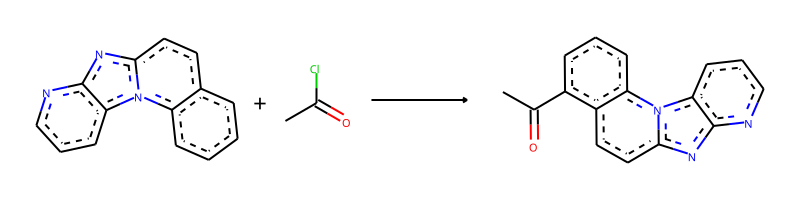

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cccc2c1ccc1nc3ncccc3n12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1cccc2ccc3nc4ncccc4n3c12


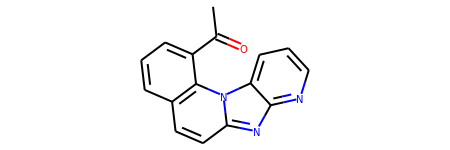

The proposed reaction is:


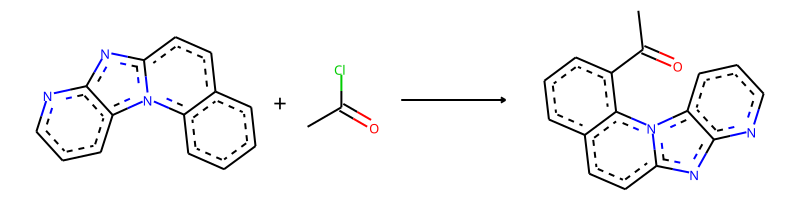

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cccc2ccc3nc4ncccc4n3c12


--------------------------------------------------

Train index: 163554
RANK 41 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


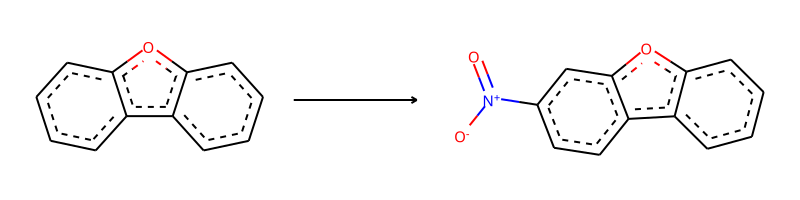

-> template: [#8;a:5]:[c:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O=[N+](-[O-])-[c;H0;D3;+0:1](:[c:2]):[c:3]:[c:4]:[#8;a:5]


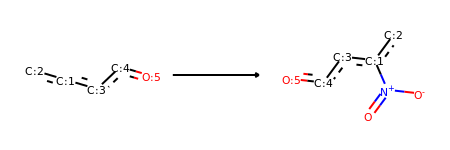

->No precursors could be generated!


--------------------------------------------------

Train index: 458086
RANK 42 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


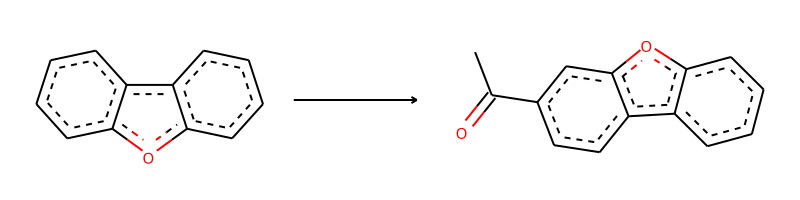

-> template: [#8;a:5]:[c:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]:[c:4]:[#8;a:5]


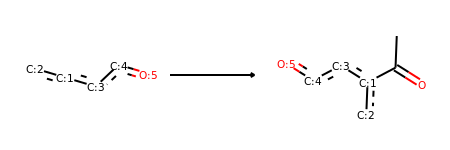

->No precursors could be generated!


--------------------------------------------------

Train index: 279708
RANK 43 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


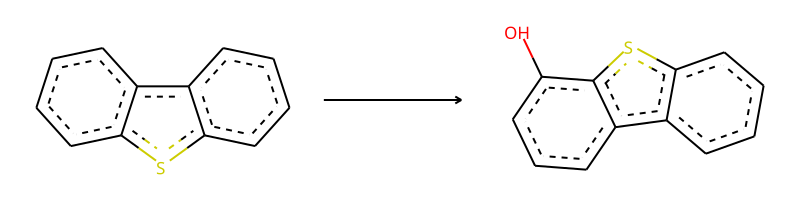

-> template: [#16;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#16;a:4]


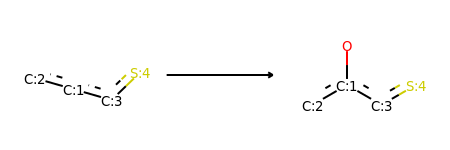

->No precursors could be generated!


--------------------------------------------------

Train index: 368668
RANK 44 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


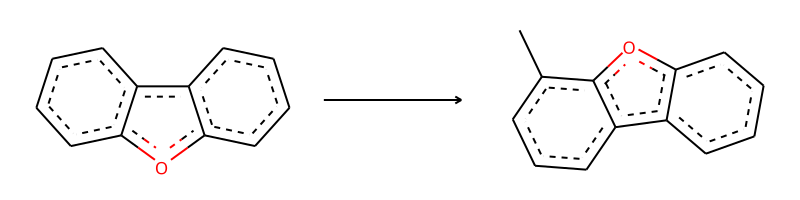

-> template: [#8;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>C-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#8;a:4]


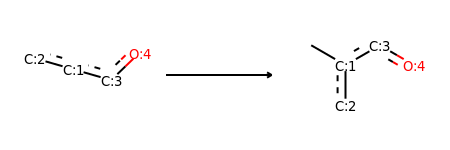

->No precursors could be generated!


--------------------------------------------------

Train index: 236782
RANK 45 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


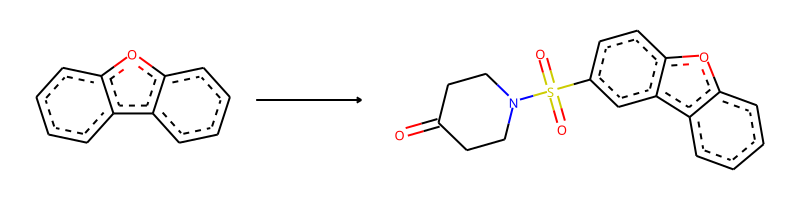

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>O=C1-C-C-N(-S(=O)(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3])-C-C-1


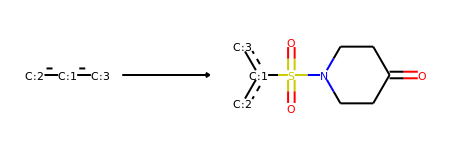

Product similarity 0.6363636363636364, overall 0.3343605546995378, smiles O=C1CCN(S(=O)(=O)c2ccc3ccc4nc5ncccc5n4c3c2)CC1


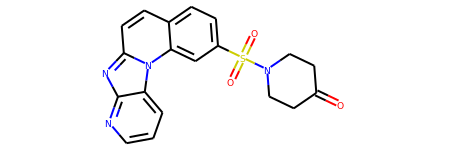

The proposed reaction is:


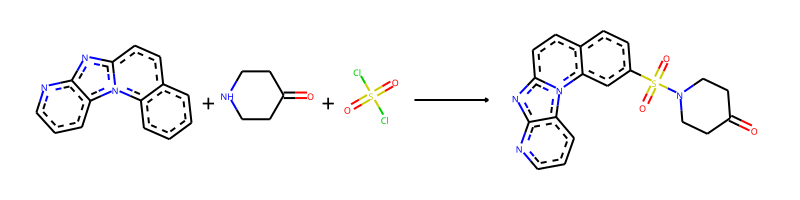

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2ccc3ccc4nc5ncccc5n4c3c2)CC1
Product similarity 0.6363636363636364, overall 0.3343605546995378, smiles O=C1CCN(S(=O)(=O)c2cccc3ccc4nc5ncccc5n4c23)CC1


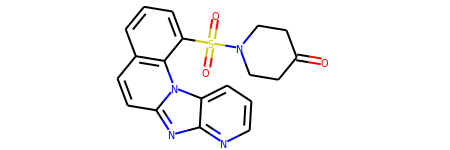

The proposed reaction is:


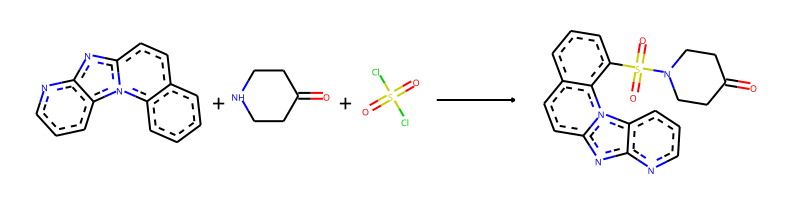

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2cccc3ccc4nc5ncccc5n4c23)CC1
Product similarity 0.6363636363636364, overall 0.3343605546995378, smiles O=C1CCN(S(=O)(=O)c2ccnc3nc4ccc5ccccc5n4c23)CC1


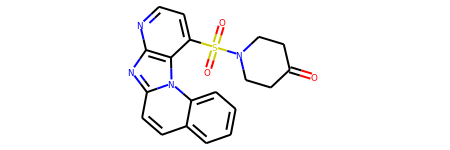

The proposed reaction is:


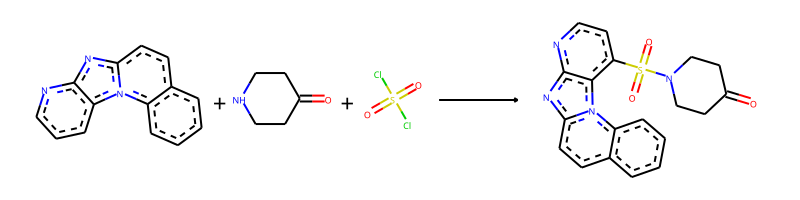

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2ccnc3nc4ccc5ccccc5n4c23)CC1
Product similarity 0.6744186046511628, overall 0.35435553803705166, smiles O=C1CCN(S(=O)(=O)c2cc3ccccc3n3c2nc2ncccc23)CC1


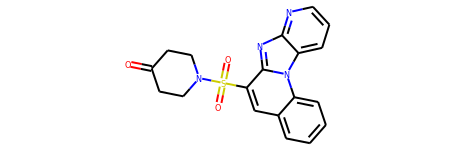

The proposed reaction is:


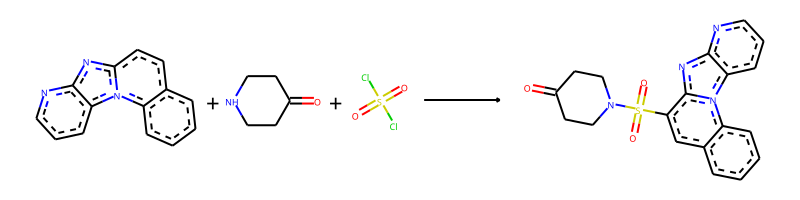

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2cc3ccccc3n3c2nc2ncccc23)CC1
Product similarity 0.6551724137931034, overall 0.3442431326709527, smiles O=C1CCN(S(=O)(=O)c2cccc3c2ccc2nc4ncccc4n23)CC1


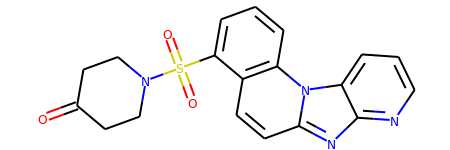

The proposed reaction is:


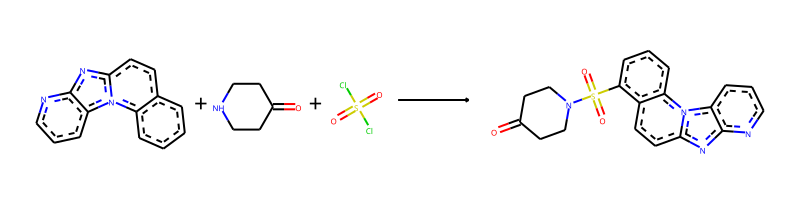

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2cccc3c2ccc2nc4ncccc4n23)CC1
Product similarity 0.6551724137931034, overall 0.3442431326709527, smiles O=C1CCN(S(=O)(=O)c2cc3nc4ncccc4n3c3ccccc23)CC1


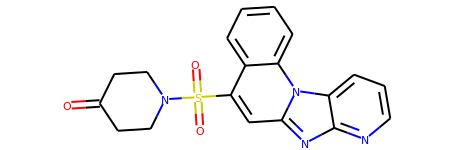

The proposed reaction is:


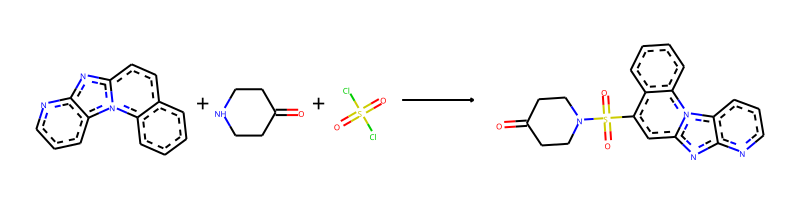

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2cc3nc4ncccc4n3c3ccccc23)CC1
Product similarity 0.6363636363636364, overall 0.3343605546995378, smiles O=C1CCN(S(=O)(=O)c2cnc3nc4ccc5ccccc5n4c3c2)CC1


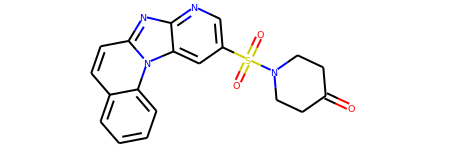

The proposed reaction is:


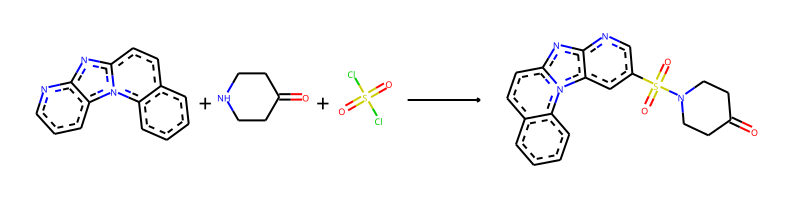

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2cnc3nc4ccc5ccccc5n4c3c2)CC1
Product similarity 0.6744186046511628, overall 0.35435553803705166, smiles O=C1CCN(S(=O)(=O)c2ccc3c(ccc4nc5ncccc5n43)c2)CC1


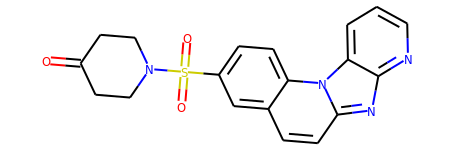

The proposed reaction is:


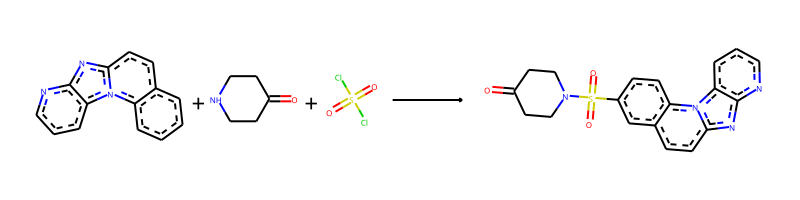

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCNCC1.O=S(=O)(Cl)Cl>>O=C1CCN(S(=O)(=O)c2ccc3c(ccc4nc5ncccc5n43)c2)CC1


--------------------------------------------------

Train index: 442316
RANK 46 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


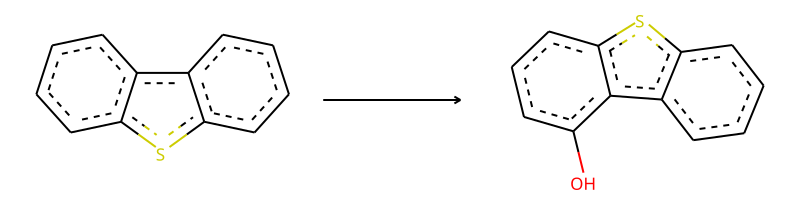

-> template: [#16;a:5]:[c:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O-[c;H0;D3;+0:1](:[c:2]):[c:3]:[c:4]:[#16;a:5]


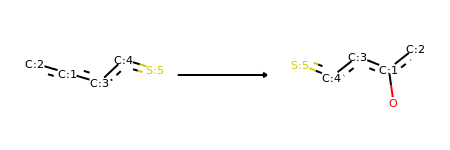

->No precursors could be generated!


--------------------------------------------------

Train index: 273776
RANK 47 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


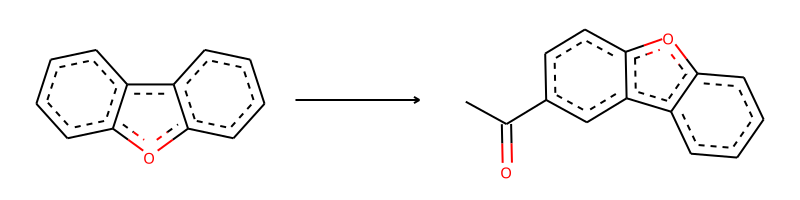

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]


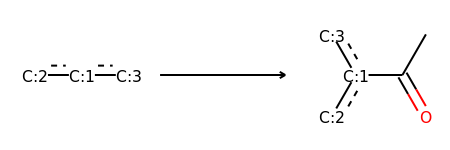

Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1ccc2ccc3nc4ncccc4n3c2c1


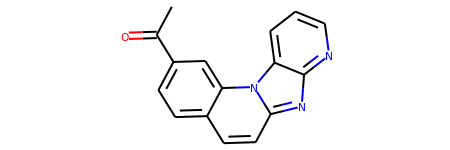

The proposed reaction is:


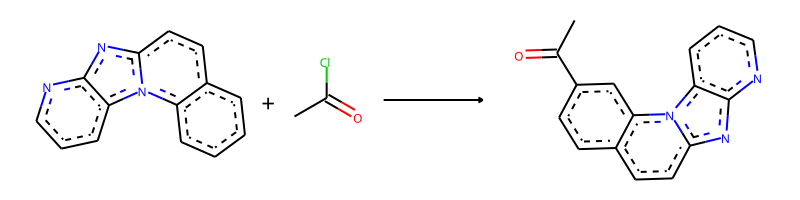

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccc2ccc3nc4ncccc4n3c2c1
Product similarity 0.5522388059701493, overall 0.29015937262838354, smiles CC(=O)c1cc2nc3ncccc3n2c2ccccc12


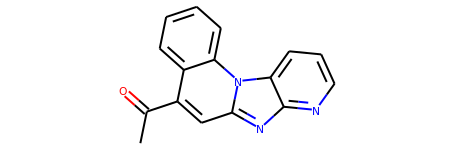

The proposed reaction is:


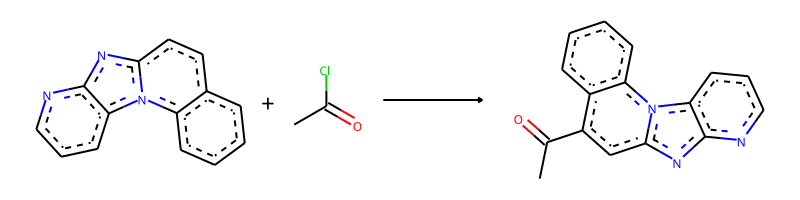

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1cnc2nc3ccc4ccccc4n3c2c1


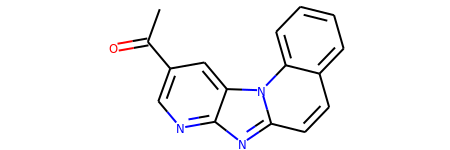

The proposed reaction is:


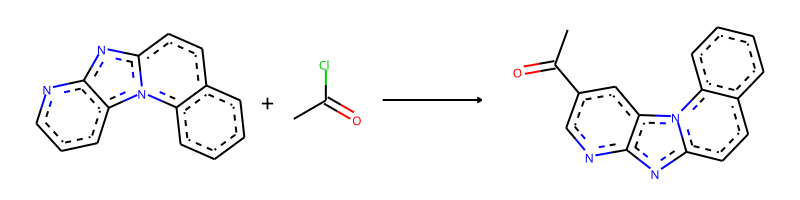

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.5757575757575758, overall 0.30251669234720086, smiles CC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1


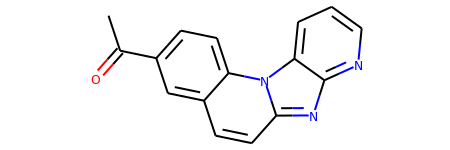

The proposed reaction is:


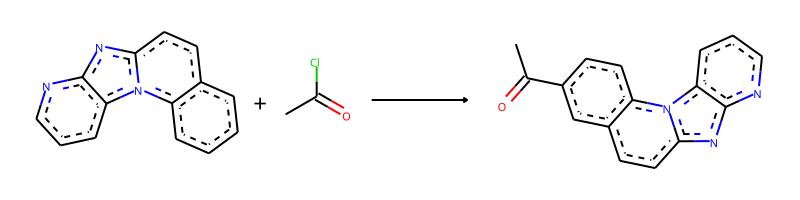

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccc2c(ccc3nc4ncccc4n32)c1
Product similarity 0.5757575757575758, overall 0.30251669234720086, smiles CC(=O)c1cc2ccccc2n2c1nc1ncccc12


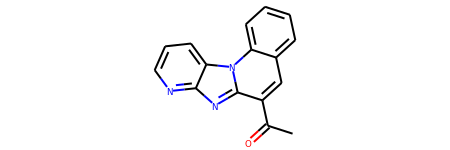

The proposed reaction is:


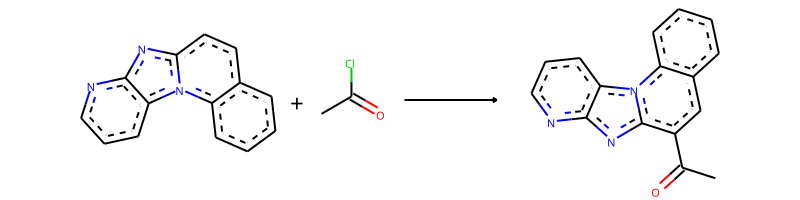

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1ccnc2nc3ccc4ccccc4n3c12


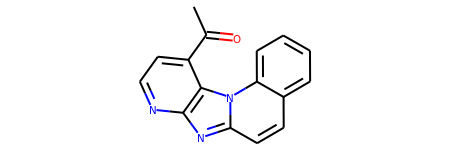

The proposed reaction is:


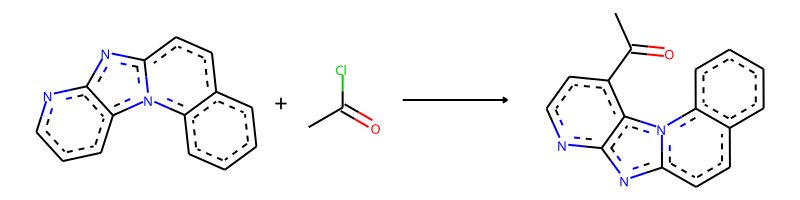

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.5522388059701493, overall 0.29015937262838354, smiles CC(=O)c1cccc2c1ccc1nc3ncccc3n12


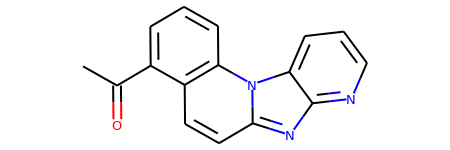

The proposed reaction is:


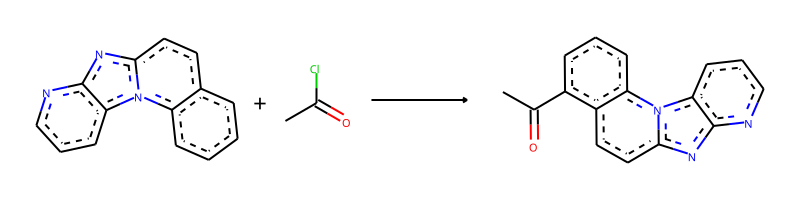

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cccc2c1ccc1nc3ncccc3n12
Product similarity 0.5294117647058824, overall 0.27816550348953145, smiles CC(=O)c1cccc2ccc3nc4ncccc4n3c12


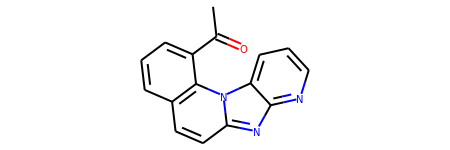

The proposed reaction is:


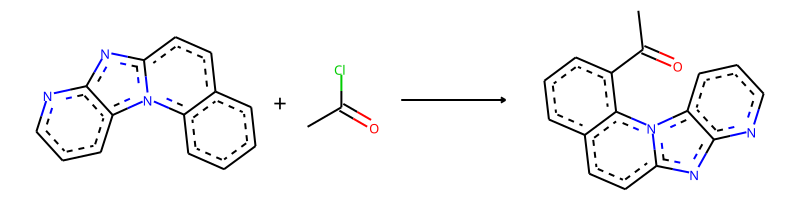

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)Cl>>CC(=O)c1cccc2ccc3nc4ncccc4n3c12


--------------------------------------------------

Train index: 189818
RANK 48 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


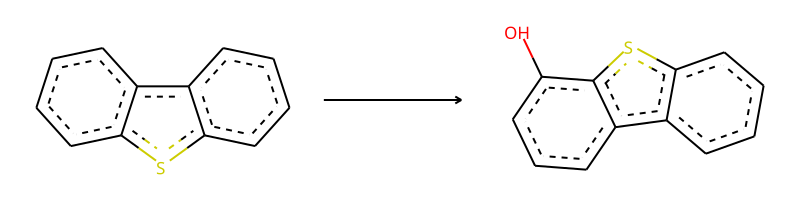

-> template: [#16;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#16;a:4]


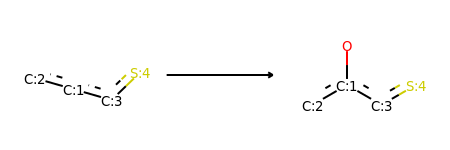

->No precursors could be generated!


--------------------------------------------------

Train index: 170873
RANK 49 PRECEDENT
REACTANT MATCH SCORE: 0.5254237288135594


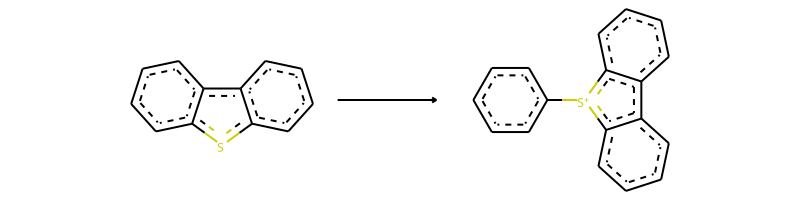

-> template: [c:1]:[s;H0;D2;+0:2]:[c:3]>>[c:1]:[s+;H0;D3:2](:[c:3])-c1:c:c:c:c:c:1


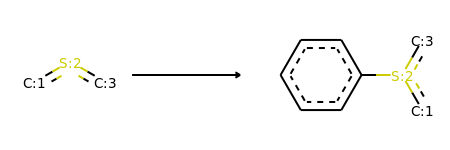

->No precursors could be generated!


--------------------------------------------------

Train index: 275323
RANK 50 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


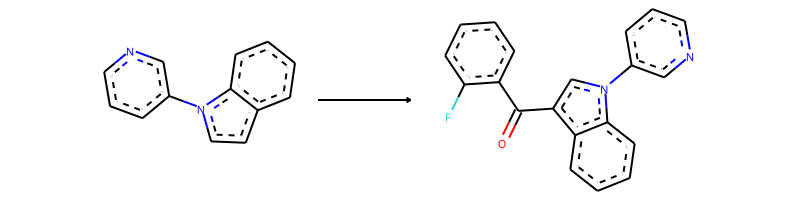

-> template: [#7;a:3]1:[c:2]:[cH;D2;+0:1]:[c:5]:[c:4]:1>>F-c1:c:c:c:c:c:1-C(=O)-[c;H0;D3;+0:1]1:[c:2]:[#7;a:3]:[c:4]:[c:5]:1


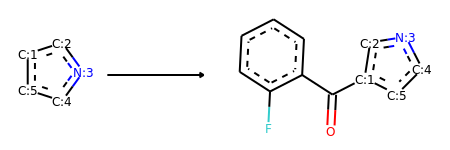

->No precursors could be generated!


--------------------------------------------------

Train index: 460320
RANK 51 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


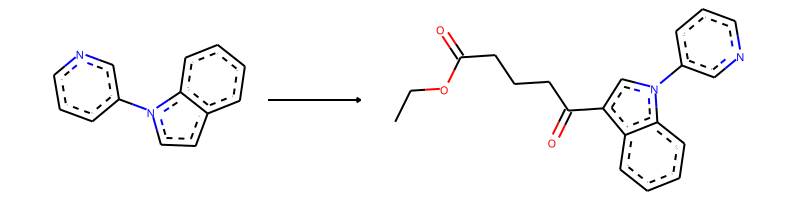

-> template: [#7;a:4]1:[c:3]:[c:2]:[cH;D2;+0:1]:[c:5]:1>>C-C-O-C(=O)-C-C-C-C(=O)-[c;H0;D3;+0:1]1:[c:2]:[c:3]:[#7;a:4]:[c:5]:1


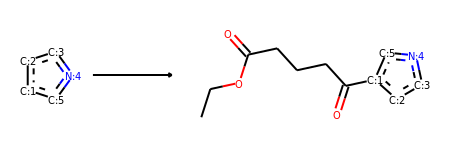

->No precursors could be generated!


--------------------------------------------------

Train index: 155557
RANK 52 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


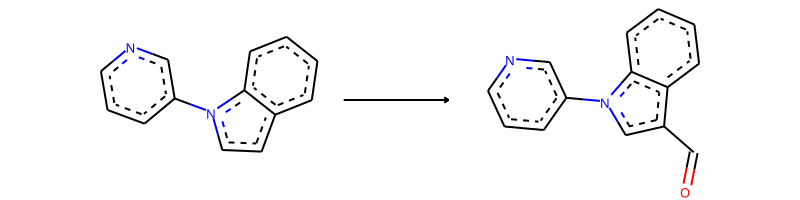

-> template: [#7;a:3]1:[c:2]:[cH;D2;+0:1]:[c:5]:[c:4]:1>>O=C-[c;H0;D3;+0:1]1:[c:2]:[#7;a:3]:[c:4]:[c:5]:1


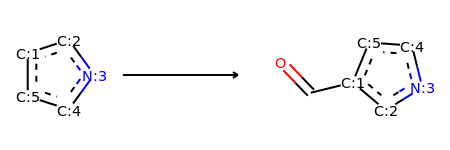

->No precursors could be generated!


--------------------------------------------------

Train index: 476002
RANK 53 PRECEDENT
REACTANT MATCH SCORE: 0.5238095238095238


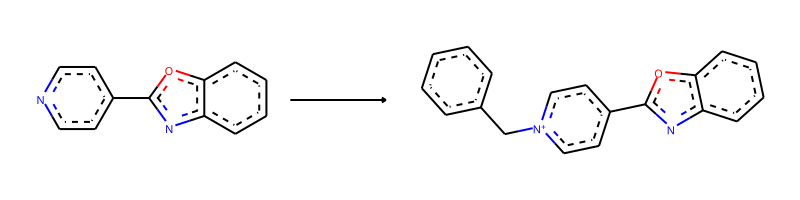

-> template: [c:1]:[n;H0;D2;+0:2]:[c:3]>>[c:1]:[n+;H0;D3:2](:[c:3])-C-c1:c:c:c:c:c:1


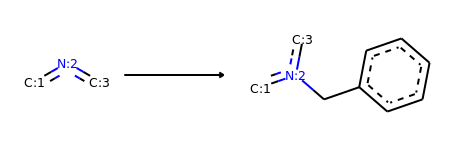

Product similarity 0.6428571428571429, overall 0.33673469387755106, smiles c1ccc(C[n+]2cccc3c2nc2ccc4ccccc4n23)cc1


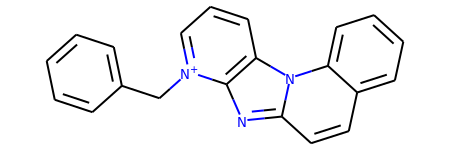

The proposed reaction is:


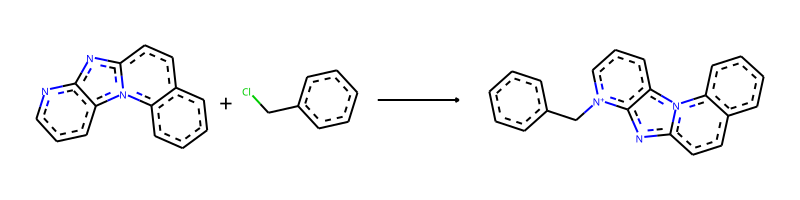

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.ClCc1ccccc1>>c1ccc(C[n+]2cccc3c2nc2ccc4ccccc4n23)cc1
Product similarity 0.6046511627906976, overall 0.3167220376522702, smiles c1ccc(C[n+]2c3ncccc3n3c4ccccc4ccc32)cc1


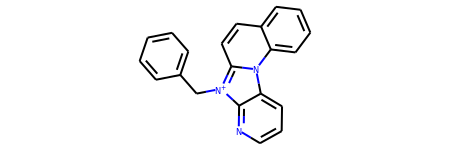

The proposed reaction is:


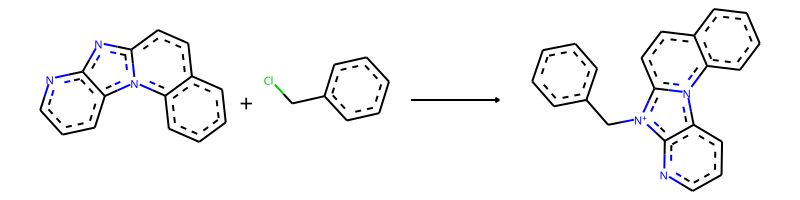

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.ClCc1ccccc1>>c1ccc(C[n+]2c3ncccc3n3c4ccccc4ccc32)cc1


--------------------------------------------------

Train index: 402123
RANK 54 PRECEDENT
REACTANT MATCH SCORE: 0.5230769230769231


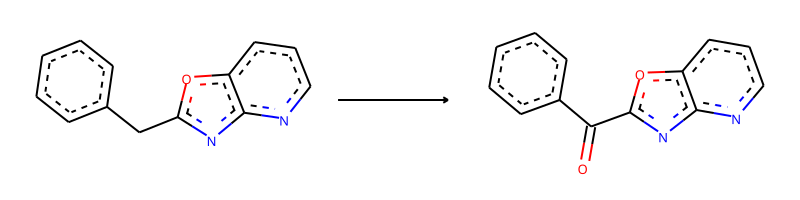

-> template: [#7;a:4]:[c:3](:[#8;a:5])-[CH2;D2;+0:1]-[c:2]>>O=[C;H0;D3;+0:1](-[c:2])-[c:3](:[#7;a:4]):[#8;a:5]


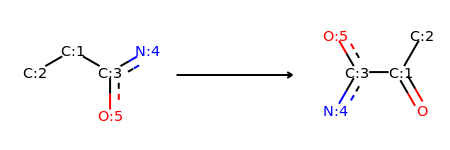

->No precursors could be generated!


--------------------------------------------------

Train index: 393415
RANK 55 PRECEDENT
REACTANT MATCH SCORE: 0.5138888888888888


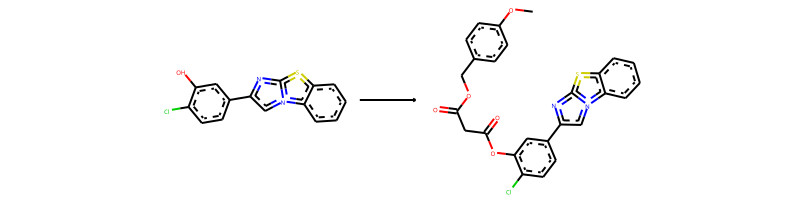

-> template: [OH;D1;+0:1]-[c:2]>>C-O-c1:c:c:c(-C-O-C(=O)-C-C(=O)-[O;H0;D2;+0:1]-[c:2]):c:c:1


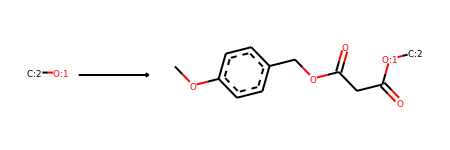

->No precursors could be generated!


--------------------------------------------------

Train index: 185775
RANK 56 PRECEDENT
REACTANT MATCH SCORE: 0.5081967213114754


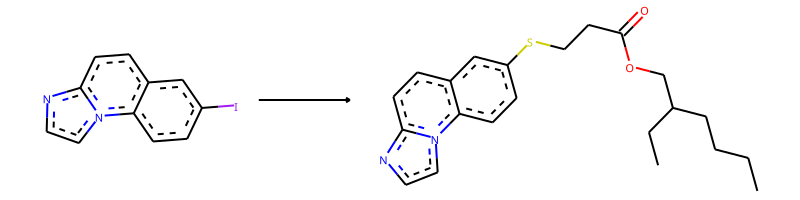

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>C-C-C-C-C(-C-C)-C-O-C(=O)-C-C-S-[c;H0;D3;+0:1](:[c:2]):[c:3]


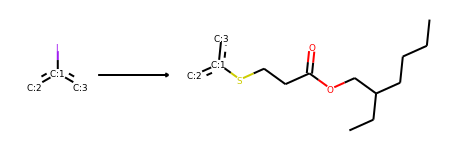

->No precursors could be generated!


--------------------------------------------------

Train index: 71243
RANK 57 PRECEDENT
REACTANT MATCH SCORE: 0.5081967213114754


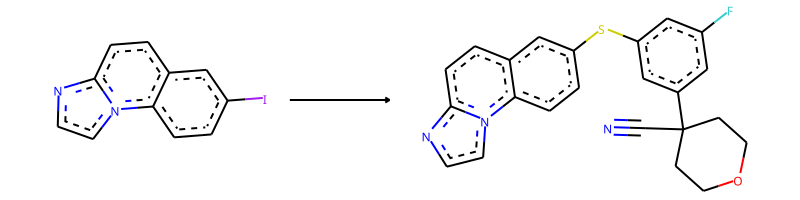

-> template: [I;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>F-c1:c:c(-S-[c;H0;D3;+0:1](:[c:2]):[c:3]):c:c(-C2(-C#N)-C-C-O-C-C-2):c:1


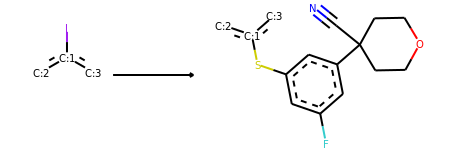

->No precursors could be generated!


--------------------------------------------------

Train index: 71777
RANK 58 PRECEDENT
REACTANT MATCH SCORE: 0.5081967213114754


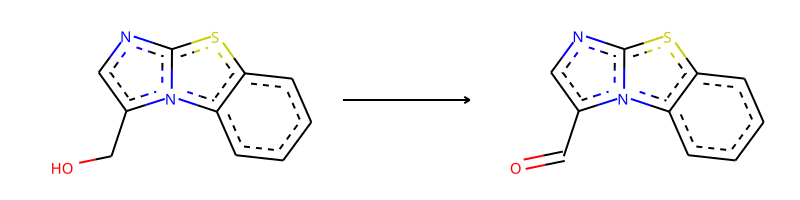

-> template: [#7;a:1]:[c:2]:[c:3](:[#7;a:4])-[CH2;D2;+0:5]-[OH;D1;+0:6]>>[#7;a:1]:[c:2]:[c:3](:[#7;a:4])-[CH;D2;+0:5]=[O;H0;D1;+0:6]


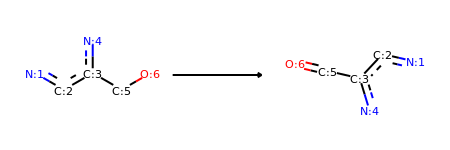

->No precursors could be generated!


--------------------------------------------------

Train index: 401371
RANK 59 PRECEDENT
REACTANT MATCH SCORE: 0.5081967213114754


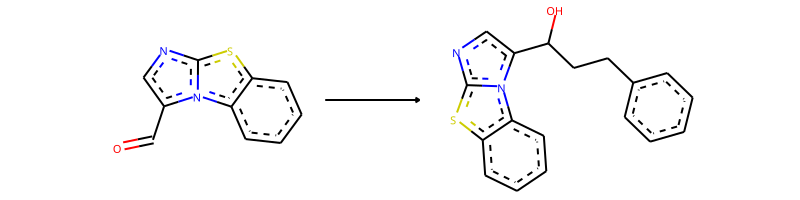

-> template: [#7;a:1]:[c:2]:[c:3](:[#7;a:4])-[CH;D2;+0:5]=[O;H0;D1;+0:6]>>[#7;a:1]:[c:2]:[c:3](:[#7;a:4])-[CH;D3;+0:5](-[OH;D1;+0:6])-C-C-c1:c:c:c:c:c:1


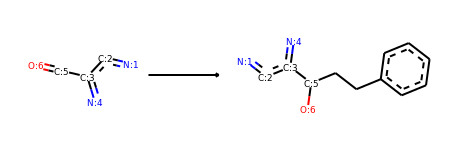

->No precursors could be generated!


--------------------------------------------------

Train index: 364351
RANK 60 PRECEDENT
REACTANT MATCH SCORE: 0.5079365079365079


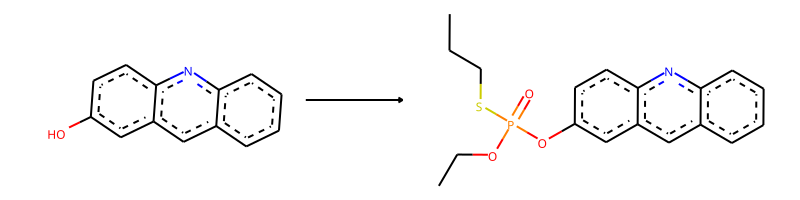

-> template: [OH;D1;+0:1]-[c:2]>>C-C-C-S-P(=O)(-O-C-C)-[O;H0;D2;+0:1]-[c:2]


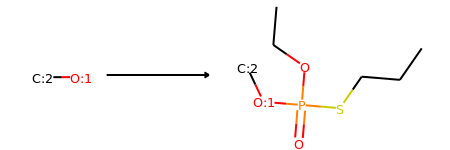

->No precursors could be generated!


--------------------------------------------------

Train index: 217785
RANK 61 PRECEDENT
REACTANT MATCH SCORE: 0.5079365079365079


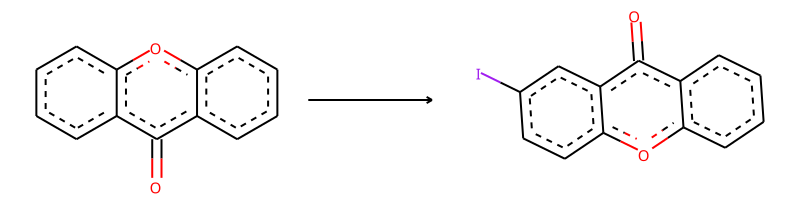

-> template: [c:2]:[cH;D2;+0:1]:[c:3]>>I-[c;H0;D3;+0:1](:[c:2]):[c:3]


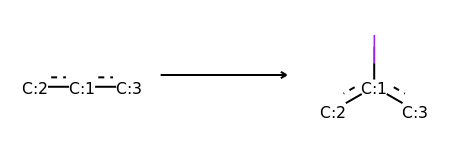

Product similarity 0.5, overall 0.25396825396825395, smiles Ic1cccc2c1ccc1nc3ncccc3n12


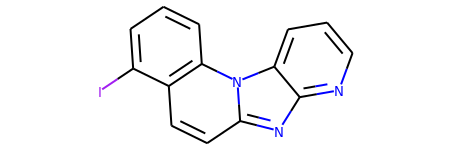

The proposed reaction is:


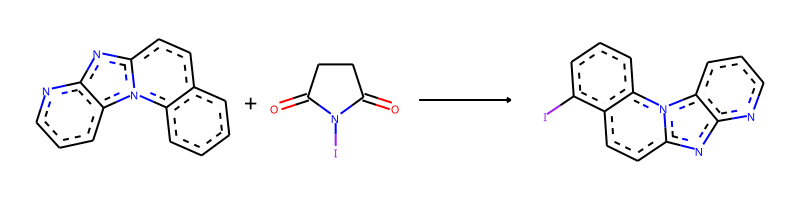

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1cccc2c1ccc1nc3ncccc3n12
Product similarity 0.47761194029850745, overall 0.24259654110400378, smiles Ic1ccnc2nc3ccc4ccccc4n3c12


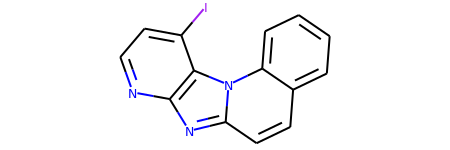

The proposed reaction is:


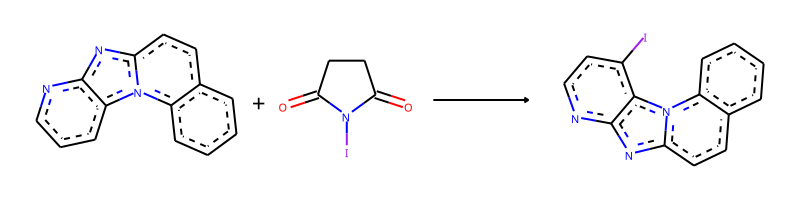

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.5230769230769231, overall 0.2656898656898657, smiles Ic1cc2ccccc2n2c1nc1ncccc12


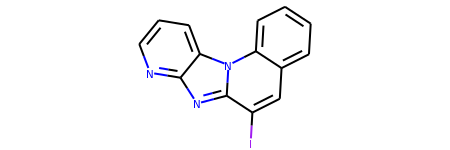

The proposed reaction is:


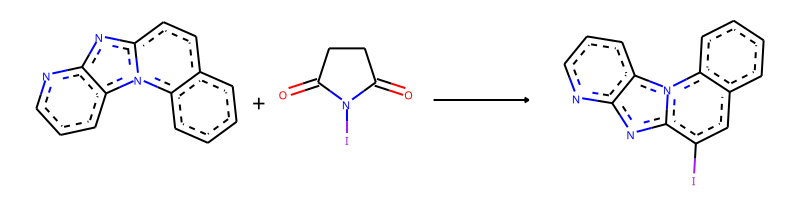

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.47761194029850745, overall 0.24259654110400378, smiles Ic1cccc2ccc3nc4ncccc4n3c12


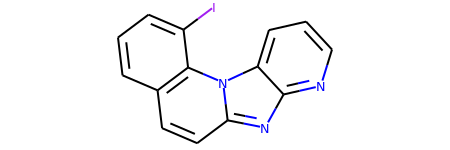

The proposed reaction is:


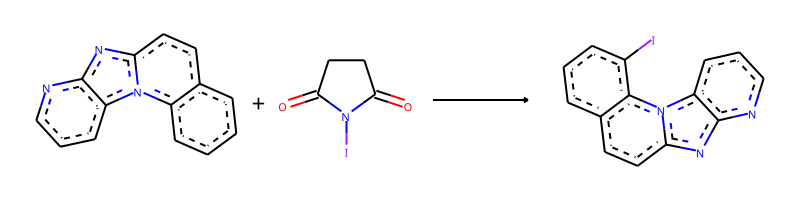

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1cccc2ccc3nc4ncccc4n3c12
Product similarity 0.47761194029850745, overall 0.24259654110400378, smiles Ic1cnc2nc3ccc4ccccc4n3c2c1


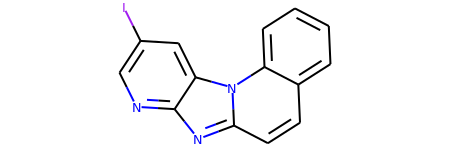

The proposed reaction is:


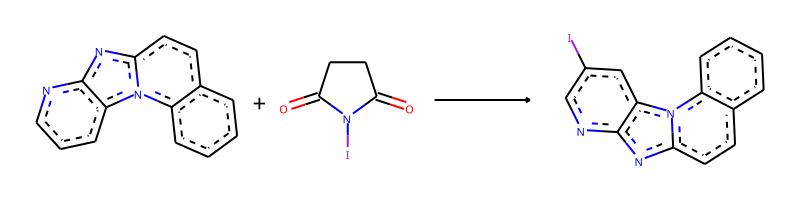

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.5230769230769231, overall 0.2656898656898657, smiles Ic1ccc2c(ccc3nc4ncccc4n32)c1


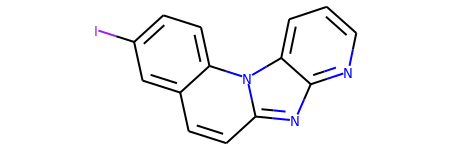

The proposed reaction is:


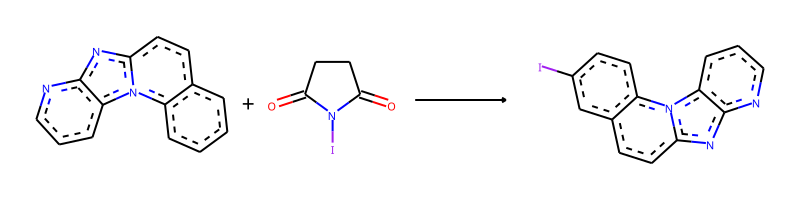

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1ccc2c(ccc3nc4ncccc4n32)c1
Product similarity 0.5, overall 0.25396825396825395, smiles Ic1cc2nc3ncccc3n2c2ccccc12


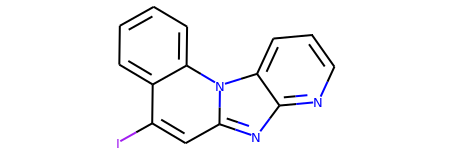

The proposed reaction is:


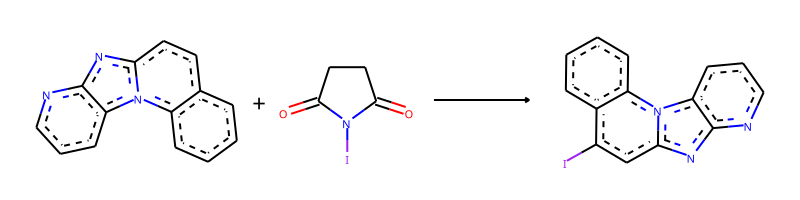

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.47761194029850745, overall 0.24259654110400378, smiles Ic1ccc2ccc3nc4ncccc4n3c2c1


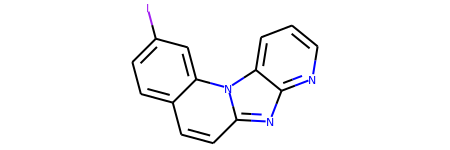

The proposed reaction is:


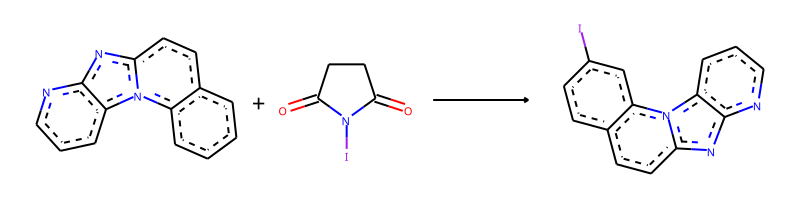

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C1CCC(=O)N1I>>Ic1ccc2ccc3nc4ncccc4n3c2c1


--------------------------------------------------

Train index: 214684
RANK 62 PRECEDENT
REACTANT MATCH SCORE: 0.5079365079365079


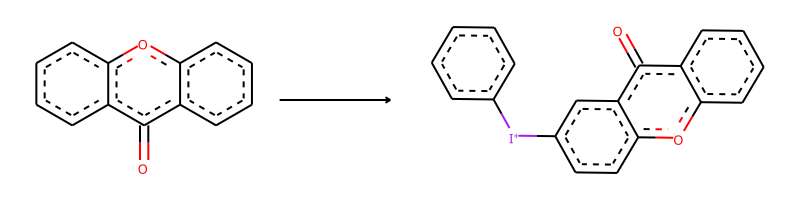

-> template: [c:1]:[cH;D2;+0:2]:[c:3]>>[c:1]:[c;H0;D3;+0:2](:[c:3])-[I+]-c1:c:c:c:c:c:1


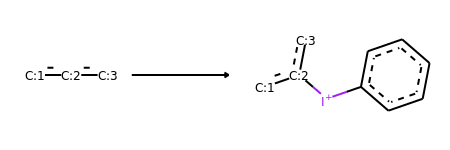

Product similarity 0.611764705882353, overall 0.3107376283846872, smiles c1ccc([I+]c2cc3nc4ncccc4n3c3ccccc23)cc1


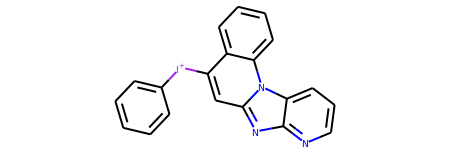

The proposed reaction is:


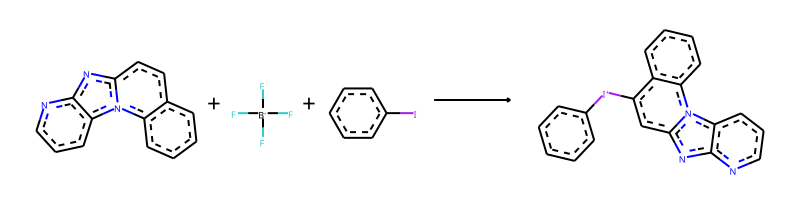

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2cc3nc4ncccc4n3c3ccccc23)cc1
Product similarity 0.5930232558139535, overall 0.301218161683278, smiles c1ccc([I+]c2cnc3nc4ccc5ccccc5n4c3c2)cc1


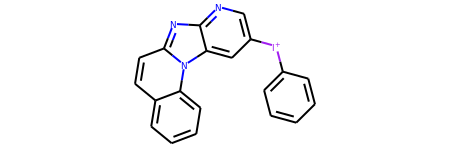

The proposed reaction is:


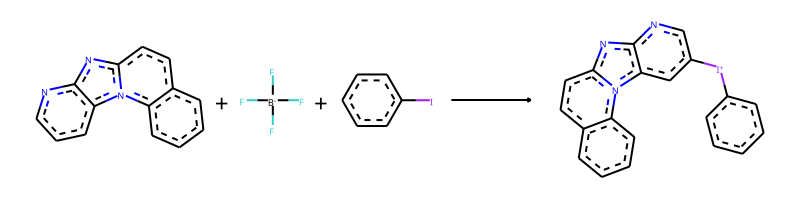

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2cnc3nc4ccc5ccccc5n4c3c2)cc1
Product similarity 0.5930232558139535, overall 0.301218161683278, smiles c1ccc([I+]c2cccc3ccc4nc5ncccc5n4c23)cc1


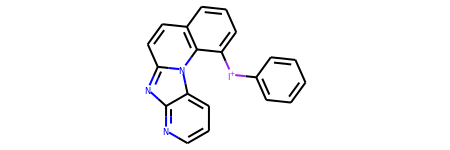

The proposed reaction is:


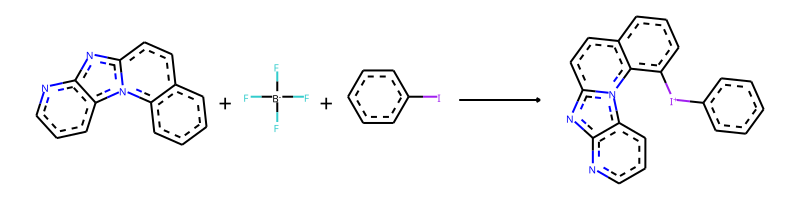

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2cccc3ccc4nc5ncccc5n4c23)cc1
Product similarity 0.6309523809523809, overall 0.3204837490551776, smiles c1ccc([I+]c2cc3ccccc3n3c2nc2ncccc23)cc1


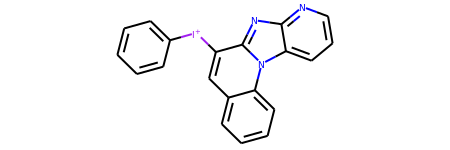

The proposed reaction is:


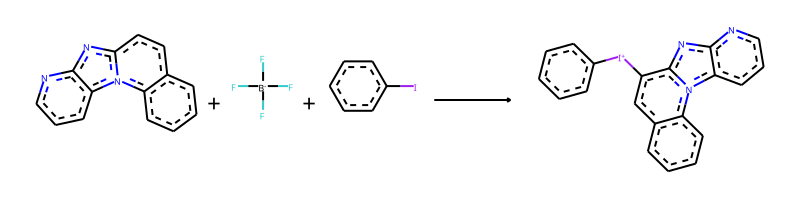

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2cc3ccccc3n3c2nc2ncccc23)cc1
Product similarity 0.5930232558139535, overall 0.301218161683278, smiles c1ccc([I+]c2ccnc3nc4ccc5ccccc5n4c23)cc1


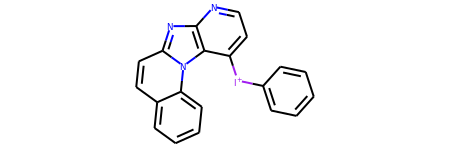

The proposed reaction is:


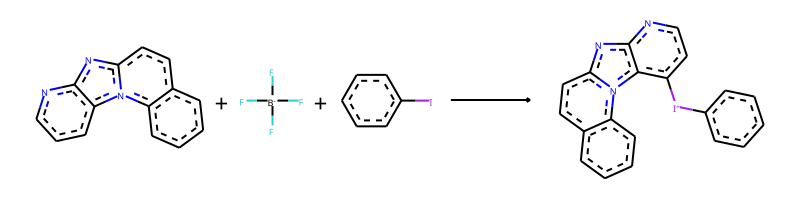

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2ccnc3nc4ccc5ccccc5n4c23)cc1
Product similarity 0.5930232558139535, overall 0.301218161683278, smiles c1ccc([I+]c2ccc3ccc4nc5ncccc5n4c3c2)cc1


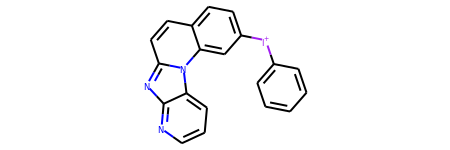

The proposed reaction is:


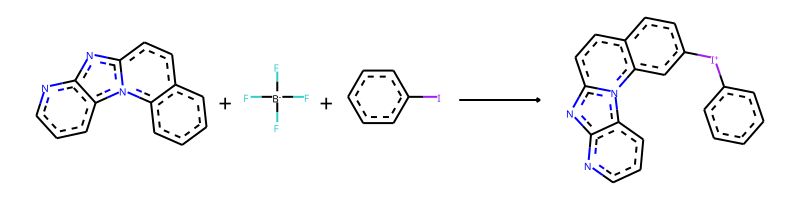

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2ccc3ccc4nc5ncccc5n4c3c2)cc1
Product similarity 0.6309523809523809, overall 0.3204837490551776, smiles c1ccc([I+]c2ccc3c(ccc4nc5ncccc5n43)c2)cc1


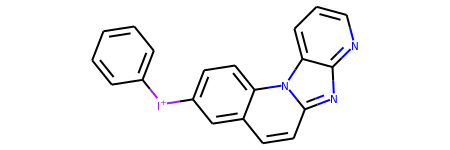

The proposed reaction is:


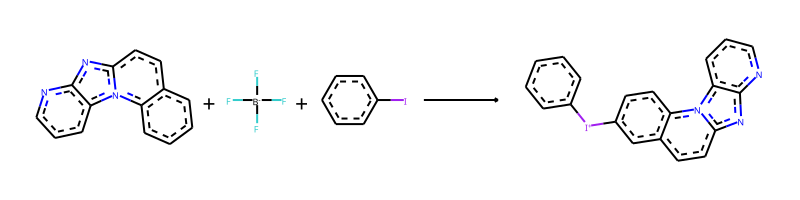

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2ccc3c(ccc4nc5ncccc5n43)c2)cc1
Product similarity 0.611764705882353, overall 0.3107376283846872, smiles c1ccc([I+]c2cccc3c2ccc2nc4ncccc4n23)cc1


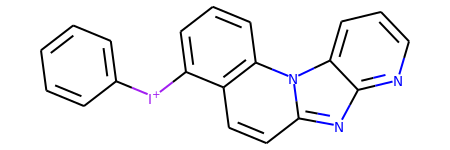

The proposed reaction is:


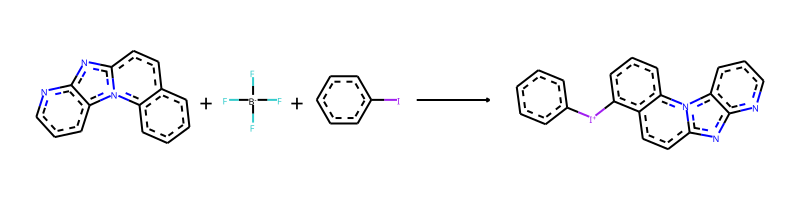

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.F[B-](F)(F)F.Ic1ccccc1>>c1ccc([I+]c2cccc3c2ccc2nc4ncccc4n23)cc1


--------------------------------------------------

Train index: 317780
RANK 63 PRECEDENT
REACTANT MATCH SCORE: 0.5079365079365079


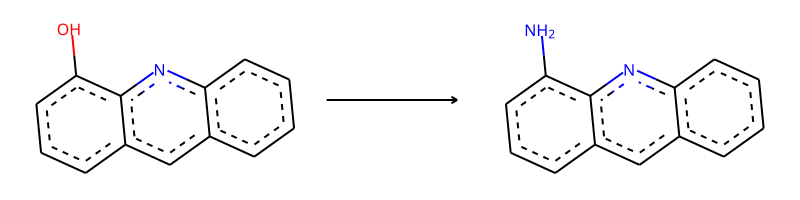

-> template: [#7;a:4]:[c:3]:[c;H0;D3;+0:1](-[O;H1;D1;+0]):[c:2]>>N-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#7;a:4]


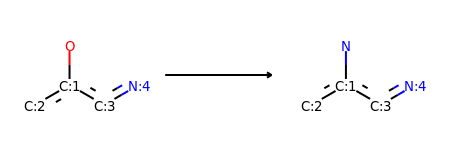

->No precursors could be generated!


--------------------------------------------------

Train index: 364885
RANK 64 PRECEDENT
REACTANT MATCH SCORE: 0.5079365079365079


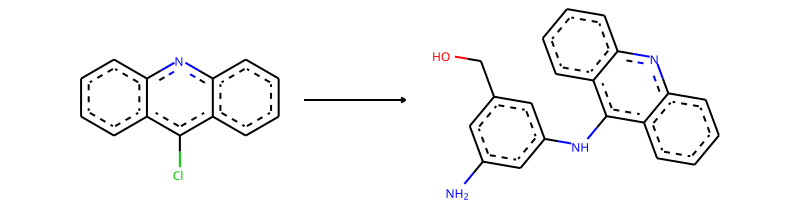

-> template: [Cl;H0;D1;+0]-[c;H0;D3;+0:1]1:[c:2]:[c:3]:[#7;a:4]:[c:5]:[c:6]:1>>N-c1:c:c(-C-O):c:c(-N-[c;H0;D3;+0:1]2:[c:2]:[c:3]:[#7;a:4]:[c:5]:[c:6]:2):c:1


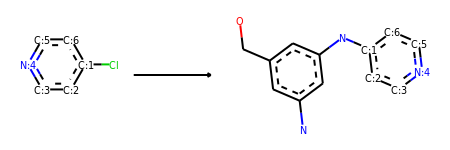

->No precursors could be generated!


--------------------------------------------------

Train index: 429986
RANK 65 PRECEDENT
REACTANT MATCH SCORE: 0.5079365079365079


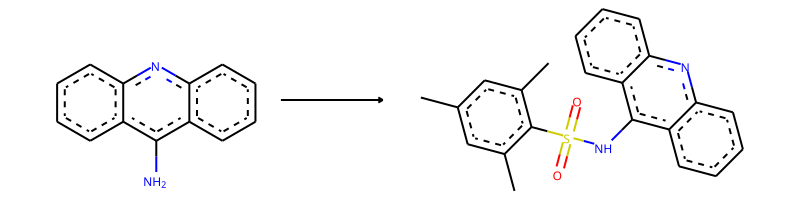

-> template: [NH2;D1;+0:1]-[c:2]>>C-c1:c:c(-C):c(-S(=O)(=O)-[NH;D2;+0:1]-[c:2]):c(-C):c:1


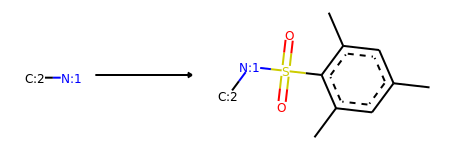

->No precursors could be generated!


--------------------------------------------------

Train index: 471865
RANK 66 PRECEDENT
REACTANT MATCH SCORE: 0.5079365079365079


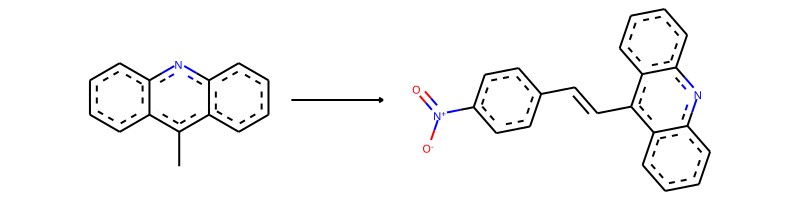

-> template: [CH3;D1;+0:1]-[c:2]>>O=[N+](-[O-])-c1:c:c:c(-C=[CH;D2;+0:1]-[c:2]):c:c:1


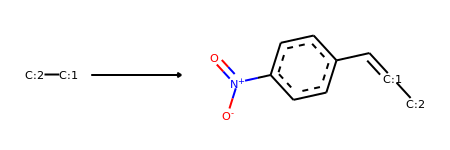

->No precursors could be generated!


--------------------------------------------------

Train index: 54344
RANK 67 PRECEDENT
REACTANT MATCH SCORE: 0.5076923076923077


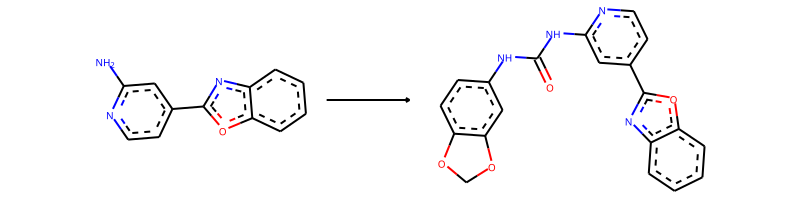

-> template: [#7;a:3]:[c:2]-[NH2;D1;+0:1]>>O=C(-N-c1:c:c:c2:c(:c:1)-O-C-O-2)-[NH;D2;+0:1]-[c:2]:[#7;a:3]


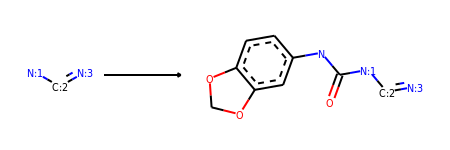

->No precursors could be generated!


--------------------------------------------------

Train index: 225052
RANK 68 PRECEDENT
REACTANT MATCH SCORE: 0.5076923076923077


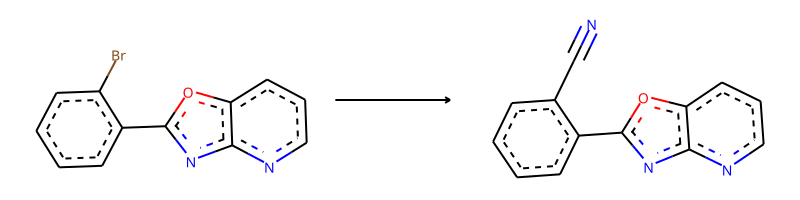

-> template: [Br;H0;D1;+0]-[c;H0;D3;+0:1](:[c:2]):[c:3]>>N#C-[c;H0;D3;+0:1](:[c:2]):[c:3]


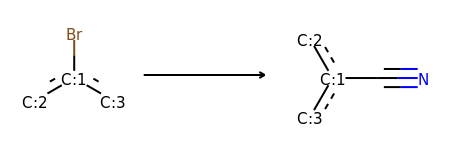

->No precursors could be generated!


--------------------------------------------------

Train index: 222994
RANK 69 PRECEDENT
REACTANT MATCH SCORE: 0.5076923076923077


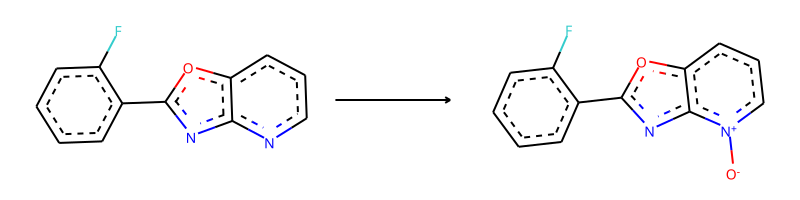

-> template: [#7;a:1]:[c:2](:[c:3]:[#8;a:4]):[n;H0;D2;+0:5]:[c:6]>>[#7;a:1]:[c:2](:[c:3]:[#8;a:4]):[n+;H0;D3:5](-[O-]):[c:6]


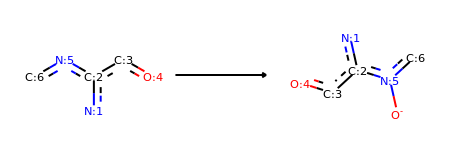

->No precursors could be generated!


--------------------------------------------------

Train index: 278804
RANK 70 PRECEDENT
REACTANT MATCH SCORE: 0.5074626865671642


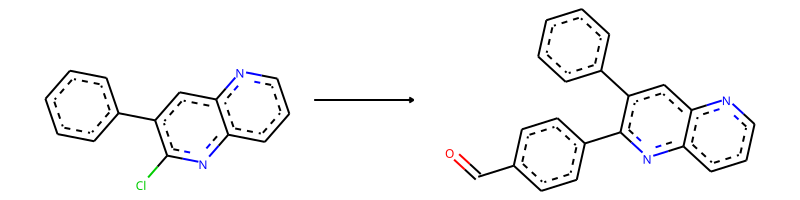

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:3]>>O=C-c1:c:c:c(-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]):c:c:1


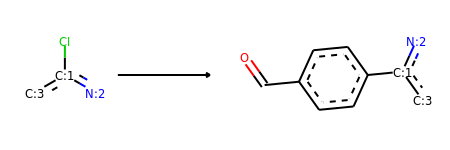

->No precursors could be generated!


--------------------------------------------------

Train index: 148133
RANK 71 PRECEDENT
REACTANT MATCH SCORE: 0.5074626865671642


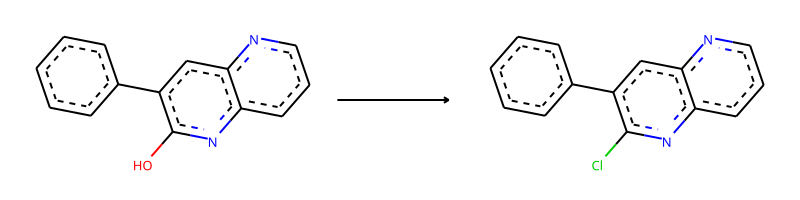

-> template: [#7;a:2]:[c;H0;D3;+0:1](-[O;H1;D1;+0]):[c:3]>>Cl-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


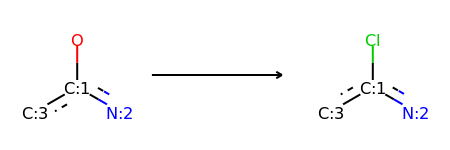

->No precursors could be generated!


--------------------------------------------------

Train index: 46891
RANK 72 PRECEDENT
REACTANT MATCH SCORE: 0.5074626865671642


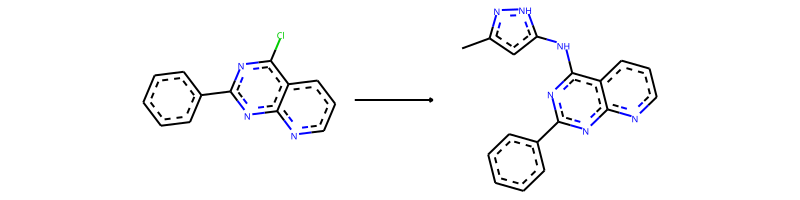

-> template: [#7;a:6]:[c:5]1:[#7;a:4]:[c:3]:[#7;a:2]:[c;H0;D3;+0:1](-[Cl;H0;D1;+0]):[c:7]:1>>C-c1:c:c(-N-[c;H0;D3;+0:1]2:[#7;a:2]:[c:3]:[#7;a:4]:[c:5](:[#7;a:6]):[c:7]:2):[nH]:n:1


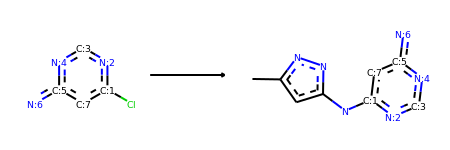

->No precursors could be generated!


--------------------------------------------------

Train index: 11122
RANK 73 PRECEDENT
REACTANT MATCH SCORE: 0.5070422535211268


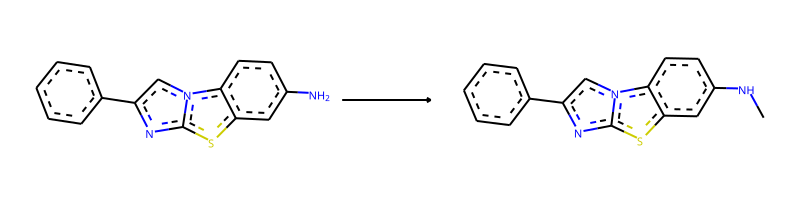

-> template: [NH2;D1;+0:1]-[c:2]>>C-[NH;D2;+0:1]-[c:2]


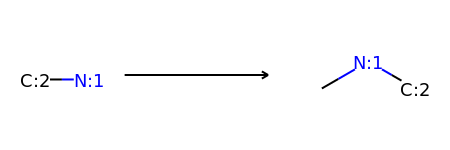

->No precursors could be generated!


--------------------------------------------------

Train index: 170748
RANK 74 PRECEDENT
REACTANT MATCH SCORE: 0.5070422535211268


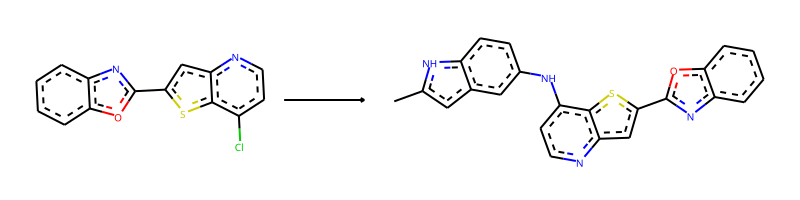

-> template: [#16;a:7]:[c:6]1:[c:5]:[#7;a:4]:[c:3]:[c:2]:[c;H0;D3;+0:1]:1-[Cl;H0;D1;+0]>>C-c1:[nH]:c2:c:c:c(-N-[c;H0;D3;+0:1]3:[c:2]:[c:3]:[#7;a:4]:[c:5]:[c:6]:3:[#16;a:7]):c:c:2:c:1


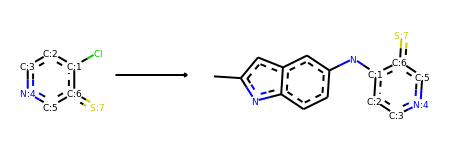

->No precursors could be generated!


--------------------------------------------------

Train index: 55269
RANK 75 PRECEDENT
REACTANT MATCH SCORE: 0.5


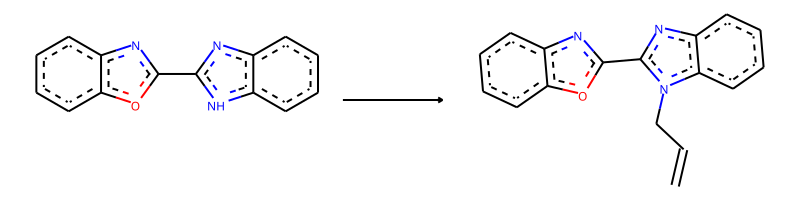

-> template: [#7;a:3]1:[c:2]:[nH;D2;+0:1]:[c:5]:[c:4]:1>>C=C-C-[n;H0;D3;+0:1]1:[c:2]:[#7;a:3]:[c:4]:[c:5]:1


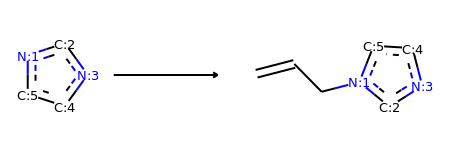

->No precursors could be generated!


--------------------------------------------------

Train index: 96018
RANK 76 PRECEDENT
REACTANT MATCH SCORE: 0.5


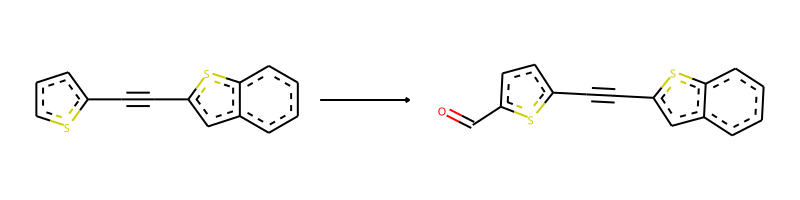

-> template: [#16;a:2]:[cH;D2;+0:1]:[c:3]>>O=C-[c;H0;D3;+0:1](:[#16;a:2]):[c:3]


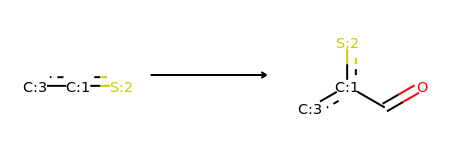

->No precursors could be generated!


--------------------------------------------------

Train index: 471138
RANK 77 PRECEDENT
REACTANT MATCH SCORE: 0.5


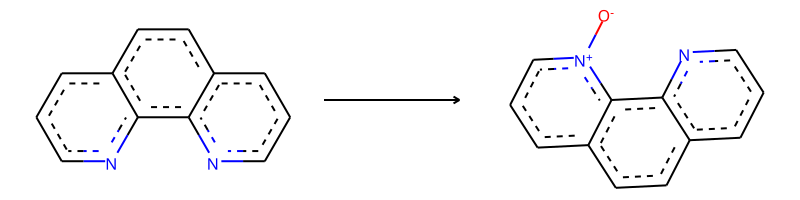

-> template: [#7;a:1]:[c:2]:[c:3]:[n;H0;D2;+0:4]:[c:5]>>[#7;a:1]:[c:2]:[c:3]:[n+;H0;D3:4](-[O-]):[c:5]


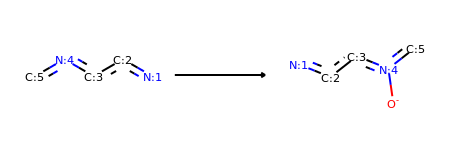

Product similarity 0.49230769230769234, overall 0.24615384615384617, smiles [O-][n+]1cccc2c1nc1ccc3ccccc3n12


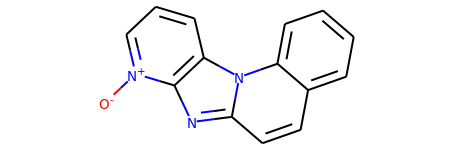

The proposed reaction is:


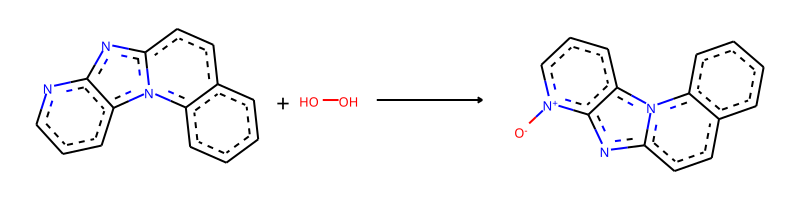

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.OO>>[O-][n+]1cccc2c1nc1ccc3ccccc3n12
Product similarity 0.49230769230769234, overall 0.24615384615384617, smiles [O-][n+]1c2ncccc2n2c3ccccc3ccc21


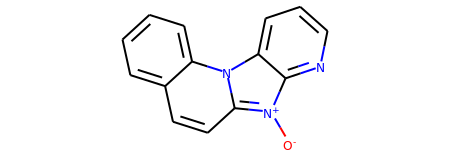

The proposed reaction is:


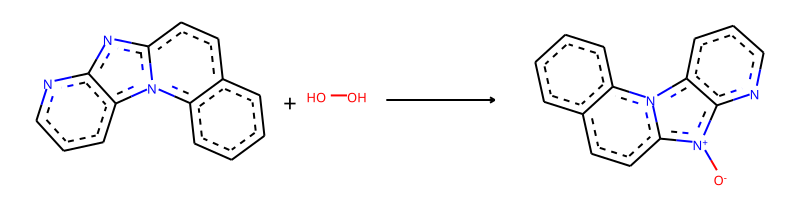

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.OO>>[O-][n+]1c2ncccc2n2c3ccccc3ccc21


--------------------------------------------------

Train index: 198610
RANK 78 PRECEDENT
REACTANT MATCH SCORE: 0.5


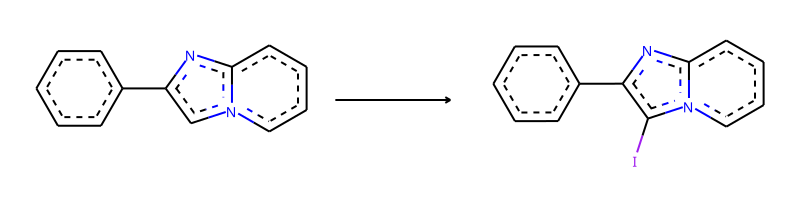

-> template: [#7;a:2]1:[c:3]:[#7;a:4]:[c:5]:[cH;D2;+0:1]:1>>I-[c;H0;D3;+0:1]1:[#7;a:2]:[c:3]:[#7;a:4]:[c:5]:1


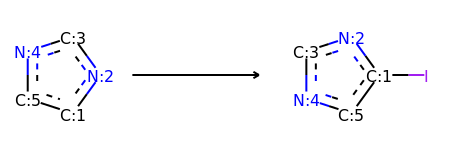

->No precursors could be generated!


--------------------------------------------------

Train index: 449651
RANK 79 PRECEDENT
REACTANT MATCH SCORE: 0.5


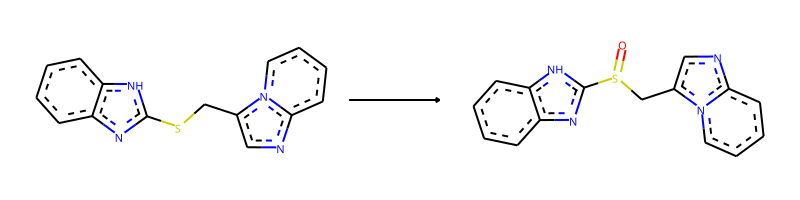

-> template: [#7;a:4]:[c:3](:[#7;a:5])-[S;H0;D2;+0:1]-[C:2]>>O=[S;H0;D3;+0:1](-[C:2])-[c:3](:[#7;a:4]):[#7;a:5]


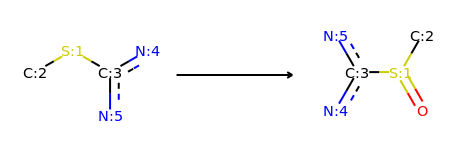

->No precursors could be generated!


--------------------------------------------------

Train index: 396533
RANK 80 PRECEDENT
REACTANT MATCH SCORE: 0.5


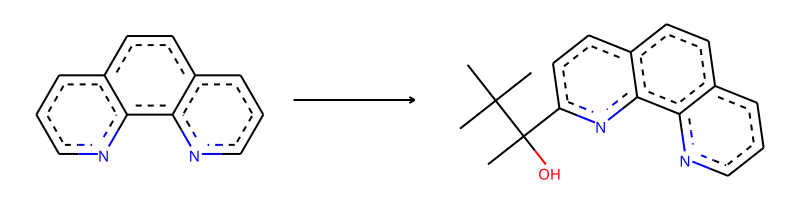

-> template: [#7;a:2]:[cH;D2;+0:1]:[c:3]>>C-C(-C)(-C)-C(-C)(-O)-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


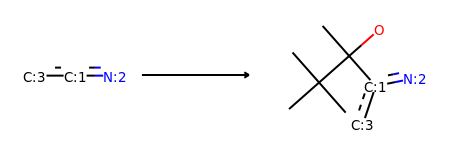

Product similarity 0.6025641025641025, overall 0.30128205128205127, smiles CC(C)(C)C(C)(O)c1ccc2c(n1)nc1ccc3ccccc3n12


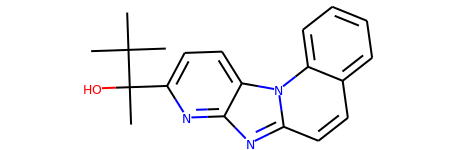

The proposed reaction is:


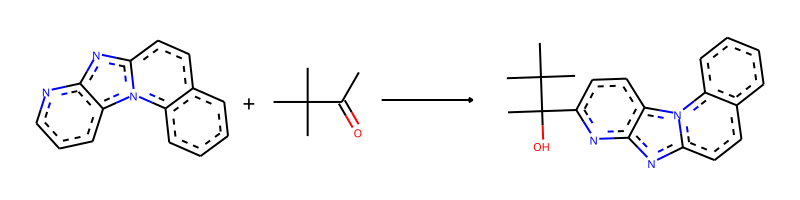

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CC(=O)C(C)(C)C>>CC(C)(C)C(C)(O)c1ccc2c(n1)nc1ccc3ccccc3n12


--------------------------------------------------

Train index: 96011
RANK 81 PRECEDENT
REACTANT MATCH SCORE: 0.5


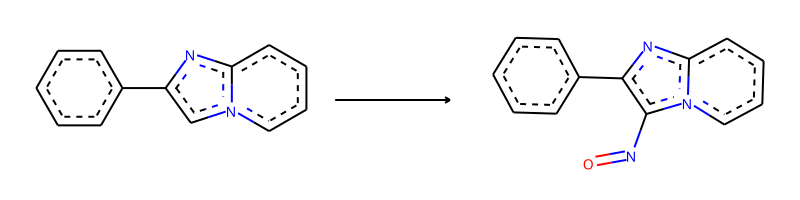

-> template: [#7;a:2]1:[c:3]:[#7;a:4]:[c:5]:[cH;D2;+0:1]:1>>O=N-[c;H0;D3;+0:1]1:[#7;a:2]:[c:3]:[#7;a:4]:[c:5]:1


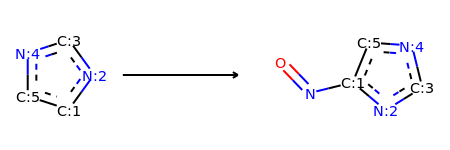

->No precursors could be generated!


--------------------------------------------------

Train index: 473231
RANK 82 PRECEDENT
REACTANT MATCH SCORE: 0.5


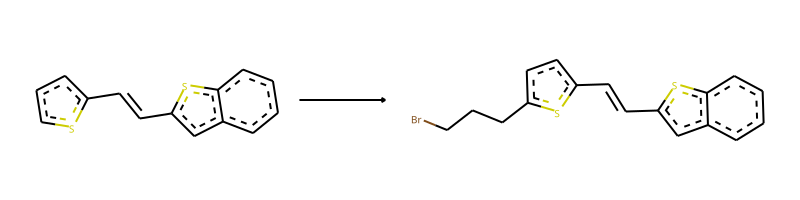

-> template: [#16;a:2]:[cH;D2;+0:1]:[c:3]>>Br-C-C-C-[c;H0;D3;+0:1](:[#16;a:2]):[c:3]


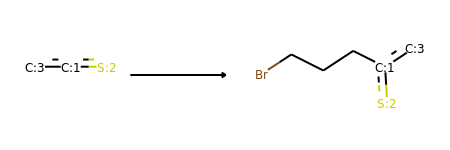

->No precursors could be generated!


--------------------------------------------------

Train index: 253218
RANK 83 PRECEDENT
REACTANT MATCH SCORE: 0.5


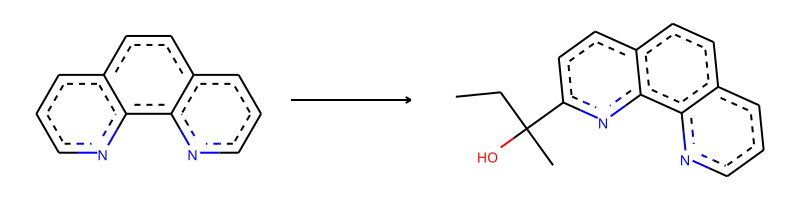

-> template: [#7;a:2]:[cH;D2;+0:1]:[c:3]>>C-C-C(-C)(-O)-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


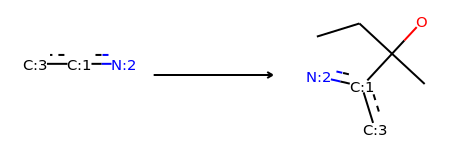

Product similarity 0.581081081081081, overall 0.2905405405405405, smiles CCC(C)(O)c1ccc2c(n1)nc1ccc3ccccc3n12


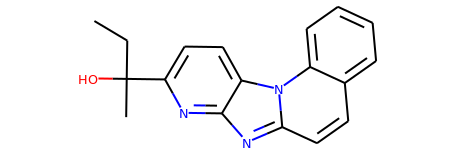

The proposed reaction is:


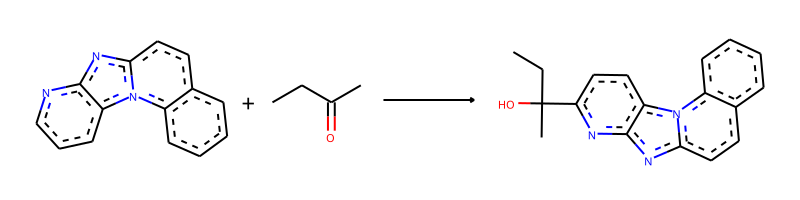

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CCC(C)=O>>CCC(C)(O)c1ccc2c(n1)nc1ccc3ccccc3n12


--------------------------------------------------

Train index: 79297
RANK 84 PRECEDENT
REACTANT MATCH SCORE: 0.5


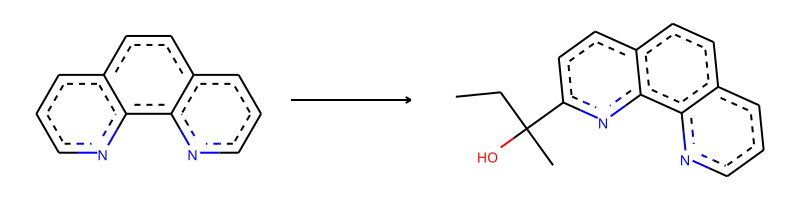

-> template: [#7;a:2]:[cH;D2;+0:1]:[c:3]>>C-C-C(-C)(-O)-[c;H0;D3;+0:1](:[#7;a:2]):[c:3]


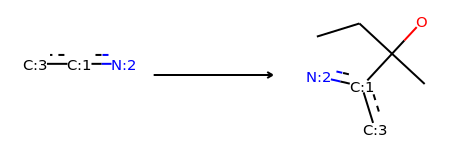

Product similarity 0.581081081081081, overall 0.2905405405405405, smiles CCC(C)(O)c1ccc2c(n1)nc1ccc3ccccc3n12


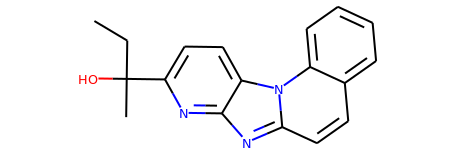

The proposed reaction is:


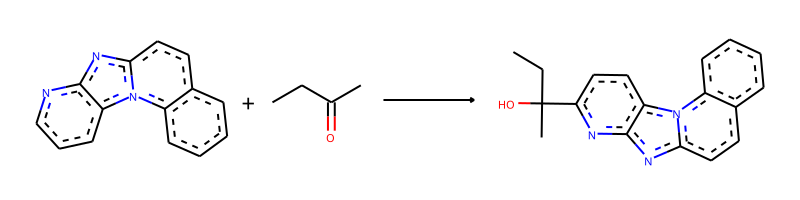

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.CCC(C)=O>>CCC(C)(O)c1ccc2c(n1)nc1ccc3ccccc3n12


--------------------------------------------------

Train index: 276284
RANK 85 PRECEDENT
REACTANT MATCH SCORE: 0.5


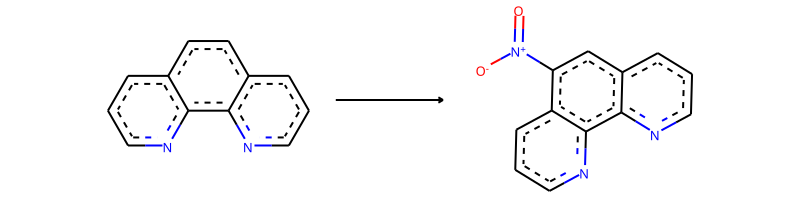

-> template: [#7;a:5]:[c:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O=[N+](-[O-])-[c;H0;D3;+0:1](:[c:2]):[c:3]:[c:4]:[#7;a:5]


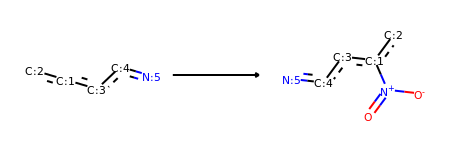

Product similarity 0.5070422535211268, overall 0.2535211267605634, smiles O=[N+]([O-])c1cnc2nc3ccc4ccccc4n3c2c1


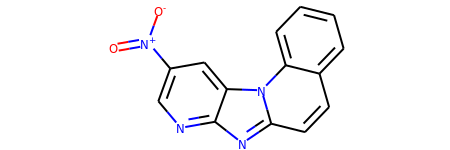

The proposed reaction is:


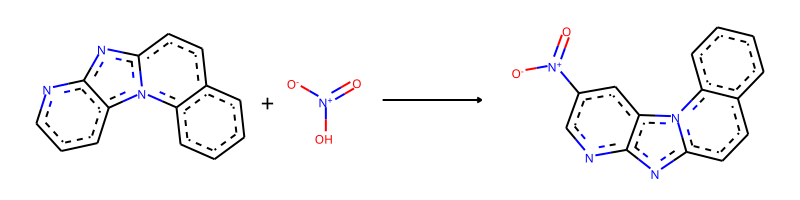

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=[N+]([O-])O>>O=[N+]([O-])c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.5507246376811594, overall 0.2753623188405797, smiles O=[N+]([O-])c1cccc2c1ccc1nc3ncccc3n12


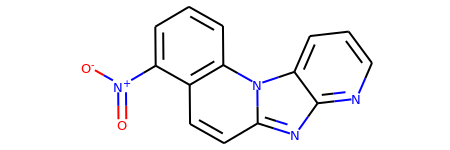

The proposed reaction is:


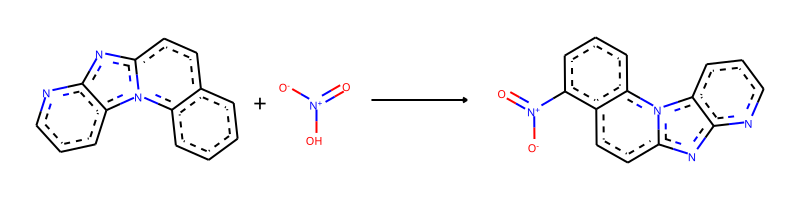

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=[N+]([O-])O>>O=[N+]([O-])c1cccc2c1ccc1nc3ncccc3n12
Product similarity 0.5285714285714286, overall 0.2642857142857143, smiles O=[N+]([O-])c1ccnc2nc3ccc4ccccc4n3c12


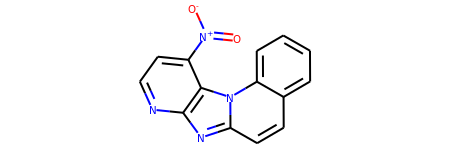

The proposed reaction is:


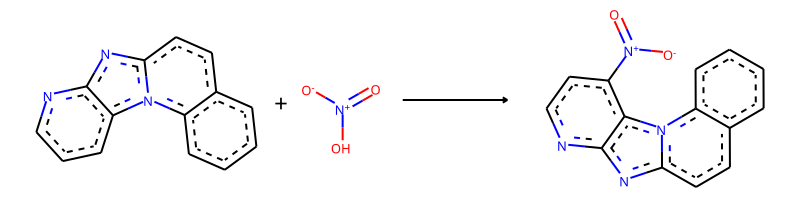

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=[N+]([O-])O>>O=[N+]([O-])c1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.5507246376811594, overall 0.2753623188405797, smiles O=[N+]([O-])c1cc2nc3ncccc3n2c2ccccc12


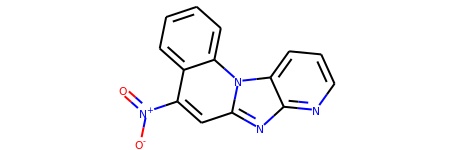

The proposed reaction is:


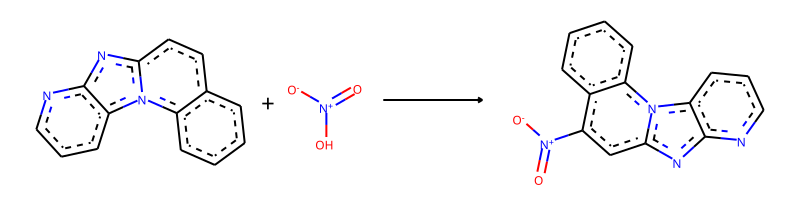

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=[N+]([O-])O>>O=[N+]([O-])c1cc2nc3ncccc3n2c2ccccc12
Product similarity 0.5507246376811594, overall 0.2753623188405797, smiles O=[N+]([O-])c1ccc2ccc3nc4ncccc4n3c2c1


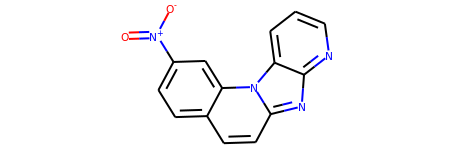

The proposed reaction is:


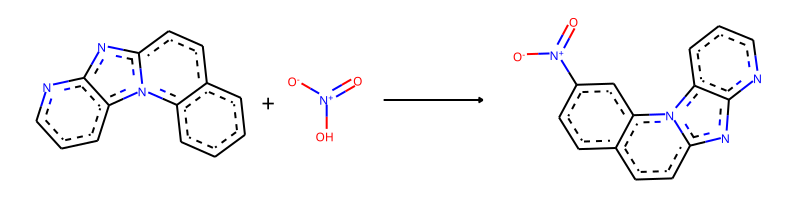

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=[N+]([O-])O>>O=[N+]([O-])c1ccc2ccc3nc4ncccc4n3c2c1


--------------------------------------------------

Train index: 478819
RANK 86 PRECEDENT
REACTANT MATCH SCORE: 0.4935064935064935


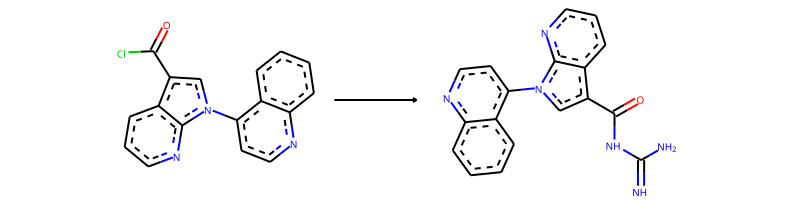

-> template: [#7;a:5]:[c:4]:[c:3]-[C;H0;D3;+0:1](-[Cl;H0;D1;+0])=[O;D1;H0:2]>>N-C(=N)-N-[C;H0;D3;+0:1](=[O;D1;H0:2])-[c:3]:[c:4]:[#7;a:5]


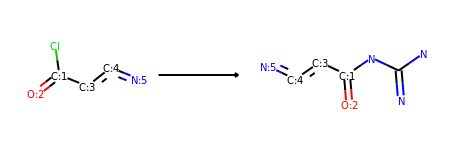

->No precursors could be generated!


--------------------------------------------------

Train index: 177797
RANK 87 PRECEDENT
REACTANT MATCH SCORE: 0.4935064935064935


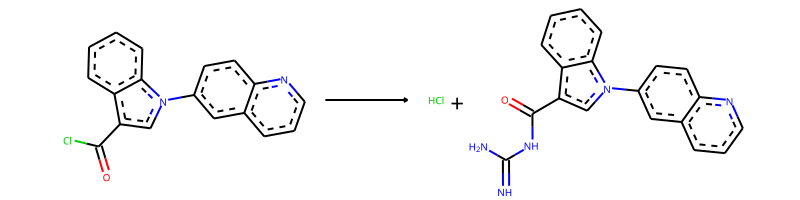

-> template: [#7;a:5]:[c:4]:[c:3]-[C;H0;D3;+0:1](-[Cl;H0;D1;+0:6])=[O;D1;H0:2]>>N-C(=N)-N-[C;H0;D3;+0:1](=[O;D1;H0:2])-[c:3]:[c:4]:[#7;a:5].[ClH;D0;+0:6]


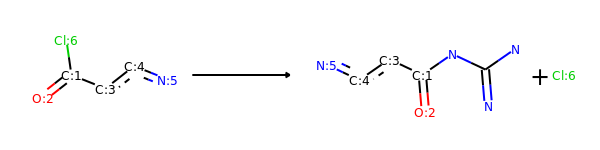

->No precursors could be generated!


--------------------------------------------------

Train index: 442637
RANK 88 PRECEDENT
REACTANT MATCH SCORE: 0.49333333333333335


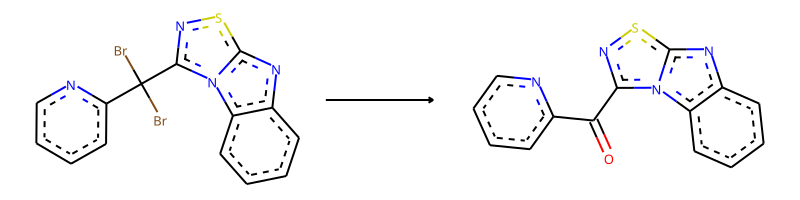

-> template: [#16;a:7]:[#7;a:6]:[c:4](:[#7;a:5])-[C;H0;D4;+0:1](-[Br;H0;D1;+0])(-[Br;H0;D1;+0])-[c:2]:[#7;a:3]>>O=[C;H0;D3;+0:1](-[c:2]:[#7;a:3])-[c:4](:[#7;a:5]):[#7;a:6]:[#16;a:7]


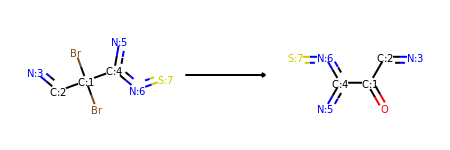

->No precursors could be generated!


--------------------------------------------------

Train index: 45957
RANK 89 PRECEDENT
REACTANT MATCH SCORE: 0.4931506849315068


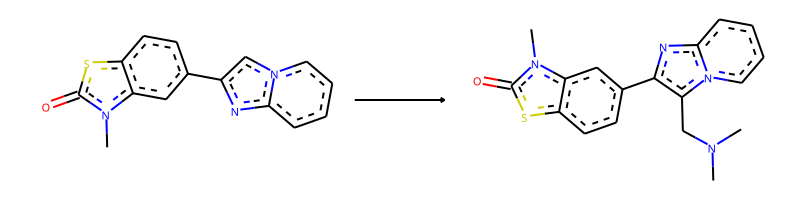

-> template: [#7;a:4]1:[c:5]:[cH;D2;+0:1]:[#7;a:2]:[c:3]:1>>C-N(-C)-C-[c;H0;D3;+0:1]1:[#7;a:2]:[c:3]:[#7;a:4]:[c:5]:1


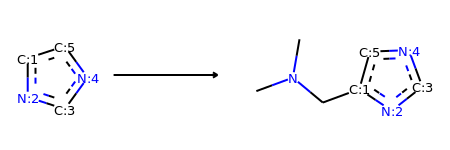

->No precursors could be generated!


--------------------------------------------------

Train index: 13353
RANK 90 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


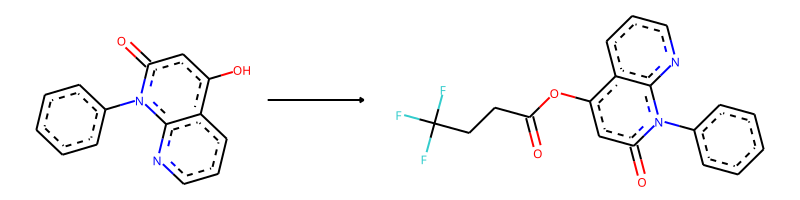

-> template: [OH;D1;+0:1]-[c:2]>>F-C(-F)(-F)-C-C-C(=O)-[O;H0;D2;+0:1]-[c:2]


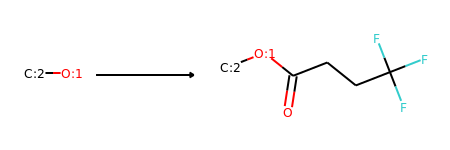

->No precursors could be generated!


--------------------------------------------------

Train index: 385039
RANK 91 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


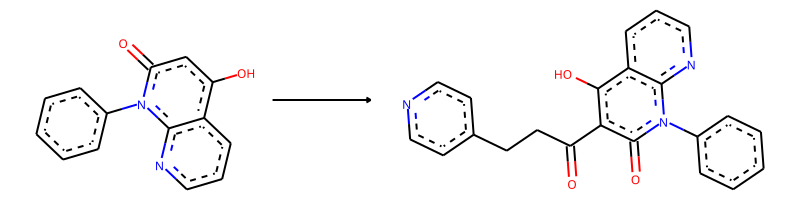

-> template: [#7;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O=C(-C-C-c1:c:c:n:c:c:1)-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#7;a:4]


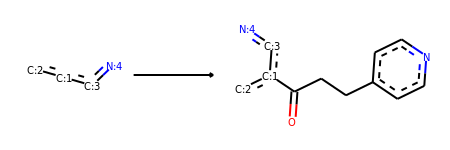

Product similarity 0.61, overall 0.30057971014492757, smiles O=C(CCc1ccncc1)c1cnc2nc3ccc4ccccc4n3c2c1


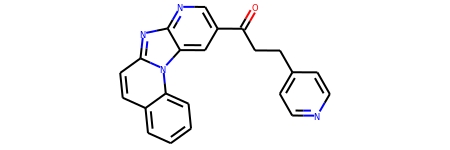

The proposed reaction is:


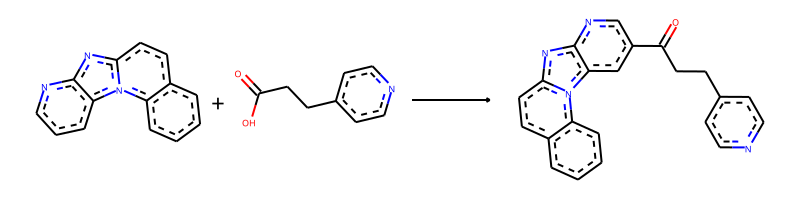

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1ccncc1>>O=C(CCc1ccncc1)c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.6262626262626263, overall 0.3085931781583956, smiles O=C(CCc1ccncc1)c1cccc2ccc3nc4ncccc4n3c12


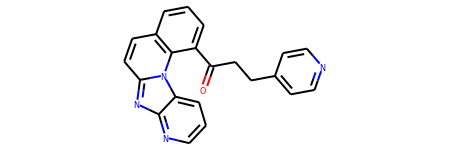

The proposed reaction is:


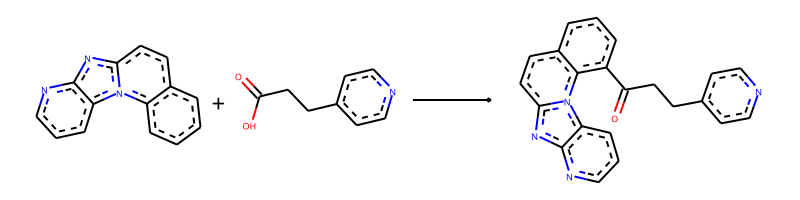

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1ccncc1>>O=C(CCc1ccncc1)c1cccc2ccc3nc4ncccc4n3c12
Product similarity 0.6428571428571429, overall 0.31677018633540377, smiles O=C(CCc1ccncc1)c1cc2ccccc2n2c1nc1ncccc12


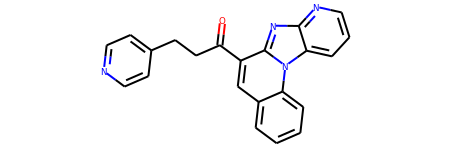

The proposed reaction is:


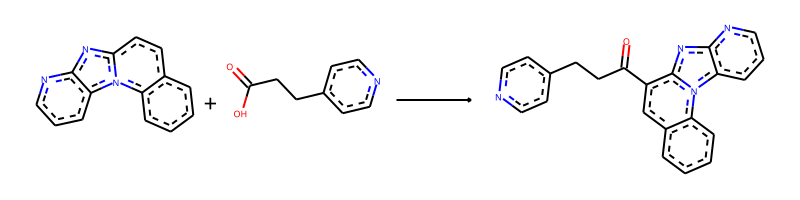

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1ccncc1>>O=C(CCc1ccncc1)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.6262626262626263, overall 0.3085931781583956, smiles O=C(CCc1ccncc1)c1ccnc2nc3ccc4ccccc4n3c12


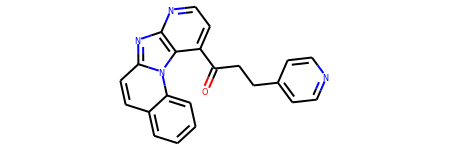

The proposed reaction is:


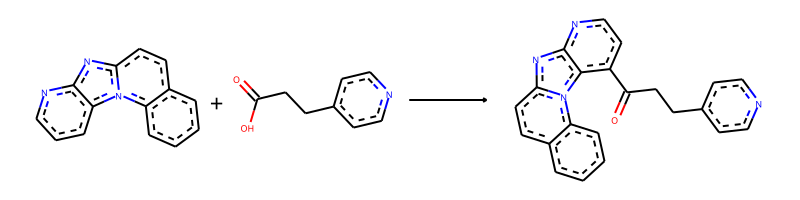

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1ccncc1>>O=C(CCc1ccncc1)c1ccnc2nc3ccc4ccccc4n3c12


--------------------------------------------------

Train index: 468834
RANK 92 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


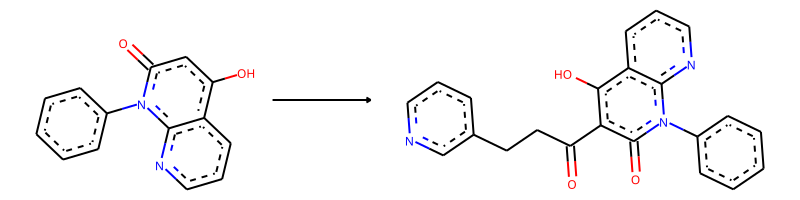

-> template: [#7;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>O=C(-C-C-c1:c:c:c:n:c:1)-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#7;a:4]


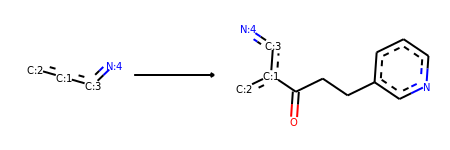

Product similarity 0.6428571428571429, overall 0.31677018633540377, smiles O=C(CCc1cccnc1)c1cc2ccccc2n2c1nc1ncccc12


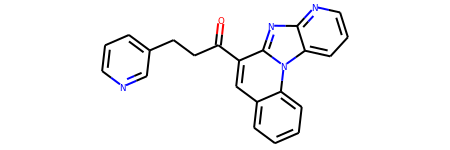

The proposed reaction is:


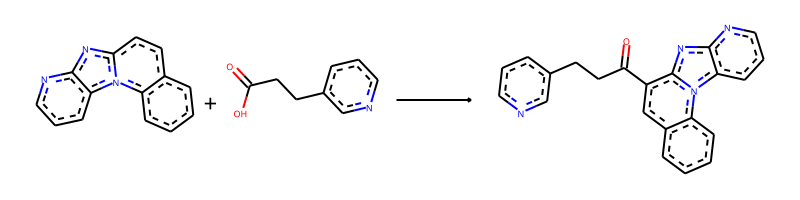

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1cccnc1>>O=C(CCc1cccnc1)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.61, overall 0.30057971014492757, smiles O=C(CCc1cccnc1)c1cnc2nc3ccc4ccccc4n3c2c1


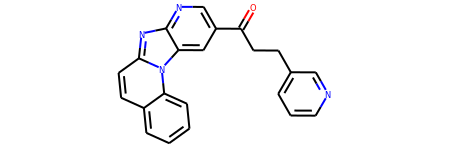

The proposed reaction is:


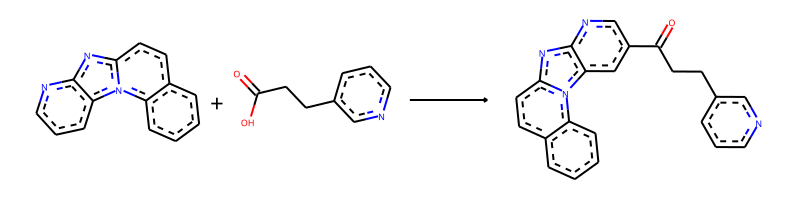

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1cccnc1>>O=C(CCc1cccnc1)c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.6262626262626263, overall 0.3085931781583956, smiles O=C(CCc1cccnc1)c1cccc2ccc3nc4ncccc4n3c12


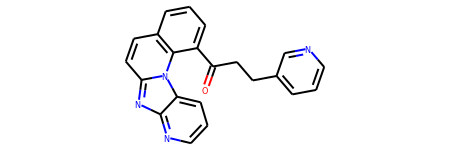

The proposed reaction is:


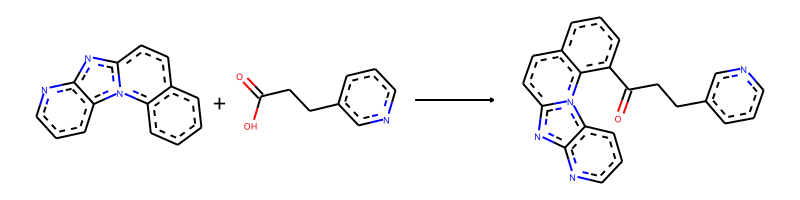

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1cccnc1>>O=C(CCc1cccnc1)c1cccc2ccc3nc4ncccc4n3c12
Product similarity 0.6262626262626263, overall 0.3085931781583956, smiles O=C(CCc1cccnc1)c1ccnc2nc3ccc4ccccc4n3c12


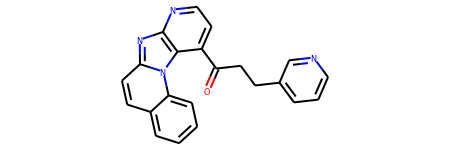

The proposed reaction is:


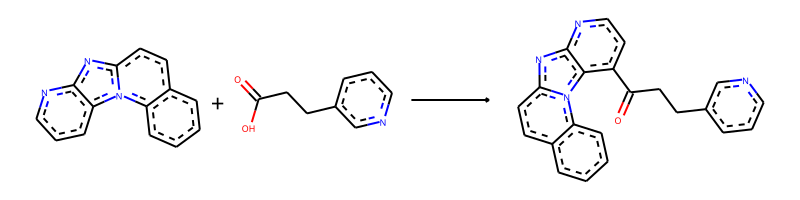

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(O)CCc1cccnc1>>O=C(CCc1cccnc1)c1ccnc2nc3ccc4ccccc4n3c12


--------------------------------------------------

Train index: 131965
RANK 93 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


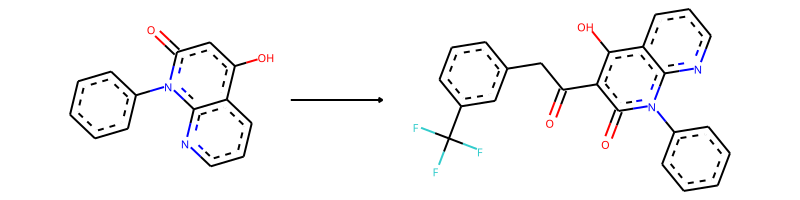

-> template: [#7;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>F-C(-F)(-F)-c1:c:c:c:c(-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#7;a:4]):c:1


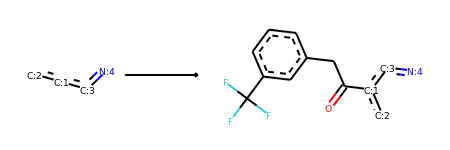

Product similarity 0.6320754716981132, overall 0.3114574788077659, smiles O=C(Cc1cccc(C(F)(F)F)c1)c1cnc2nc3ccc4ccccc4n3c2c1


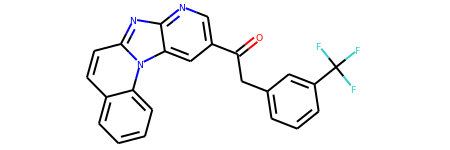

The proposed reaction is:


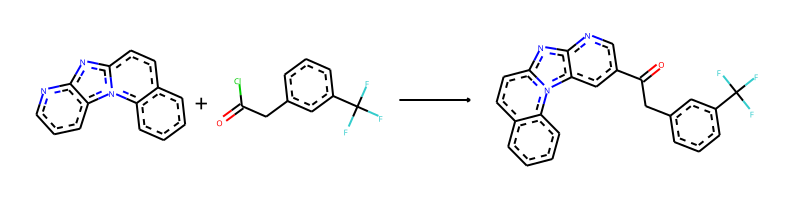

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1cccc(C(F)(F)F)c1>>O=C(Cc1cccc(C(F)(F)F)c1)c1cnc2nc3ccc4ccccc4n3c2c1
Product similarity 0.6476190476190476, overall 0.31911663216011044, smiles O=C(Cc1cccc(C(F)(F)F)c1)c1ccnc2nc3ccc4ccccc4n3c12


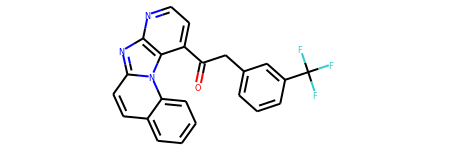

The proposed reaction is:


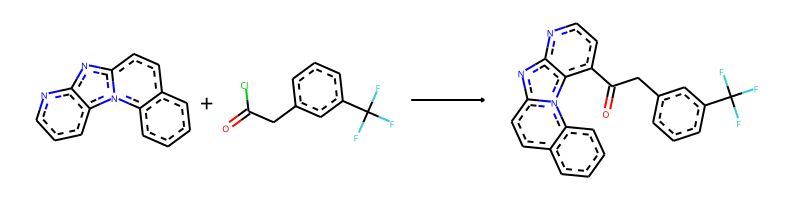

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1cccc(C(F)(F)F)c1>>O=C(Cc1cccc(C(F)(F)F)c1)c1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.6634615384615384, overall 0.3269230769230769, smiles O=C(Cc1cccc(C(F)(F)F)c1)c1cc2ccccc2n2c1nc1ncccc12


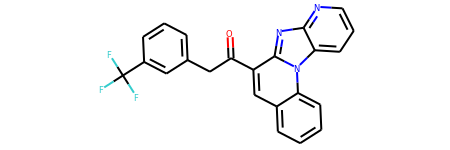

The proposed reaction is:


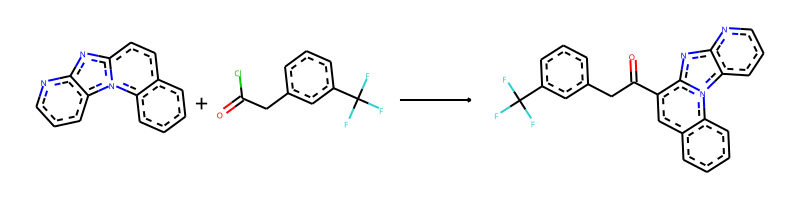

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1cccc(C(F)(F)F)c1>>O=C(Cc1cccc(C(F)(F)F)c1)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.6476190476190476, overall 0.31911663216011044, smiles O=C(Cc1cccc(C(F)(F)F)c1)c1cccc2ccc3nc4ncccc4n3c12


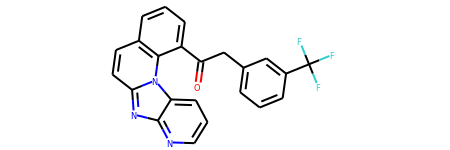

The proposed reaction is:


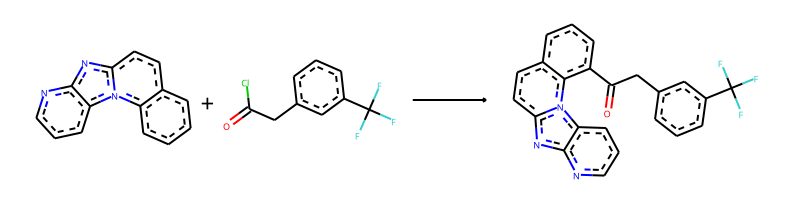

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1cccc(C(F)(F)F)c1>>O=C(Cc1cccc(C(F)(F)F)c1)c1cccc2ccc3nc4ncccc4n3c12


--------------------------------------------------

Train index: 235741
RANK 94 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


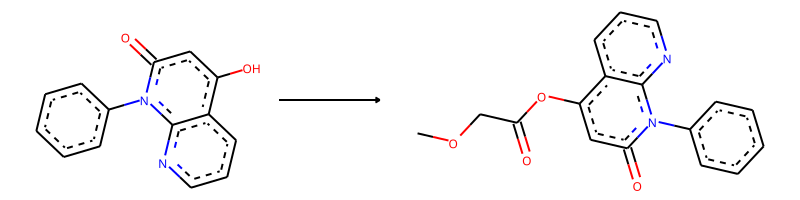

-> template: [OH;D1;+0:1]-[c:2]>>C-O-C-C(=O)-[O;H0;D2;+0:1]-[c:2]


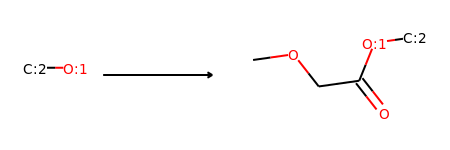

->No precursors could be generated!


--------------------------------------------------

Train index: 127640
RANK 95 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


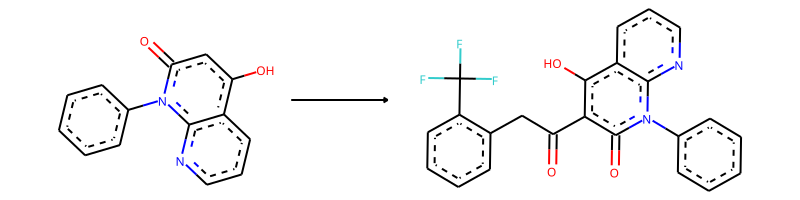

-> template: [#7;a:4]:[c:3]:[cH;D2;+0:1]:[c:2]>>F-C(-F)(-F)-c1:c:c:c:c:c:1-C-C(=O)-[c;H0;D3;+0:1](:[c:2]):[c:3]:[#7;a:4]


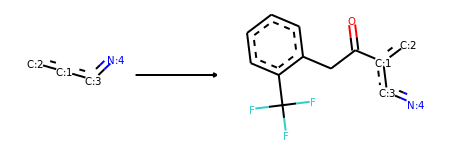

Product similarity 0.6476190476190476, overall 0.31911663216011044, smiles O=C(Cc1ccccc1C(F)(F)F)c1ccnc2nc3ccc4ccccc4n3c12


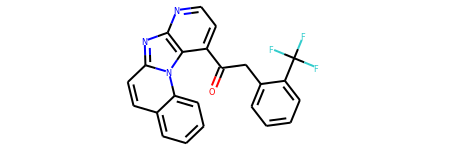

The proposed reaction is:


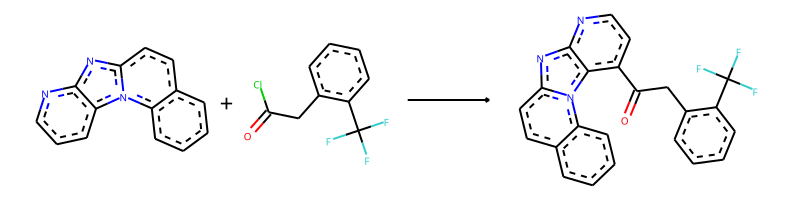

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1ccccc1C(F)(F)F>>O=C(Cc1ccccc1C(F)(F)F)c1ccnc2nc3ccc4ccccc4n3c12
Product similarity 0.6634615384615384, overall 0.3269230769230769, smiles O=C(Cc1ccccc1C(F)(F)F)c1cc2ccccc2n2c1nc1ncccc12


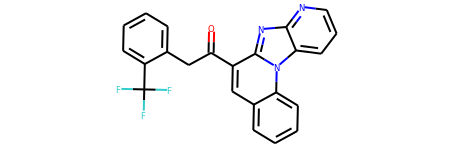

The proposed reaction is:


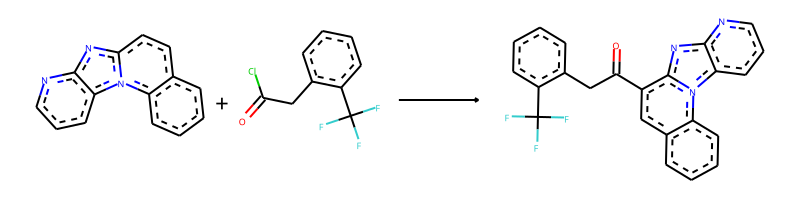

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1ccccc1C(F)(F)F>>O=C(Cc1ccccc1C(F)(F)F)c1cc2ccccc2n2c1nc1ncccc12
Product similarity 0.6476190476190476, overall 0.31911663216011044, smiles O=C(Cc1ccccc1C(F)(F)F)c1cccc2ccc3nc4ncccc4n3c12


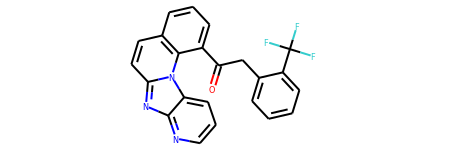

The proposed reaction is:


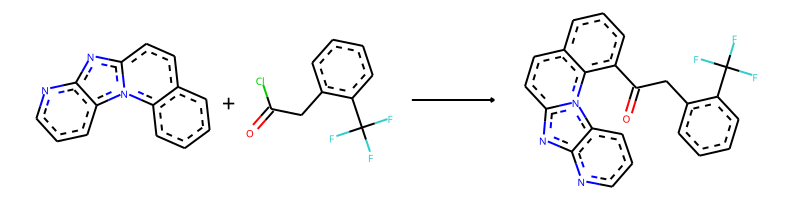

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1ccccc1C(F)(F)F>>O=C(Cc1ccccc1C(F)(F)F)c1cccc2ccc3nc4ncccc4n3c12
Product similarity 0.6320754716981132, overall 0.3114574788077659, smiles O=C(Cc1ccccc1C(F)(F)F)c1cnc2nc3ccc4ccccc4n3c2c1


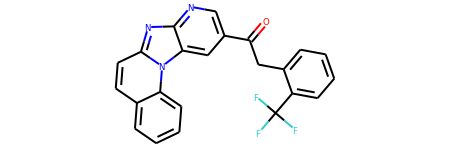

The proposed reaction is:


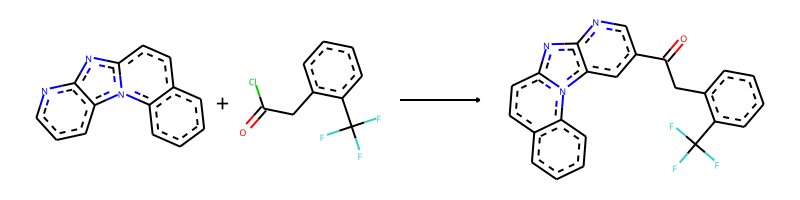

The reaction SMILES string is: c1ccc2c(c1)ccc1nc3ncccc3n21.O=C(Cl)Cc1ccccc1C(F)(F)F>>O=C(Cc1ccccc1C(F)(F)F)c1cnc2nc3ccc4ccccc4n3c2c1


--------------------------------------------------

Train index: 258130
RANK 96 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


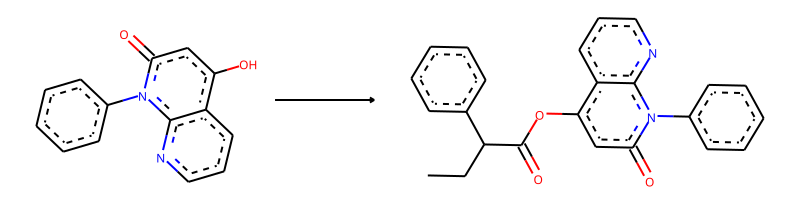

-> template: [OH;D1;+0:1]-[c:2]>>C-C-C(-C(=O)-[O;H0;D2;+0:1]-[c:2])-c1:c:c:c:c:c:1


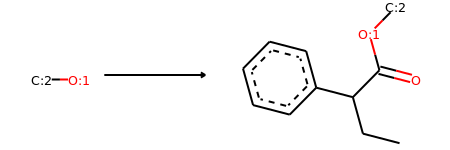

->No precursors could be generated!


--------------------------------------------------

Train index: 306941
RANK 97 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


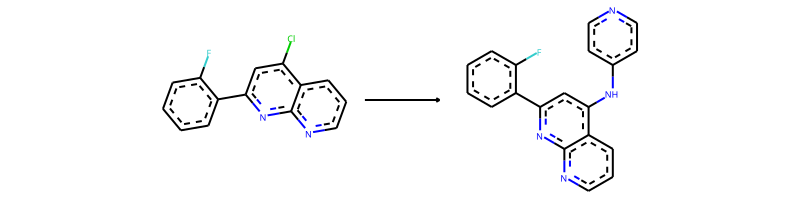

-> template: [#7;a:1]:[c:2]1:[#7;a:3]:[c:4]:[c:5]:[c;H0;D3;+0:6](-[Cl;H0;D1;+0]):[c:7]:1>>[#7;a:1]:[c:2]1:[#7;a:3]:[c:4]:[c:5]:[c;H0;D3;+0:6](-N-c2:c:c:n:c:c:2):[c:7]:1


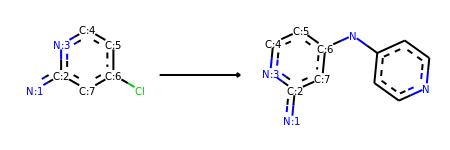

->No precursors could be generated!


--------------------------------------------------

Train index: 450954
RANK 98 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


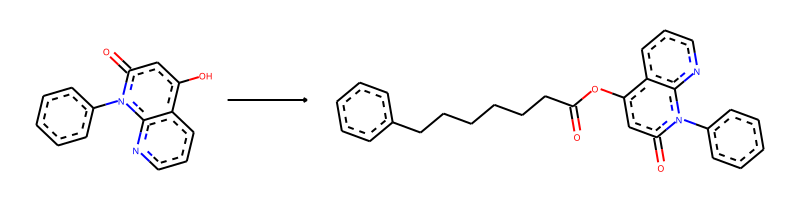

-> template: [OH;D1;+0:1]-[c:2]>>O=C(-C-C-C-C-C-C-c1:c:c:c:c:c:1)-[O;H0;D2;+0:1]-[c:2]


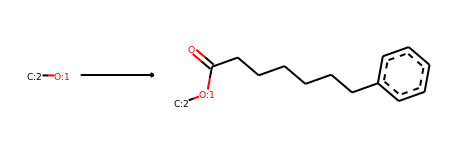

->No precursors could be generated!


--------------------------------------------------

Train index: 308079
RANK 99 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


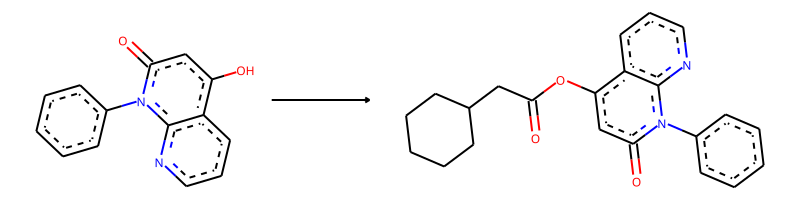

-> template: [OH;D1;+0:1]-[c:2]>>O=C(-C-C1-C-C-C-C-C-1)-[O;H0;D2;+0:1]-[c:2]


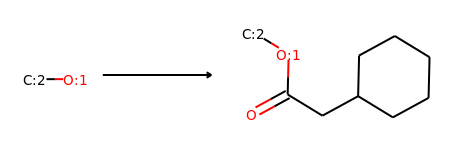

->No precursors could be generated!


--------------------------------------------------

Train index: 310227
RANK 100 PRECEDENT
REACTANT MATCH SCORE: 0.4927536231884058


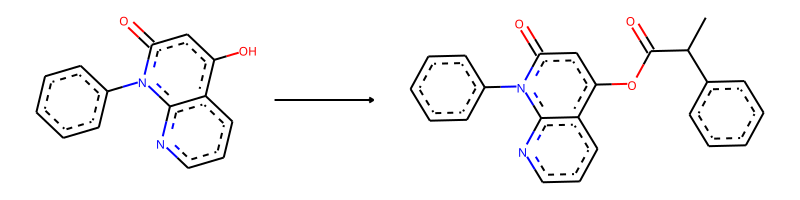

-> template: [OH;D1;+0:1]-[c:2]>>C-C(-C(=O)-[O;H0;D2;+0:1]-[c:2])-c1:c:c:c:c:c:1


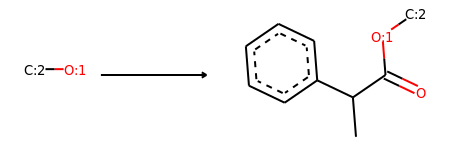

->No precursors could be generated!


In [82]:
do_one_v4_SMILES ('c1ccc2c(c1)ccc1nc3ncccc3n21')